<a href="https://colab.research.google.com/github/SamPetkov/PartialCoalescence/blob/main/BubbleTrajectory.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import math

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import io

def load_filtered_data(filepath):
    with open(filepath, 'r') as f:
        lines = f.readlines()
    # Include only odd-numbered lines (1st, 3rd, 5th, etc.)
    filtered_lines = [lines[i] for i in range(len(lines)) if i % 2 != 0]
    # Join the filtered lines back into a string and use io.StringIO to simulate a file
    filtered_data = io.StringIO("".join(filtered_lines))
    return np.genfromtxt(filtered_data, delimiter=' ', usecols=(0, 1, 2, 3, 4, 5, 6))

Constants + Time variables

# 0.25, 0.175


In [ ]:


bubble = load_filtered_data('/content/drive/MyDrive/test0.25,0.175/b0.01vel')
nobubble = load_filtered_data('/content/drive/MyDrive/test0.25,0.175/nb0.01vel')
ng = load_filtered_data('/content/drive/MyDrive/test0.25,0.175/nogravity0.25,0.175')

In [ ]:
print(bubble)

[[ 0.00000e+00  7.82500e+00  0.00000e+00 ...  7.99683e+00 -0.00000e+00
  -0.00000e+00]
 [ 1.00000e-03  7.82500e+00 -5.57013e-04 ...  7.99561e+00 -1.35409e-02
  -1.63312e-03]
 [ 2.00000e-03  7.82500e+00 -1.70327e-03 ...  7.99561e+00 -2.28938e-03
  -1.25690e-03]
 ...
 [ 9.97000e-01  7.02477e+00 -3.66322e-01 ...  7.69409e+00 -1.38952e+00
   3.96298e+00]
 [ 9.98000e-01  7.02477e+00 -3.66322e-01 ...  7.69409e+00 -1.38952e+00
   3.96298e+00]
 [ 9.99000e-01  7.02477e+00 -3.66322e-01 ...  7.69409e+00 -1.38952e+00
   3.96298e+00]]


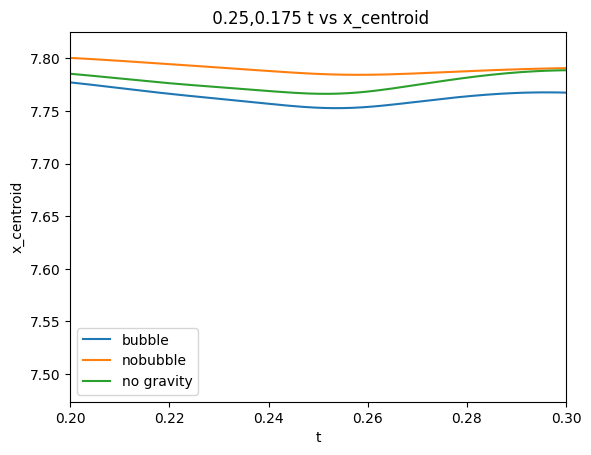

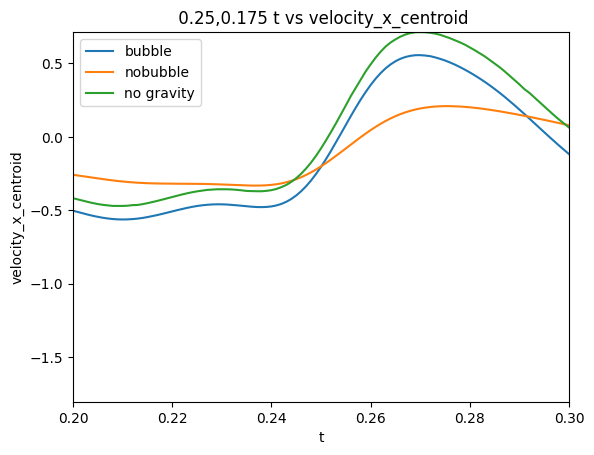

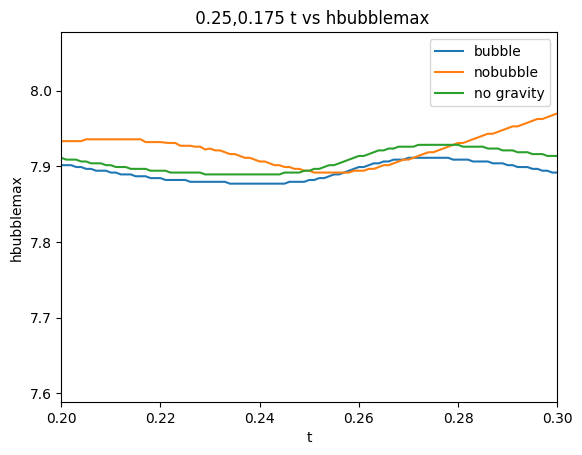

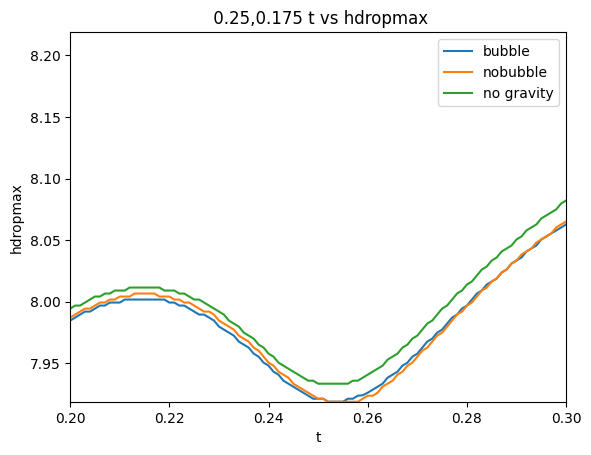

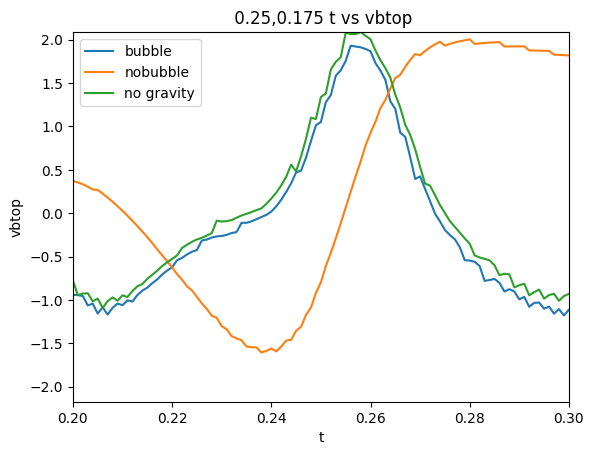

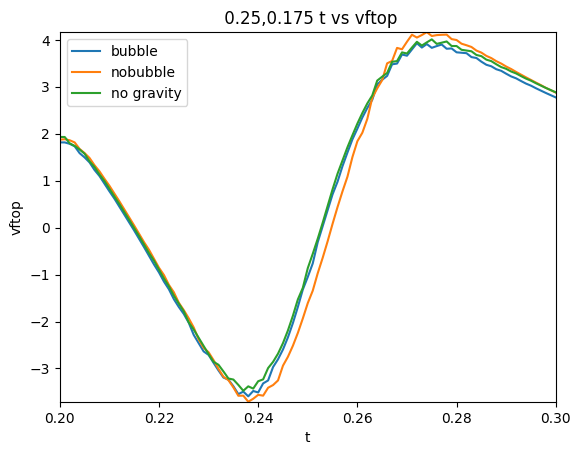

In [ ]:
column_names = ['x_centroid', 'velocity_x_centroid', 'hbubblemax', 'hdropmax', 'vbtop', 'vftop']

for i in range(1, bubble.shape[1]):
    fig, ax = plt.figure(), plt.axes()
    ax.plot(bubble[:, 0], bubble[:, i], label='bubble')
    ax.plot(nobubble[:, 0], nobubble[:, i], label='nobubble')
    ax.plot(ng[:, 0], ng[:, i], label='no gravity')
    ax.set_xlabel('t')
    ax.set_ylabel(column_names[i-1])
    ax.set_title(f' 0.25,0.175 t vs {column_names[i-1]}')
    ax.legend()
    ax.set_xlim(0.2, 0.3)

    # Filter data within the x-axis range (0 to 0.56) for each dataset
    bubble_filtered = bubble[(bubble[:, 0] >= 0) & (bubble[:, 0] <= 0.56)]
    nobubble_filtered = nobubble[(nobubble[:, 0] >= 0) & (nobubble[:, 0] <= 0.56)]
    ng_filtered = ng[(ng[:, 0] >= 0) & (ng[:, 0] <= 0.56)]

    # Set y-limits based on the filtered data in the current column across both datasets
    min_y = min(bubble_filtered[:, i].min(), nobubble_filtered[:, i].min(), ng_filtered[:, i].min() )
    max_y = max(bubble_filtered[:, i].max(), nobubble_filtered[:, i].max(), ng_filtered[:, i].max())
    ax.set_ylim(min_y, max_y)

    plt.show()

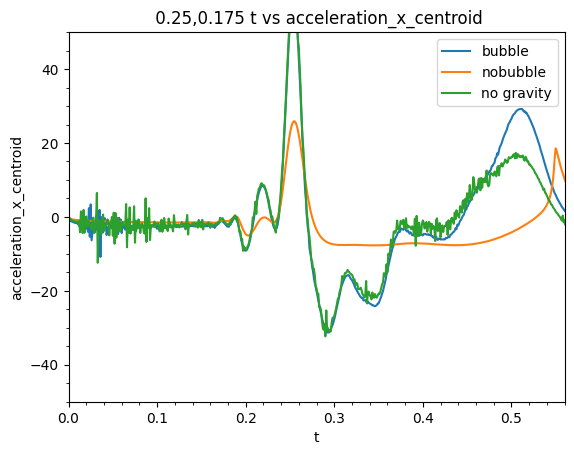

In [ ]:
%matplotlib inline
# Calculate acceleration for bubble data
acceleration_bubble = np.diff(bubble[:, 2]) / 0.001
# Calculate acceleration for nobubble data
acceleration_nobubble = np.diff(nobubble[:, 2]) / 0.001
acceleration_ng = np.diff(ng[:,2]) / 0.001
# The time array for acceleration will be one element shorter, so we use all but the last time point
time_bubble = bubble[:-1, 0]
time_nobubble = nobubble[:-1, 0]
time_ng = ng[:-1, 0]

# Create the plot
fig, ax = plt.figure(), plt.axes()
ax.plot(time_bubble, acceleration_bubble, label='bubble')
ax.plot(time_nobubble, acceleration_nobubble, label='nobubble')
ax.plot(time_ng, acceleration_ng, label='no gravity')
ax.set_xlabel('t')
ax.set_ylabel('acceleration_x_centroid')
ax.set_title(' 0.25,0.175 t vs acceleration_x_centroid')
ax.legend()
ax.set_xlim(0, 0.56)
ax.set_ylim(-50, 50)
ax.minorticks_on()
plt.show()

In [ ]:
# Filter nobubble data for times <= 0.56
filtered_nobubble = nobubble[nobubble[:, 0] <= 0.56]

# Find the index of the minimum hdropmax in the filtered data
min_hdropmax_index = np.argmin(filtered_nobubble[:, 4])

# Get the element with the lowest hdropmax from the filtered data
element_with_lowest_hdropmax = filtered_nobubble[min_hdropmax_index]

print("Element with lowest hdropmax (time <= 0.56):")
print(element_with_lowest_hdropmax)

Element with lowest hdropmax (time <= 0.56):
[ 0.252     7.78489  -0.155007  7.89185   7.9187   -0.45673  -0.974095]


<>:28: SyntaxWarning: invalid escape sequence '\D'
<>:28: SyntaxWarning: invalid escape sequence '\D'
/tmp/ipython-input-2326553121.py:28: SyntaxWarning: invalid escape sequence '\D'
  ax.set_title('$(d_i,\Delta h) = (0.25,0.175)$ Bubble Trajectory')


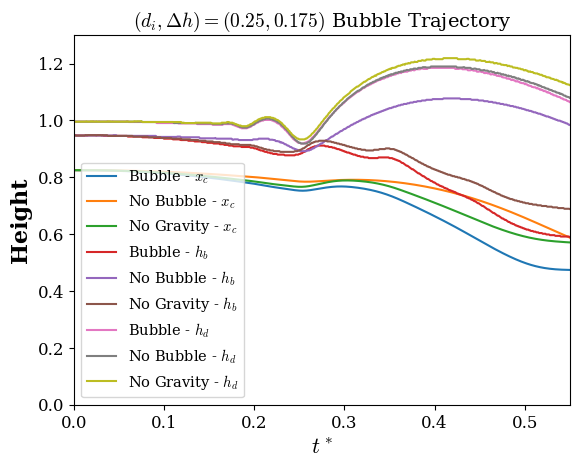

In [ ]:
fig, ax = plt.figure(), plt.axes()
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['DejaVu Serif', 'Times New Roman', 'Computer Modern Roman'] # Better font
plt.rcParams['mathtext.fontset'] = 'cm' # Use Computer Modern fonts for math
plt.rcParams['font.size'] = 12 # Adjust font size
plt.rcParams['axes.labelsize'] = 16  # Increased label size
plt.rcParams['axes.labelweight'] = 'bold' # Made labels bold
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 10.5
plt.rcParams['figure.titlesize'] = 18
# Plot hbubblemax for both bubble and nobubble
ax.plot(bubble[:, 0], bubble[:, 1]-7.0, label='Bubble - $x_c$')
ax.plot(nobubble[:, 0], nobubble[:, 1]-7.0, label='No Bubble - $x_c$')
ax.plot(ng[:, 0], ng[:, 1]-7.0, label='No Gravity - $x_c$')

ax.plot(bubble[:, 0], bubble[:, 3]-7.0, label='Bubble - $h_b$')
ax.plot(nobubble[:, 0], nobubble[:, 3]-7.0, label='No Bubble - $h_b$')
ax.plot(ng[:, 0], ng[:, 3]-7.0, label='No Gravity - $h_b$')
# Plot hdropmax for both bubble and nobubble
ax.plot(bubble[:, 0], bubble[:, 4]-7.0, label='Bubble - $h_d$')
ax.plot(nobubble[:, 0], nobubble[:, 4]-7.0, label='No Bubble - $h_d$')
ax.plot(ng[:, 0], ng[:, 4]-7.0, label='No Gravity - $h_d$')

ax.set_xlabel('$t^*$')
ax.set_ylabel('Height')
ax.set_title('$(d_i,\Delta h) = (0.25,0.175)$ Bubble Trajectory')
ax.legend()
ax.set_xlim(0, 0.55)
ax.set_ylim(0,1.3)
plt.savefig('trajectory.pdf', format='pdf', dpi=1200)
plt.show()

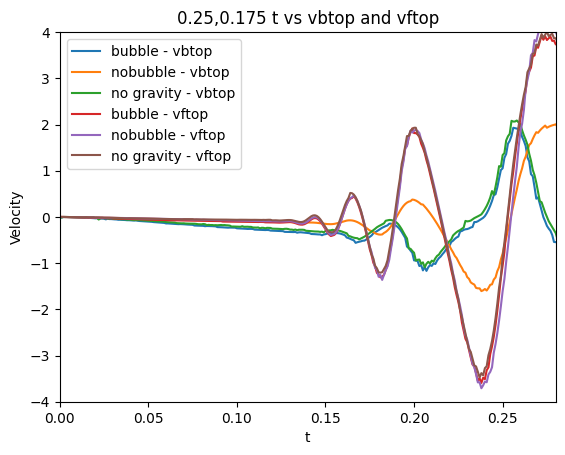

In [ ]:
fig, ax = plt.figure(), plt.axes()

# Plot vbtop for both bubble and nobubble (assuming vbtop is the 6th column, index 5)
ax.plot(bubble[:, 0], bubble[:, 5], label='bubble - vbtop')
ax.plot(nobubble[:, 0], nobubble[:, 5], label='nobubble - vbtop')
ax.plot(ng[:, 0], ng[:, 5], label='no gravity - vbtop')
# Plot vftop for both bubble and nobubble (assuming vftop is the 7th column, index 6)
ax.plot(bubble[:, 0], bubble[:, 6], label='bubble - vftop')
ax.plot(nobubble[:, 0], nobubble[:, 6], label='nobubble - vftop')
ax.plot(ng[:, 0], ng[:, 6], label='no gravity - vftop')

ax.set_xlabel('t')
ax.set_ylabel('Velocity')
ax.set_title('0.25,0.175 t vs vbtop and vftop')
ax.legend()
ax.set_xlim(0, 0.28)
ax.set_ylim(-4,4)
plt.show()

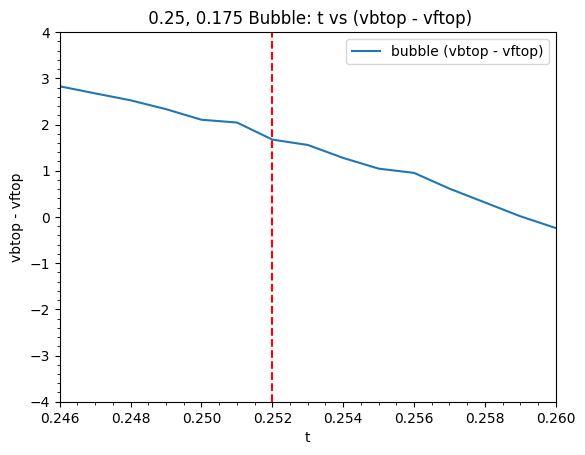

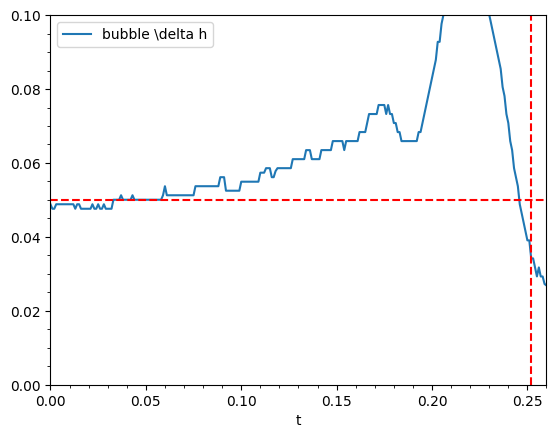

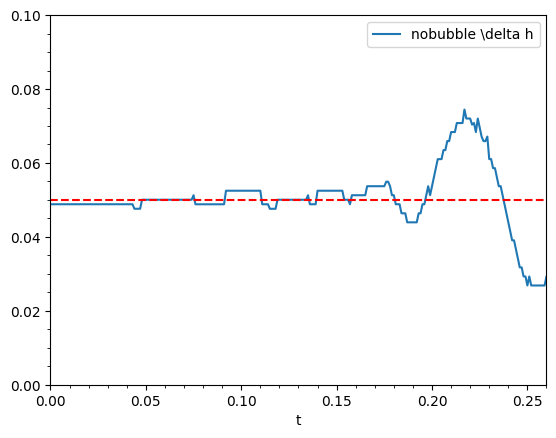

In [ ]:
# Calculate the difference between vbtop and vftop for bubble
diff_bubble = bubble[:, 5] - bubble[:, 6]

# Calculate the difference between vbtop and vftop for nobubble
diff_xbubble = bubble[:, 4] - bubble[:, 3]

# Create the plot for bubble data
fig1, ax1 = plt.figure(), plt.axes()
ax1.plot(bubble[:, 0], diff_bubble, label='bubble (vbtop - vftop)')
ax1.set_xlabel('t')
ax1.set_ylabel('vbtop - vftop')
ax1.set_title(' 0.25, 0.175 Bubble: t vs (vbtop - vftop)')
ax1.legend()
ax1.set_xlim(0.246, 0.26)
ax1.set_ylim(-4,4)
ax1.axvline(x=0.252, color='r', linestyle='--', label='xtopmin')
ax1.minorticks_on()
plt.show()

# Create the plot for nobubble data
fig2, ax2 = plt.figure(), plt.axes()
ax2.plot(nobubble[:, 0], diff_xbubble, label='bubble \delta h')
ax2.set_xlabel('t')
ax2.legend()
ax2.set_xlim(0, 0.26)
ax2.set_ylim(0,0.10)
ax2.minorticks_on()
ax2.axhline(y=0.05, color='r', linestyle='--', label='y=0.5')
ax2.axvline(x=0.252, color='r', linestyle='--', label='xtopmin')
plt.show()

# Create the plot for nobubble data
fig3, ax3 = plt.figure(), plt.axes()
ax3.plot(nobubble[:, 0], nobubble[:,4] - nobubble[:,3], label='nobubble \delta h')
ax3.set_xlabel('t')
ax3.legend()
ax3.set_xlim(0, 0.26)
ax3.set_ylim(0,0.10)
ax3.minorticks_on()
ax3.axhline(y=0.175-0.25/2, color='r', linestyle='--', label='y=0.5')
#ax2.axvline(x=0.252, color='r', linestyle='--', label='xtopmin')
plt.show()

In [ ]:
# Find the intersection point between bubble vbtop and bubble vftop
# Iterate through the bubble data and check for the closest point where vbtop and vftop are equal
intersection_time = None
min_diff = 1

for i in range(bubble.shape[0]):
    diff = abs(bubble[i, 5] - bubble[i, 6])
    if diff < min_diff:
        min_diff = diff
        intersection_time = bubble[i, 0]

print(f"Approximate intersection time between bubble vbtop and bubble vftop: {intersection_time}")

Approximate intersection time between bubble vbtop and bubble vftop: 0.0


In [ ]:
# Calculate the difference between hdropmax and hbubblemax for bubble
diff_h = bubble[:, 4] - bubble[:, 3]

# Find the index of the minimum of this difference
min_diff_h_index = np.argmin(diff_h)

# Find the minimum of this difference
min_diff_h = diff_h[min_diff_h_index]

# Get the time at which the minimum difference occurs
time_at_min_diff_h = bubble[min_diff_h_index, 0]

print(f"Minimum of bubble[:, 4] - bubble[:, 3]: {min_diff_h}")
print(f"Time at which the minimum difference occurs: {time_at_min_diff_h}")

Minimum of bubble[:, 4] - bubble[:, 3]: 0.026860000000000106
Time at which the minimum difference occurs: 0.26


In [ ]:
# Filter bubble data for times between 0.23 and 0.28
filtered_bubble = bubble[(bubble[:, 0] >= 0.23) & (bubble[:, 0] <= 0.28)]

# Filter the vbtop values that are greater than 0
vbtop_values = filtered_bubble[:, 5]
positive_vbtop = vbtop_values[vbtop_values > 0]

# Calculate the average of the positive vbtop values
average_vbtop = np.mean(positive_vbtop)

print(f"Average vbtop for bubble between t=0.23 and t=0.28 (where vbtop > 0): {average_vbtop}")

Average vbtop for bubble between t=0.23 and t=0.28 (where vbtop > 0): 1.017774987878788


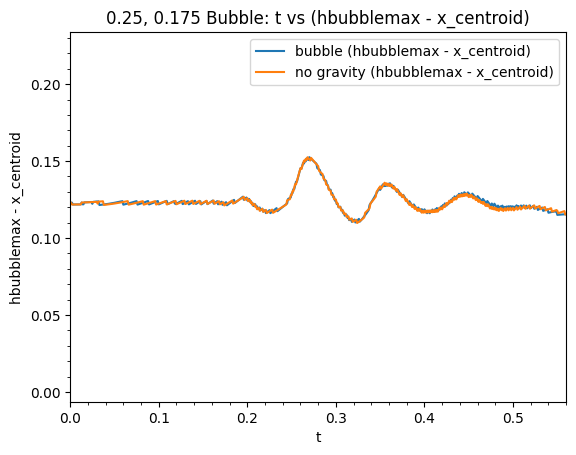

In [ ]:
# Calculate the difference between hbubblemax and x_centroid for bubble
diff_h_x = bubble[:, 3] - bubble[:, 1]
diff_ng = ng[:, 3] - ng[:, 1]
# Create the plot
fig, ax = plt.figure(), plt.axes()
ax.plot(bubble[:, 0], diff_h_x, label='bubble (hbubblemax - x_centroid)')
ax.plot(ng[:, 0], diff_ng, label='no gravity (hbubblemax - x_centroid)')
ax.set_xlabel('t')
ax.set_ylabel('hbubblemax - x_centroid')
ax.set_title('0.25, 0.175 Bubble: t vs (hbubblemax - x_centroid)')
ax.legend()
ax.minorticks_on()
ax.set_xlim(0, 0.56)
plt.show()

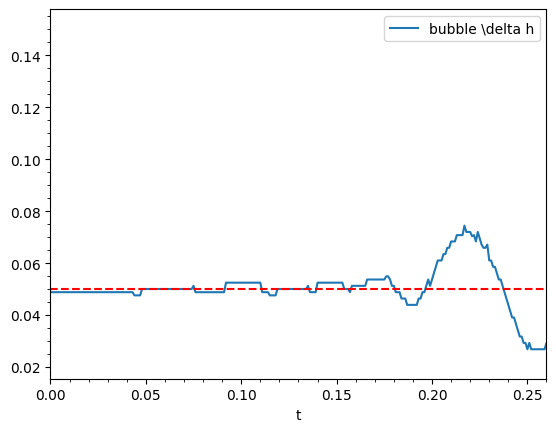

# 0.175,0.125

In [ ]:
bub = load_filtered_data('/content/drive/MyDrive/test0.175,0.125/bubble0.175,0.125')
nbub = load_filtered_data('/content/drive/MyDrive/test0.175,0.125/nobubble0.175,0.125')

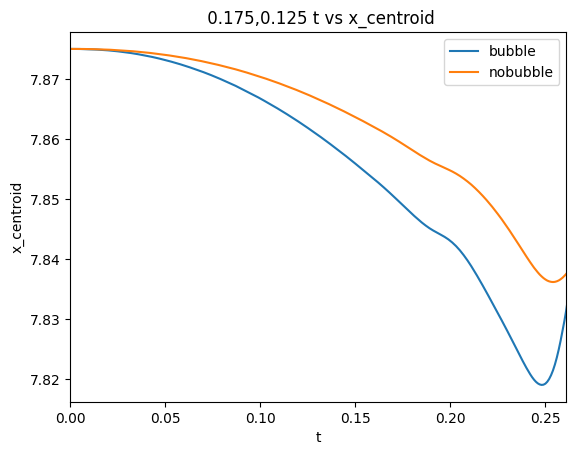

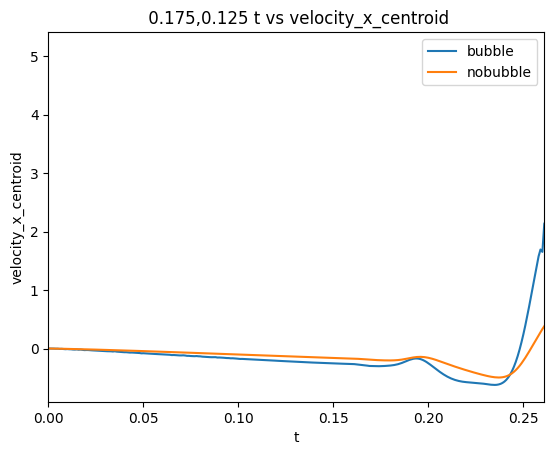

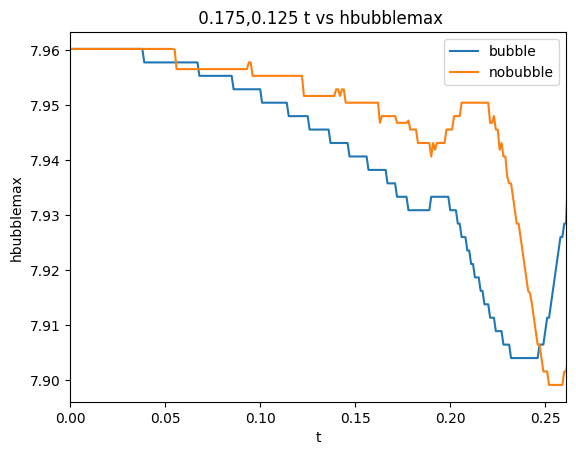

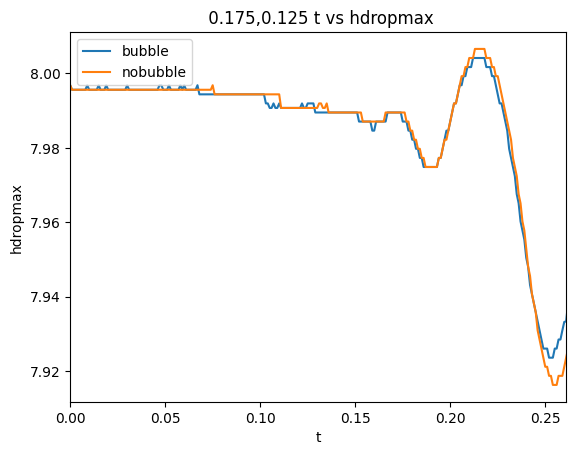

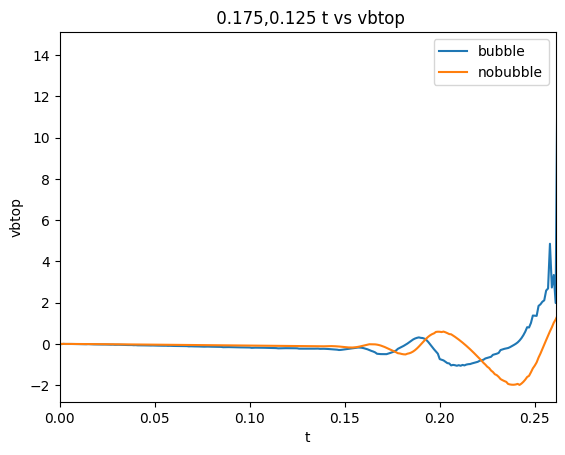

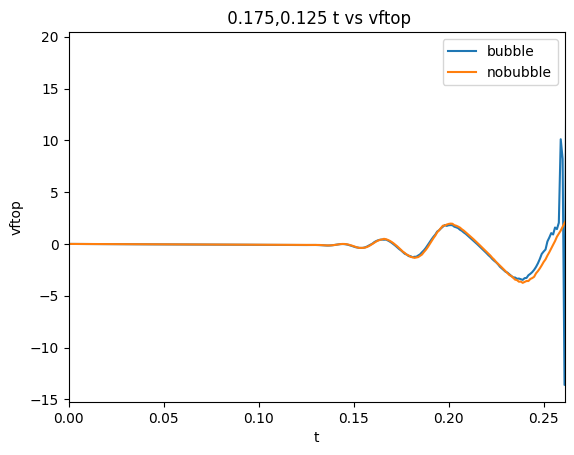

In [ ]:
column_names = ['x_centroid', 'velocity_x_centroid', 'hbubblemax', 'hdropmax', 'vbtop', 'vftop']

for i in range(1, bub.shape[1]):
    fig, ax = plt.figure(), plt.axes()
    ax.plot(bub[:, 0], bub[:, i], label='bubble')
    ax.plot(nbub[:, 0], nbub[:, i], label='nobubble')
    ax.set_xlabel('t')
    ax.set_ylabel(column_names[i-1])
    ax.set_title(f' 0.175,0.125 t vs {column_names[i-1]}')
    ax.legend()
    ax.set_xlim(0, 0.261)
    plt.show()

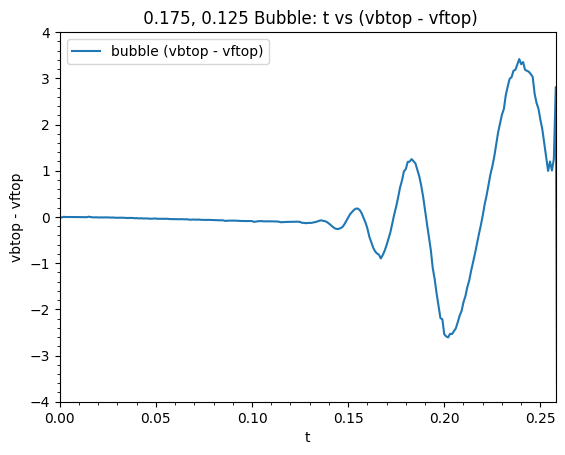

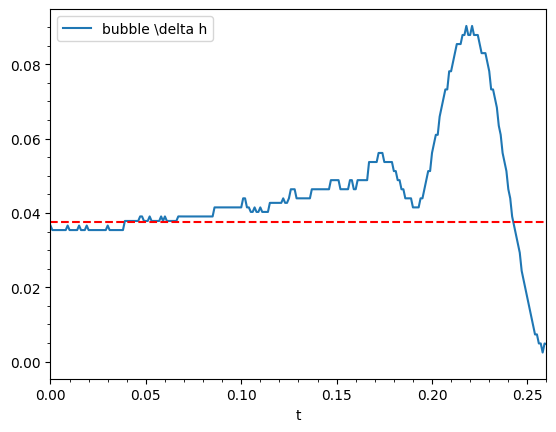

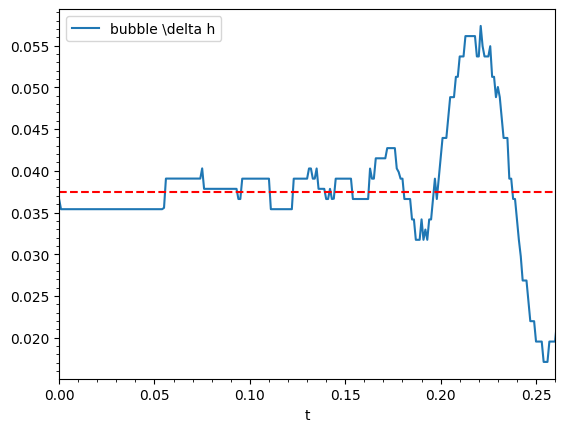

In [ ]:
# Calculate the difference between vbtop and vftop for bubble
diff_bubble = bub[:, 5] - bub[:, 6]

# Calculate the difference between vbtop and vftop for nobubble
diff_xbubble = bub[:, 4] - bub[:, 3]

# Create the plot for bubble data
fig1, ax1 = plt.figure(), plt.axes()
ax1.plot(bub[:, 0], diff_bubble, label='bubble (vbtop - vftop)')
ax1.set_xlabel('t')
ax1.set_ylabel('vbtop - vftop')
ax1.set_title(' 0.175, 0.125 Bubble: t vs (vbtop - vftop)')
ax1.legend()
ax1.set_xlim(0, 0.258)
ax1.set_ylim(-4,4)
#ax1.axvline(x=0.252, color='r', linestyle='--', label='xtopmin')
ax1.minorticks_on()
plt.show()

# Create the plot for nobubble data
fig2, ax2 = plt.figure(), plt.axes()
ax2.plot(nbub[:, 0], diff_xbubble, label='bubble \delta h')
ax2.set_xlabel('t')
ax2.legend()
ax2.set_xlim(0, 0.26)
#ax2.set_ylim(0,0.1)
ax2.minorticks_on()
ax2.axhline(y=0.125-0.175/2, color='r', linestyle='--', label='y=0.5')
#ax2.axvline(x=0.252, color='r', linestyle='--', label='xtopmin')
plt.show()

# Create the plot for nobubble data
fig3, ax3 = plt.figure(), plt.axes()
ax3.plot(nbub[:, 0], nbub[:,4] - nbub[:,3], label='bubble \delta h')
ax3.set_xlabel('t')
ax3.legend()
ax3.set_xlim(0, 0.26)
#ax3.set_ylim(0.015,0.020)
ax3.minorticks_on()
ax3.axhline(y=0.125-0.175/2, color='r', linestyle='--', label='y=0.5')
#ax2.axvline(x=0.252, color='r', linestyle='--', label='xtopmin')
plt.show()




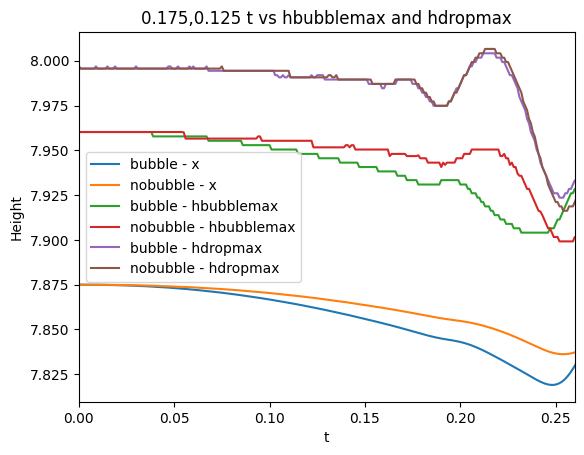

In [ ]:
fig, ax = plt.figure(), plt.axes()

# Plot hbubblemax for both bubble and nobubble
ax.plot(bub[:, 0], bub[:, 1], label='bubble - x')
ax.plot(nbub[:, 0], nbub[:, 1], label='nobubble - x')


ax.plot(bub[:, 0], bub[:, 3], label='bubble - hbubblemax')
ax.plot(nbub[:, 0], nbub[:, 3], label='nobubble - hbubblemax')
# Plot hdropmax for both bubble and nobubble
ax.plot(bub[:, 0], bub[:, 4], label='bubble - hdropmax')
ax.plot(nbub[:, 0], nbub[:, 4], label='nobubble - hdropmax')


ax.set_xlabel('t')
ax.set_ylabel('Height')
ax.set_title('0.175,0.125 t vs hbubblemax and hdropmax')
ax.legend()
ax.set_xlim(0, 0.26)
plt.show()

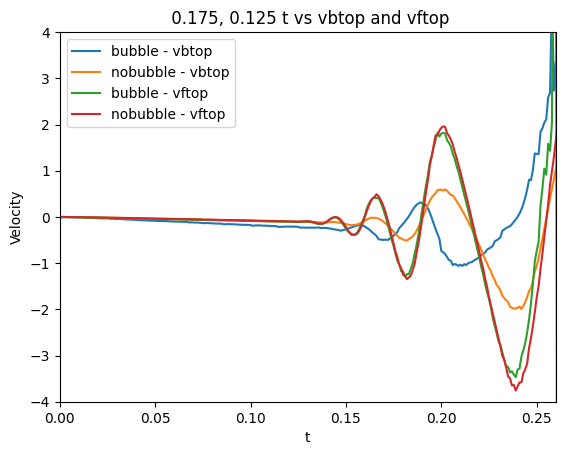

In [ ]:
fig, ax = plt.figure(), plt.axes()

# Plot vbtop for both bubble and nobubble (assuming vbtop is the 6th column, index 5)
ax.plot(bub[:, 0], bub[:, 5], label='bubble - vbtop')
ax.plot(nbub[:, 0], nbub[:, 5], label='nobubble - vbtop')

# Plot vftop for both bubble and nobubble (assuming vftop is the 7th column, index 6)
ax.plot(bub[:, 0], bub[:, 6], label='bubble - vftop')
ax.plot(nbub[:, 0], nbub[:, 6], label='nobubble - vftop')


ax.set_xlabel('t')
ax.set_ylabel('Velocity')
ax.set_title(' 0.175, 0.125 t vs vbtop and vftop')
ax.legend()
ax.set_xlim(0, 0.26)
ax.set_ylim(-4,4)
plt.show()

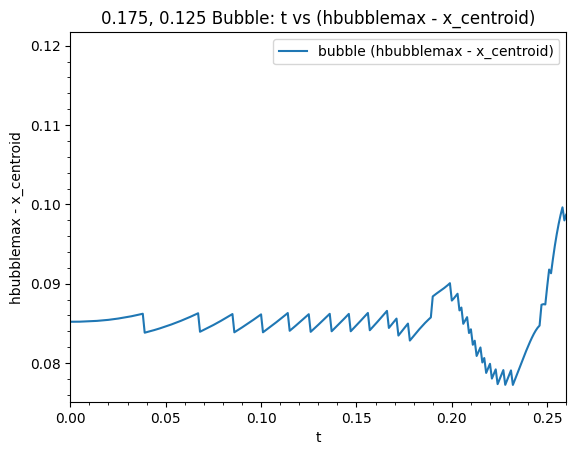

Maximum of bub[:, 3] - bub[:, 1]: 0.11958999999999964


In [ ]:
# Calculate the difference between hbubblemax and x_centroid for bubble
diff_h_x = bub[:, 3] - bub[:, 1]

# Create the plot
fig, ax = plt.figure(), plt.axes()
ax.plot(bub[:, 0], diff_h_x, label='bubble (hbubblemax - x_centroid)')
ax.set_xlabel('t')
ax.set_ylabel('hbubblemax - x_centroid')
ax.set_title('0.175, 0.125 Bubble: t vs (hbubblemax - x_centroid)')
ax.legend()
ax.minorticks_on()
ax.set_xlim(0, 0.26)
plt.show()
# Calculate the difference between hbubblemax and x_centroid for bubble
diff_h_x = bub[:, 3] - bub[:, 1]

# Find the maximum of this difference
max_diff_h_x = np.max(diff_h_x)

print(f"Maximum of bub[:, 3] - bub[:, 1]: {max_diff_h_x}")

In [ ]:
# Calculate the difference between hbubblemax and x_centroid for bubble
diff_h_x = bub[:, 3] - bub[:, 1]

# Filter the data for times between 0 and 0.26
filtered_diff_h_x = diff_h_x[(bub[:, 0] >= 0) & (bub[:, 0] <= 0.26)]

# Find the maximum of this filtered difference
max_diff_h_x = np.max(filtered_diff_h_x)

print(f"Maximum of bub[:, 3] - bub[:, 1] between t=0 and t=0.26: {max_diff_h_x}")

Maximum of bub[:, 3] - bub[:, 1] between t=0 and t=0.26: 0.023620000000000196


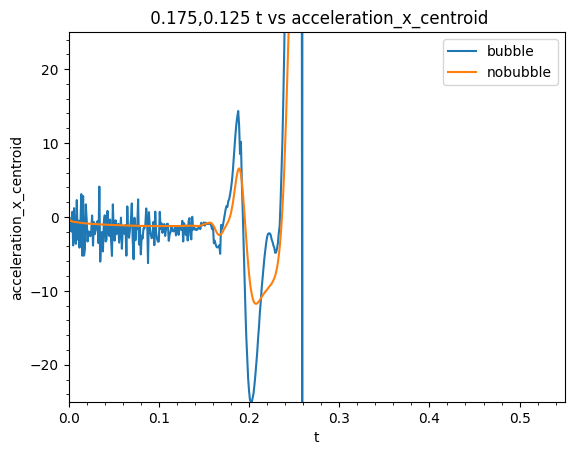

In [ ]:
%matplotlib inline
# Calculate acceleration for bubble data
acceleration_bubble = np.diff(bub[:, 2]) / 0.001
# Calculate acceleration for nobubble data
acceleration_nobubble = np.diff(nbub[:, 2]) / 0.001

# The time array for acceleration will be one element shorter, so we use all but the last time point
time_bubble = bub[:-1, 0]
time_nobubble = nbub[:-1, 0]

# Create the plot
fig, ax = plt.figure(), plt.axes()
ax.plot(time_bubble, acceleration_bubble, label='bubble')
ax.plot(time_nobubble, acceleration_nobubble, label='nobubble')
ax.set_xlabel('t')
ax.set_ylabel('acceleration_x_centroid')
ax.set_title(' 0.175,0.125 t vs acceleration_x_centroid')
ax.legend()
ax.set_xlim(0, 0.55)
ax.set_ylim(-25, 25)
ax.minorticks_on()
plt.show()

 # 0.05,0.175

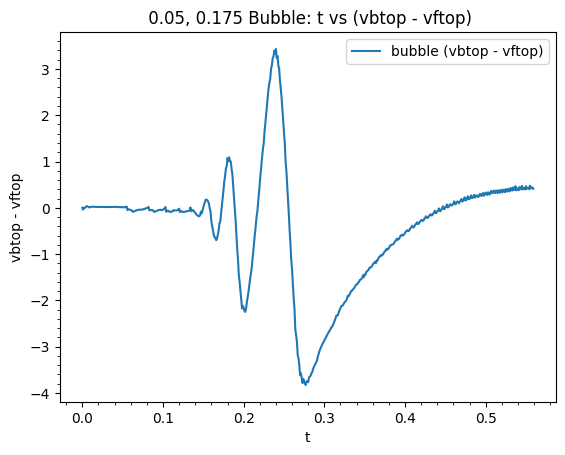

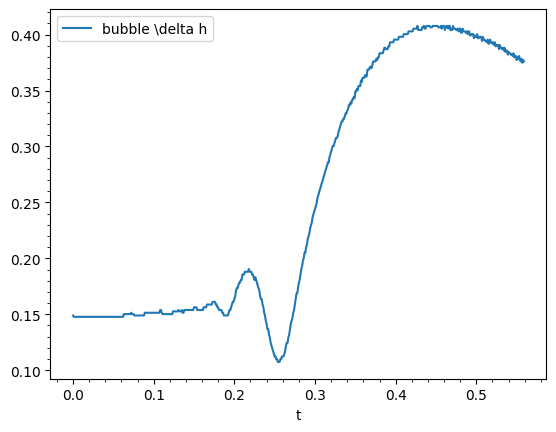

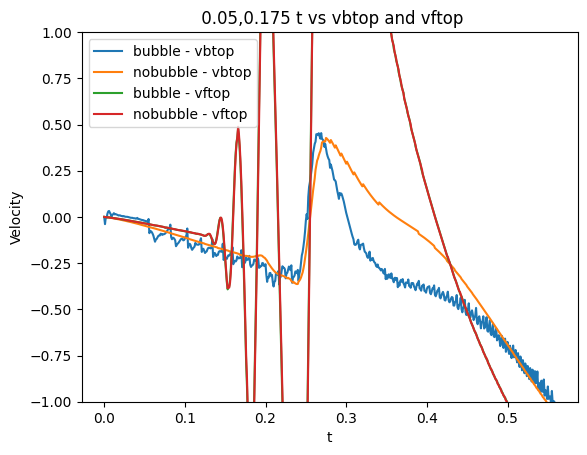

In [ ]:
bub = load_filtered_data('/content/drive/MyDrive/test0.05,0.175/bub0.05,0.175')
nbub = load_filtered_data('/content/drive/MyDrive/test0.05,0.175/nbub0.05,0.175')



# Calculate the difference between vbtop and vftop for bubble
diff_bubble = bub[:, 5] - bub[:, 6]

# Calculate the difference between vbtop and vftop for nobubble
diff_xbubble = bub[:, 4] - bub[:, 3]

# Create the plot for bubble data
fig1, ax1 = plt.figure(), plt.axes()
ax1.plot(bub[:, 0], diff_bubble, label='bubble (vbtop - vftop)')
ax1.set_xlabel('t')
ax1.set_ylabel('vbtop - vftop')
ax1.set_title(' 0.05, 0.175 Bubble: t vs (vbtop - vftop)')
ax1.legend()
#ax1.set_xlim(0.25, 0.258)
#ax1.set_ylim(-4,4)
#ax1.axvline(x=0.252, color='r', linestyle='--', label='xtopmin')
ax1.minorticks_on()
plt.show()

# Create the plot for nobubble data
fig2, ax2 = plt.figure(), plt.axes()
ax2.plot(nbub[:, 0], diff_xbubble, label='bubble \delta h')
ax2.set_xlabel('t')
ax2.legend()
#ax2.set_xlim(0.25, 0.26)
#ax2.set_ylim(0,0.1)
ax2.minorticks_on()
#ax2.axhline(y=0.125-0.175/2, color='r', linestyle='--', label='y=0.5')
#ax2.axvline(x=0.252, color='r', linestyle='--', label='xtopmin')
plt.show()

fig, ax = plt.figure(), plt.axes()

# Plot vbtop for both bubble and nobubble (assuming vbtop is the 6th column, index 5)
ax.plot(bub[:, 0], bub[:, 5], label='bubble - vbtop')
ax.plot(nbub[:, 0], nbub[:, 5], label='nobubble - vbtop')

# Plot vftop for both bubble and nobubble (assuming vftop is the 7th column, index 6)
ax.plot(bub[:, 0], bub[:, 6], label='bubble - vftop')
ax.plot(nbub[:, 0], nbub[:, 6], label='nobubble - vftop')


ax.set_xlabel('t')
ax.set_ylabel('Velocity')
ax.set_title(' 0.05,0.175 t vs vbtop and vftop')
ax.legend()
#ax.set_xlim(0.24, 0.26)
ax.set_ylim(-1,1)
plt.show()

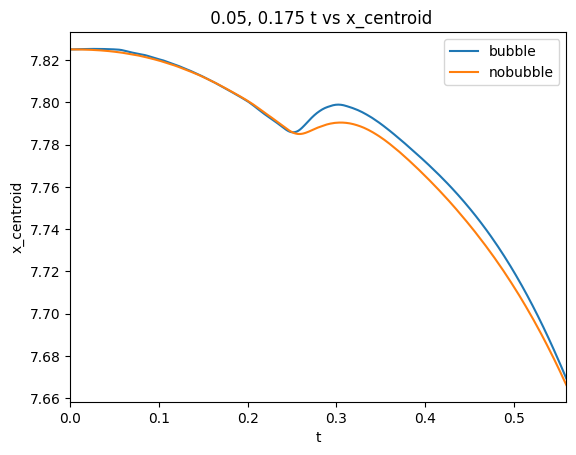

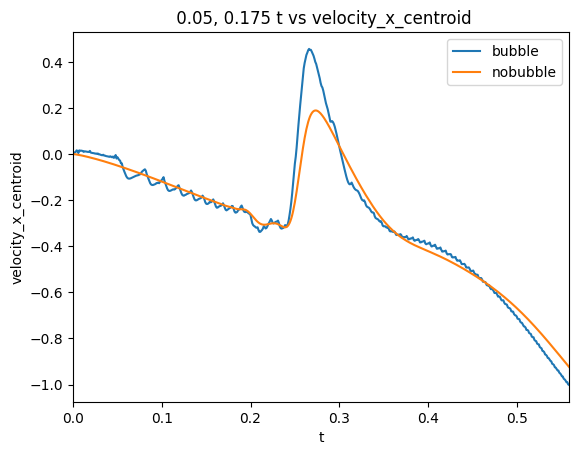

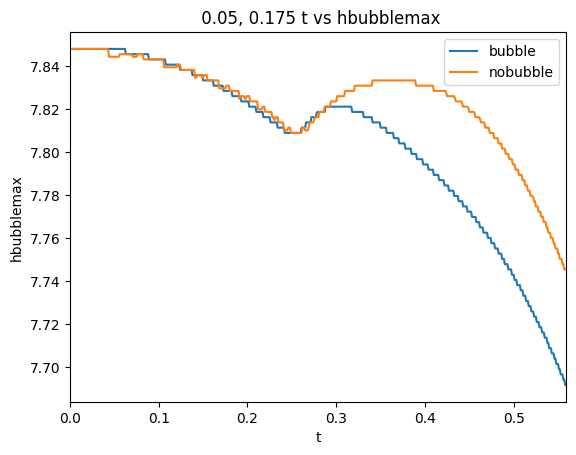

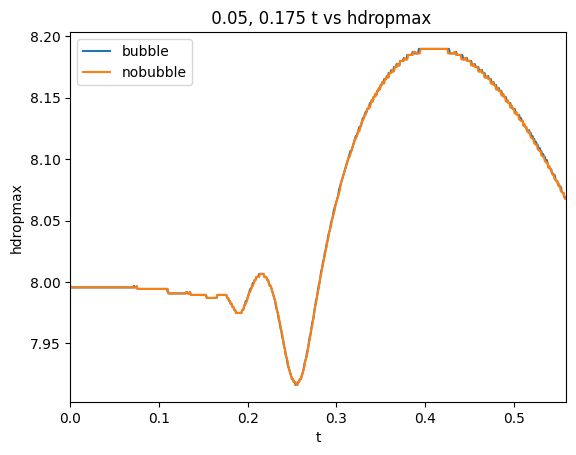

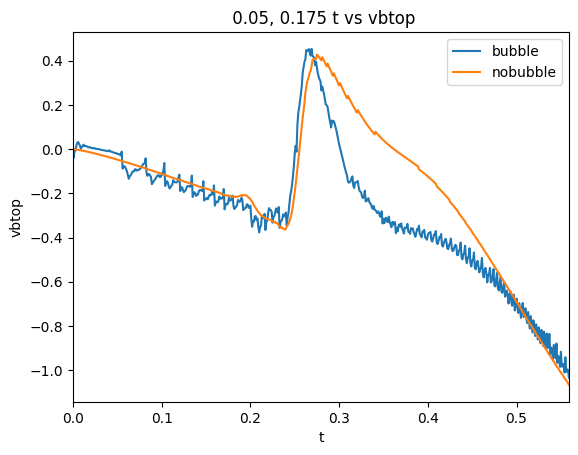

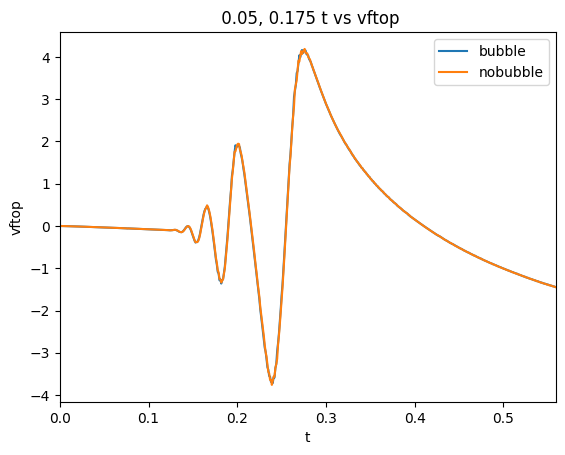

In [ ]:
column_names = ['x_centroid', 'velocity_x_centroid', 'hbubblemax', 'hdropmax', 'vbtop', 'vftop']

for i in range(1, bub.shape[1]):
    fig, ax = plt.figure(), plt.axes()
    ax.plot(bub[:, 0], bub[:, i], label='bubble')
    ax.plot(nbub[:, 0], nbub[:, i], label='nobubble')
    ax.set_xlabel('t')
    ax.set_ylabel(column_names[i-1])
    ax.set_title(f' 0.05, 0.175 t vs {column_names[i-1]}')
    ax.legend()
    ax.set_xlim(0, 0.559)
    plt.show()

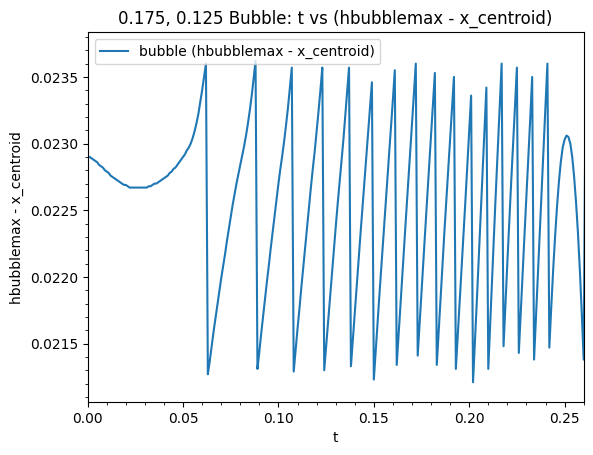

Maximum of bub[:, 3] - bub[:, 1]: 0.023710000000000342


In [ ]:
# Calculate the difference between hbubblemax and x_centroid for bubble
diff_h_x = bub[:, 3] - bub[:, 1]

# Create the plot
fig, ax = plt.figure(), plt.axes()
ax.plot(bub[:, 0], diff_h_x, label='bubble (hbubblemax - x_centroid)')
ax.set_xlabel('t')
ax.set_ylabel('hbubblemax - x_centroid')
ax.set_title('0.175, 0.125 Bubble: t vs (hbubblemax - x_centroid)')
ax.legend()
ax.minorticks_on()
ax.set_xlim(0, 0.26)
plt.show()
# Calculate the difference between hbubblemax and x_centroid for bubble
diff_h_x = bub[:, 3] - bub[:, 1]

# Find the maximum of this difference
max_diff_h_x = np.max(diff_h_x)

print(f"Maximum of bub[:, 3] - bub[:, 1]: {max_diff_h_x}")

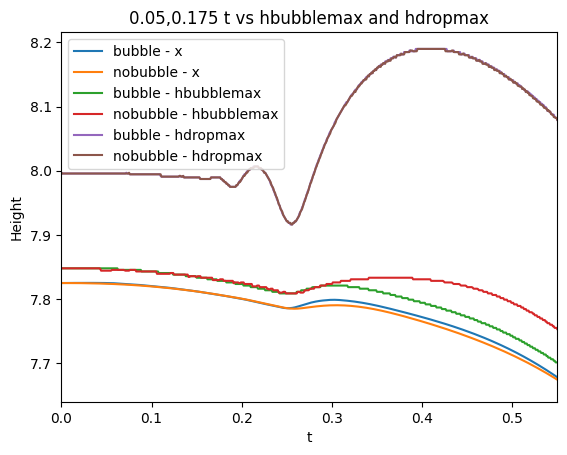

In [ ]:
fig, ax = plt.figure(), plt.axes()

# Plot hbubblemax for both bubble and nobubble
ax.plot(bub[:, 0], bub[:, 1], label='bubble - x')
ax.plot(nbub[:, 0], nbub[:, 1], label='nobubble - x')


ax.plot(bub[:, 0], bub[:, 3], label='bubble - hbubblemax')
ax.plot(nbub[:, 0], nbub[:, 3], label='nobubble - hbubblemax')
# Plot hdropmax for both bubble and nobubble
ax.plot(bub[:, 0], bub[:, 4], label='bubble - hdropmax')
ax.plot(nbub[:, 0], nbub[:, 4], label='nobubble - hdropmax')


ax.set_xlabel('t')
ax.set_ylabel('Height')
ax.set_title('0.05,0.175 t vs hbubblemax and hdropmax')
ax.legend()
ax.set_xlim(0, 0.55)
plt.show()

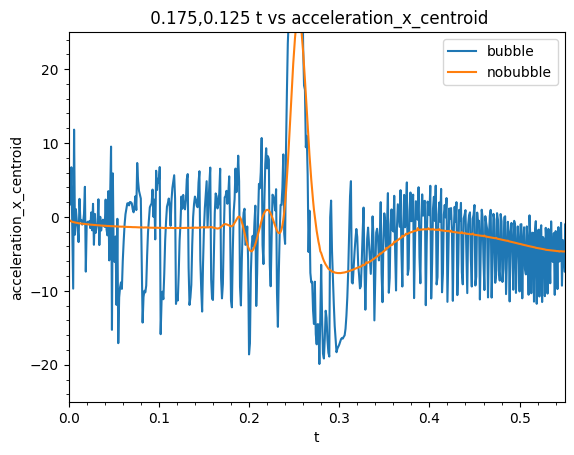

In [ ]:
%matplotlib inline
# Calculate acceleration for bubble data
acceleration_bubble = np.diff(bub[:, 2]) / 0.001
# Calculate acceleration for nobubble data
acceleration_nobubble = np.diff(nbub[:, 2]) / 0.001

# The time array for acceleration will be one element shorter, so we use all but the last time point
time_bubble = bub[:-1, 0]
time_nobubble = nbub[:-1, 0]

# Create the plot
fig, ax = plt.figure(), plt.axes()
ax.plot(time_bubble, acceleration_bubble, label='bubble')
ax.plot(time_nobubble, acceleration_nobubble, label='nobubble')
ax.set_xlabel('t')
ax.set_ylabel('acceleration_x_centroid')
ax.set_title(' 0.175,0.125 t vs acceleration_x_centroid')
ax.legend()
ax.set_xlim(0, 0.55)
ax.set_ylim(-25, 25)
ax.minorticks_on()
plt.show()

# 0.175 line


In [ ]:
b005 = load_filtered_data('/content/drive/MyDrive/test0.05,0.175/bub0.05,0.175')
b010 = load_filtered_data('/content/drive/MyDrive/line0.175/log0.10')
b015 = load_filtered_data('/content/drive/MyDrive/line0.175/log0.15')
b020 = load_filtered_data('/content/drive/MyDrive/line0.175/log0.20')
b025 = load_filtered_data('/content/drive/MyDrive/test0.25,0.175/b0.01vel')
b030 = load_filtered_data('/content/drive/MyDrive/line0.175/log0.30')

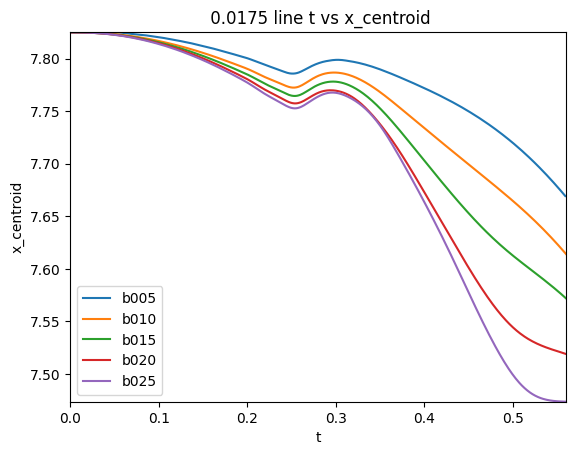

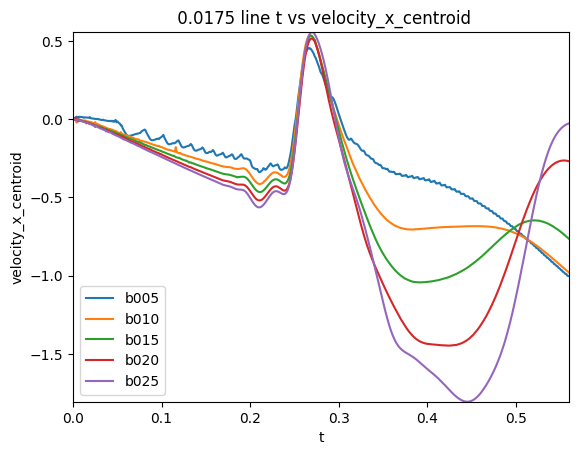

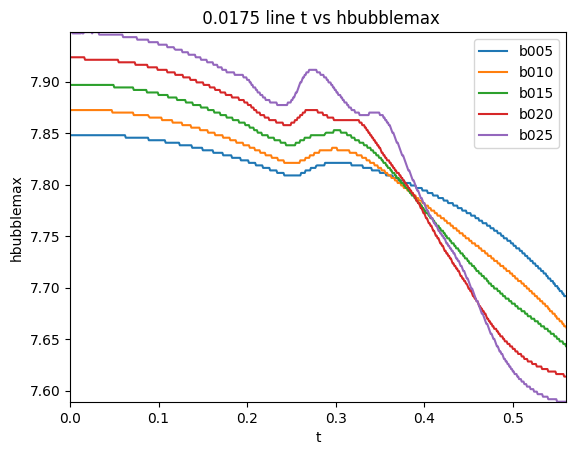

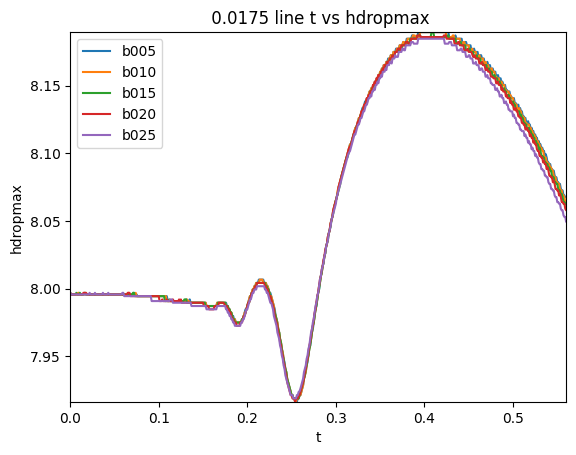

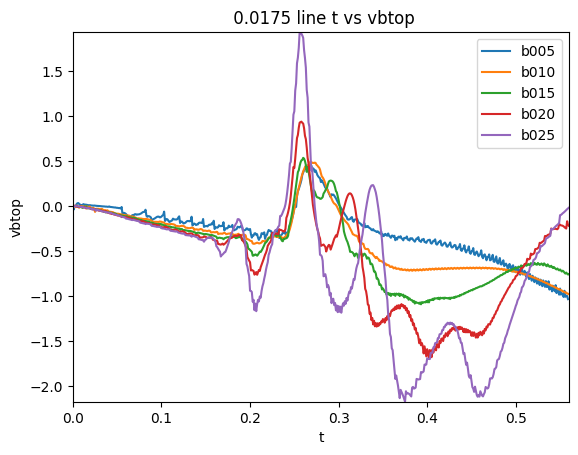

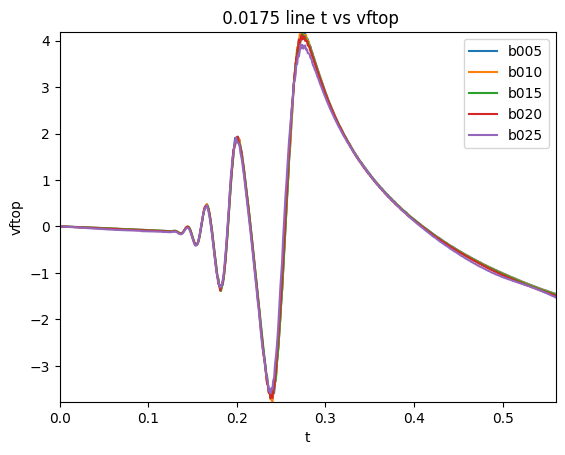

In [ ]:
column_names = ['x_centroid', 'velocity_x_centroid', 'hbubblemax', 'hdropmax', 'vbtop', 'vftop']

for i in range(1, bubble.shape[1]):
    fig, ax = plt.figure(), plt.axes()
    ax.plot(b005[:, 0], b005[:, i], label='b005')
    ax.plot(b010[:, 0], b010[:, i], label='b010')
    ax.plot(b015[:, 0], b015[:, i], label='b015')
    ax.plot(b020[:, 0], b020[:, i], label='b020')
    ax.plot(b025[:, 0], b025[:, i], label='b025')
    ax.set_xlabel('t')
    ax.set_ylabel(column_names[i-1])
    ax.set_title(f' 0.0175 line t vs {column_names[i-1]}')
    ax.legend()
    ax.set_xlim(0, 0.56)

    # Filter data within the x-axis range (0 to 0.56) for each dataset
    b005_filtered = b005[(b005[:, 0] >= 0) & (b005[:, 0] <= 0.56)]
    b010_filtered = b010[(b010[:, 0] >= 0) & (b010[:, 0] <= 0.56)]
    b015_filtered = b015[(b015[:, 0] >= 0) & (b015[:, 0] <= 0.56)]
    b020_filtered = b020[(b020[:, 0] >= 0) & (b020[:, 0] <= 0.56)]
    b025_filtered = b025[(b025[:, 0] >= 0) & (b025[:, 0] <= 0.56)]


    # Set y-limits based on the filtered data in the current column across b005 to b025 datasets
    min_y = min(b005_filtered[:, i].min(), b010_filtered[:, i].min(), b015_filtered[:, i].min(), b020_filtered[:, i].min(), b025_filtered[:, i].min())
    max_y = max(b005_filtered[:, i].max(), b010_filtered[:, i].max(), b015_filtered[:, i].max(), b020_filtered[:, i].max(), b025_filtered[:, i].max())
    ax.set_ylim(min_y, max_y)
    plt.show()

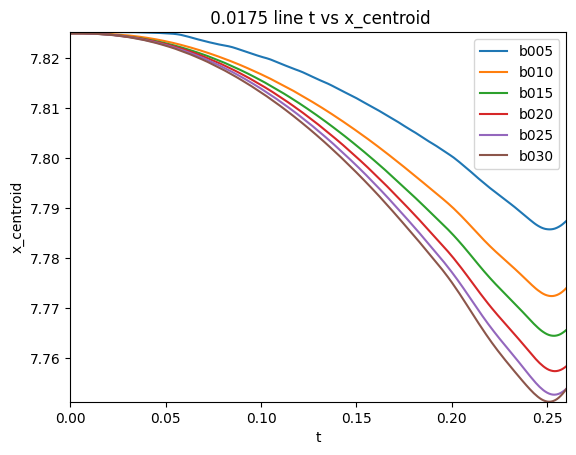

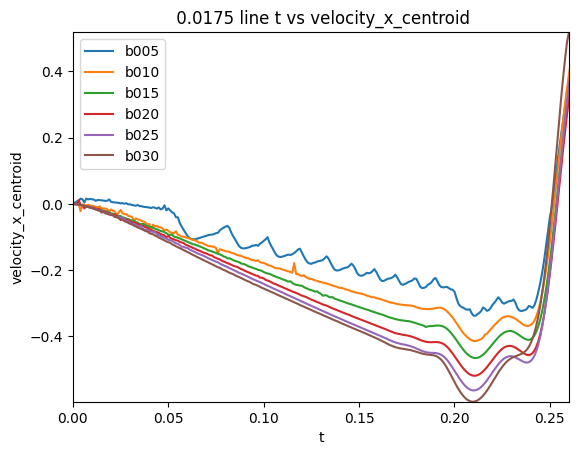

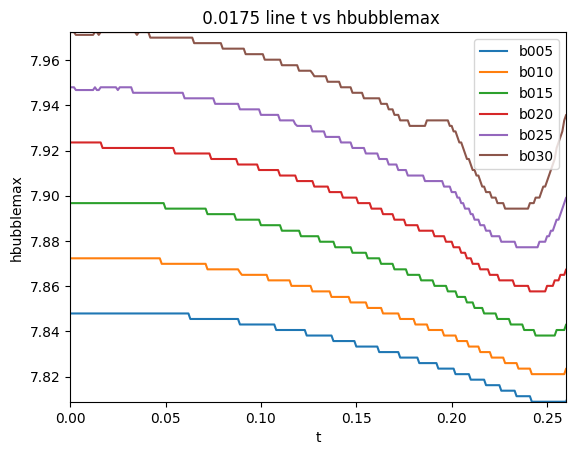

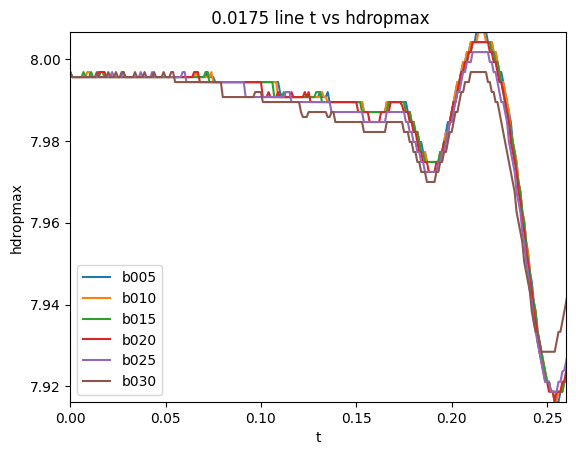

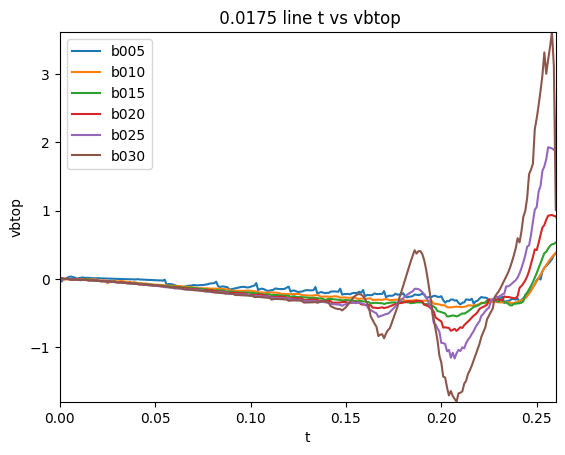

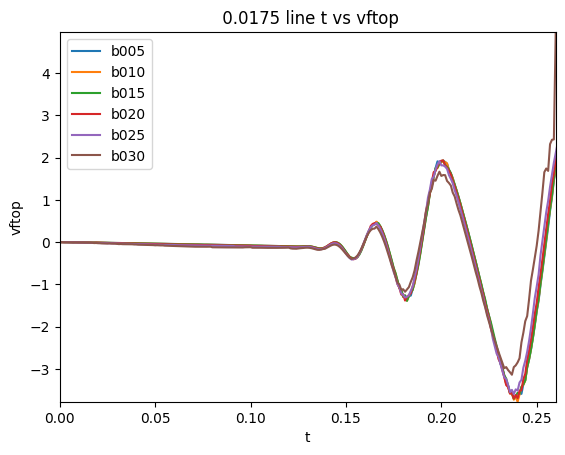

In [ ]:
column_names = ['x_centroid', 'velocity_x_centroid', 'hbubblemax', 'hdropmax', 'vbtop', 'vftop']

for i in range(1, bubble.shape[1]):
    fig, ax = plt.figure(), plt.axes()
    ax.plot(b005[:, 0], b005[:, i], label='b005')
    ax.plot(b010[:, 0], b010[:, i], label='b010')
    ax.plot(b015[:, 0], b015[:, i], label='b015')
    ax.plot(b020[:, 0], b020[:, i], label='b020')
    ax.plot(b025[:, 0], b025[:, i], label='b025')
    ax.plot(b030[:, 0], b030[:, i], label='b030')
    ax.set_xlabel('t')
    ax.set_ylabel(column_names[i-1])
    ax.set_title(f' 0.0175 line t vs {column_names[i-1]}')
    ax.legend()
    ax.set_xlim(0, 0.26)

    # Filter data within the x-axis range (0 to 0.56) for each dataset
    b005_filtered = b005[(b005[:, 0] >= 0) & (b005[:, 0] <= 0.26)]
    b010_filtered = b010[(b010[:, 0] >= 0) & (b010[:, 0] <= 0.26)]
    b015_filtered = b015[(b015[:, 0] >= 0) & (b015[:, 0] <= 0.26)]
    b020_filtered = b020[(b020[:, 0] >= 0) & (b020[:, 0] <= 0.26)]
    b025_filtered = b025[(b025[:, 0] >= 0) & (b025[:, 0] <= 0.26)]
    b030_filtered = b030[(b030[:, 0] >= 0) & (b030[:, 0] <= 0.26)]


    # Set y-limits based on the filtered data in the current column across b005 to b025 datasets
    min_y = min(b005_filtered[:, i].min(), b010_filtered[:, i].min(), b015_filtered[:, i].min(), b020_filtered[:, i].min(), b025_filtered[:, i].min(),b030_filtered[:, i].min())
    max_y = max(b005_filtered[:, i].max(), b010_filtered[:, i].max(), b015_filtered[:, i].max(), b020_filtered[:, i].max(), b025_filtered[:, i].max(),b030_filtered[:, i].max())
    ax.set_ylim(min_y, max_y)
    plt.show()

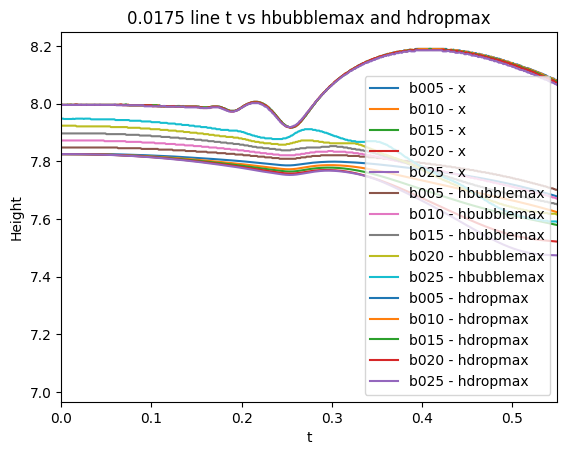

In [ ]:
fig, ax = plt.figure(), plt.axes()

# Plot x_centroid for b005 to b025
ax.plot(b005[:, 0], b005[:, 1], label='b005 - x')
ax.plot(b010[:, 0], b010[:, 1], label='b010 - x')
ax.plot(b015[:, 0], b015[:, 1], label='b015 - x')
ax.plot(b020[:, 0], b020[:, 1], label='b020 - x')
ax.plot(b025[:, 0], b025[:, 1], label='b025 - x')

# Plot hbubblemax for b005 to b025
ax.plot(b005[:, 0], b005[:, 3], label='b005 - hbubblemax')
ax.plot(b010[:, 0], b010[:, 3], label='b010 - hbubblemax')
ax.plot(b015[:, 0], b015[:, 3], label='b015 - hbubblemax')
ax.plot(b020[:, 0], b020[:, 3], label='b020 - hbubblemax')
ax.plot(b025[:, 0], b025[:, 3], label='b025 - hbubblemax')

# Plot hdropmax for b005 to b025
ax.plot(b005[:, 0], b005[:, 4], label='b005 - hdropmax')
ax.plot(b010[:, 0], b010[:, 4], label='b010 - hdropmax')
ax.plot(b015[:, 0], b015[:, 4], label='b015 - hdropmax')
ax.plot(b020[:, 0], b020[:, 4], label='b020 - hdropmax')
ax.plot(b025[:, 0], b025[:, 4], label='b025 - hdropmax')


ax.set_xlabel('t')
ax.set_ylabel('Height')
ax.set_title('0.0175 line t vs hbubblemax and hdropmax')
ax.legend()
ax.set_xlim(0, 0.55)
plt.show()

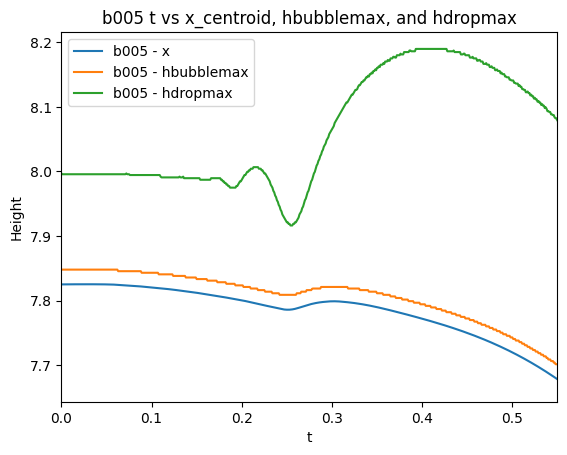

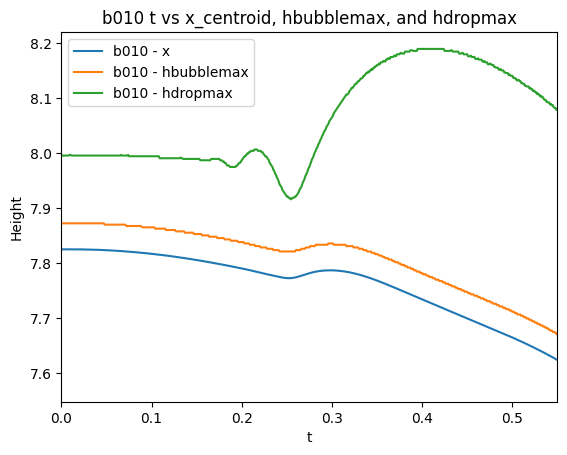

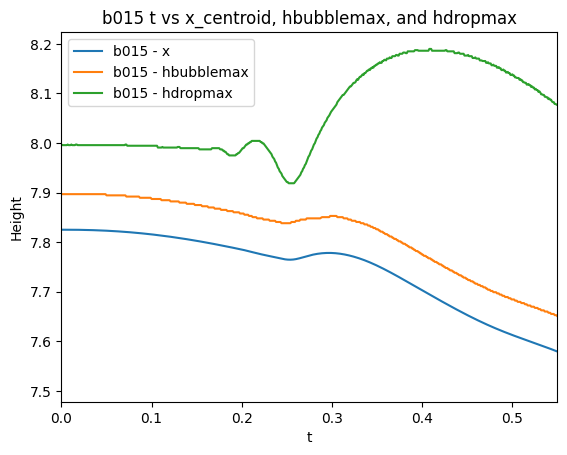

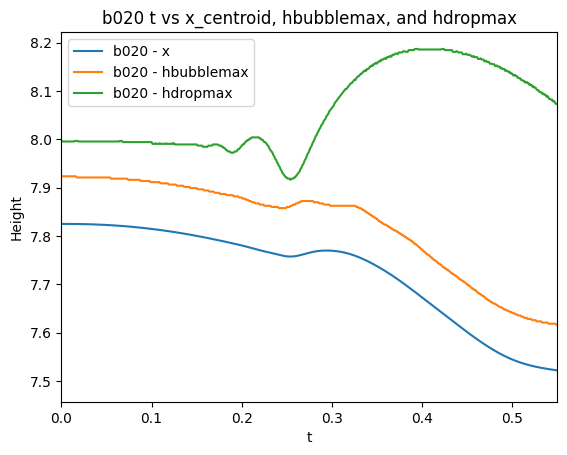

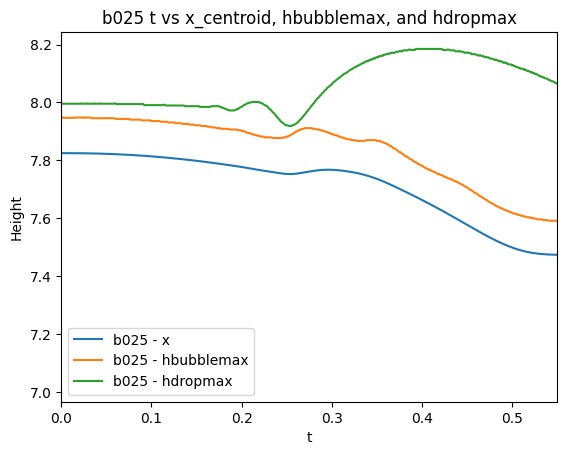

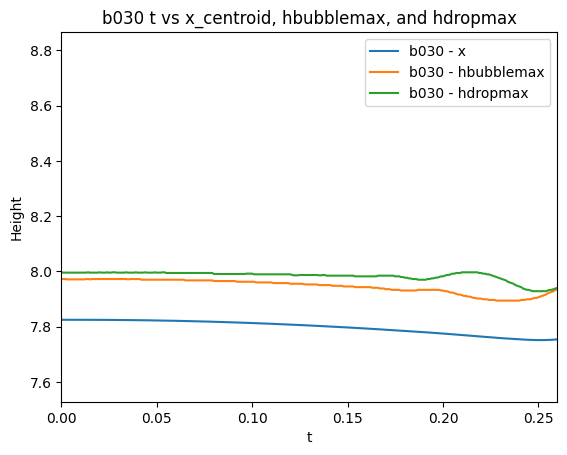

In [ ]:
datasets = {
    'b005': b005,
    'b010': b010,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

column_indices = {
    'x_centroid': 1,
    'hbubblemax': 3,
    'hdropmax': 4
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()
    ax.plot(data[:, 0], data[:, column_indices['x_centroid']], label=f'{name} - x')
    ax.plot(data[:, 0], data[:, column_indices['hbubblemax']], label=f'{name} - hbubblemax')
    ax.plot(data[:, 0], data[:, column_indices['hdropmax']], label=f'{name} - hdropmax')

    ax.set_xlabel('t')
    ax.set_ylabel('Height')
    ax.set_title(f'{name} t vs x_centroid, hbubblemax, and hdropmax')
    ax.legend()
    if name == 'b030':
        ax.set_xlim(0, 0.26)
    else:
        ax.set_xlim(0, 0.55) # Assuming a similar time range is desired
    plt.show()

In [ ]:
datasets = {
    'b005': b005,
    'b010': b010,
    'b015': b015,
    'b020': b020,
    'b025': b025
}


column_indices_to_plot = [1, 3, 4] # Columns 1 (x_centroid), 3 (hbubblemax), and 4 (hdropmax)
column_names_to_plot = ['x_centroid', 'hbubblemax', 'hdropmax']

for name, data in datasets.items():

    xlim_min, xlim_max = 0.26, 0.5

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    print(name," 0.175  ",np.polyfit(filtered_data[:, 0], filtered_data[:, 1]-7.0 , 1)," \n")


b005  0.175   [-0.32017504  0.89435971]  

b010  0.175   [-0.54878415  0.94919669]  

b015  0.175   [-0.77916304  1.00953457]  

b020  0.175   [-1.06519626  1.08879197]  

b025  0.175   [-1.22886886  1.13849349]  



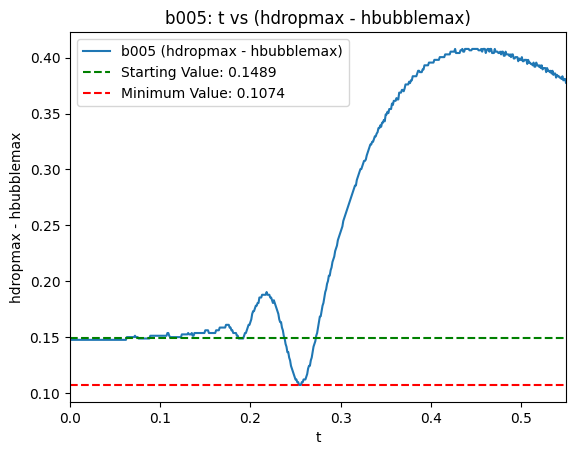

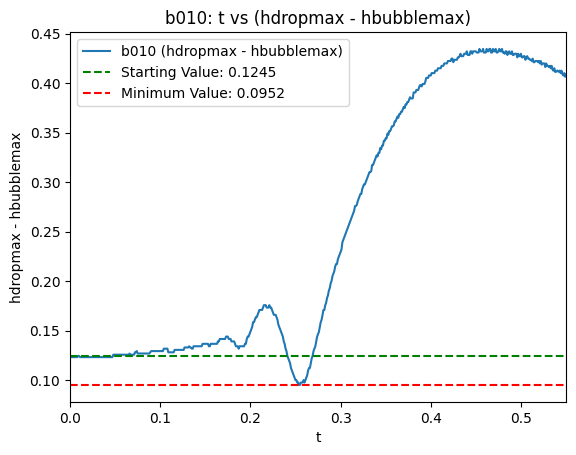

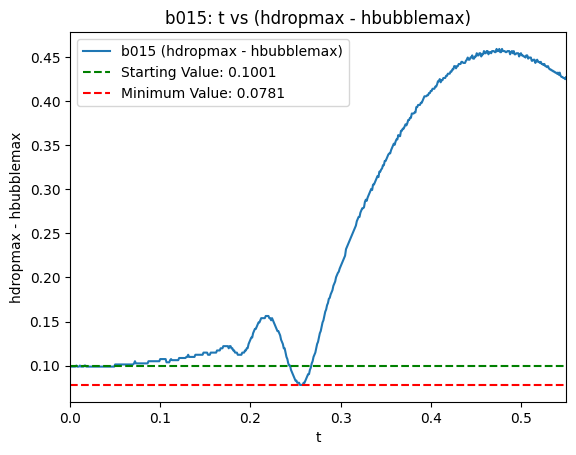

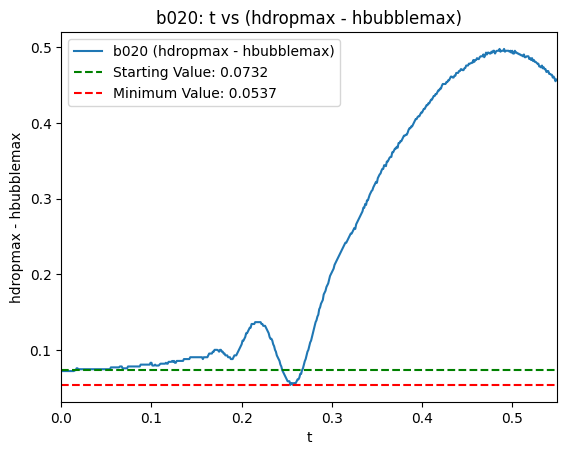

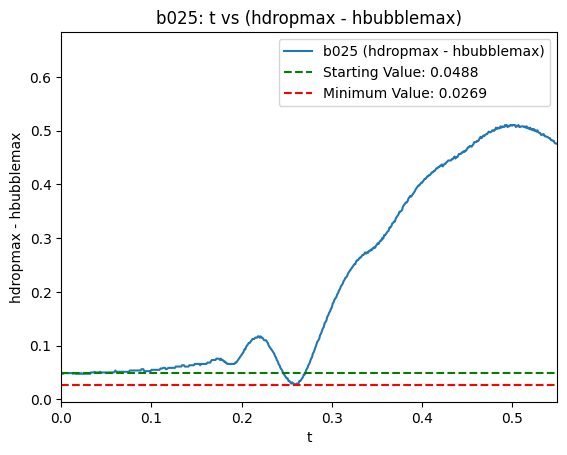

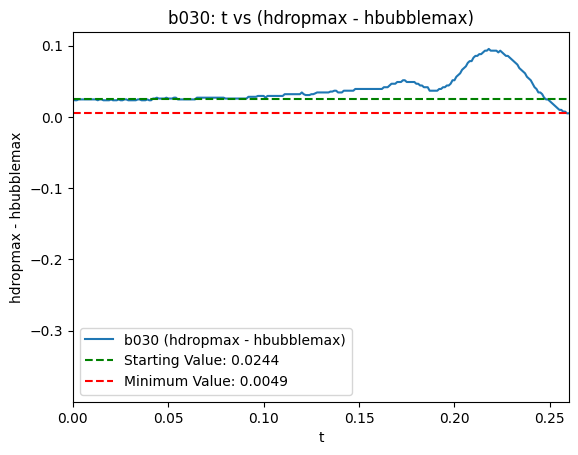

In [ ]:
datasets = {
    'b005': b005,
    'b010': b010,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()
    # Calculate the difference between column 4 (hdropmax) and column 3 (hbubblemax)
    diff_h = data[:, 4] - data[:, 3]
    ax.plot(data[:, 0], diff_h, label=f'{name} (hdropmax - hbubblemax)')

    ax.set_xlabel('t')
    ax.set_ylabel('hdropmax - hbubblemax')
    ax.set_title(f'{name}: t vs (hdropmax - hbubblemax)')
    ax.legend()

    if name == 'b030':
        xlim_min, xlim_max = 0, 0.26
    else:
        xlim_min, xlim_max = 0, 0.55

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    filtered_diff_h = filtered_data[:, 4] - filtered_data[:, 3]

    # Find the starting value (at the minimum x within the range)
    starting_x_index = np.argmin(abs(filtered_data[:, 0] - xlim_min))
    starting_value = filtered_diff_h[starting_x_index]


    # Find the minimum value within the x-axis range
    min_value = np.min(filtered_diff_h)

    # Add horizontal lines for starting and minimum values
    ax.axhline(y=starting_value, color='g', linestyle='--', label=f'Starting Value: {starting_value:.4f}')
    ax.axhline(y=min_value, color='r', linestyle='--', label=f'Minimum Value: {min_value:.4f}')
    ax.legend()

    plt.show()

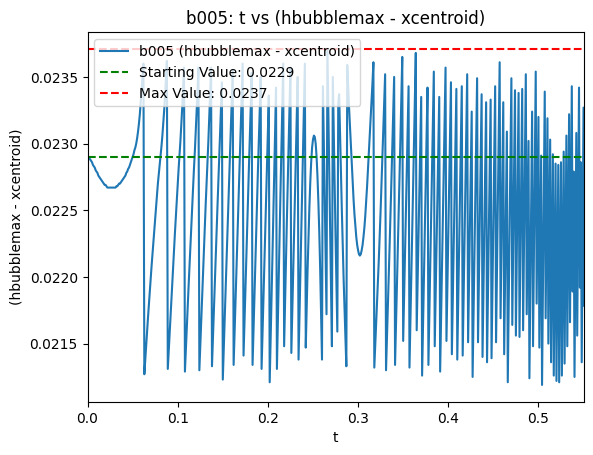

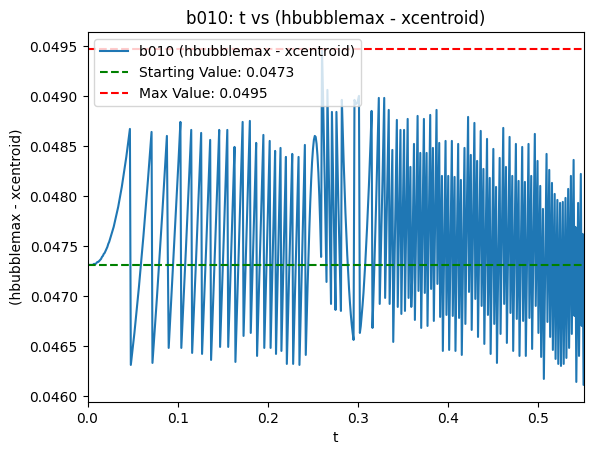

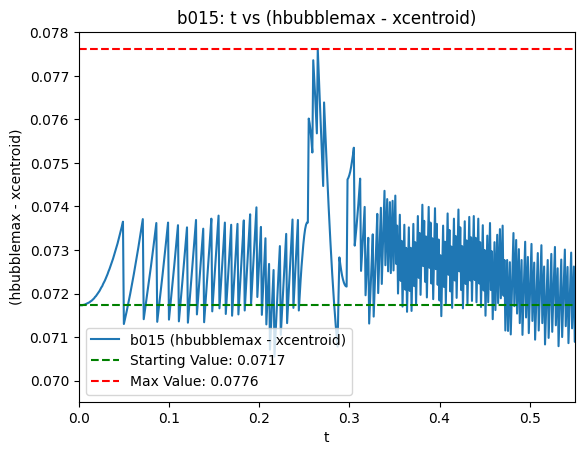

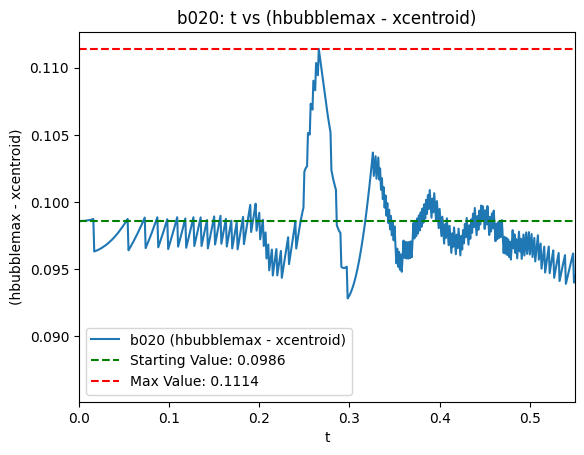

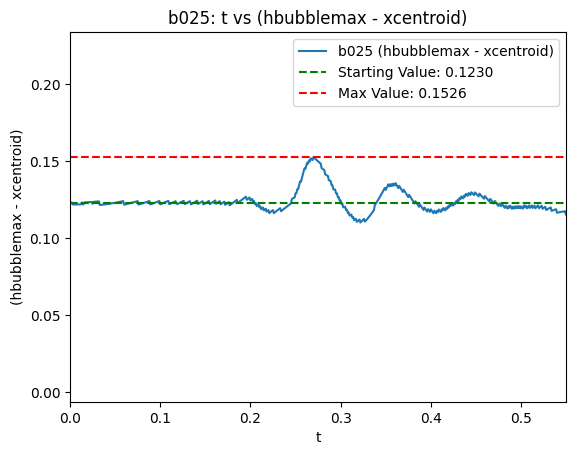

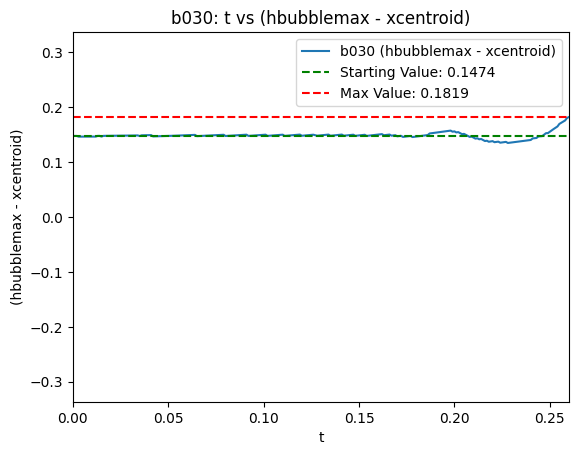

In [ ]:
datasets = {
    'b005': b005,
    'b010': b010,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()
    # Calculate the difference between column 3  and column 1
    diff_h = data[:, 3] - data[:, 1]
    ax.plot(data[:, 0], diff_h, label=f'{name} (hbubblemax - xcentroid)')

    ax.set_xlabel('t')
    ax.set_ylabel('(hbubblemax - xcentroid)')
    ax.set_title(f'{name}: t vs (hbubblemax - xcentroid)')
    ax.legend()

    if name == 'b030':
        xlim_min, xlim_max = 0, 0.26
    else:
        xlim_min, xlim_max = 0, 0.55

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    filtered_diff_h = filtered_data[:, 3] - filtered_data[:, 1]

    # Find the starting value (at the minimum x within the range)
    starting_x_index = np.argmin(abs(filtered_data[:, 0] - xlim_min))
    starting_value = filtered_diff_h[starting_x_index]


    # Find the minimum value within the x-axis range
    min_value = np.max(filtered_diff_h)

    # Add horizontal lines for starting and minimum values
    ax.axhline(y=starting_value, color='g', linestyle='--', label=f'Starting Value: {starting_value:.4f}')
    ax.axhline(y=min_value, color='r', linestyle='--', label=f'Max Value: {min_value:.4f}')
    ax.legend()

    plt.show()

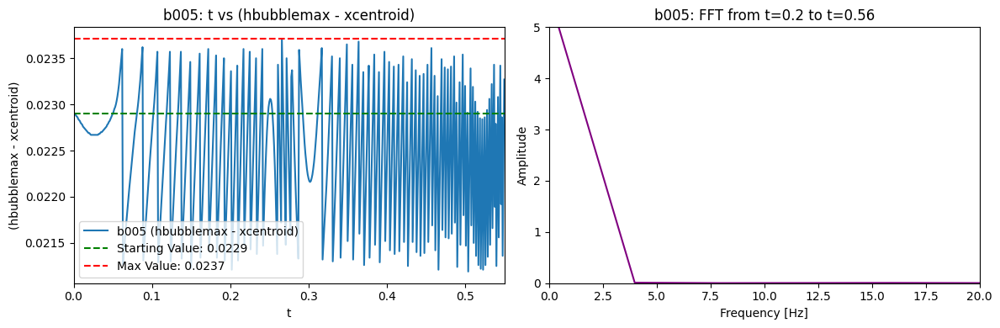

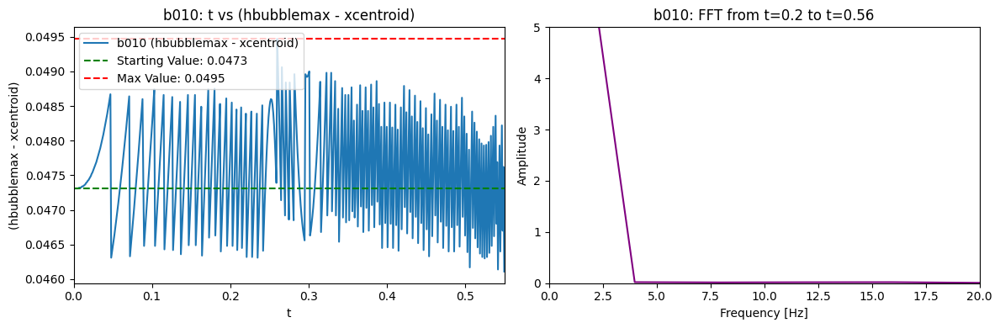

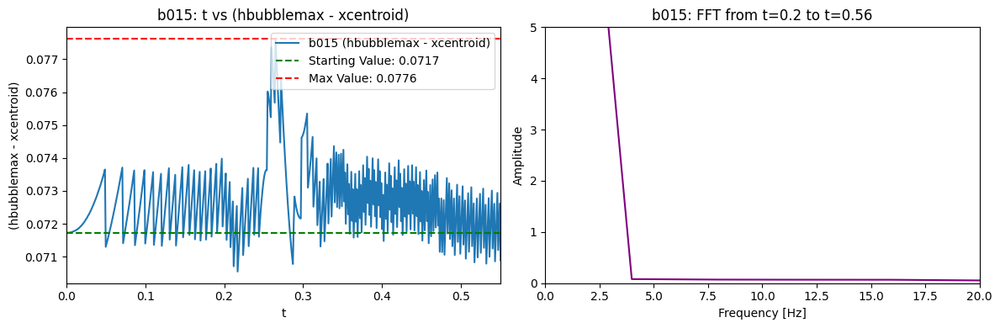

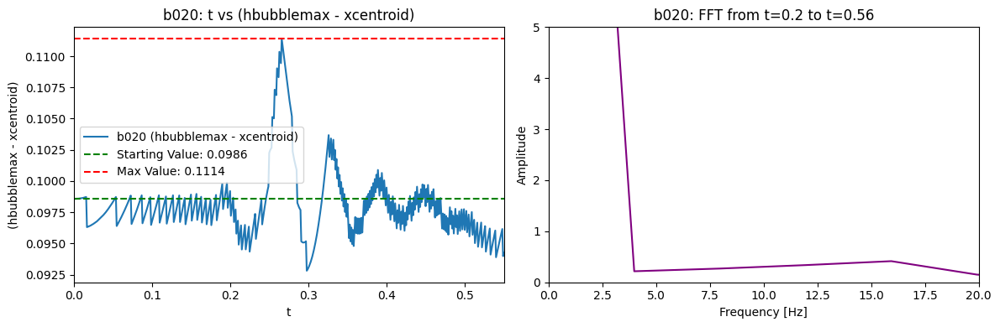

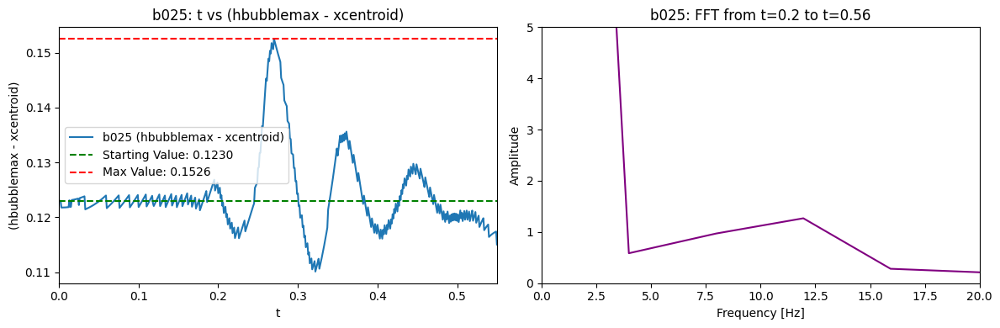

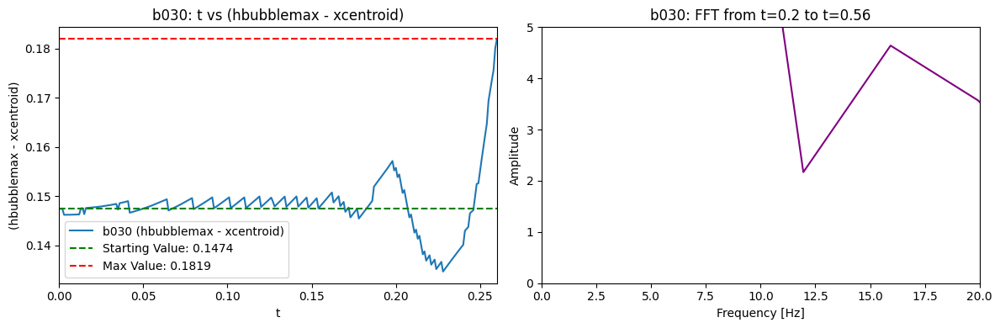

In [ ]:
datasets = {
    'b005': b005,
    'b010': b010,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    # Set x-axis limits depending on the dataset
    if name == 'b030':
        xlim_min, xlim_max = 0, 0.26
    else:
        xlim_min, xlim_max = 0, 0.55

    # Filter data for plotting
    plot_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    t_plot = plot_data[:, 0]
    diff_h_plot = plot_data[:, 3] - plot_data[:, 1]

    # --- FFT section: use only data in the 0.2 to 0.56 time range ---
    fft_range_min, fft_range_max = 0.15, 0.4
    fft_data = data[(data[:, 0] >= fft_range_min) & (data[:, 0] <= fft_range_max)]
    t_fft = fft_data[:, 0]
    diff_h_fft = fft_data[:, 3] - fft_data[:, 1]

    N = len(t_fft)
    dt = np.mean(np.diff(t_fft))  # Average time step
    fft_vals = np.fft.fft(diff_h_fft)
    fft_freqs = np.fft.fftfreq(N, d=dt)

    # Keep only positive frequencies
    pos_freqs = fft_freqs[:N // 2]
    pos_fft_vals = np.abs(fft_vals[:N // 2])

    # --- Create subplots ---
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    # --- Time-domain plot ---
    ax1.plot(t_plot, diff_h_plot, label=f'{name} (hbubblemax - xcentroid)')
    ax1.set_xlabel('t')
    ax1.set_ylabel('(hbubblemax - xcentroid)')
    ax1.set_title(f'{name}: t vs (hbubblemax - xcentroid)')
    ax1.set_xlim(xlim_min, xlim_max)

    # Starting and max values in the plot range
    start_idx = np.argmin(abs(t_plot - xlim_min))
    start_val = diff_h_plot[start_idx]
    max_val = np.max(diff_h_plot)

    ax1.axhline(y=start_val, color='g', linestyle='--', label=f'Starting Value: {start_val:.4f}')
    ax1.axhline(y=max_val, color='r', linestyle='--', label=f'Max Value: {max_val:.4f}')
    ax1.legend()

    # --- FFT plot ---
    ax2.plot(pos_freqs, pos_fft_vals, color='purple')
    ax2.set_title(f'{name}: FFT from t=0.2 to t=0.56')
    ax2.set_xlabel('Frequency [Hz]')
    ax2.set_ylabel('Amplitude')
    ax2.set_xlim(0,20)  # Optionally limit further if needed
    ax2.set_ylim(0, 5)  # Optionally limit further if needed
    plt.tight_layout()
    plt.show()

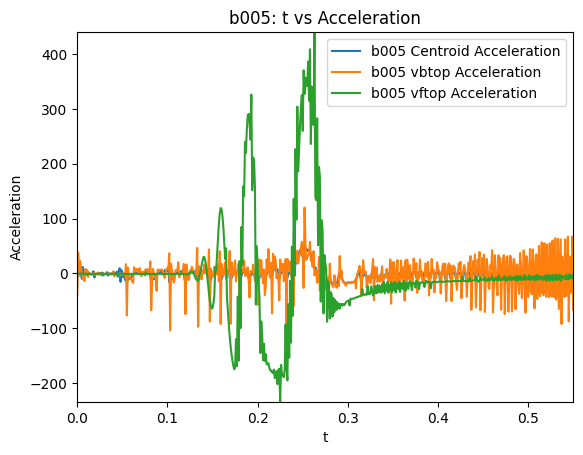

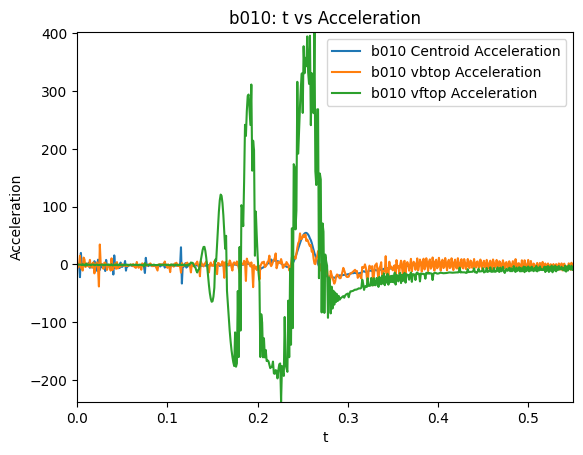

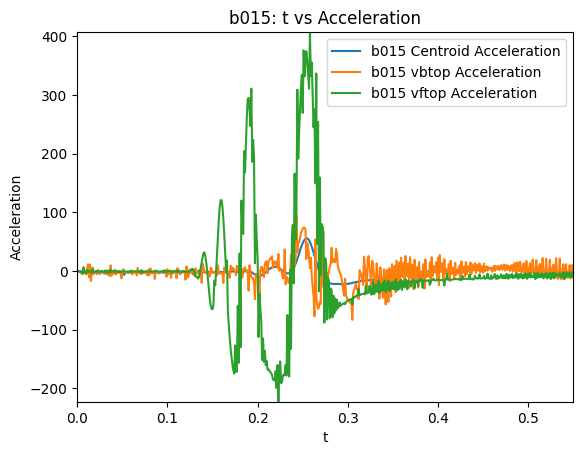

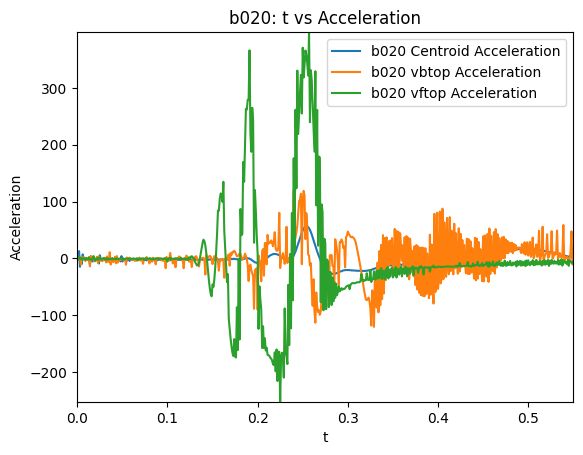

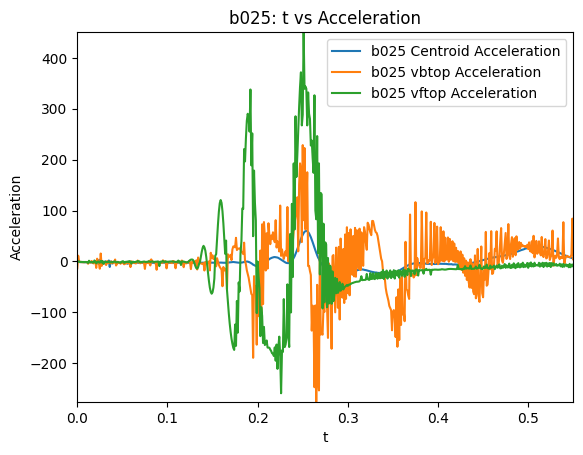

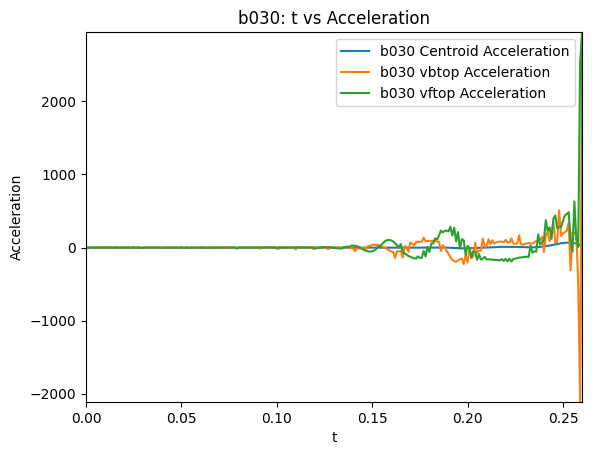

In [ ]:
datasets = {
    'b005': b005,
    'b010': b010,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()
    # Calculate acceleration (difference of column 2 divided by time step 0.001)
    acceleration_centroid = np.diff(data[:, 2]) / 0.001
    # Calculate acceleration for vbtop (column 5)
    acceleration_vbtop = np.diff(data[:, 5]) / 0.001
    # Calculate acceleration for vftop (column 6)
    acceleration_vftop = np.diff(data[:, 6]) / 0.001

    # The time array for acceleration will be one element shorter
    time_accel = data[:-1, 0]

    ax.plot(time_accel, acceleration_centroid, label=f'{name} Centroid Acceleration')
    ax.plot(time_accel, acceleration_vbtop, label=f'{name} vbtop Acceleration')
    ax.plot(time_accel, acceleration_vftop, label=f'{name} vftop Acceleration')


    ax.set_xlabel('t')
    ax.set_ylabel('Acceleration')
    ax.set_title(f'{name}: t vs Acceleration')
    ax.legend()

    if name == 'b030':
        xlim_min, xlim_max = 0, 0.26
    else:
        xlim_min, xlim_max = 0, 0.55

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_time_accel = time_accel[(time_accel >= xlim_min) & (time_accel <= xlim_max)]
    filtered_acceleration_centroid = acceleration_centroid[(time_accel >= xlim_min) & (time_accel <= xlim_max)]
    filtered_acceleration_vbtop = acceleration_vbtop[(time_accel >= xlim_min) & (time_accel <= xlim_max)]
    filtered_acceleration_vftop = acceleration_vftop[(time_accel >= xlim_min) & (time_accel <= xlim_max)]


    # Set appropriate y-limits based on the filtered acceleration data
    min_y = min(np.min(filtered_acceleration_centroid), np.min(filtered_acceleration_vbtop), np.min(filtered_acceleration_vftop))
    max_y = max(np.max(filtered_acceleration_centroid), np.max(filtered_acceleration_vbtop), np.max(filtered_acceleration_vftop))
    ax.set_ylim(min_y, max_y)


    plt.show()

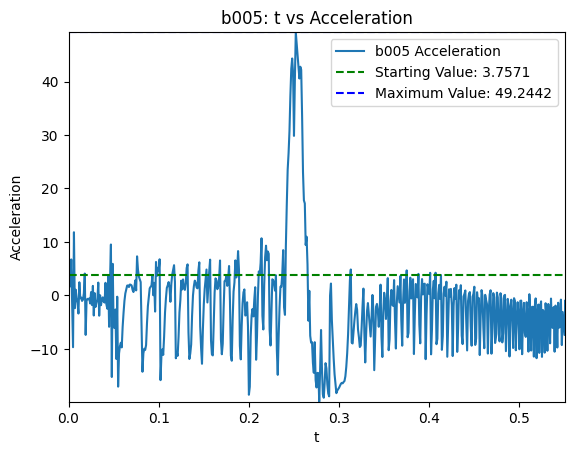

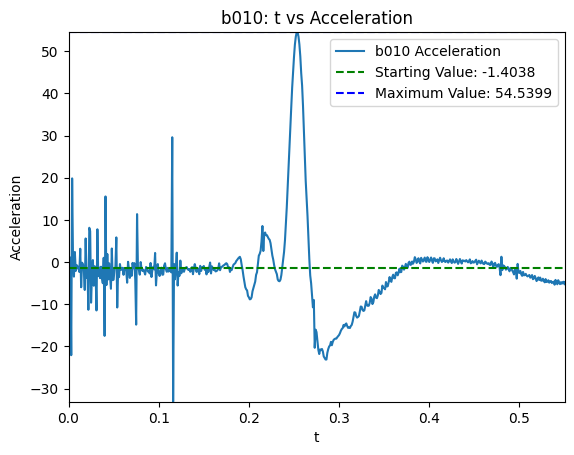

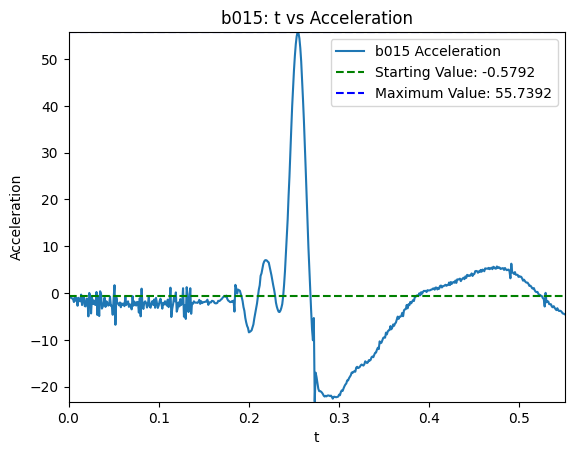

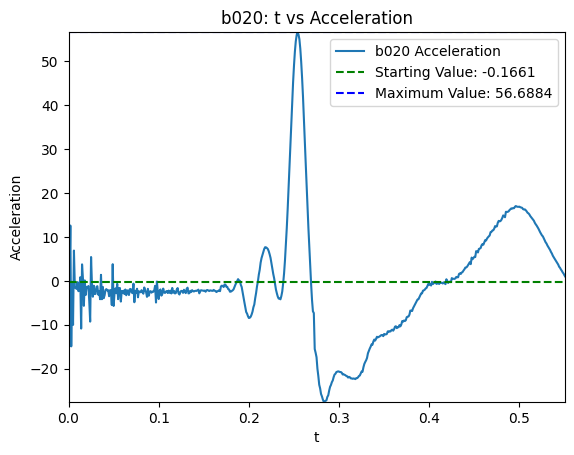

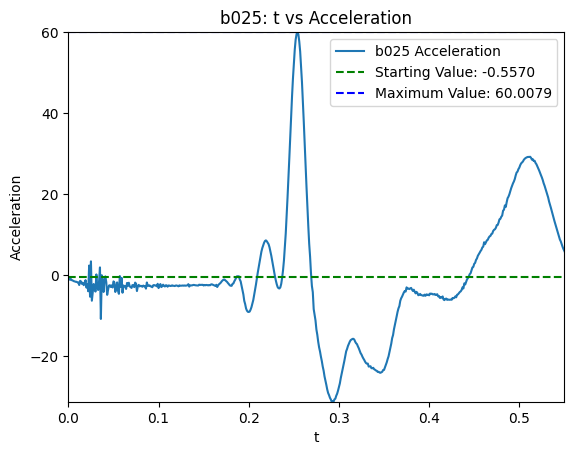

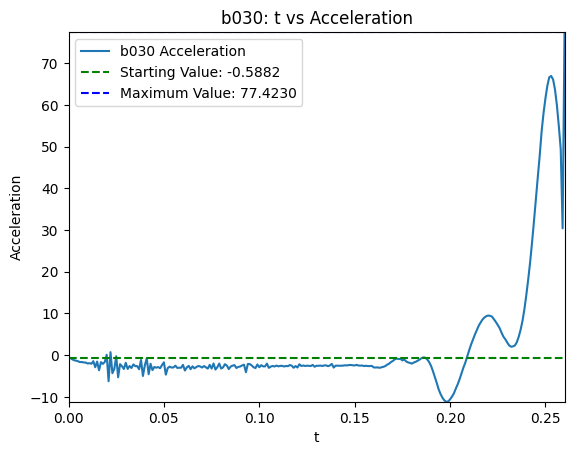

In [ ]:
datasets = {
    'b005': b005,
    'b010': b010,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()
    # Calculate acceleration (difference of column 2 divided by time step 0.001)
    acceleration = np.diff(data[:, 2]) / 0.001
    # The time array for acceleration will be one element shorter
    time_accel = data[:-1, 0]

    ax.plot(time_accel, acceleration, label=f'{name} Acceleration')

    ax.set_xlabel('t')
    ax.set_ylabel('Acceleration')
    ax.set_title(f'{name}: t vs Acceleration')
    ax.legend()

    if name == 'b030':
        xlim_min, xlim_max = 0, 0.26
    else:
        xlim_min, xlim_max = 0, 0.55

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_time_accel = time_accel[(time_accel >= xlim_min) & (time_accel <= xlim_max)]
    filtered_acceleration = acceleration[(time_accel >= xlim_min) & (time_accel <= xlim_max)]

    # Find the starting value (at the minimum x within the range)
    starting_x_index = np.argmin(abs(filtered_time_accel - xlim_min))
    starting_value = filtered_acceleration[starting_x_index]

    # Find the maximum value within the x-axis range
    max_value = np.max(filtered_acceleration)

    # Add horizontal lines for starting and maximum values
    ax.axhline(y=starting_value, color='g', linestyle='--', label=f'Starting Value: {starting_value:.4f}')
    ax.axhline(y=max_value, color='b', linestyle='--', label=f'Maximum Value: {max_value:.4f}')
    ax.legend()

    # Set appropriate y-limits based on the filtered acceleration data
    min_y = np.min(filtered_acceleration)
    max_y = np.max(filtered_acceleration)
    ax.set_ylim(min_y, max_y)


    plt.show()

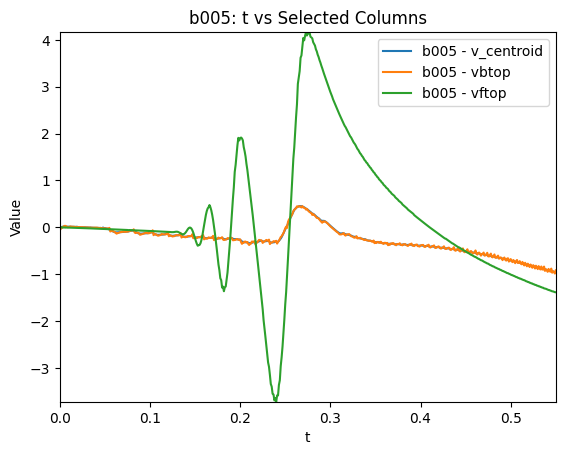

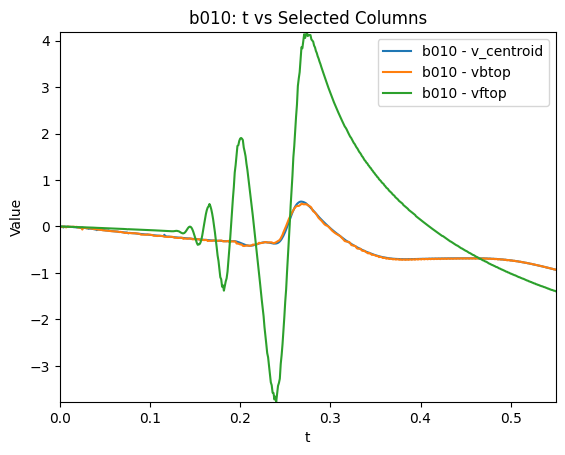

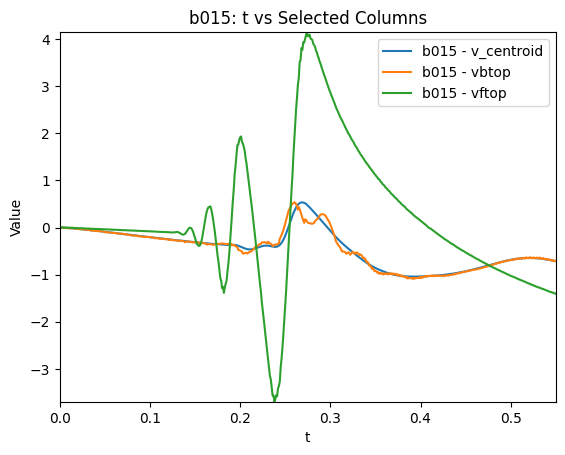

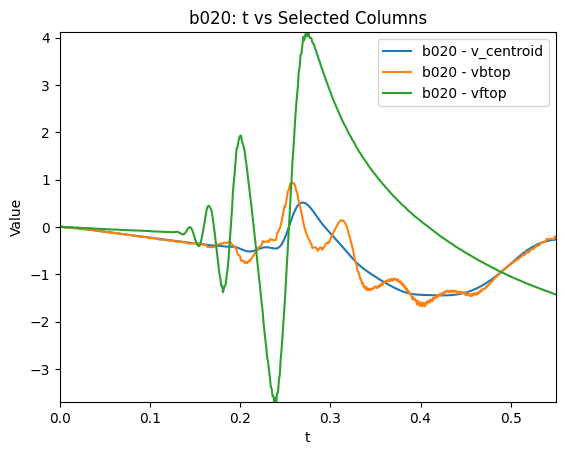

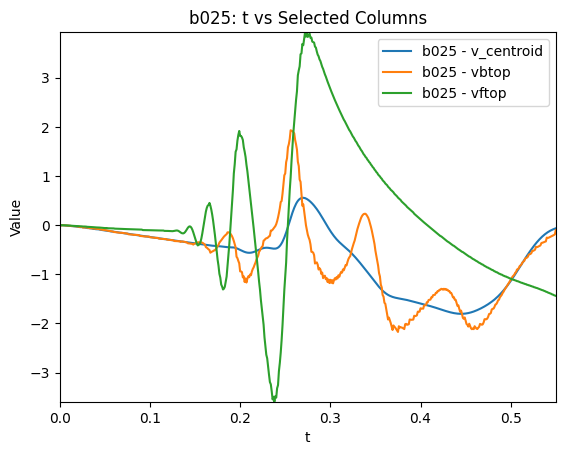

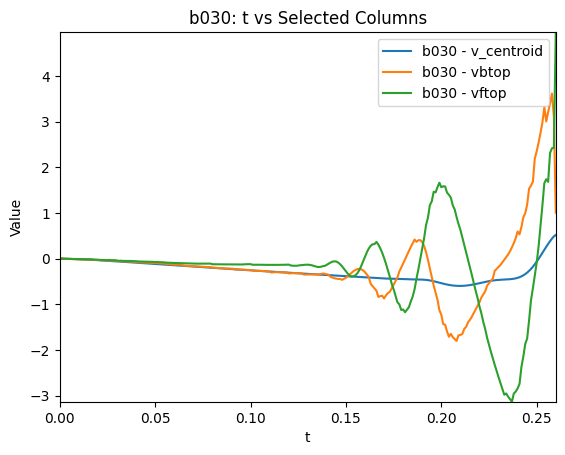

In [ ]:
datasets = {
    'b005': b005,
    'b010': b010,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

column_indices_to_plot = [2, 5, 6] # Columns 1 (v_centroid), 5 (vbtop), and 6 (vftop)
column_names_to_plot = ['v_centroid', 'vbtop', 'vftop']

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    if name == 'b030':
        xlim_min, xlim_max = 0, 0.26
    else:
        xlim_min, xlim_max = 0, 0.55

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]

    for i, col_index in enumerate(column_indices_to_plot):
        ax.plot(filtered_data[:, 0], filtered_data[:, col_index], label=f'{name} - {column_names_to_plot[i]}')

    ax.set_xlabel('t')
    ax.set_ylabel('Value')
    ax.set_title(f'{name}: t vs Selected Columns')
    ax.legend()
    ax.set_xlim(xlim_min, xlim_max)

    # Set appropriate y-limits based on the filtered data in the selected columns
    min_y = np.min(filtered_data[:, column_indices_to_plot])
    max_y = np.max(filtered_data[:, column_indices_to_plot])
    ax.set_ylim(min_y, max_y)

    plt.show()

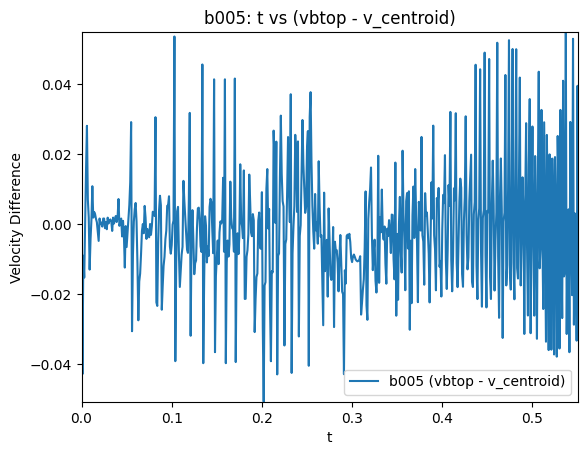

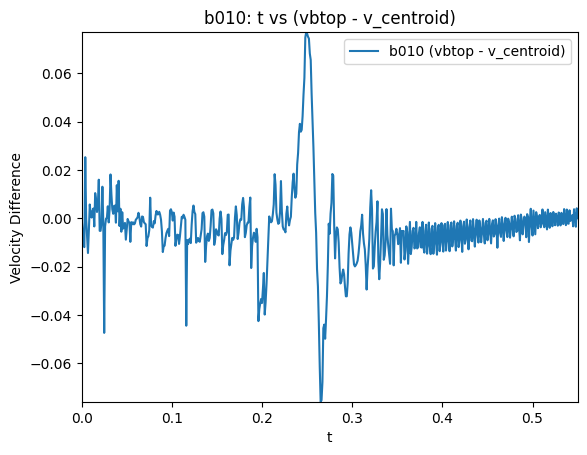

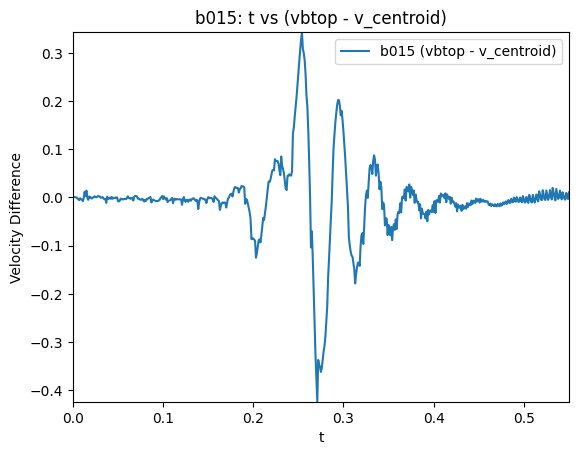

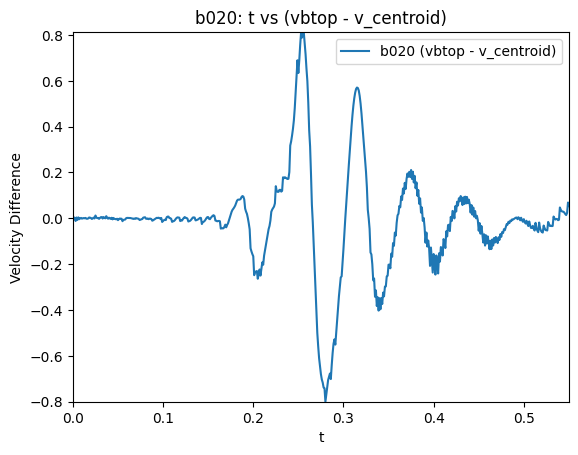

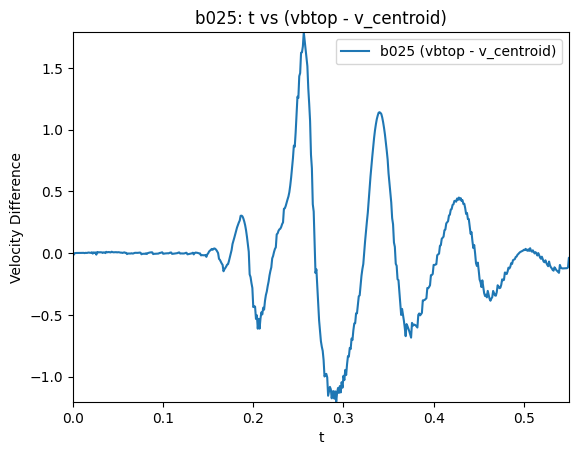

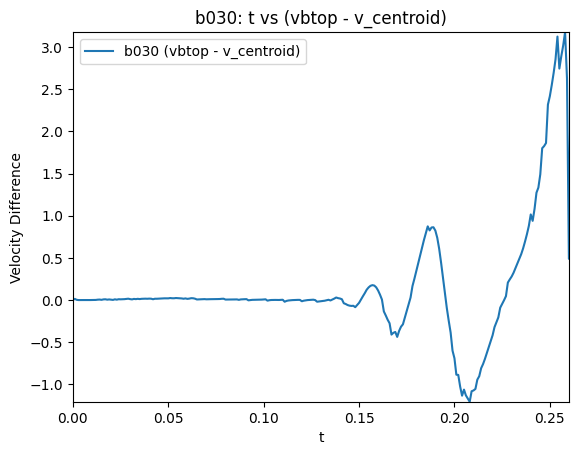

In [ ]:
datasets = {
    'b005': b005,
    'b010': b010,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    # Calculate the difference between column 5 (vbtop) and column 2 (velocity_x_centroid)
    diff_velocity = data[:, 5] - data[:, 2]

    ax.plot(data[:, 0], diff_velocity, label=f'{name} (vbtop - v_centroid)')

    ax.set_xlabel('t')
    ax.set_ylabel('Velocity Difference')
    ax.set_title(f'{name}: t vs (vbtop - v_centroid)')
    ax.legend()

    if name == 'b030':
        xlim_min, xlim_max = 0, 0.26
    else:
        xlim_min, xlim_max = 0, 0.55

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    filtered_diff_velocity = filtered_data[:, 5] - filtered_data[:, 2]


    # Set appropriate y-limits based on the filtered velocity difference data
    min_y = np.min(filtered_diff_velocity)
    max_y = np.max(filtered_diff_velocity)
    ax.set_ylim(min_y, max_y)

    plt.show()

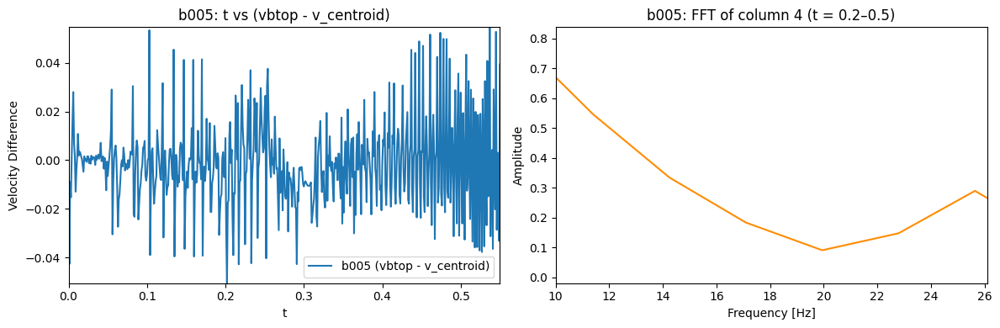

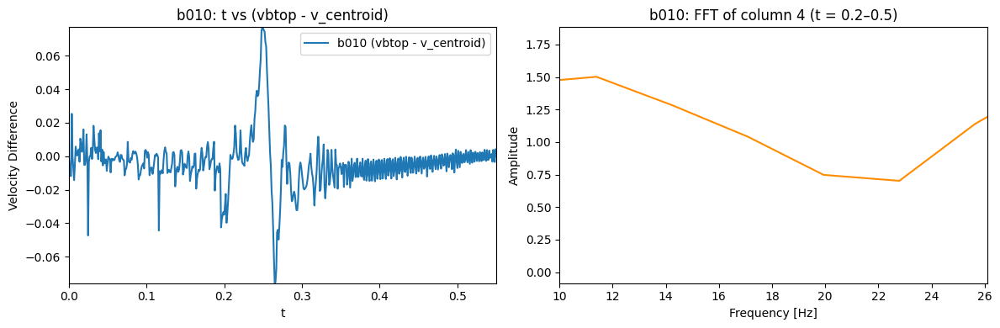

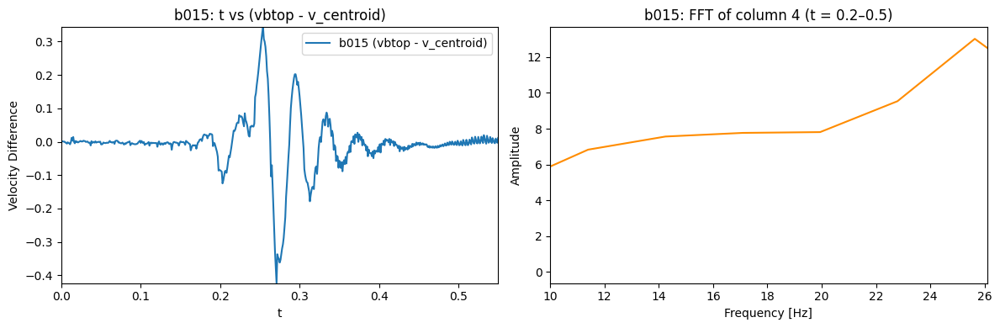

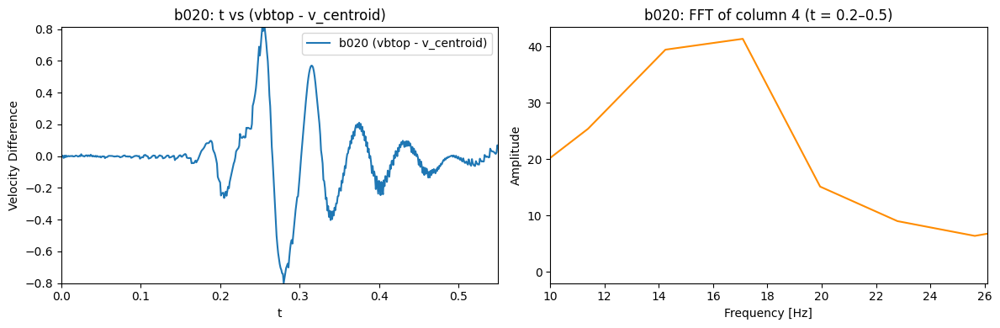

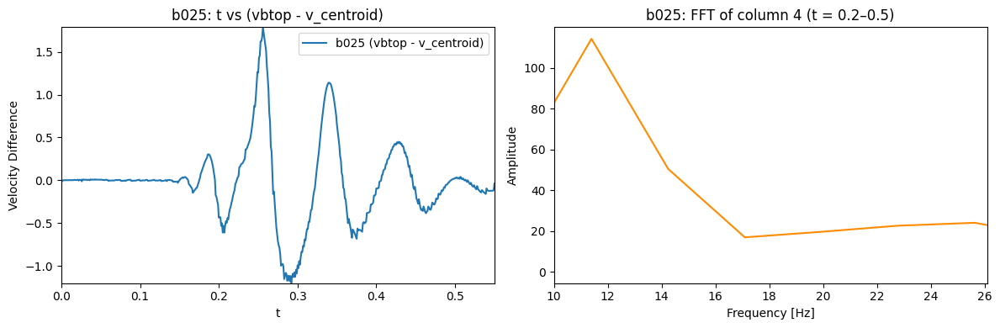

In [ ]:
datasets = {
    'b005': b005,
    'b010': b010,
    'b015': b015,
    'b020': b020,
    'b025': b025,
}

for name, data in datasets.items():
    # Time axis limits for the left plot
    xlim_min, xlim_max = 0, 0.55

    # Filter data for time-domain plot
    plot_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    t_plot = plot_data[:, 0]
    diff_velocity = plot_data[:, 5] - plot_data[:, 2]

    # --- FFT Section: column 4 between t=0.2 and t=0.5 ---
    fft_range_min, fft_range_max = 0.15, 0.5
    fft_data = data[(data[:, 0] >= fft_range_min) & (data[:, 0] <= fft_range_max)]
    t_fft = fft_data[:, 0]
    signal_col4 = fft_data[:, 5] - fft_data[:, 2]

    N = len(t_fft)
    if N < 2:
        print(f"Not enough data for FFT in {name}")
        continue

    dt = np.mean(np.diff(t_fft))
    fft_vals = np.fft.fft(signal_col4)
    fft_freqs = np.fft.fftfreq(N, d=dt)

    pos_freqs = fft_freqs[:N // 2]
    pos_fft_vals = np.abs(fft_vals[:N // 2])

    # --- Plotting ---
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    # Time-domain plot
    ax1.plot(t_plot, diff_velocity, label=f'{name} (vbtop - v_centroid)')
    ax1.set_xlabel('t')
    ax1.set_ylabel('Velocity Difference')
    ax1.set_title(f'{name}: t vs (vbtop - v_centroid)')
    ax1.set_xlim(xlim_min, xlim_max)
    ax1.set_ylim(np.min(diff_velocity), np.max(diff_velocity))
    ax1.legend()

    # FFT of column 4
    ax2.plot(pos_freqs, pos_fft_vals, color='darkorange')
    ax2.set_xlabel('Frequency [Hz]')
    ax2.set_ylabel('Amplitude')
    ax2.set_title(f'{name}: FFT of column 4 (t = 0.2–0.5)')
    ax2.set_xlim(10, np.max(pos_freqs)/19)

    plt.tight_layout()
    plt.show()

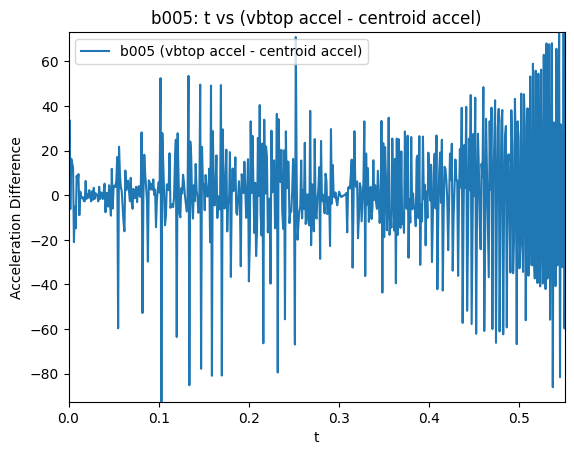

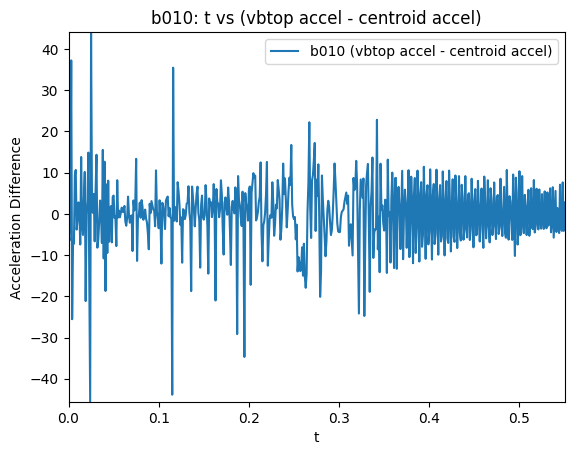

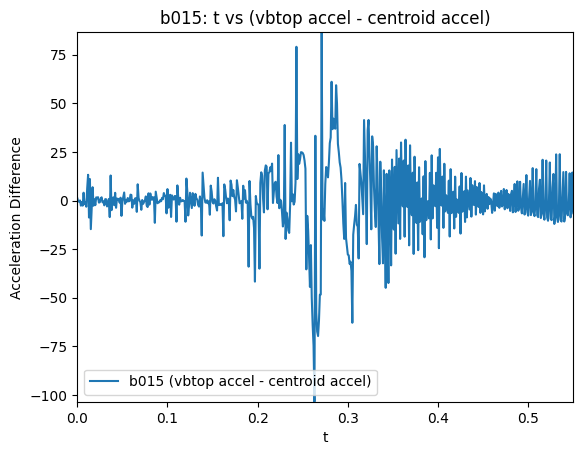

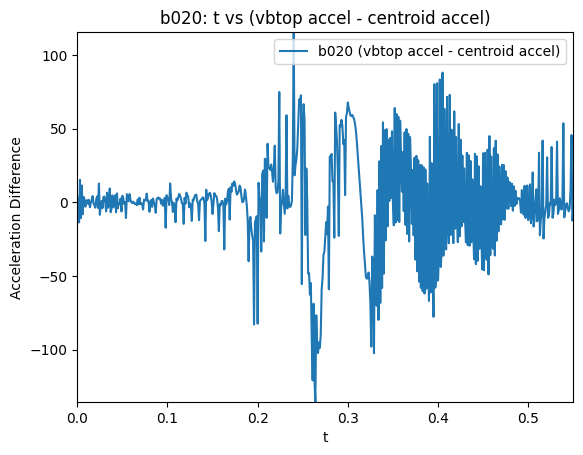

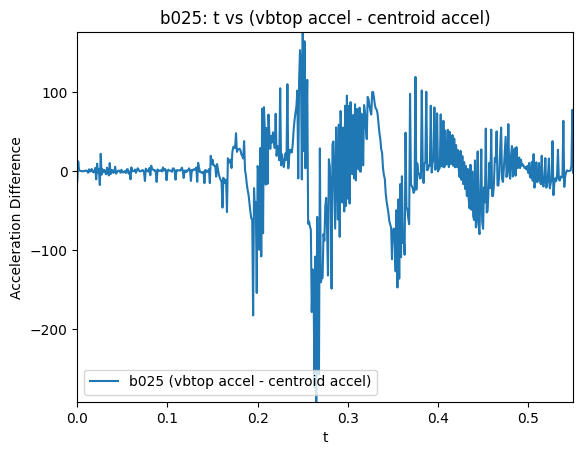

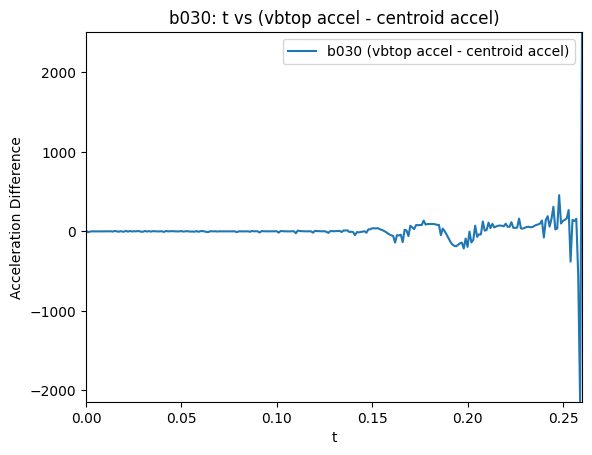

In [ ]:
datasets = {
    'b005': b005,
    'b010': b010,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    # Calculate acceleration for v_centroid (column 2)
    acceleration_centroid = np.diff(data[:, 2]) / 0.001
    # Calculate acceleration for vftop (column 6)
    acceleration_vftop = np.diff(data[:, 5]) / 0.001

    # The time array for acceleration will be one element shorter
    time_accel = data[:-1, 0]

    # Calculate the difference in acceleration
    diff_acceleration = acceleration_vftop - acceleration_centroid

    ax.plot(time_accel, diff_acceleration, label=f'{name} (vbtop accel - centroid accel)')

    ax.set_xlabel('t')
    ax.set_ylabel('Acceleration Difference')
    ax.set_title(f'{name}: t vs (vbtop accel - centroid accel)')
    ax.legend()

    if name == 'b030':
        xlim_min, xlim_max = 0, 0.26
    else:
        xlim_min, xlim_max = 0, 0.55

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_time_accel = time_accel[(time_accel >= xlim_min) & (time_accel <= xlim_max)]
    filtered_diff_acceleration = diff_acceleration[(time_accel >= xlim_min) & (time_accel <= xlim_max)]


    # Set appropriate y-limits based on the filtered acceleration difference data
    min_y = np.min(filtered_diff_acceleration)
    max_y = np.max(filtered_diff_acceleration)
    ax.set_ylim(min_y, max_y)

    plt.show()

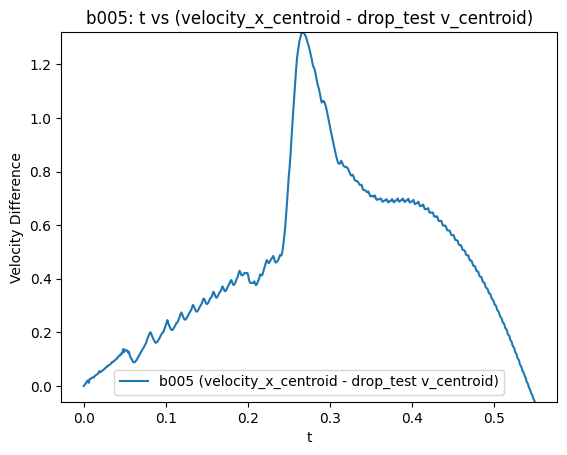

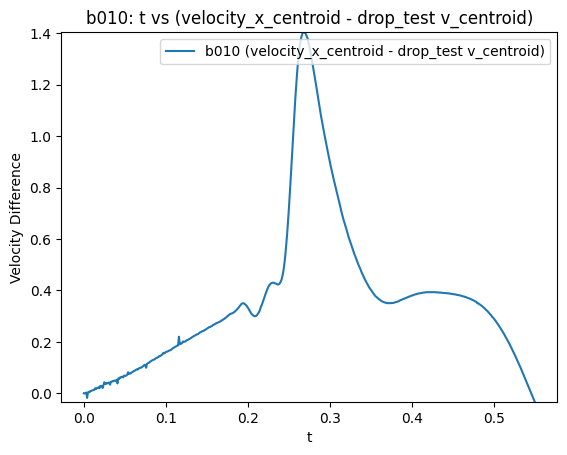

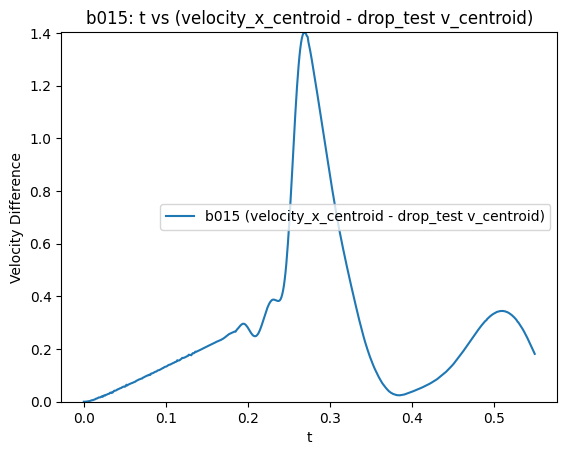

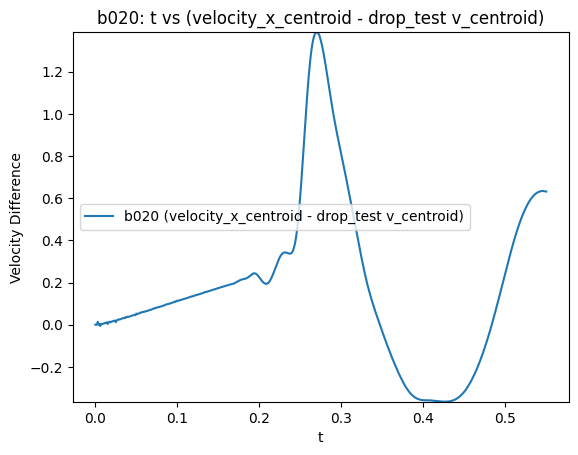

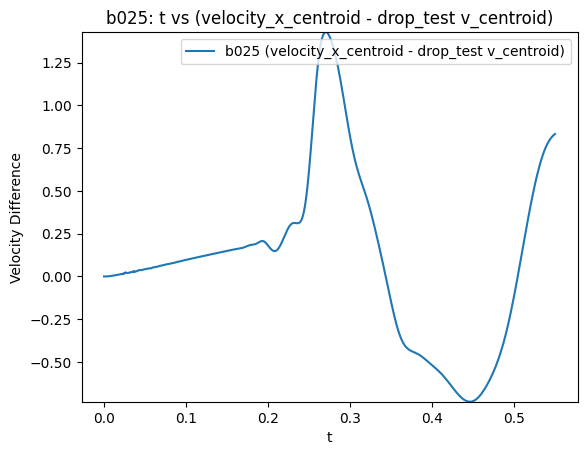

Average velocity difference for b005 between 0.268s and 0.550s: 0.6119


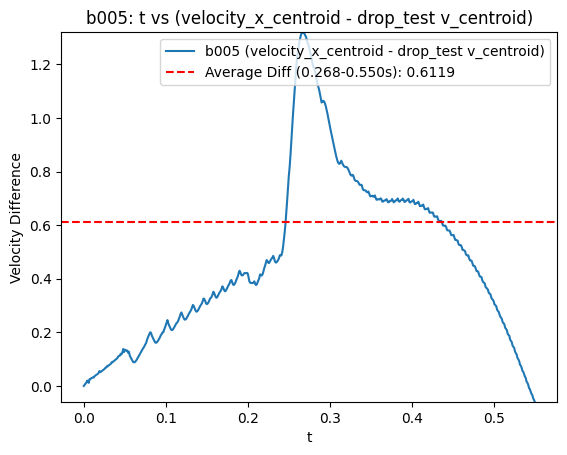

Average velocity difference for b010 between 0.268s and 0.550s: 0.4648


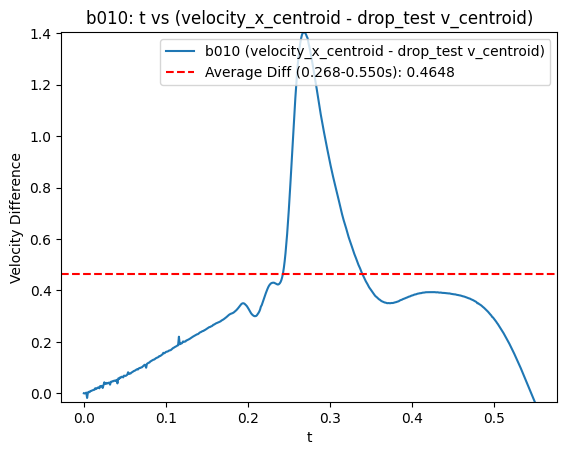

Average velocity difference for b015 between 0.269s and 0.384s: 0.5417


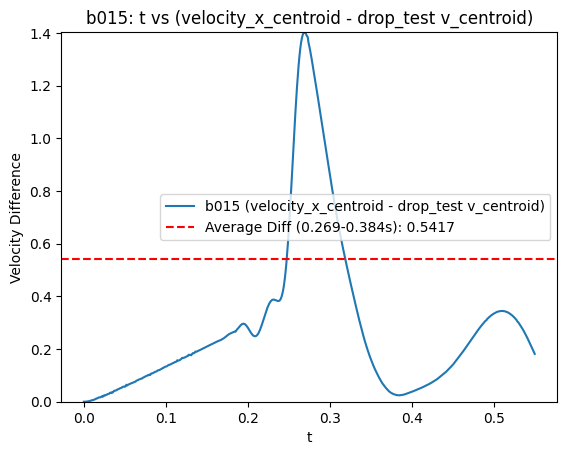

Average velocity difference for b020 between 0.270s and 0.425s: 0.1930


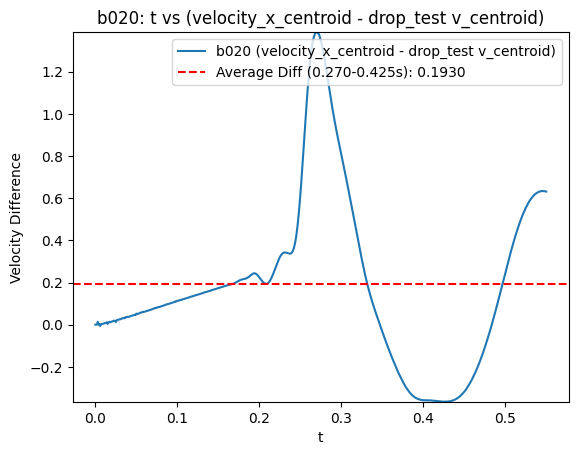

Average velocity difference for b025 between 0.270s and 0.447s: 0.0210


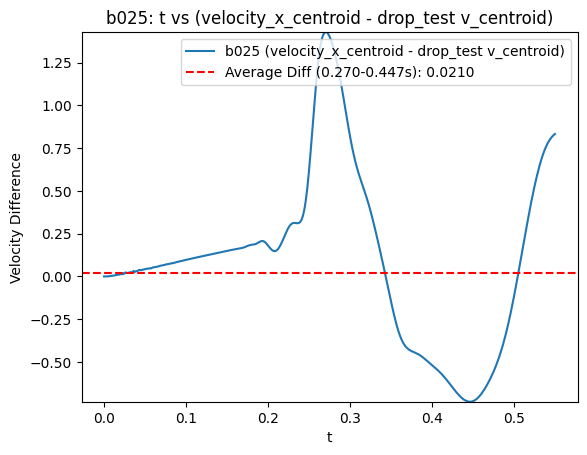

In [ ]:
datasets = {
    'b005': b005,
    'b010': b010,
    'b015': b015,
    'b020': b020,
    'b025': b025
}

# Assuming drop_test is already loaded and available
# If not, you might need to load it here:
# drop_test = load_filtered('/content/drive/MyDrive/13, nobubble/log_cont')


for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    # Ensure both datasets cover a similar time range for meaningful comparison
    # Find the overlapping time range
    min_time = 0.
    max_time = 0.550

    # Filter data within the overlapping time range
    filtered_data = data[(data[:, 0] >= min_time) & (data[:, 0] <= max_time)]
    filtered_drop_test = drop_test[(drop_test[:, 0] >= min_time) & (drop_test[:, 0] <= max_time)]

    # To calculate the difference, the time points need to be aligned.
    # We can interpolate one dataset onto the time points of the other,
    # or resample to a common time base. For simplicity, let's use the time points of the current dataset
    # and interpolate the drop_test v_centroid onto these time points.

    # Check if there is enough data to interpolate
    if filtered_drop_test.shape[0] < 2 or filtered_data.shape[0] < 1:
        print(f"Not enough overlapping data for {name} and drop_test for comparison.")
        continue

    interp_v_centroid_drop_test = np.interp(filtered_data[:, 0], filtered_drop_test[:, 0], filtered_drop_test[:, 2])

    # Calculate the difference: velocity_x_centroid of the current dataset - v_centroid of drop_test
    # velocity_x_centroid is column 2
    diff_velocity = filtered_data[:, 2] - interp_v_centroid_drop_test


    ax.plot(filtered_data[:, 0], diff_velocity, label=f'{name} (velocity_x_centroid - drop_test v_centroid)')

    ax.set_xlabel('t')
    ax.set_ylabel('Velocity Difference')
    ax.set_title(f'{name}: t vs (velocity_x_centroid - drop_test v_centroid)')
    ax.legend()

    # Set appropriate y-limits based on the calculated difference
    if diff_velocity.size > 0:
        min_y = np.min(diff_velocity)
        max_y = np.max(diff_velocity)
        ax.set_ylim(min_y, max_y)

    plt.show()


# Assuming drop_test is already loaded and available
# If not, you might need to load it here:
# drop_test = load_filtered('/content/drive/MyDrive/13, nobubble/log_cont')


for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    # Ensure both datasets cover a similar time range for meaningful comparison
    # Find the overlapping time range
    min_time = max(data[0, 0], drop_test[0, 0])
    max_time = min(data[-1, 0], drop_test[-1, 0])

    # Filter data within the overlapping time range
    filtered_data = data[(data[:, 0] >= min_time) & (data[:, 0] <= max_time)]
    filtered_drop_test = drop_test[(drop_test[:, 0] >= min_time) & (drop_test[:, 0] <= max_time)]

    # To calculate the difference, the time points need to be aligned.
    # We can interpolate one dataset onto the time points of the other,
    # or resample to a common time base. For simplicity, let's use the time points of the current dataset
    # and interpolate the drop_test v_centroid onto these time points.

    # Check if there is enough data to interpolate
    if filtered_drop_test.shape[0] < 2 or filtered_data.shape[0] < 1:
        print(f"Not enough overlapping data for {name} and drop_test for comparison.")
        plt.close(fig) # Close the empty figure
        continue

    interp_v_centroid_drop_test = np.interp(filtered_data[:, 0], filtered_drop_test[:, 0], filtered_drop_test[:, 2])

    # Calculate the difference: velocity_x_centroid of the current dataset - v_centroid of drop_test
    # velocity_x_centroid is column 2
    diff_velocity = filtered_data[:, 2] - interp_v_centroid_drop_test


    ax.plot(filtered_data[:, 0], diff_velocity, label=f'{name} (velocity_x_centroid - drop_test v_centroid)')

    ax.set_xlabel('t')
    ax.set_ylabel('Velocity Difference')
    ax.set_title(f'{name}: t vs (velocity_x_centroid - drop_test v_centroid)')
    ax.legend()

    # Set appropriate y-limits based on the calculated difference
    if diff_velocity.size > 0:
        min_y = np.min(diff_velocity)
        max_y = np.max(diff_velocity)
        ax.set_ylim(min_y, max_y)

    # Define a time range to search for the peak and minimum
    search_range_min, search_range_max = 0.2, 0.3  # Adjust as needed

    # Filter data within the search range
    search_data = filtered_data[(filtered_data[:, 0] >= search_range_min) & (filtered_data[:, 0] <= search_range_max)]
    search_diff_velocity = diff_velocity[(filtered_data[:, 0] >= search_range_min) & (filtered_data[:, 0] <= search_range_max)]


    if search_diff_velocity.size > 1:
        # Find the index of the peak difference within the search range
        peak_diff_index_in_search = np.argmax(search_diff_velocity)
        # Find the index of the minimum difference after the peak
        # We need to find the minimum in the original filtered_data after the time of the peak
        peak_time = search_data[peak_diff_index_in_search, 0]

        # Find the index in the original filtered_data that corresponds to the peak time
        peak_index_in_filtered = np.argmin(abs(filtered_data[:, 0] - peak_time))

        # Search for the minimum in the original filtered_data after the peak index
        if peak_index_in_filtered < len(diff_velocity) - 1:
            min_diff_index_after_peak = np.argmin(diff_velocity[peak_index_in_filtered:]) + peak_index_in_filtered

            # Get the times for the peak and minimum
            time_at_peak = filtered_data[peak_index_in_filtered, 0]
            time_at_min = filtered_data[min_diff_index_after_peak, 0]

            # Ensure minimum comes after the peak
            if time_at_min > time_at_peak:
                # Filter data between the peak and minimum times
                average_range_data = filtered_data[(filtered_data[:, 0] >= time_at_peak) & (filtered_data[:, 0] <= time_at_min)]
                average_range_diff_velocity = diff_velocity[(filtered_data[:, 0] >= time_at_peak) & (filtered_data[:, 0] <= time_at_min)]

                if average_range_diff_velocity.size > 0:
                    average_diff = np.mean(average_range_diff_velocity)
                    ax.axhline(y=average_diff, color='r', linestyle='--', label=f'Average Diff ({time_at_peak:.3f}-{time_at_min:.3f}s): {average_diff:.4f}')
                    ax.legend()
                    print(f"Average velocity difference for {name} between {time_at_peak:.3f}s and {time_at_min:.3f}s: {average_diff:.4f}")
                else:
                    print(f"Not enough data points between peak ({time_at_peak:.3f}) and minimum ({time_at_min:.3f}) for {name} to calculate average.")
            else:
                 print(f"Minimum difference did not occur after the peak for {name} in the specified search range.")
        else:
            print(f"Peak is the last data point or not enough data after peak to find a minimum for {name}.")
    else:
        print(f"Not enough data points in the search range ({search_range_min}-{search_range_max}s) for {name} to find peak and minimum.")


    plt.show()

# line 0.20


In [ ]:
b005 = load_filtered_data('/content/drive/MyDrive/line0.20/log0.05,0.20')
b00875 = load_filtered_data('/content/drive/MyDrive/line0.20/log0.0875,0.20')
b010 = load_filtered_data('/content/drive/MyDrive/line0.20/log0.10,0.20')
b01125 = load_filtered_data('/content/drive/MyDrive/line0.20/log0.1125,0.20')
b0125 = load_filtered_data('/content/drive/MyDrive/line0.20/log0.125,0.20')
b015 = load_filtered_data('/content/drive/MyDrive/line0.20/log0.15,0.20')
b020 = load_filtered_data('/content/drive/MyDrive/line0.20/log0.20,0.20')
b025 = load_filtered_data('/content/drive/MyDrive/line0.20/log0.25,0.20')
b030 = load_filtered_data('/content/drive/MyDrive/line0.20/log0.30,0.20')

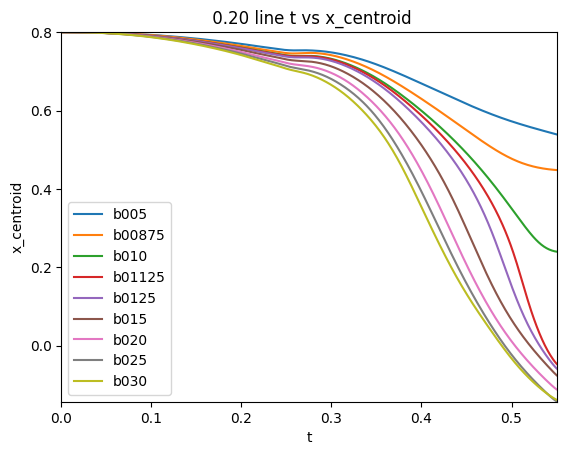

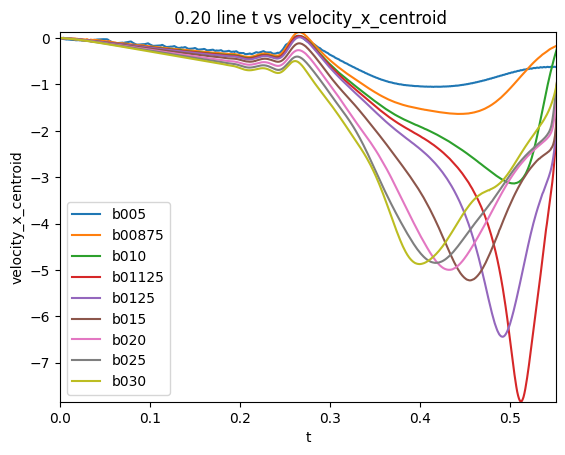

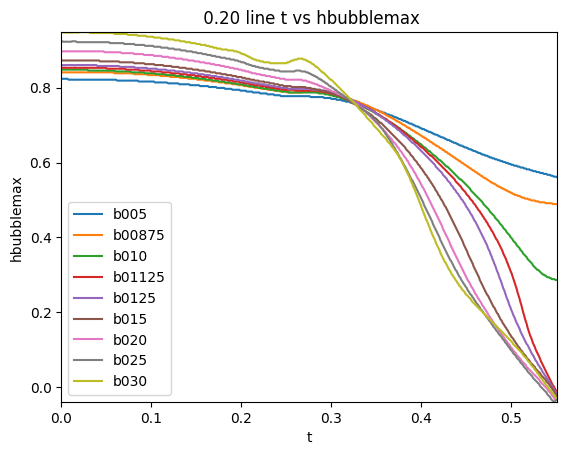

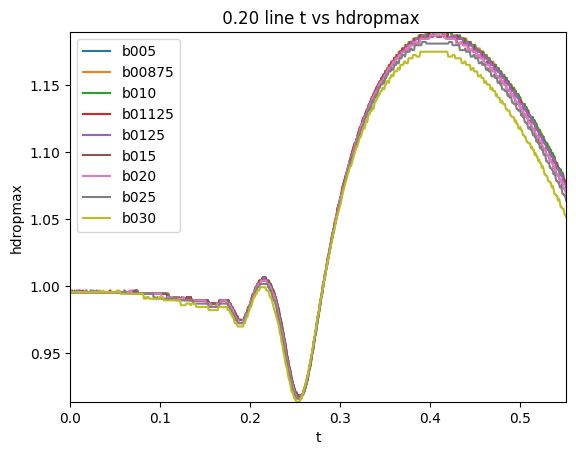

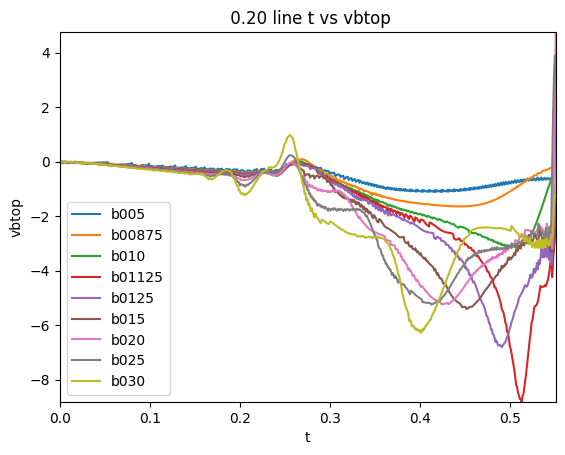

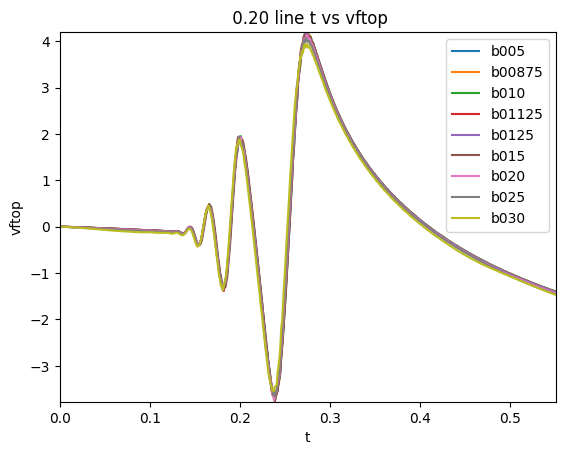

In [ ]:
column_names = ['x_centroid', 'velocity_x_centroid', 'hbubblemax', 'hdropmax', 'vbtop', 'vftop']

for i in range(1, b005.shape[1]):
    fig, ax = plt.figure(), plt.axes()

    # Subtract 7.0 from relevant columns before plotting
    if column_names[i-1] in ['x_centroid', 'hbubblemax', 'hdropmax']:
        ax.plot(b005[:, 0], b005[:, i] - 7.0, label='b005')
        ax.plot(b00875[:, 0], b00875[:, i] - 7.0, label='b00875')
        ax.plot(b010[:, 0], b010[:, i] - 7.0, label='b010')
        ax.plot(b01125[:, 0], b01125[:, i] - 7.0, label='b01125')
        ax.plot(b0125[:, 0], b0125[:, i] - 7.0, label='b0125')
        ax.plot(b015[:, 0], b015[:, i] - 7.0, label='b015')
        ax.plot(b020[:, 0], b020[:, i] - 7.0, label='b020')
        ax.plot(b025[:, 0], b025[:, i] - 7.0, label='b025')
        ax.plot(b030[:, 0], b030[:, i] - 7.0, label='b030')
    else:
        ax.plot(b005[:, 0], b005[:, i], label='b005')
        ax.plot(b00875[:, 0], b00875[:, i], label='b00875')
        ax.plot(b010[:, 0], b010[:, i], label='b010')
        ax.plot(b01125[:, 0], b01125[:, i], label='b01125')
        ax.plot(b0125[:, 0], b0125[:, i], label='b0125')
        ax.plot(b015[:, 0], b015[:, i], label='b015')
        ax.plot(b020[:, 0], b020[:, i], label='b020')
        ax.plot(b025[:, 0], b025[:, i], label='b025')
        ax.plot(b030[:, 0], b030[:, i], label='b030')


    ax.set_xlabel('t')
    ax.set_ylabel(column_names[i-1])
    ax.set_title(f' 0.20 line t vs {column_names[i-1]}')
    ax.legend()
    ax.set_xlim(0, 0.551)

    # Filter data within the x-axis range (0 to 0.56) for each dataset
    b005_filtered = b005[(b005[:, 0] >= 0) & (b005[:, 0] <= 0.551)]
    b00875_filtered = b00875[(b00875[:, 0] >= 0) & (b00875[:, 0] <= 0.551)]
    b010_filtered = b010[(b010[:, 0] >= 0) & (b010[:, 0] <= 0.551)]
    b01125_filtered = b01125[(b01125[:, 0] >= 0) & (b01125[:, 0] <= 0.551)]
    b0125_filtered = b0125[(b0125[:, 0] >= 0) & (b0125[:, 0] <= 0.551)]
    b015_filtered = b015[(b015[:, 0] >= 0) & (b015[:, 0] <= 0.551)]
    b020_filtered = b020[(b020[:, 0] >= 0) & (b020[:, 0] <= 0.551)]
    b025_filtered = b025[(b025[:, 0] >= 0) & (b025[:, 0] <= 0.551)]
    b030_filtered = b030[(b030[:, 0] >= 0) & (b030[:, 0] <= 0.551)]

    # List of filtered datasets
    filtered_datasets = [b005_filtered, b00875_filtered, b010_filtered, b01125_filtered, b0125_filtered, b015_filtered, b020_filtered, b025_filtered, b030_filtered]

    # Collect data for y-limit calculation
    y_values = []
    for data in filtered_datasets:
      if column_names[i-1] in ['x_centroid', 'hbubblemax', 'hdropmax']:
          y_values.append(data[:, i] - 7.0)
      else:
          y_values.append(data[:, i])

    # Set y-limits based on the filtered and potentially modified data
    min_y = min(np.min(y) for y in y_values)
    max_y = max(np.max(y) for y in y_values)
    ax.set_ylim(min_y, max_y)

    plt.show()

In [ ]:
column_names = ['x_centroid', 'velocity_x_centroid']

    fig, ax = plt.figure(), plt.axes()
    ax.plot(b005[:, 0], b005[:, i] , label='$d_i=0.05$')
    ax.plot(b00875[:, 0], b00875[:, i],  label='$d_i=0.0875$')
    ax.plot(b010[:, 0], b010[:, i] , label='$d_i=0.10$')
    ax.plot(b01125[:, 0], b01125[:, i], label='$d_i=0.1125$')
    ax.plot(b0125[:, 0], b0125[:, i] , label='$d_i=0.125$')
    ax.plot(b015[:, 0], b015[:, i] , label='$d_i=0.15$')
    ax.plot(b020[:, 0], b020[:, i] , label='$d_i=0.20$')
    ax.plot(b025[:, 0], b025[:, i] , label='$d_i=0.25$')
    ax.plot(b030[:, 0], b030[:, i] , label='$d_i=0.30$')


    ax.set_xlabel('$t^*$')
    ax.set_ylabel('$v_x$')
    ax.set_title(f' $\Delta h = 0.20: v_x(t^*)$')
    ax.legend()
    ax.set_xlim(0, 0.551)

    # Filter data within the x-axis range (0 to 0.56) for each dataset
    b005_filtered = b005[(b005[:, 0] >= 0) & (b005[:, 0] <= 0.551)]
    b00875_filtered = b00875[(b00875[:, 0] >= 0) & (b00875[:, 0] <= 0.551)]
    b010_filtered = b010[(b010[:, 0] >= 0) & (b010[:, 0] <= 0.551)]
    b01125_filtered = b01125[(b01125[:, 0] >= 0) & (b01125[:, 0] <= 0.551)]
    b0125_filtered = b0125[(b0125[:, 0] >= 0) & (b0125[:, 0] <= 0.551)]
    b015_filtered = b015[(b015[:, 0] >= 0) & (b015[:, 0] <= 0.551)]
    b020_filtered = b020[(b020[:, 0] >= 0) & (b020[:, 0] <= 0.551)]
    b025_filtered = b025[(b025[:, 0] >= 0) & (b025[:, 0] <= 0.551)]
    b030_filtered = b030[(b030[:, 0] >= 0) & (b030[:, 0] <= 0.551)]

    # List of filtered datasets
    filtered_datasets = [b005_filtered, b00875_filtered, b010_filtered, b01125_filtered, b0125_filtered, b015_filtered, b020_filtered, b025_filtered, b030_filtered]

    # Collect data for y-limit calculation
    y_values = []
    for data in filtered_datasets:
      if column_names[i-1] in ['x_centroid', 'hbubblemax', 'hdropmax']:
          y_values.append(data[:, i] - 7.0)
      else:
          y_values.append(data[:, i])

    # Set y-limits based on the filtered and potentially modified data
    min_y = min(np.min(y) for y in y_values)
    max_y = max(np.max(y) for y in y_values)
    ax.set_ylim(min_y, max_y)

    plt.show()

IndentationError: unexpected indent (ipython-input-4176961825.py, line 3)

<>:31: SyntaxWarning: invalid escape sequence '\D'
<>:31: SyntaxWarning: invalid escape sequence '\D'
/tmp/ipython-input-3292466321.py:31: SyntaxWarning: invalid escape sequence '\D'
  ax.set_title(f' $\Delta h = 0.20: v_c(t^*)$')


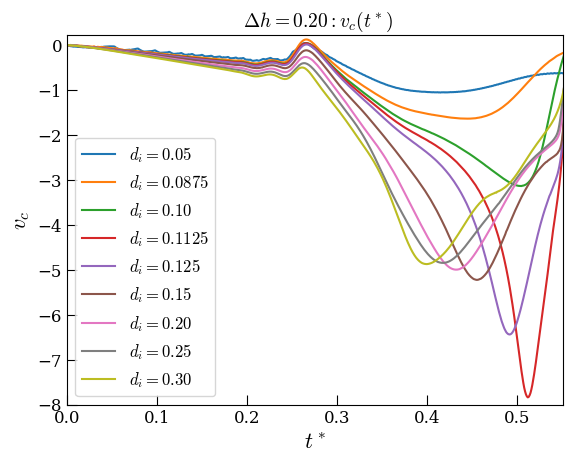

In [ ]:
column_names = ['velocity_x_centroid']

fig, ax = plt.figure(), plt.axes()
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['DejaVu Serif', 'Times New Roman', 'Computer Modern Roman'] # Better font
plt.rcParams['mathtext.fontset'] = 'cm' # Use Computer Modern fonts for math
plt.rcParams['font.size'] = 12 # Adjust font size
plt.rcParams['axes.labelsize'] = 16  # Increased label size
plt.rcParams['axes.labelweight'] = 'bold' # Made labels bold
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 12
plt.rcParams['figure.titlesize'] = 18
ax.tick_params(which='major', length=7, direction='in')
ax.tick_params(which='minor', length=4, direction='in')
# Plot the specified column for each dataset
ax.plot(b005[:, 0], b005[:, 2] , label='$d_i=0.05$')
ax.plot(b00875[:, 0], b00875[:, 2],  label='$d_i=0.0875$')
ax.plot(b010[:, 0], b010[:, 2] , label='$d_i=0.10$')
ax.plot(b01125[:, 0], b01125[:, 2], label='$d_i=0.1125$')
ax.plot(b0125[:, 0], b0125[:, 2] , label='$d_i=0.125$')
ax.plot(b015[:, 0], b015[:, 2] , label='$d_i=0.15$')
ax.plot(b020[:, 0], b020[:,2] , label='$d_i=0.20$')
ax.plot(b025[:, 0], b025[:, 2] , label='$d_i=0.25$')
ax.plot(b030[:, 0], b030[:, 2] , label='$d_i=0.30$')


ax.set_xlabel('$t^*$')
ax.set_ylabel('$v_c$')
ax.set_title(f' $\Delta h = 0.20: v_c(t^*)$')
ax.legend()
ax.set_xlim(0, 0.551)

# Filter data within the x-axis range (0 to 0.56) for each dataset
b005_filtered = b005[(b005[:, 0] >= 0) & (b005[:, 0] <= 0.551)]
b00875_filtered = b00875[(b00875[:, 0] >= 0) & (b00875[:, 0] <= 0.551)]
b010_filtered = b010[(b010[:, 0] >= 0) & (b010[:, 0] <= 0.551)]
b01125_filtered = b01125[(b01125[:, 0] >= 0) & (b01125[:, 0] <= 0.551)]
b0125_filtered = b0125[(b0125[:, 0] >= 0) & (b0125[:, 0] <= 0.551)]
b015_filtered = b015[(b015[:, 0] >= 0) & (b015[:, 0] <= 0.551)]
b020_filtered = b020[(b020[:, 0] >= 0) & (b020[:, 0] <= 0.551)]
b025_filtered = b025[(b025[:, 0] >= 0) & (b025[:, 0] <= 0.551)]
b030_filtered = b030[(b030[:, 0] >= 0) & (b030[:, 0] <= 0.551)]

# List of filtered datasets
filtered_datasets = [b005_filtered, b00875_filtered, b010_filtered, b01125_filtered, b0125_filtered, b015_filtered, b020_filtered, b025_filtered, b030_filtered]

# Collect data for y-limit calculation
y_values = []
for data in filtered_datasets:
    y_values.append(data[:, 2]) # Use column index 1 directly

# Set y-limits based on the filtered and potentially modified data
min_y = min(np.min(y) for y in y_values)
max_y = max(np.max(y) for y in y_values)
ax.set_ylim(-8, max_y+0.1)
plt.savefig('vct.pdf', format='pdf', dpi=1200)
plt.show()

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

column_indices_to_plot = [1, 3, 4] # Columns 1 (x_centroid), 3 (hbubblemax), and 4 (hdropmax)
column_names_to_plot = ['x_centroid', 'hbubblemax', 'hdropmax']

for name, data in datasets.items():
    xlim_min, xlim_max = 0.26, 0.5

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    print(name," 0.20 ",np.polyfit(filtered_data[:, 0], filtered_data[:, 1]-7.0 , 1)," \n")

b005  0.20  [-0.84528747  1.0018187 ]  

b00875  0.20  [-1.24481682  1.11594035]  

b010  0.20  [-1.64973741  1.23400723]  

b01125  0.20  [-1.9138067   1.31663269]  

b0125  0.20  [-2.24836301  1.41939989]  

b015  0.20  [-2.85401985  1.59044742]  

b020  0.20  [-3.2125414   1.67739357]  

b025  0.20  [-3.38460159  1.70859304]  

b030  0.20  [-3.42675481  1.70141106]  



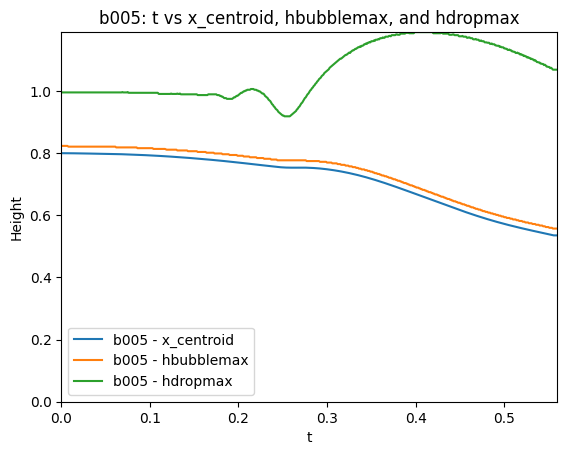

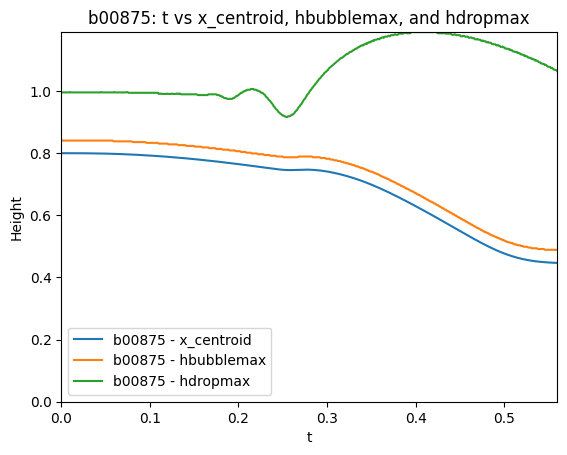

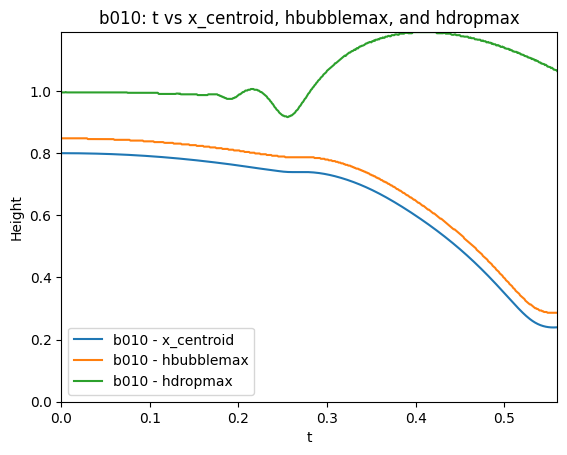

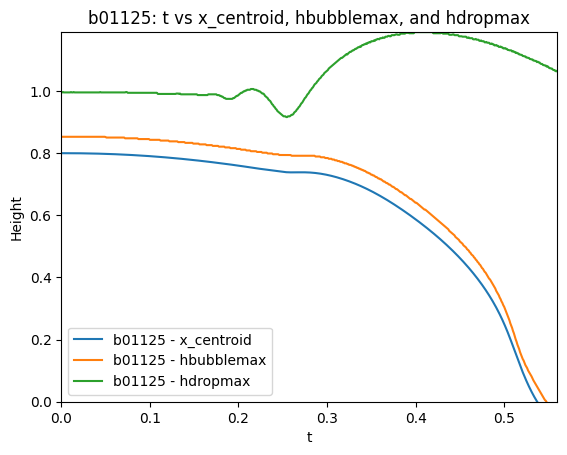

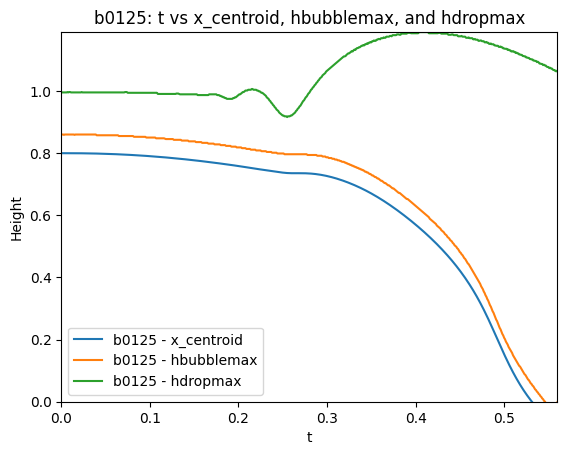

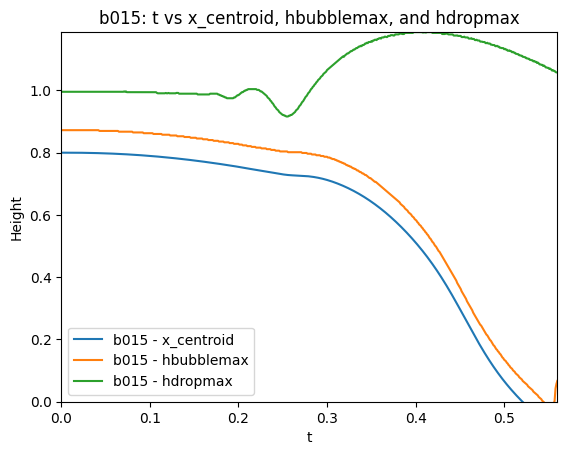

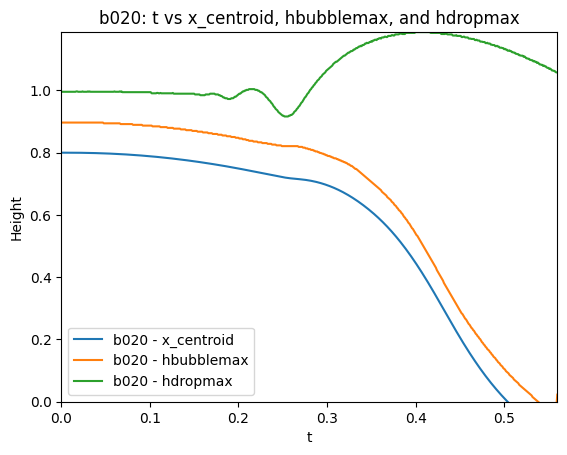

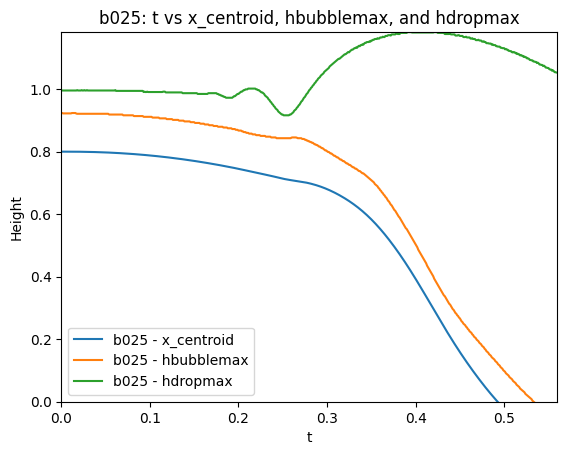

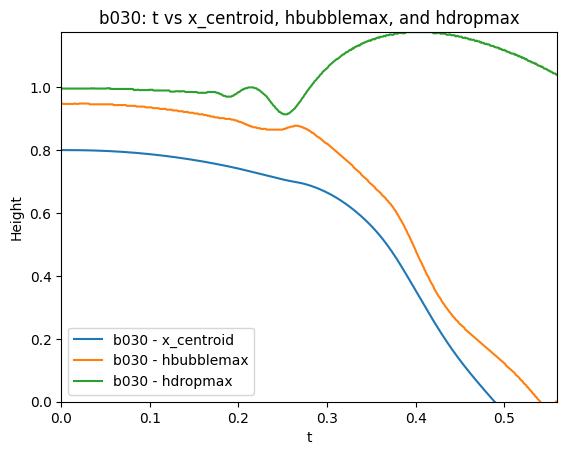

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

column_indices_to_plot = [1, 3, 4] # Columns 1 (x_centroid), 3 (hbubblemax), and 4 (hdropmax)
column_names_to_plot = ['x_centroid', 'hbubblemax', 'hdropmax']

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    xlim_min, xlim_max = 0, 0.56

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]

    for i, col_index in enumerate(column_indices_to_plot):
        ax.plot(filtered_data[:, 0], filtered_data[:, col_index]-7.0, label=f'{name} - {column_names_to_plot[i]}')

    ax.set_xlabel('t')
    ax.set_ylabel('Height')
    ax.set_title(f'{name}: t vs x_centroid, hbubblemax, and hdropmax')
    ax.legend()
    ax.set_xlim(xlim_min, xlim_max)

    # Set appropriate y-limits based on the filtered data in the selected columns
    min_y = np.min(filtered_data[:, column_indices_to_plot])
    max_y = np.max(filtered_data[:, column_indices_to_plot]-7.0)
    ax.set_ylim(0.0, max_y)

    plt.show()

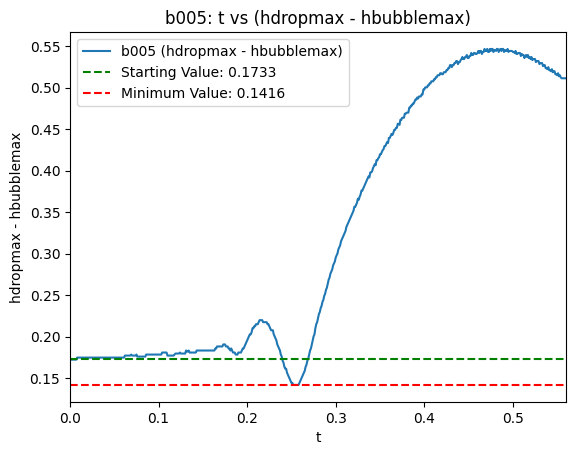

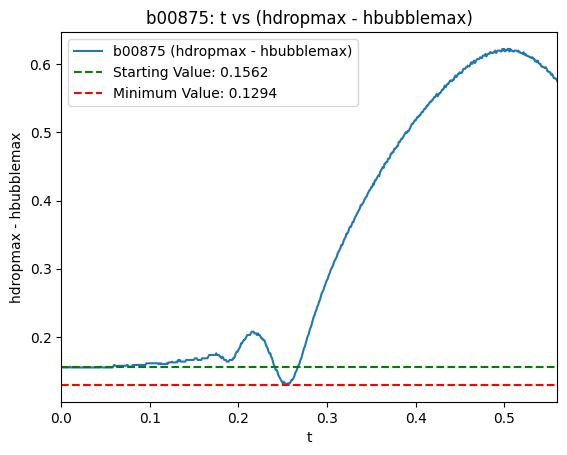

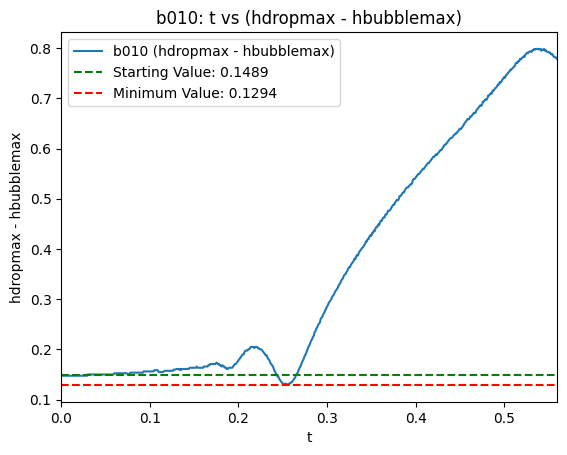

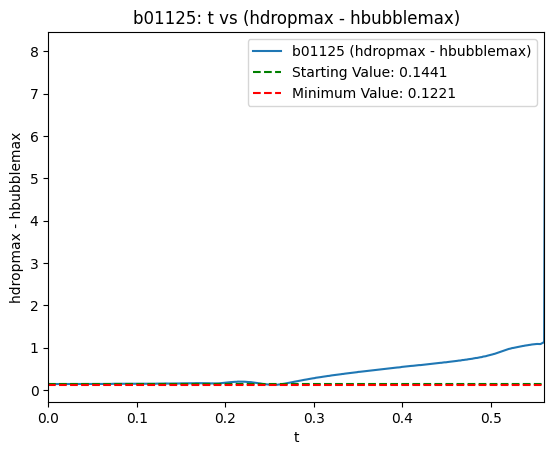

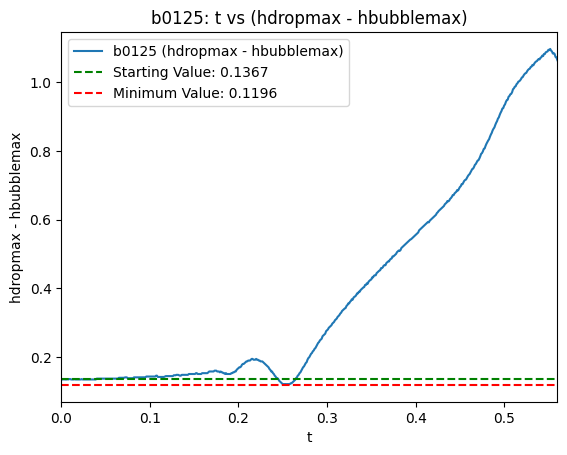

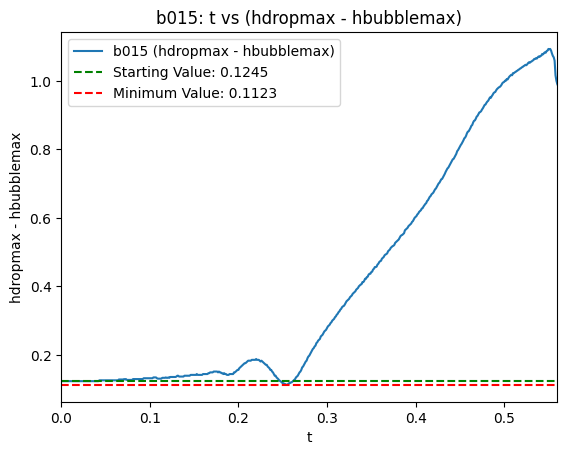

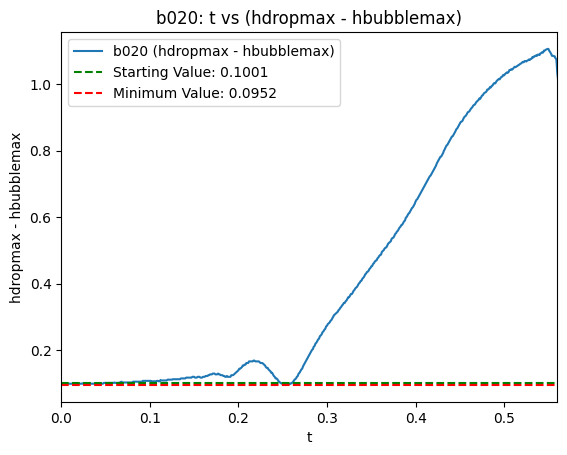

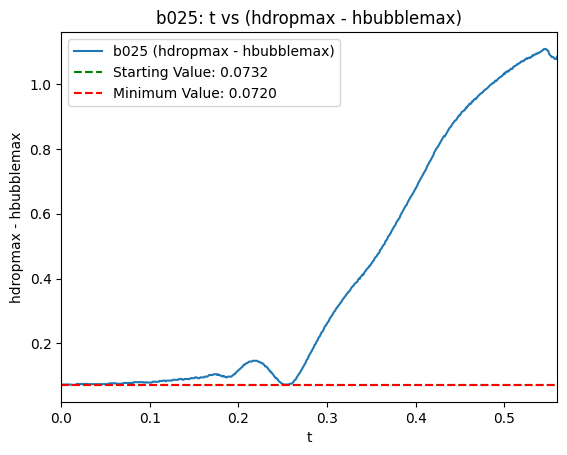

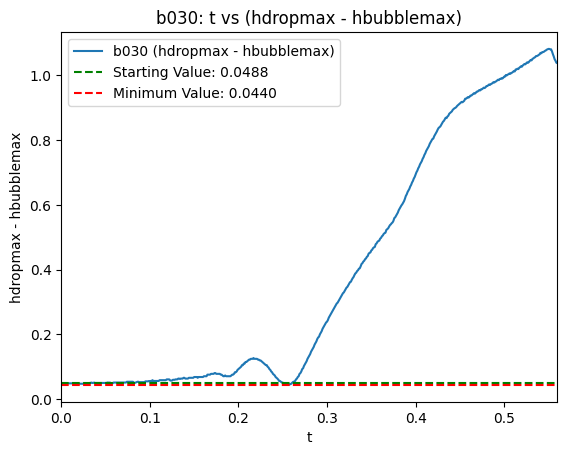

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()
    # Calculate the difference between column 4 (hdropmax) and column 3 (hbubblemax)
    diff_h = data[:, 4] - data[:, 3]
    ax.plot(data[:, 0], diff_h, label=f'{name} (hdropmax - hbubblemax)')

    ax.set_xlabel('t')
    ax.set_ylabel('hdropmax - hbubblemax')
    ax.set_title(f'{name}: t vs (hdropmax - hbubblemax)')
    ax.legend()

    xlim_min, xlim_max = 0, 0.56

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    filtered_diff_h = filtered_data[:, 4] - filtered_data[:, 3]

    # Find the starting value (at the minimum x within the range)
    starting_x_index = np.argmin(abs(filtered_data[:, 0] - xlim_min))
    starting_value = filtered_diff_h[starting_x_index]


    # Find the minimum value within the x-axis range
    min_value = np.min(filtered_diff_h)

    # Add horizontal lines for starting and minimum values
    ax.axhline(y=starting_value, color='g', linestyle='--', label=f'Starting Value: {starting_value:.4f}')
    ax.axhline(y=min_value, color='r', linestyle='--', label=f'Minimum Value: {min_value:.4f}')
    ax.legend()

    plt.show()

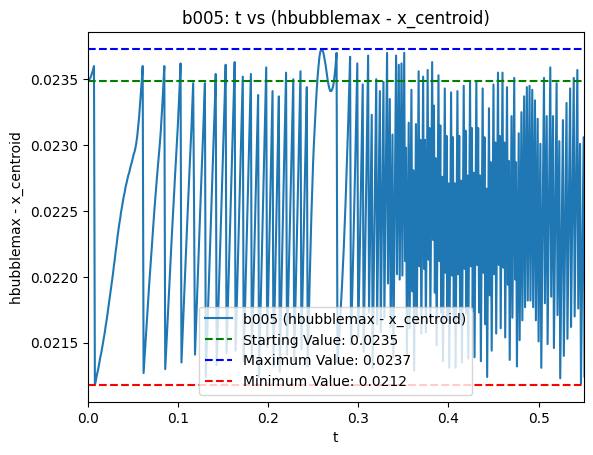

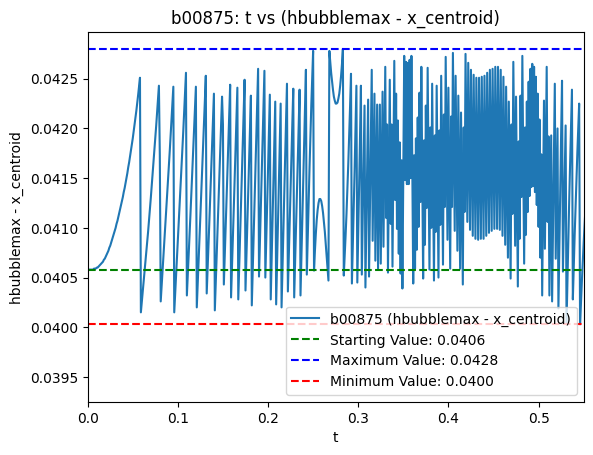

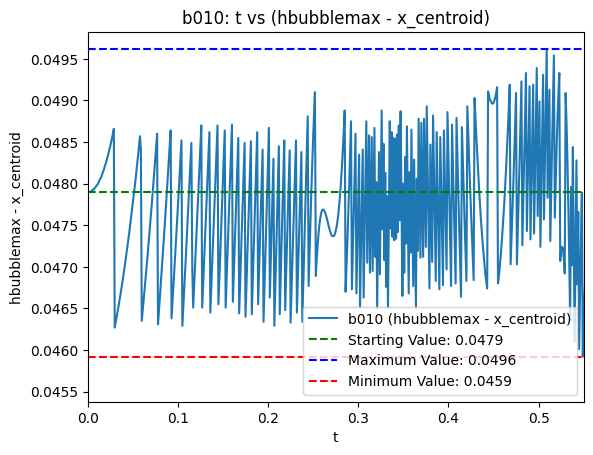

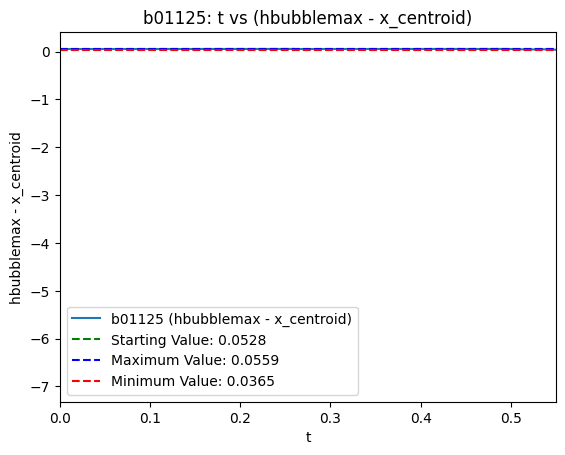

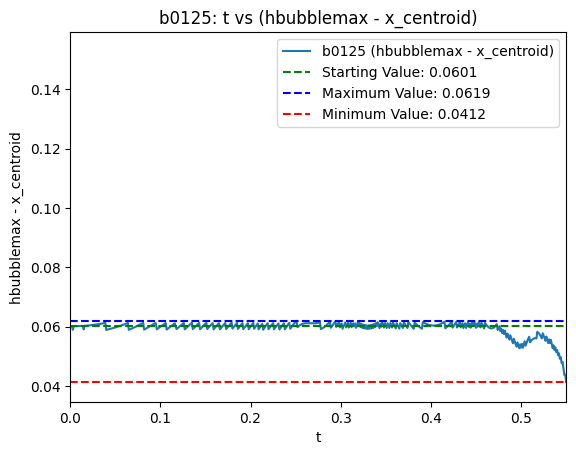

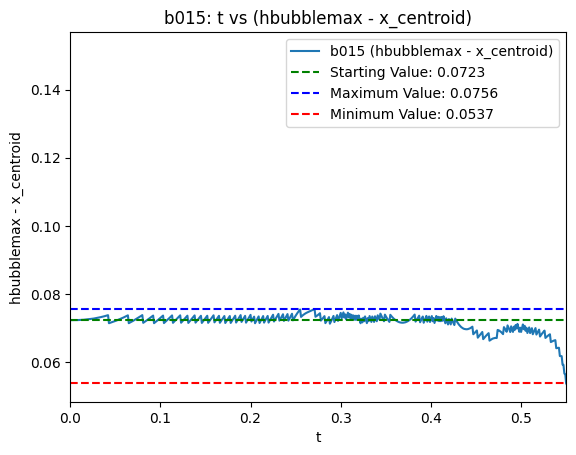

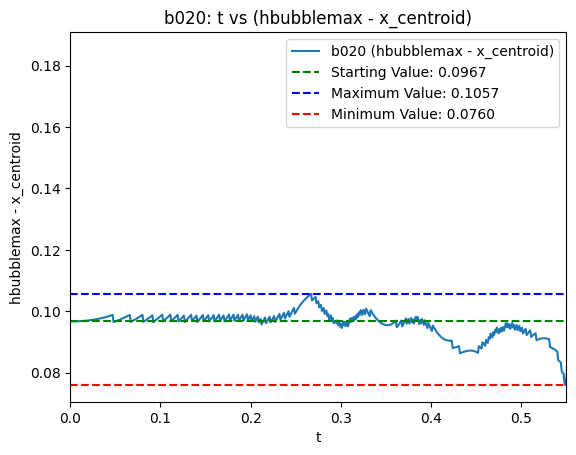

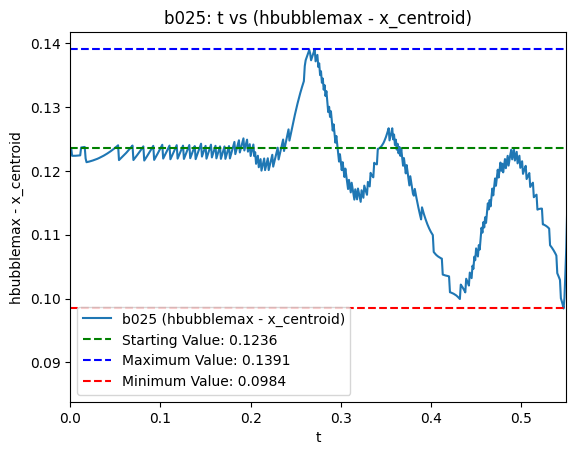

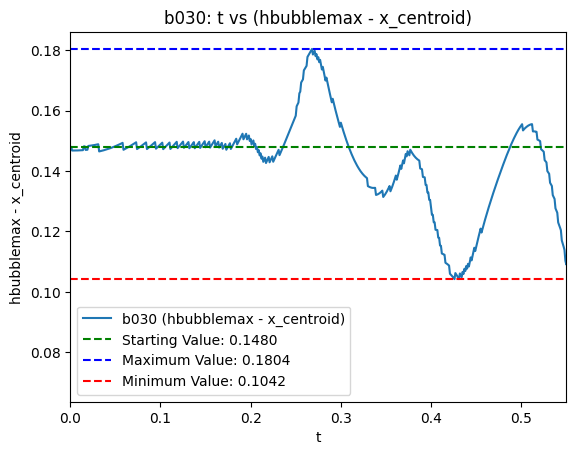

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()
    # Calculate the difference between column 3 (hbubblemax) and column 1 (x_centroid)
    diff_h_x = data[:, 3] - data[:, 1]
    ax.plot(data[:, 0], diff_h_x, label=f'{name} (hbubblemax - x_centroid)')

    ax.set_xlabel('t')
    ax.set_ylabel('hbubblemax - x_centroid')
    ax.set_title(f'{name}: t vs (hbubblemax - x_centroid)')
    ax.legend()

    xlim_min, xlim_max = 0, 0.55

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    filtered_diff_h_x = filtered_data[:, 3] - filtered_data[:, 1]


    # Find the starting value (at the minimum x within the range)
    starting_x_index = np.argmin(abs(filtered_data[:, 0] - xlim_min))
    starting_value = filtered_diff_h_x[starting_x_index]


    # Find the maximum value within the x-axis range
    max_value = np.max(filtered_diff_h_x)
    min_value = np.min(filtered_diff_h_x)
    # Add horizontal lines for starting and maximum values
    ax.axhline(y=starting_value, color='g', linestyle='--', label=f'Starting Value: {starting_value:.4f}')
    ax.axhline(y=max_value, color='b', linestyle='--', label=f'Maximum Value: {max_value:.4f}')
    ax.axhline(y=min_value, color='r', linestyle='--', label=f'Minimum Value: {min_value:.4f}')
    ax.legend()

    plt.show()

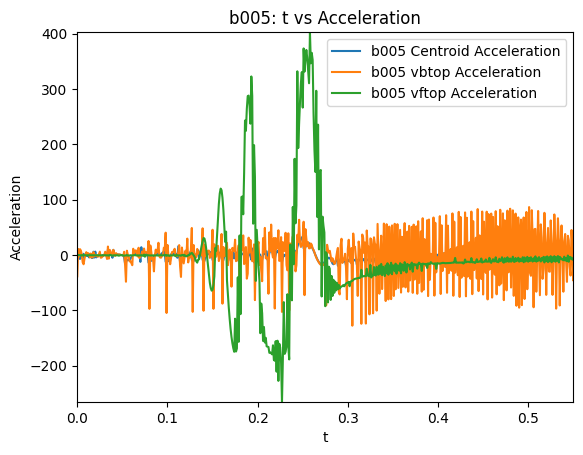

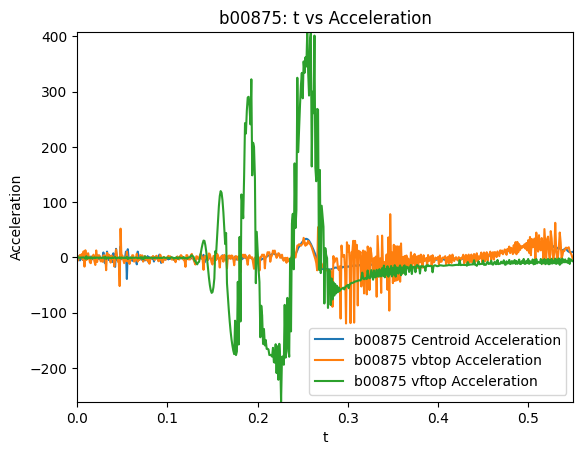

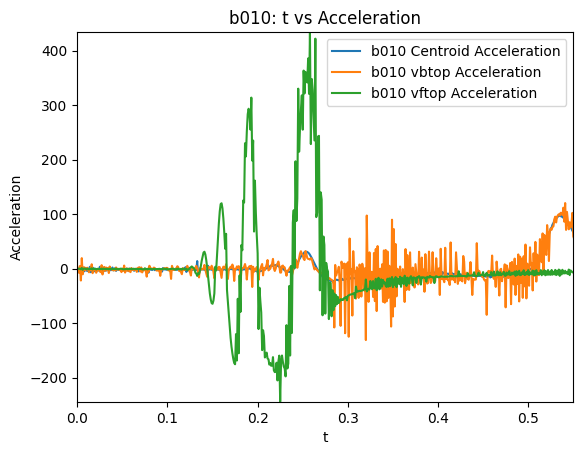

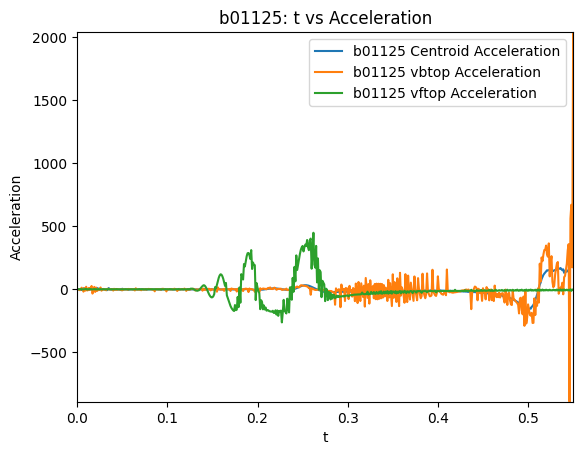

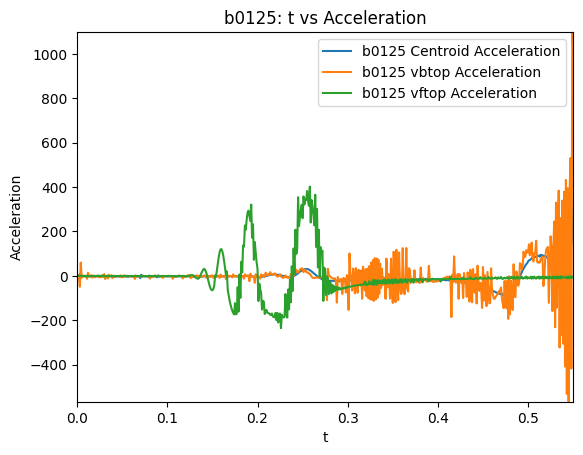

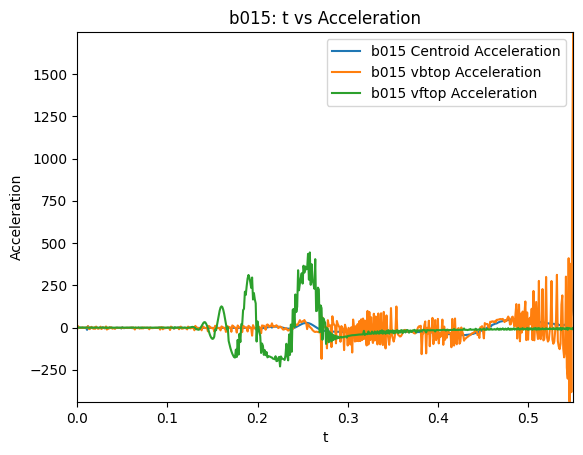

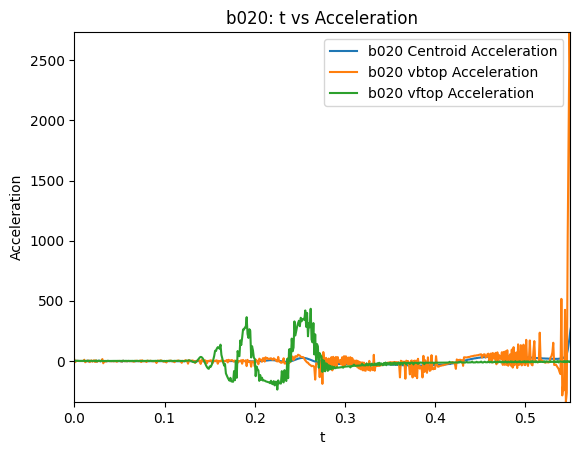

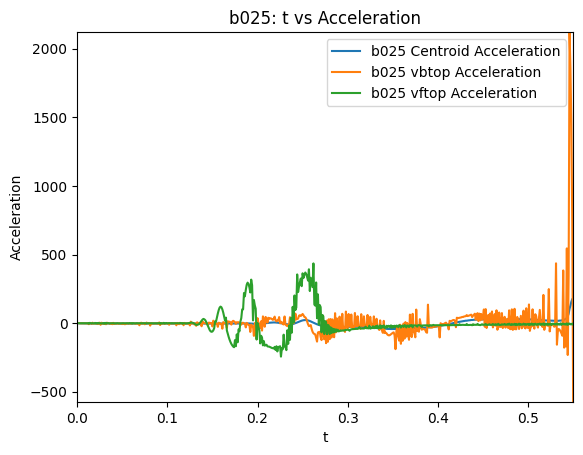

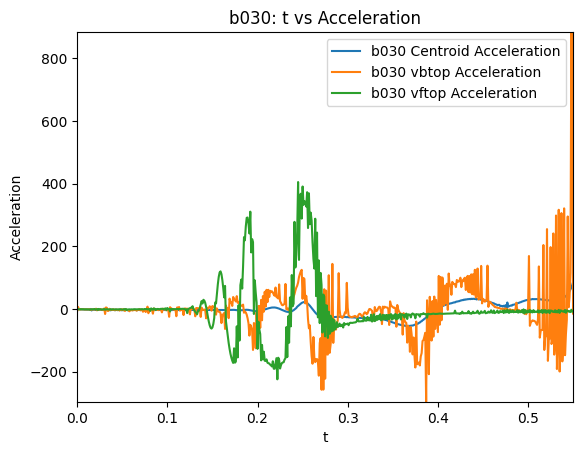

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()
    # Calculate acceleration (difference of column 2 divided by time step 0.001)
    acceleration_centroid = np.diff(data[:, 2]) / 0.001
    # Calculate acceleration for vbtop (column 5)
    acceleration_vbtop = np.diff(data[:, 5]) / 0.001
    # Calculate acceleration for vftop (column 6)
    acceleration_vftop = np.diff(data[:, 6]) / 0.001

    # The time array for acceleration will be one element shorter
    time_accel = data[:-1, 0]

    ax.plot(time_accel, acceleration_centroid, label=f'{name} Centroid Acceleration')
    ax.plot(time_accel, acceleration_vbtop, label=f'{name} vbtop Acceleration')
    ax.plot(time_accel, acceleration_vftop, label=f'{name} vftop Acceleration')


    ax.set_xlabel('t')
    ax.set_ylabel('Acceleration')
    ax.set_title(f'{name}: t vs Acceleration')
    ax.legend()

    xlim_min, xlim_max = 0, 0.55

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_acceleration_centroid = acceleration_centroid[(time_accel >= xlim_min) & (time_accel <= xlim_max)]
    filtered_acceleration_vbtop = acceleration_vbtop[(time_accel >= xlim_min) & (time_accel <= xlim_max)]
    filtered_acceleration_vftop = acceleration_vftop[(time_accel >= xlim_min) & (time_accel <= xlim_max)]


    # Set appropriate y-limits based on the filtered acceleration data
    min_y = min(np.min(filtered_acceleration_centroid), np.min(filtered_acceleration_vbtop), np.min(filtered_acceleration_vftop))
    max_y = max(np.max(filtered_acceleration_centroid), np.max(filtered_acceleration_vbtop), np.max(filtered_acceleration_vftop))
    ax.set_ylim(min_y, max_y)


    plt.show()

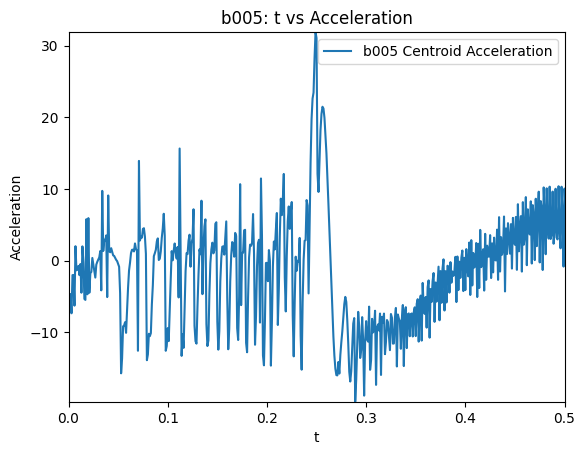

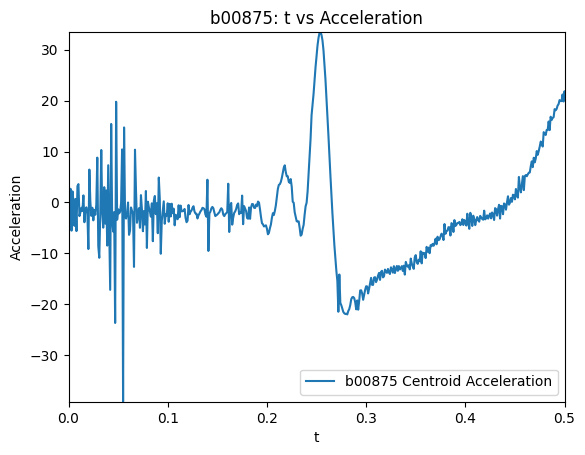

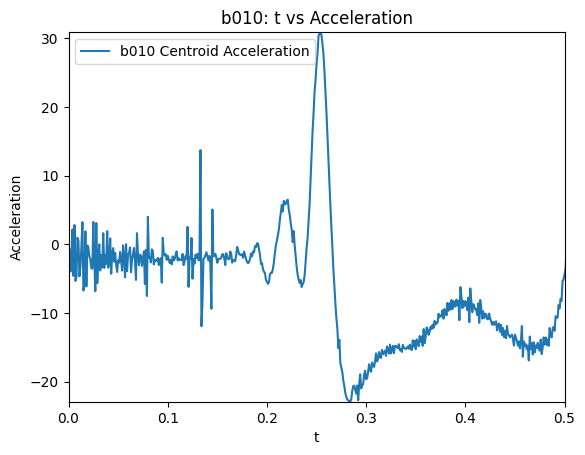

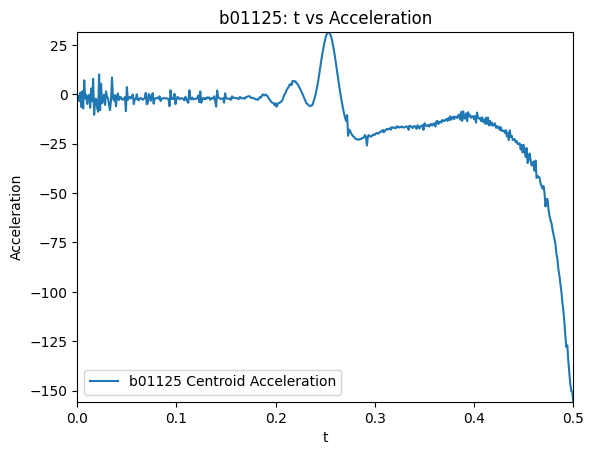

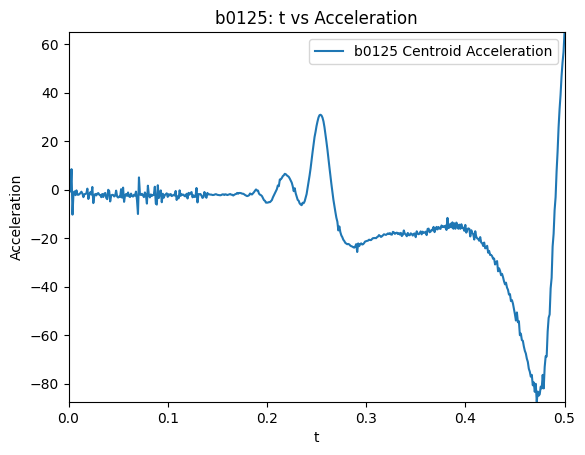

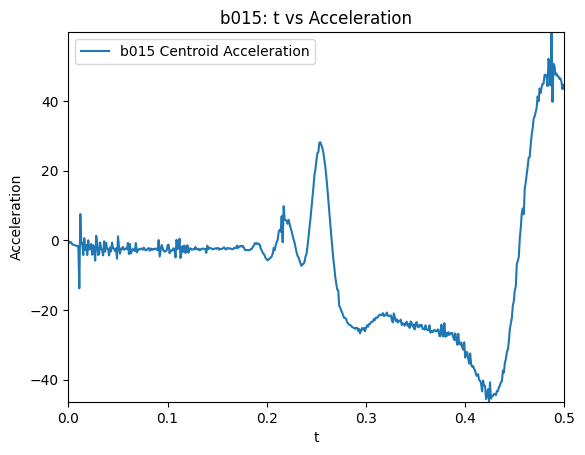

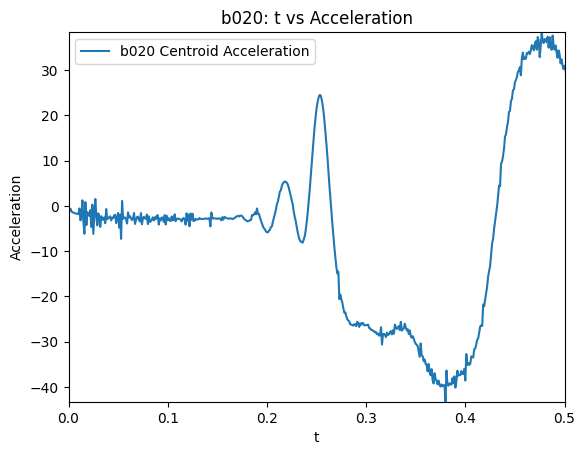

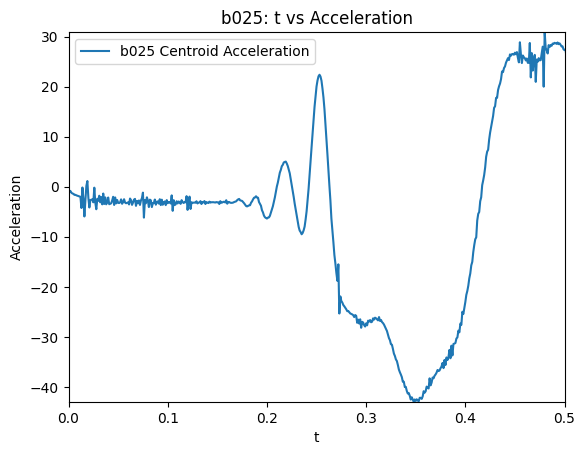

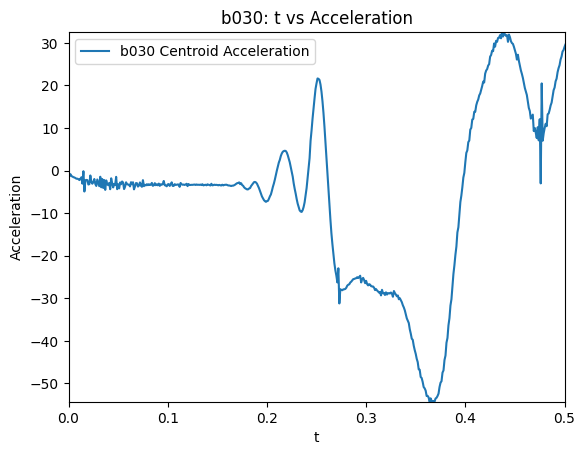

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()
    # Calculate acceleration (difference of column 2 divided by time step 0.001)
    acceleration_centroid = np.diff(data[:, 2]) / 0.001
    # Calculate acceleration for vbtop (column 5)
    acceleration_vbtop = np.diff(data[:, 5]) / 0.001
    # Calculate acceleration for vftop (column 6)
    acceleration_vftop = np.diff(data[:, 6]) / 0.001

    # The time array for acceleration will be one element shorter
    time_accel = data[:-1, 0]

    ax.plot(time_accel, acceleration_centroid, label=f'{name} Centroid Acceleration')



    ax.set_xlabel('t')
    ax.set_ylabel('Acceleration')
    ax.set_title(f'{name}: t vs Acceleration')
    ax.legend()

    xlim_min, xlim_max = 0, 0.5

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_acceleration_centroid = acceleration_centroid[(time_accel >= xlim_min) & (time_accel <= xlim_max)]
    filtered_acceleration_vbtop = acceleration_vbtop[(time_accel >= xlim_min) & (time_accel <= xlim_max)]
    filtered_acceleration_vftop = acceleration_vftop[(time_accel >= xlim_min) & (time_accel <= xlim_max)]


    # Set appropriate y-limits based on the filtered acceleration data
    min_y = np.min(filtered_acceleration_centroid)
    max_y = np.max(filtered_acceleration_centroid)
    ax.set_ylim(min_y, max_y)


    plt.show()

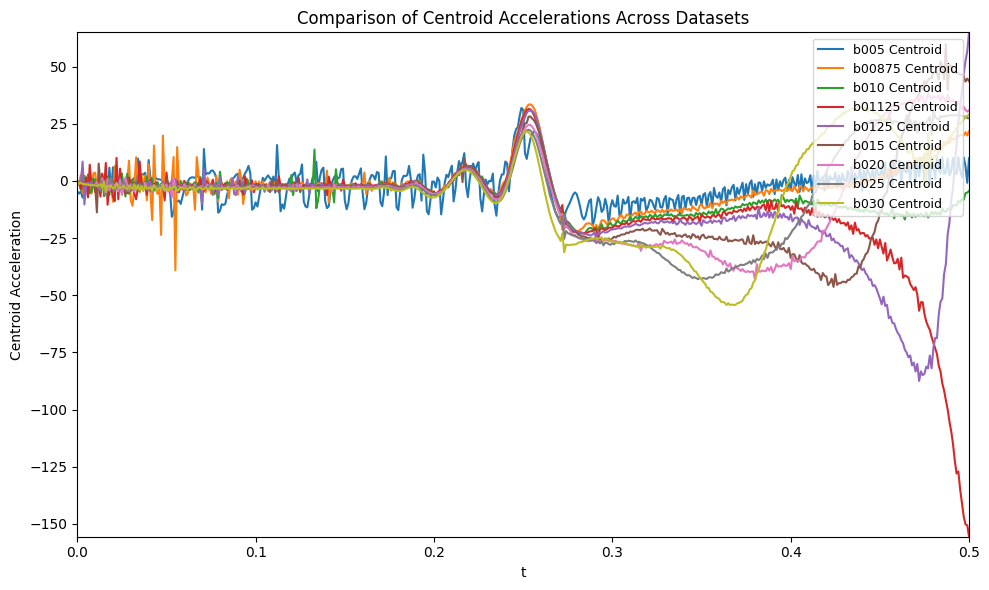

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# assuming datasets dict is already defined
fig, ax = plt.subplots(figsize=(10, 6))

xlim_min, xlim_max = 0, 0.5

for name, data in datasets.items():
    # Calculate acceleration (difference of column 2 divided by time step 0.001)
    acceleration_centroid = np.diff(data[:, 2]) / 0.001

    # The time array for acceleration will be one element shorter
    time_accel = data[:-1, 0]

    # Plot centroid acceleration for this dataset
    ax.plot(time_accel, acceleration_centroid, label=f'{name} Centroid')

# Labels, title, limits
ax.set_xlabel('t')
ax.set_ylabel('Centroid Acceleration $a_x$')
ax.set_title('Comparison of Centroid Accelerations Across Datasets')
ax.set_xlim(xlim_min, xlim_max)

# Auto-adjust y-limits across all datasets
all_accel = []
for name, data in datasets.items():
    acc = np.diff(data[:, 2]) / 0.001
    t = data[:-1, 0]
    mask = (t >= xlim_min) & (t <= xlim_max)
    all_accel.extend(acc[mask])
ax.set_ylim(np.min(all_accel), np.max(all_accel))

# Add legend outside the plot for clarity
ax.legend(loc='upper right', fontsize=9)

plt.tight_layout()
plt.show()


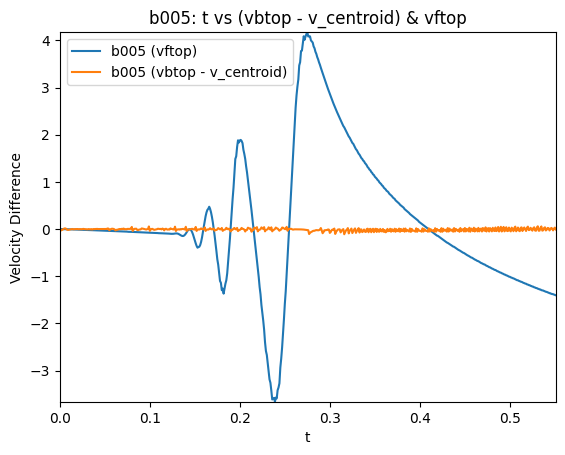

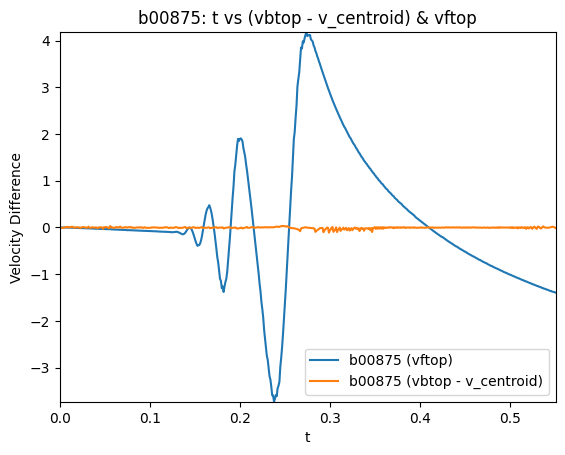

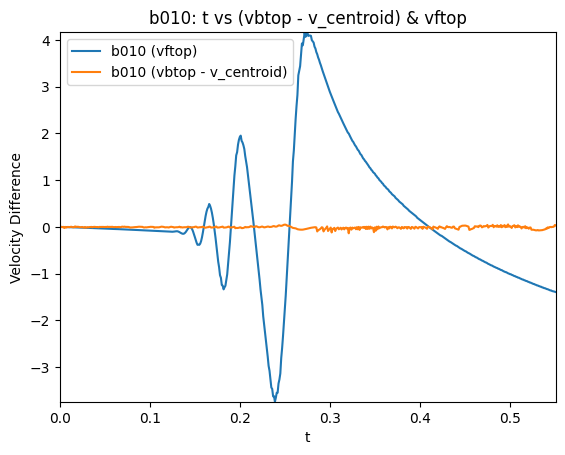

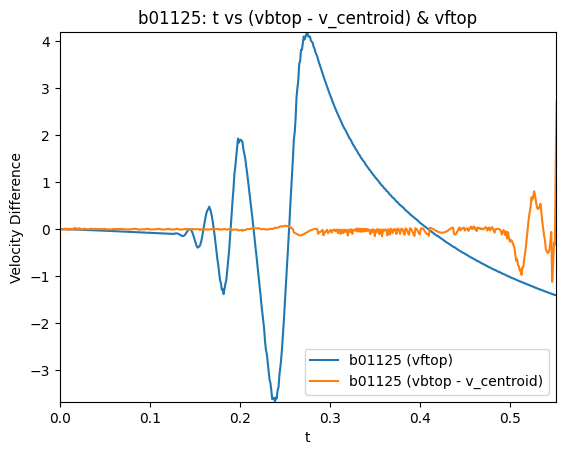

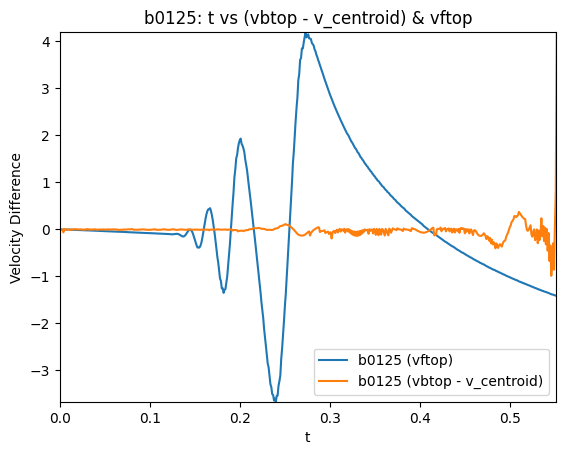

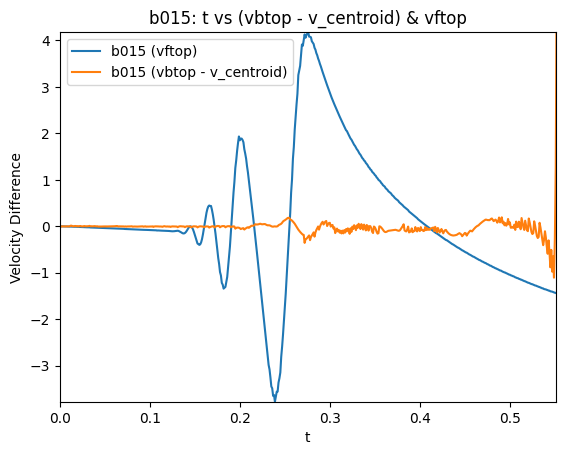

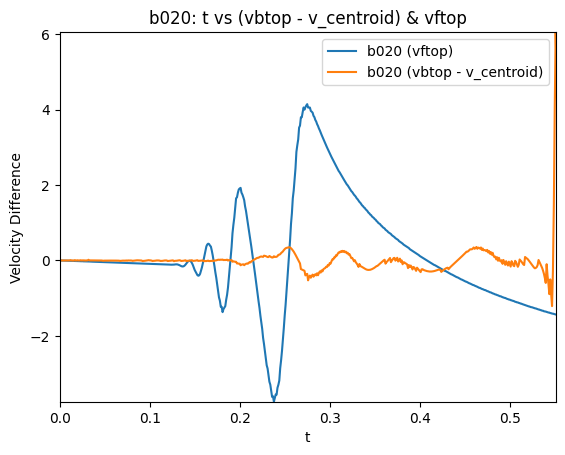

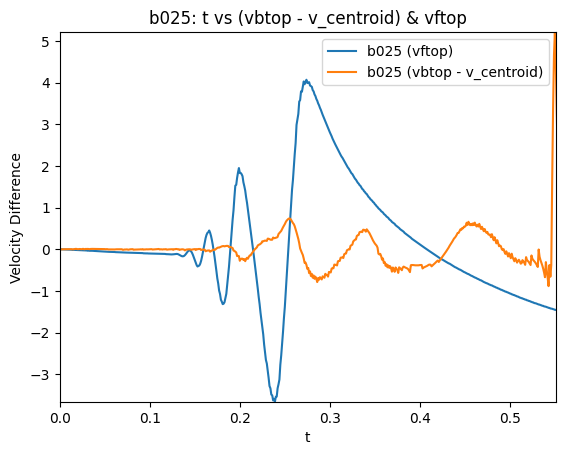

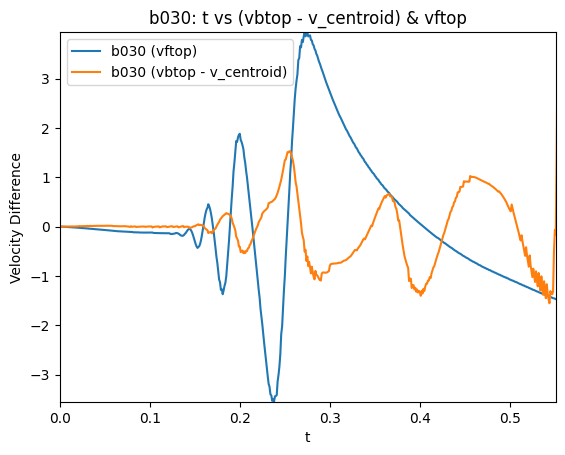

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    # Calculate the difference between column 5 (vbtop) and column 2 (velocity_x_centroid)
    diff_velocity = data[:, 5] - data[:, 2]
    top_velocity = data[:, 6]
    ax.plot(data[:, 0], top_velocity, label=f'{name} (vftop)')
    ax.plot(data[:, 0], diff_velocity, label=f'{name} (vbtop - v_centroid)')

    ax.set_xlabel('t')
    ax.set_ylabel('Velocity Difference')
    ax.set_title(f'{name}: t vs (vbtop - v_centroid) & vftop')
    ax.legend()

    xlim_min, xlim_max = 0, 0.551

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    filtered_diff_velocity = filtered_data[:, 5] - filtered_data[:, 2]
    filtered_top_velocity = filtered_data[:, 6]

    # Set appropriate y-limits based on the filtered velocity difference data
    min_y = min(np.min(filtered_diff_velocity),np.min(filtered_top_velocity))
    max_y = max(np.max(filtered_diff_velocity),np.max(filtered_top_velocity))
    ax.set_ylim(min_y, max_y)

    plt.show()

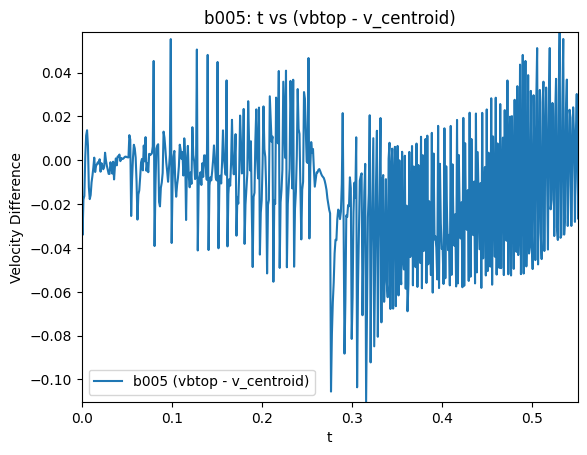

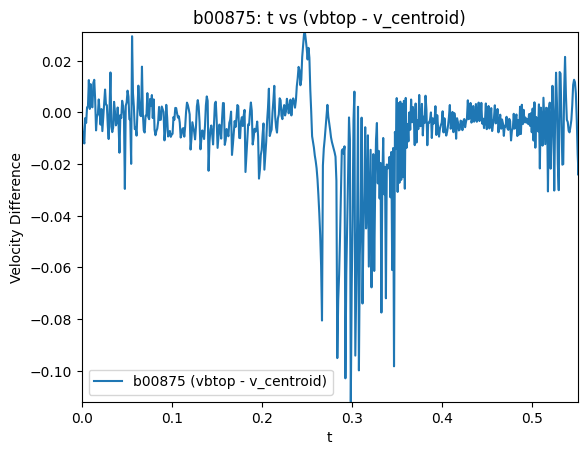

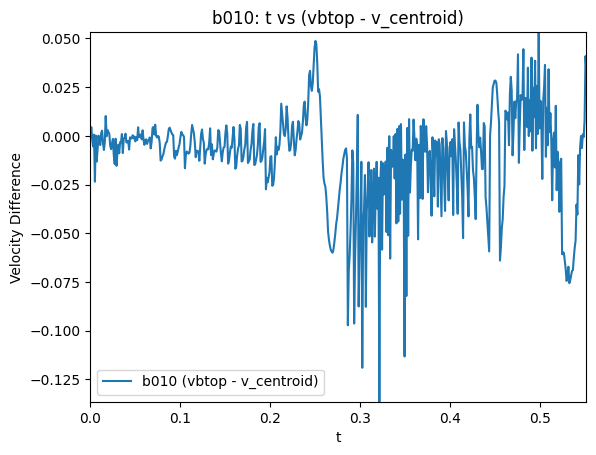

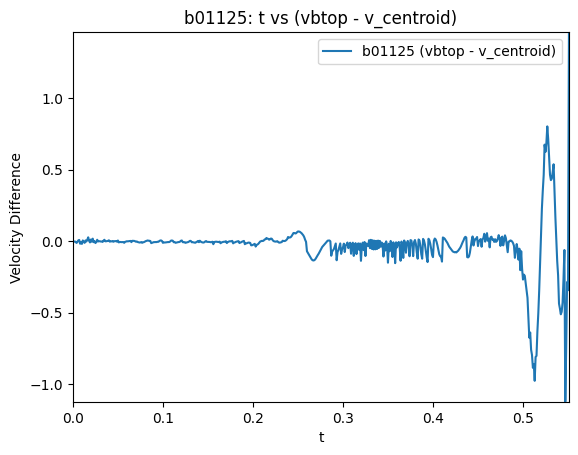

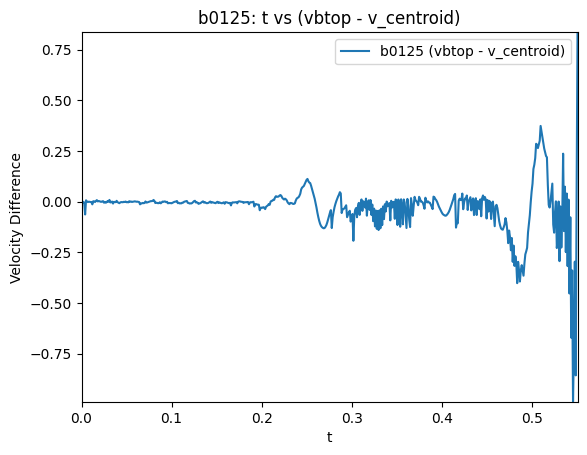

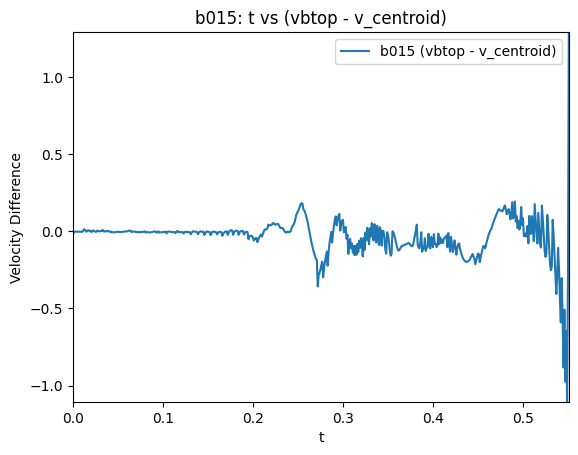

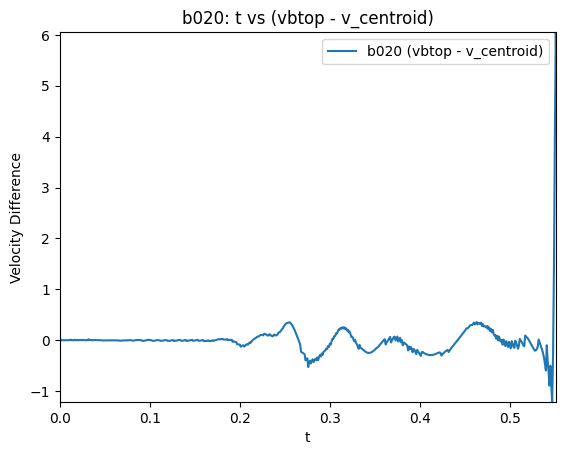

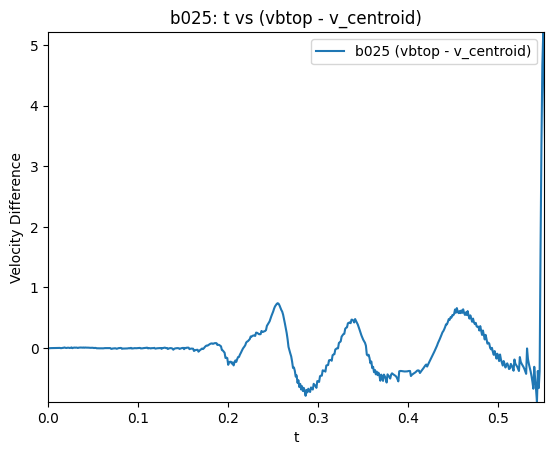

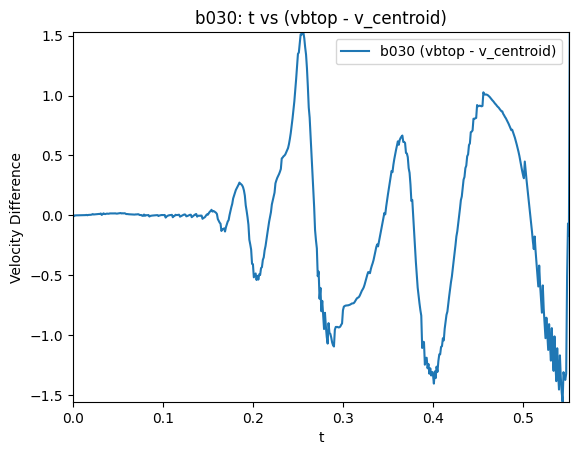

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    # Calculate the difference between column 5 (vbtop) and column 2 (velocity_x_centroid)
    diff_velocity = data[:, 5] - data[:, 2]

    ax.plot(data[:, 0], diff_velocity, label=f'{name} (vbtop - v_centroid)')

    ax.set_xlabel('t')
    ax.set_ylabel('Velocity Difference')
    ax.set_title(f'{name}: t vs (vbtop - v_centroid)')
    ax.legend()

    xlim_min, xlim_max = 0, 0.551

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    filtered_diff_velocity = filtered_data[:, 5] - filtered_data[:, 2]


    # Set appropriate y-limits based on the filtered velocity difference data
    min_y = np.min(filtered_diff_velocity)
    max_y = np.max(filtered_diff_velocity)
    ax.set_ylim(min_y, max_y)

    plt.show()

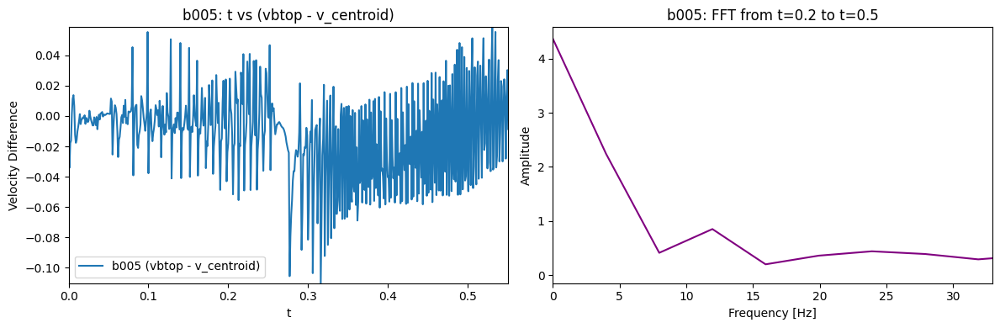

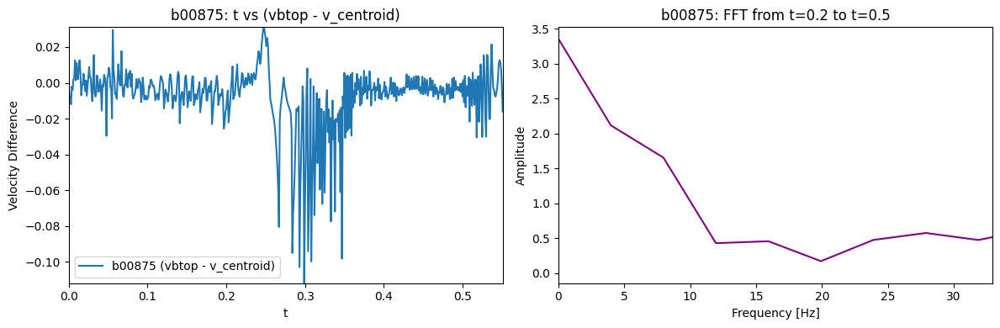

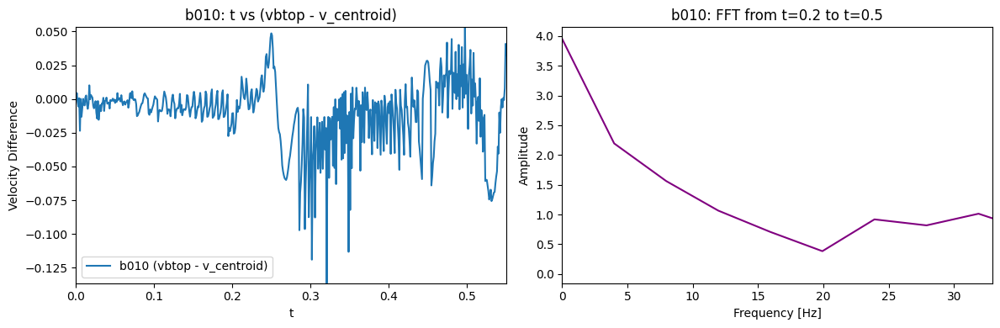

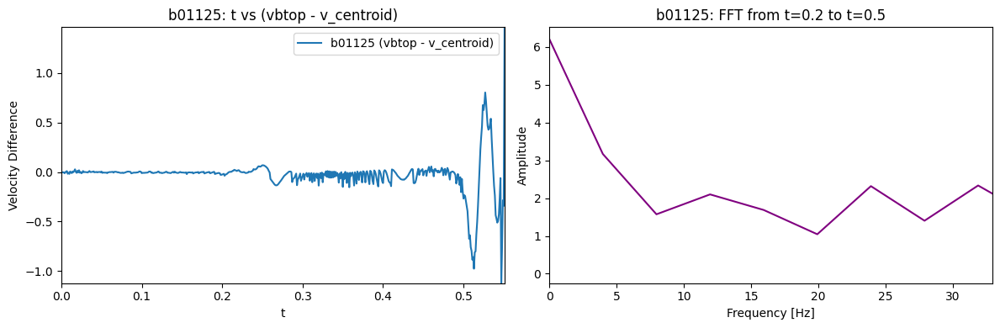

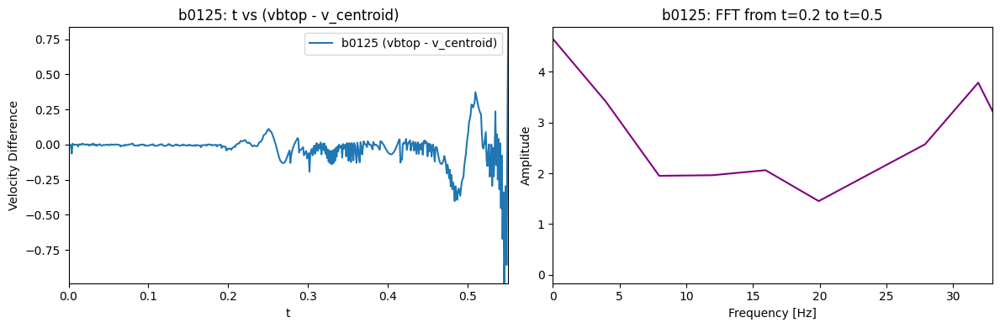

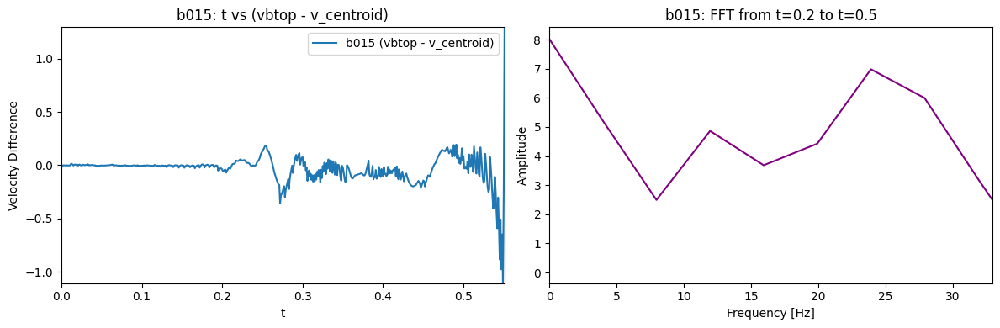

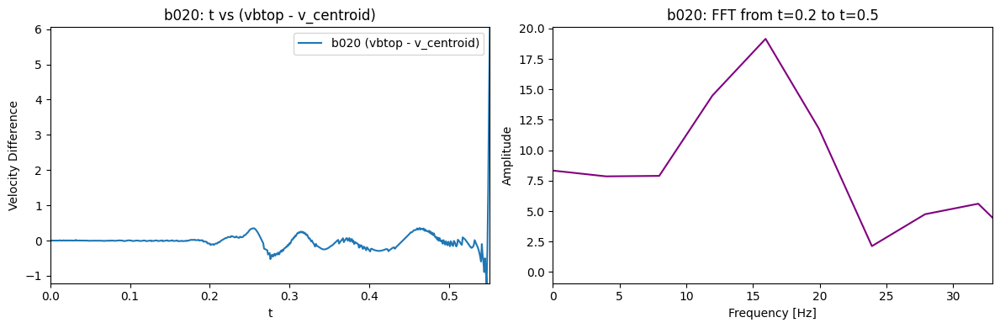

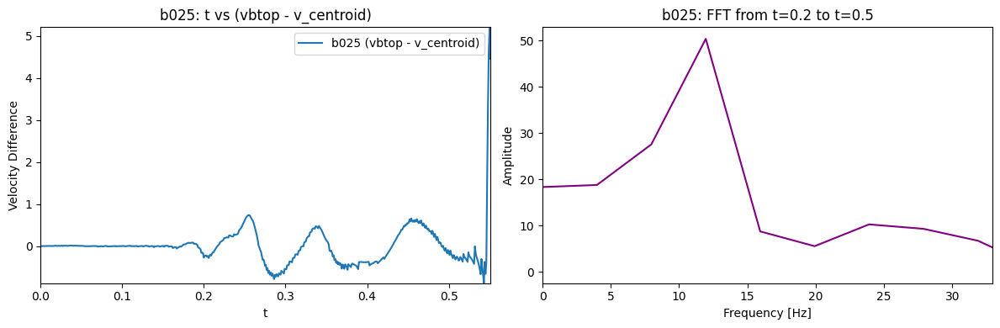

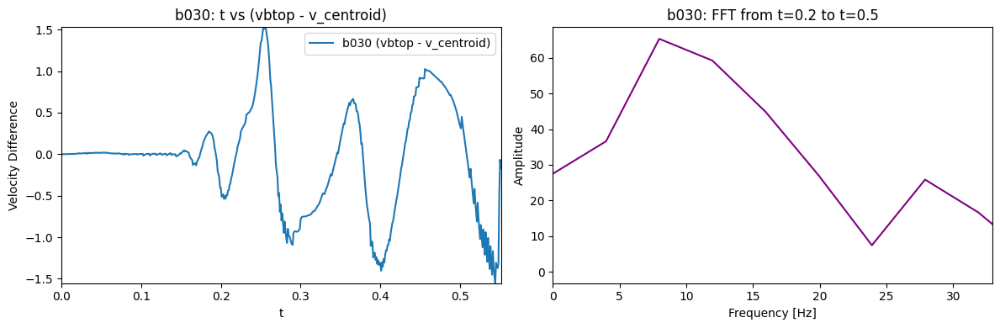

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    # Time-domain data: Full plot range
    xlim_min, xlim_max = 0, 0.551
    plot_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    t_plot = plot_data[:, 0]
    diff_velocity_plot = plot_data[:, 5] - plot_data[:, 2]

    # FFT range: 0.2 to 0.5 seconds
    fft_range_min, fft_range_max = 0.15, 0.4
    fft_data = data[(data[:, 0] >= fft_range_min) & (data[:, 0] <= fft_range_max)]
    t_fft = fft_data[:, 0]
    diff_velocity_fft = fft_data[:, 5] - fft_data[:, 2]

    # Compute FFT
    N = len(t_fft)
    if N < 2:
        print(f"Not enough data for FFT in {name}")
        continue

    dt = np.mean(np.diff(t_fft))
    fft_vals = np.fft.fft(diff_velocity_fft)
    fft_freqs = np.fft.fftfreq(N, d=dt)

    # Keep only positive frequencies
    pos_freqs = fft_freqs[:N // 2]
    pos_fft_vals = np.abs(fft_vals[:N // 2])

    # --- Plot time-domain and FFT ---
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    # Time-domain plot
    ax1.plot(t_plot, diff_velocity_plot, label=f'{name} (vbtop - v_centroid)')
    ax1.set_xlabel('t')
    ax1.set_ylabel('Velocity Difference')
    ax1.set_title(f'{name}: t vs (vbtop - v_centroid)')
    ax1.set_xlim(xlim_min, xlim_max)

    # Dynamic y-limits
    min_y = np.min(diff_velocity_plot)
    max_y = np.max(diff_velocity_plot)
    ax1.set_ylim(min_y, max_y)
    ax1.legend()

    # FFT plot
    ax2.plot(pos_freqs, pos_fft_vals, color='purple')
    ax2.set_xlabel('Frequency [Hz]')
    ax2.set_ylabel('Amplitude')
    ax2.set_title(f'{name}: FFT from t=0.2 to t=0.5')
    ax2.set_xlim(0, np.max(pos_freqs)/15)  # You can limit this if desired

    plt.tight_layout()
    plt.show()

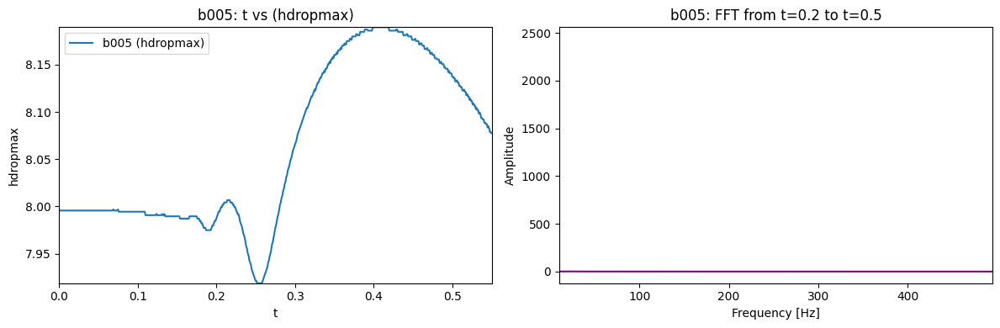

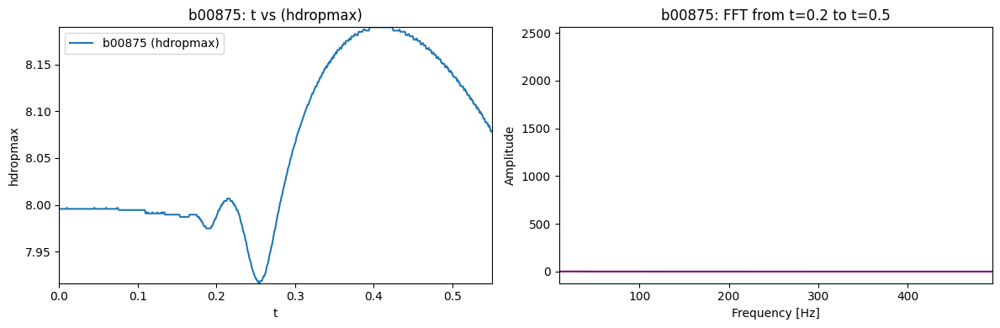

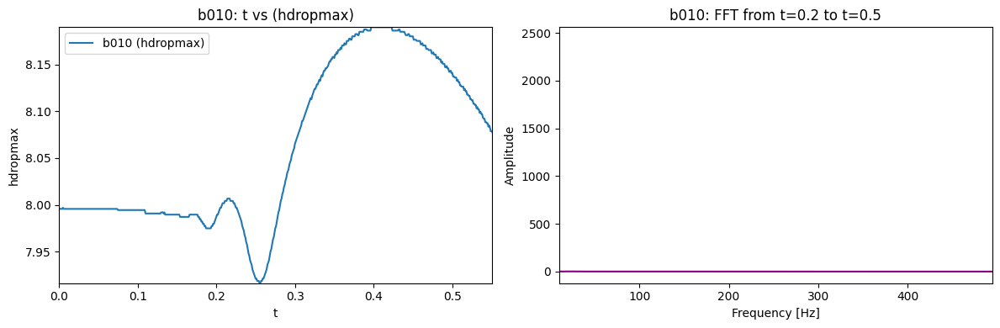

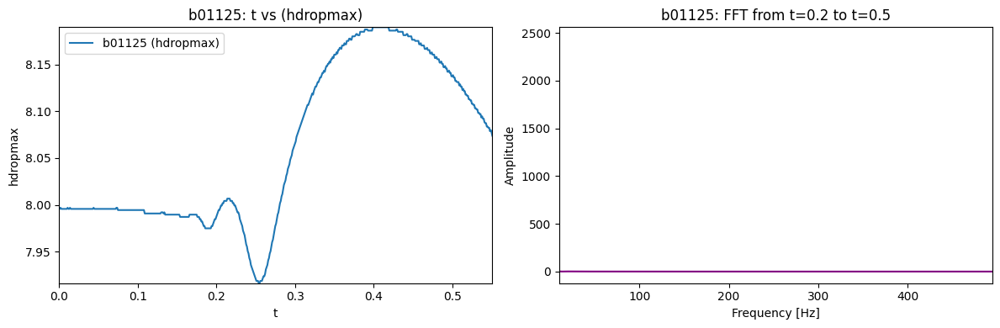

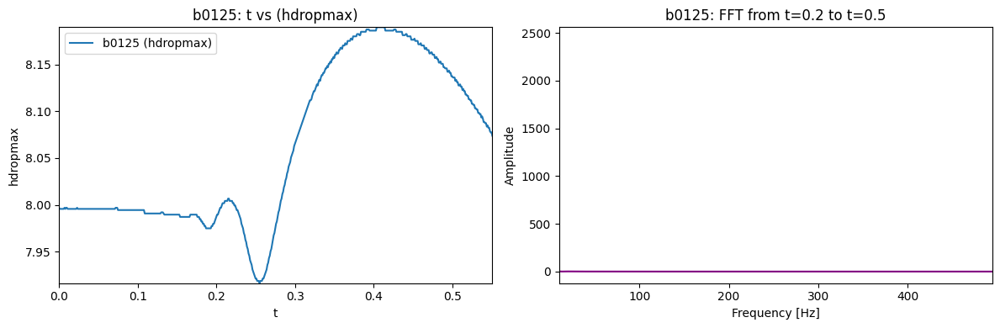

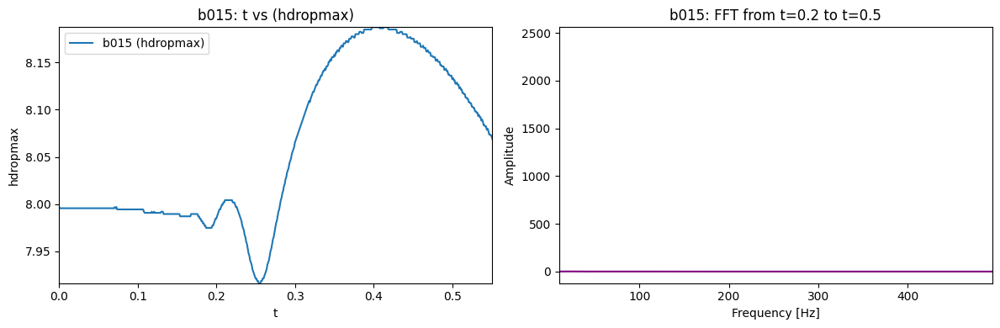

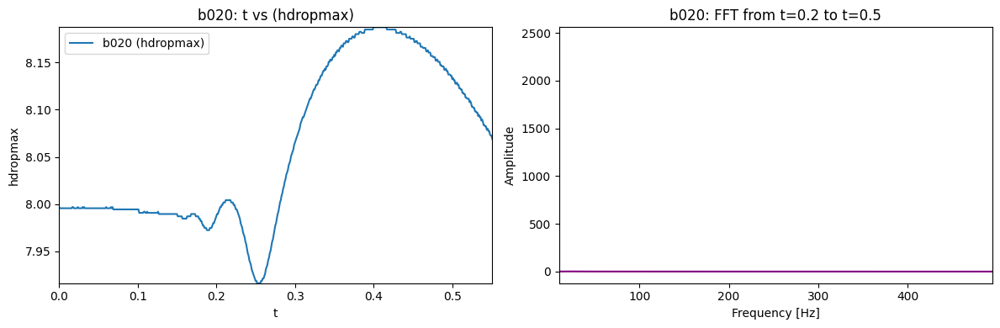

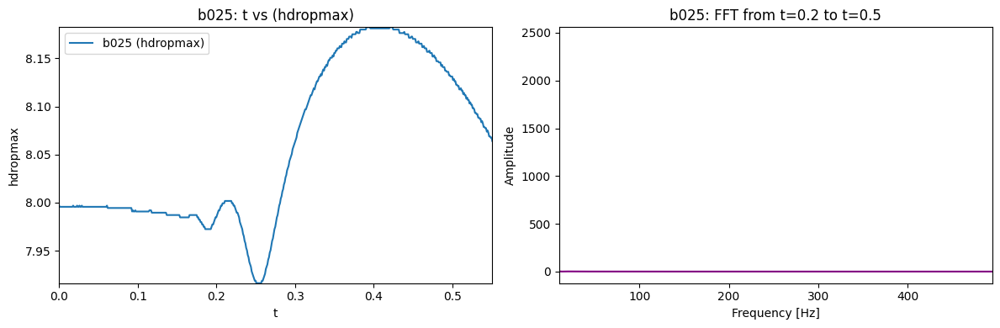

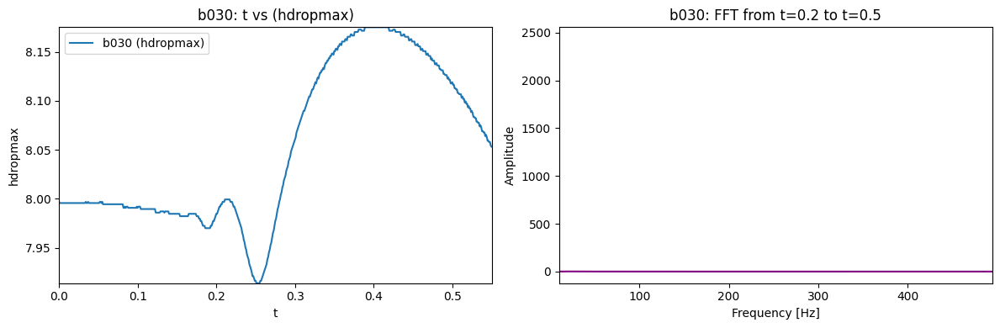

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    # Time-domain data: Full plot range
    xlim_min, xlim_max = 0, 0.551
    plot_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    t_plot = plot_data[:, 0]
    diff_velocity_plot = plot_data[:, 4]

    # FFT range: 0.2 to 0.5 seconds
    fft_range_min, fft_range_max = 0.2, 0.5
    fft_data = data[(data[:, 0] >= fft_range_min) & (data[:, 0] <= fft_range_max)]
    t_fft = fft_data[:, 0]
    diff_velocity_fft = fft_data[:, 4]

    # Compute FFT
    N = len(t_fft)
    if N < 2:
        print(f"Not enough data for FFT in {name}")
        continue

    dt = np.mean(np.diff(t_fft))
    fft_vals = np.fft.fft(diff_velocity_fft)
    fft_freqs = np.fft.fftfreq(N, d=dt)

    # Keep only positive frequencies
    pos_freqs = fft_freqs[:N // 2]
    pos_fft_vals = np.abs(fft_vals[:N // 2])

    # --- Plot time-domain and FFT ---
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    # Time-domain plot
    ax1.plot(t_plot, diff_velocity_plot, label=f'{name} (hdropmax)')
    ax1.set_xlabel('t')
    ax1.set_ylabel('hdropmax')
    ax1.set_title(f'{name}: t vs (hdropmax)')
    ax1.set_xlim(xlim_min, xlim_max)

    # Dynamic y-limits
    min_y = np.min(diff_velocity_plot)
    max_y = np.max(diff_velocity_plot)
    ax1.set_ylim(min_y, max_y)
    ax1.legend()

    # FFT plot
    ax2.plot(pos_freqs, pos_fft_vals, color='purple')
    ax2.set_xlabel('Frequency [Hz]')
    ax2.set_ylabel('Amplitude')
    ax2.set_title(f'{name}: FFT from t=0.2 to t=0.5')
    ax2.set_xlim(0, np.max(pos_freqs))  # You can limit this if desired

    plt.tight_layout()
    plt.show()

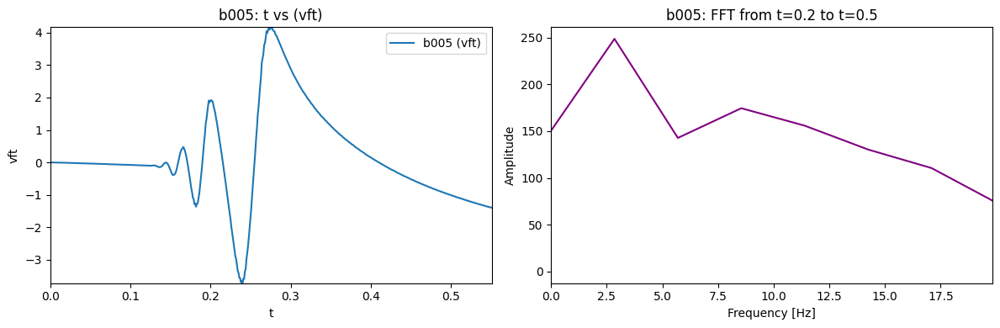

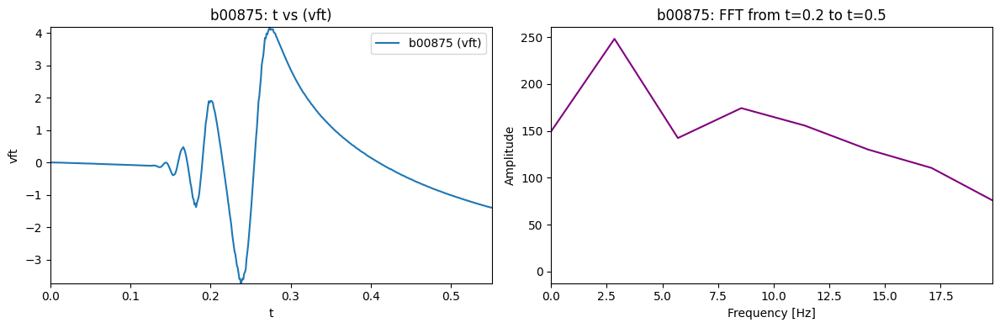

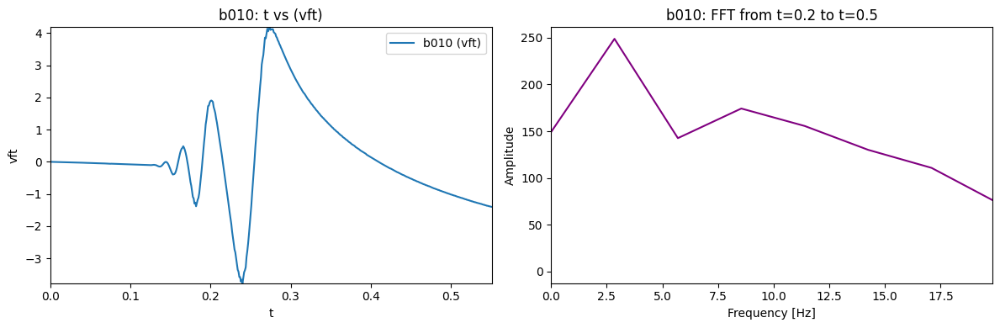

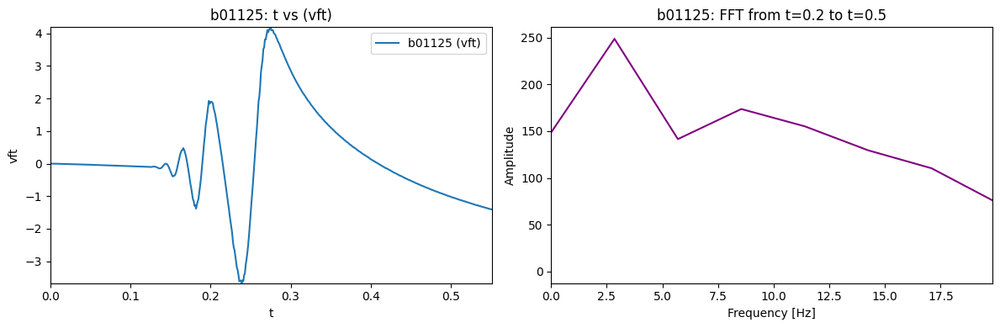

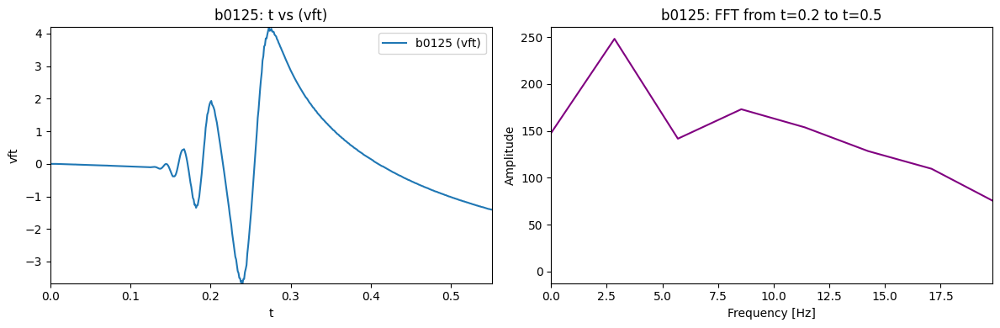

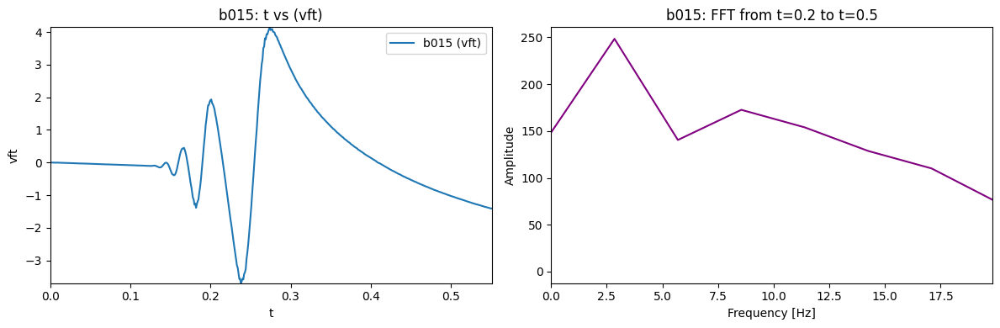

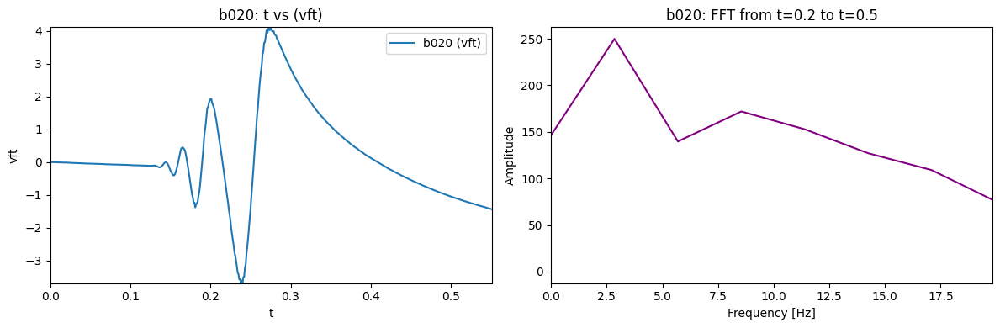

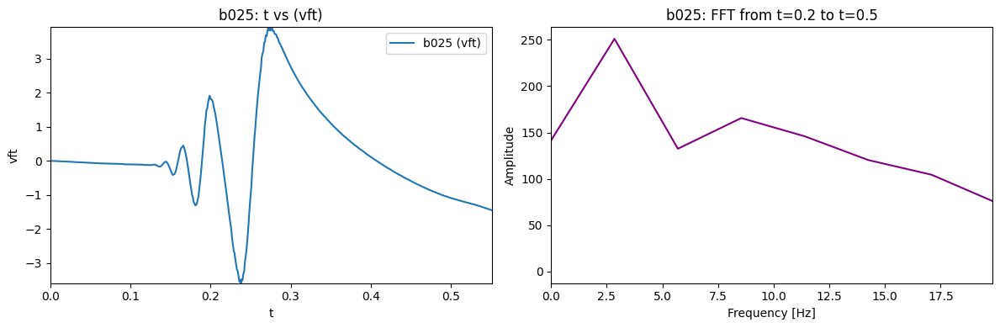

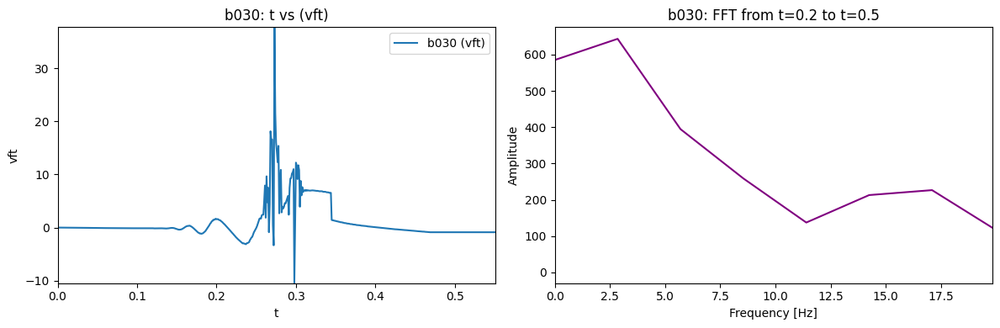

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

for name, data in datasets.items():
    # Time-domain data: Full plot range
    xlim_min, xlim_max = 0, 0.551
    plot_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    t_plot = plot_data[:, 0]
    diff_velocity_plot = plot_data[:, 6]

    # FFT range: 0.2 to 0.5 seconds
    fft_range_min, fft_range_max = 0.15, 0.5
    fft_data = data[(data[:, 0] >= fft_range_min) & (data[:, 0] <= fft_range_max)]
    t_fft = fft_data[:, 0]
    diff_velocity_fft = fft_data[:, 6]

    # Compute FFT
    N = len(t_fft)
    if N < 2:
        print(f"Not enough data for FFT in {name}")
        continue

    dt = np.mean(np.diff(t_fft))
    fft_vals = np.fft.fft(diff_velocity_fft)
    fft_freqs = np.fft.fftfreq(N, d=dt)

    # Keep only positive frequencies
    pos_freqs = fft_freqs[:N // 2]
    pos_fft_vals = np.abs(fft_vals[:N // 2])

    # --- Plot time-domain and FFT ---
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    # Time-domain plot
    ax1.plot(t_plot, diff_velocity_plot, label=f'{name} (vft)')
    ax1.set_xlabel('t')
    ax1.set_ylabel('vft')
    ax1.set_title(f'{name}: t vs (vft)')
    ax1.set_xlim(xlim_min, xlim_max)

    # Dynamic y-limits
    min_y = np.min(diff_velocity_plot)
    max_y = np.max(diff_velocity_plot)
    ax1.set_ylim(min_y, max_y)
    ax1.legend()

    # FFT plot
    ax2.plot(pos_freqs, pos_fft_vals, color='purple')
    ax2.set_xlabel('Frequency [Hz]')
    ax2.set_ylabel('Amplitude')
    ax2.set_title(f'{name}: FFT from t=0.2 to t=0.5')
    ax2.set_xlim(0, np.max(pos_freqs)/25)  # You can limit this if desired

    plt.tight_layout()
    plt.show()

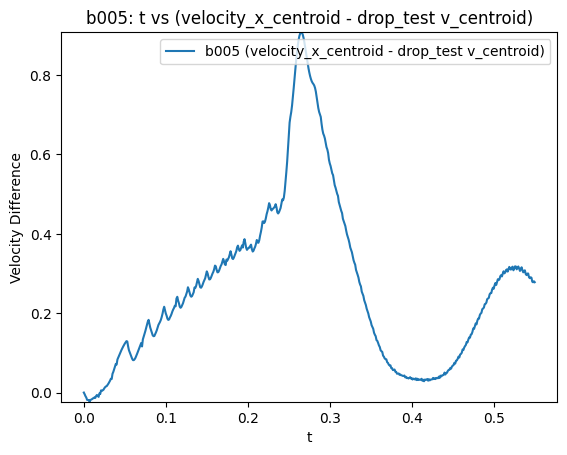

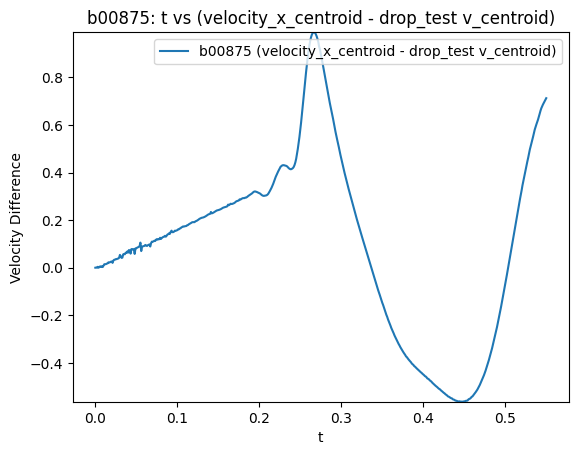

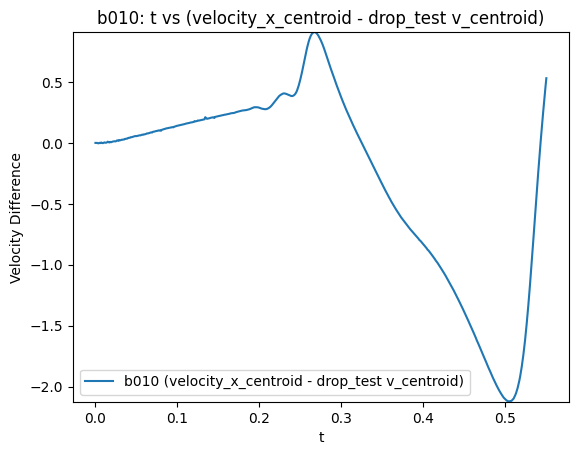

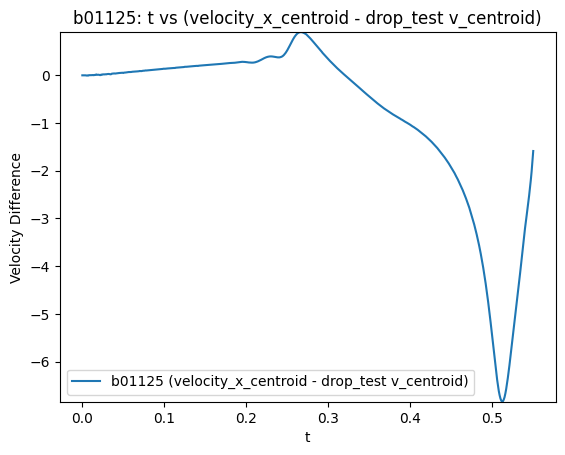

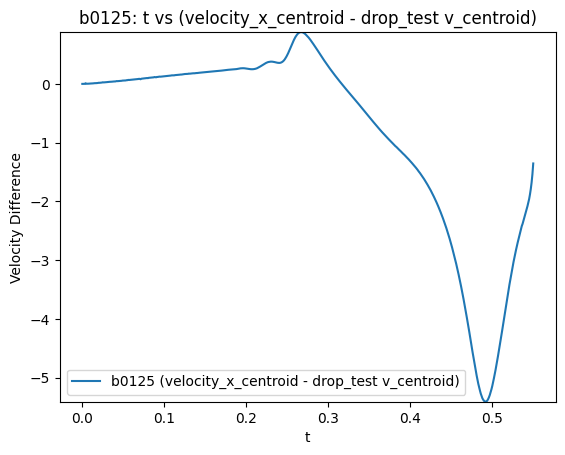

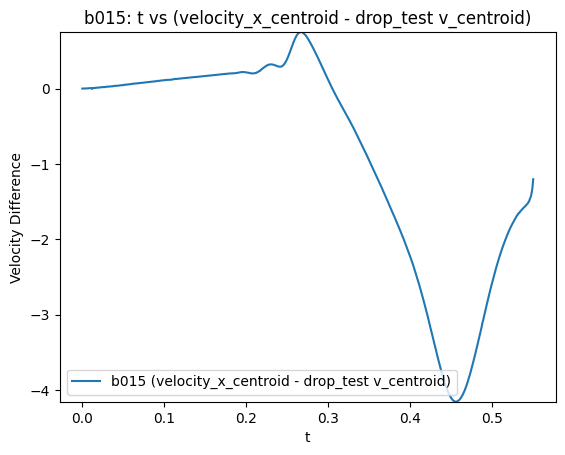

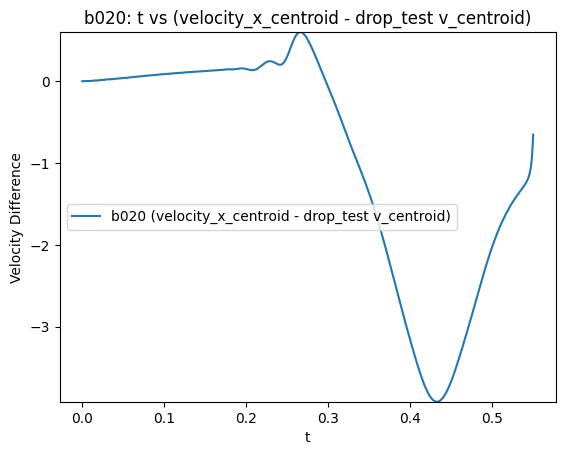

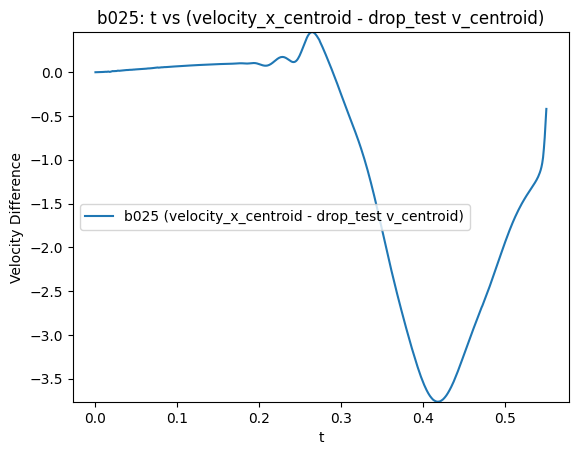

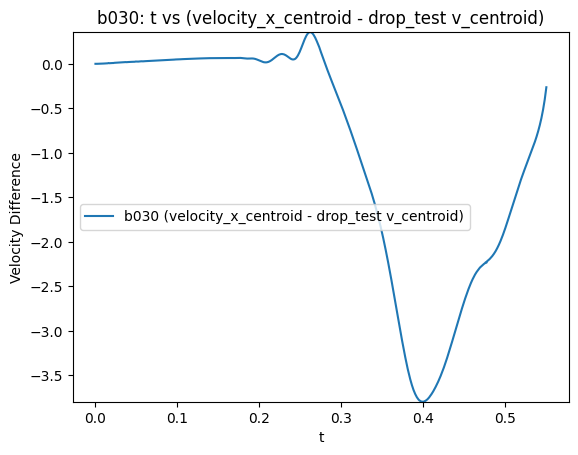

Average velocity difference for b005 between 0.265s and 0.415s: 0.3286


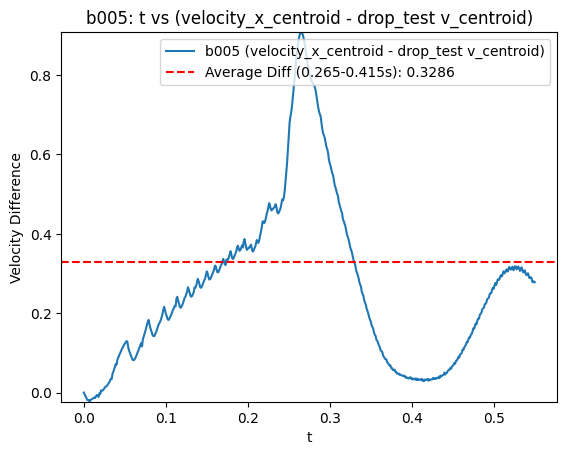

Average velocity difference for b00875 between 0.267s and 0.448s: -0.0542


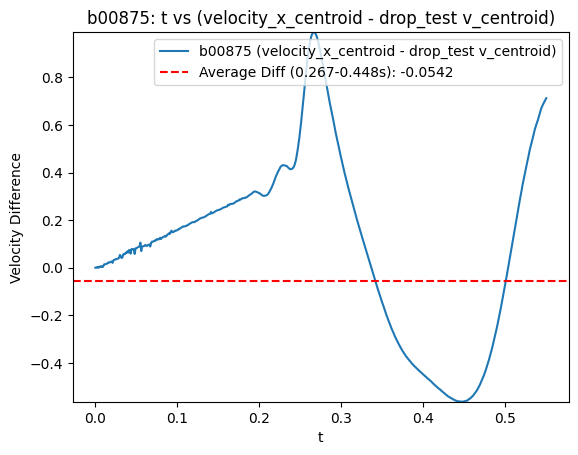

Average velocity difference for b010 between 0.267s and 0.505s: -0.6786


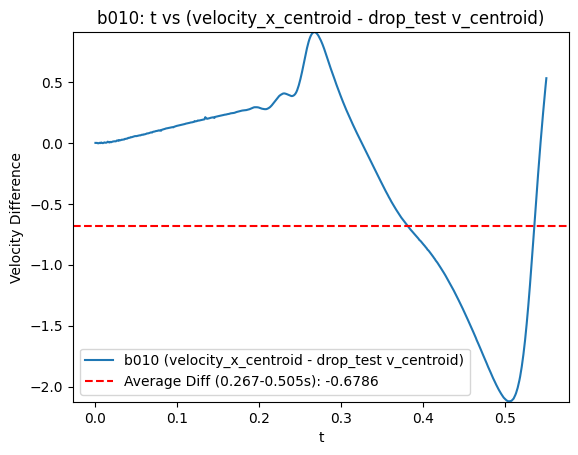

Average velocity difference for b01125 between 0.267s and 0.512s: -1.3347


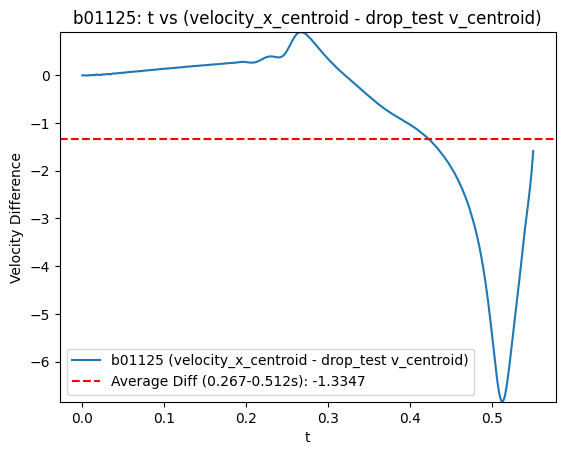

Average velocity difference for b0125 between 0.267s and 0.492s: -1.3474


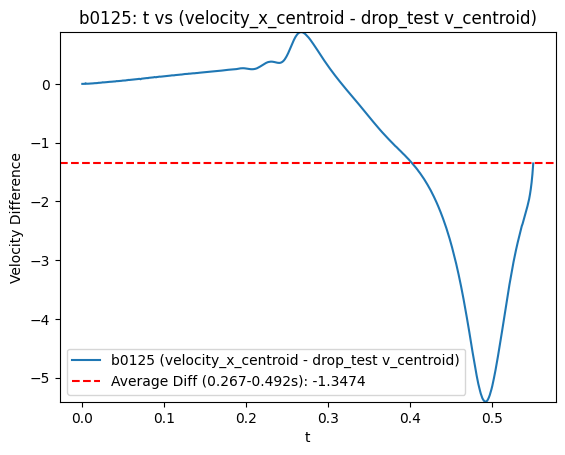

Average velocity difference for b015 between 0.267s and 0.456s: -1.4193


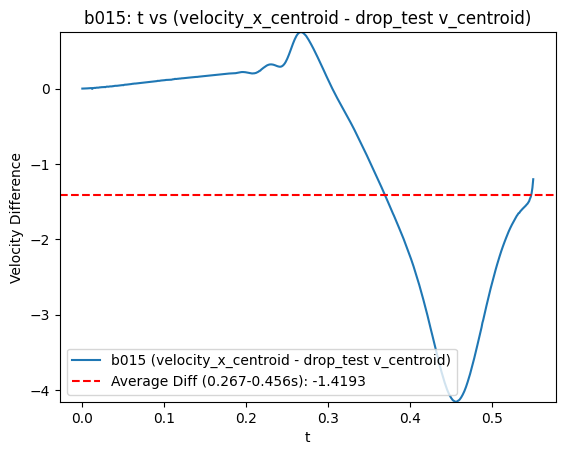

Average velocity difference for b020 between 0.266s and 0.433s: -1.5421


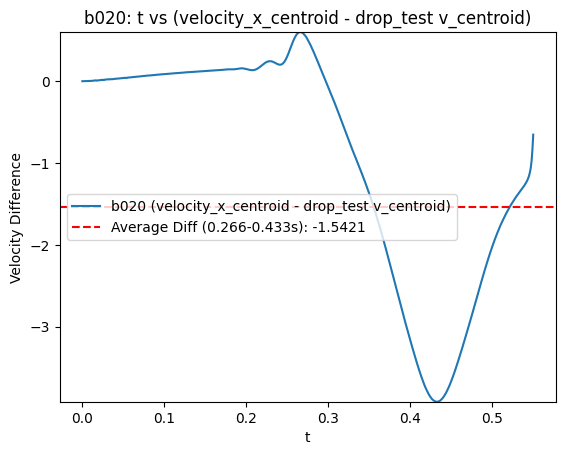

Average velocity difference for b025 between 0.264s and 0.417s: -1.5845


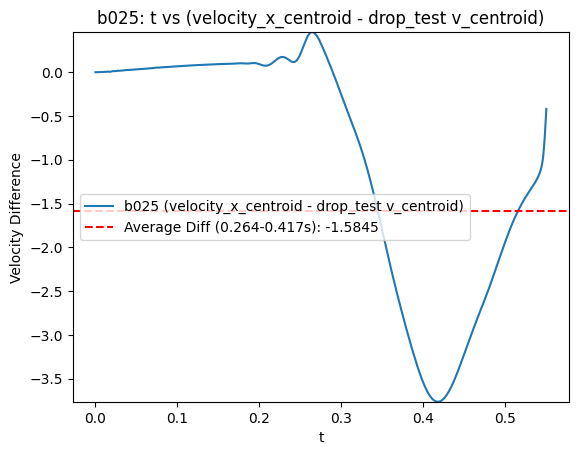

Average velocity difference for b030 between 0.262s and 0.399s: -1.5109


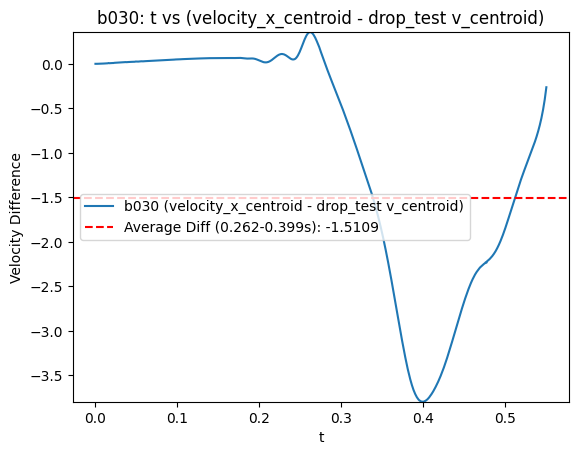

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

# Assuming drop_test is already loaded and available
# If not, you might need to load it here:
# drop_test = load_filtered('/content/drive/MyDrive/13, nobubble/log_cont')


for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    # Ensure both datasets cover a similar time range for meaningful comparison
    # Find the overlapping time range
    min_time = max(data[0, 0], drop_test[0, 0])
    max_time = min(data[-1, 0], drop_test[-1, 0])

    # Filter data within the overlapping time range
    filtered_data = data[(data[:, 0] >= min_time) & (data[:, 0] <= max_time)]
    filtered_drop_test = drop_test[(drop_test[:, 0] >= min_time) & (drop_test[:, 0] <= max_time)]

    # To calculate the difference, the time points need to be aligned.
    # We can interpolate one dataset onto the time points of the other,
    # or resample to a common time base. For simplicity, let's use the time points of the current dataset
    # and interpolate the drop_test v_centroid onto these time points.

    # Check if there is enough data to interpolate
    if filtered_drop_test.shape[0] < 2 or filtered_data.shape[0] < 1:
        print(f"Not enough overlapping data for {name} and drop_test for comparison.")
        continue

    interp_v_centroid_drop_test = np.interp(filtered_data[:, 0], filtered_drop_test[:, 0], filtered_drop_test[:, 2])

    # Calculate the difference: velocity_x_centroid of the current dataset - v_centroid of drop_test
    # velocity_x_centroid is column 2
    diff_velocity = filtered_data[:, 2] - interp_v_centroid_drop_test


    ax.plot(filtered_data[:, 0], diff_velocity, label=f'{name} (velocity_x_centroid - drop_test v_centroid)')

    ax.set_xlabel('t')
    ax.set_ylabel('Velocity Difference')
    ax.set_title(f'{name}: t vs (velocity_x_centroid - drop_test v_centroid)')
    ax.legend()

    # Set appropriate y-limits based on the calculated difference
    if diff_velocity.size > 0:
        min_y = np.min(diff_velocity)
        max_y = np.max(diff_velocity)
        ax.set_ylim(min_y, max_y)

    plt.show()


# Assuming drop_test is already loaded and available
# If not, you might need to load it here:
# drop_test = load_filtered('/content/drive/MyDrive/13, nobubble/log_cont')


for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    # Ensure both datasets cover a similar time range for meaningful comparison
    # Find the overlapping time range
    min_time = max(data[0, 0], drop_test[0, 0])
    max_time = min(data[-1, 0], drop_test[-1, 0])

    # Filter data within the overlapping time range
    filtered_data = data[(data[:, 0] >= min_time) & (data[:, 0] <= max_time)]
    filtered_drop_test = drop_test[(drop_test[:, 0] >= min_time) & (drop_test[:, 0] <= max_time)]

    # To calculate the difference, the time points need to be aligned.
    # We can interpolate one dataset onto the time points of the other,
    # or resample to a common time base. For simplicity, let's use the time points of the current dataset
    # and interpolate the drop_test v_centroid onto these time points.

    # Check if there is enough data to interpolate
    if filtered_drop_test.shape[0] < 2 or filtered_data.shape[0] < 1:
        print(f"Not enough overlapping data for {name} and drop_test for comparison.")
        plt.close(fig) # Close the empty figure
        continue

    interp_v_centroid_drop_test = np.interp(filtered_data[:, 0], filtered_drop_test[:, 0], filtered_drop_test[:, 2])

    # Calculate the difference: velocity_x_centroid of the current dataset - v_centroid of drop_test
    # velocity_x_centroid is column 2
    diff_velocity = filtered_data[:, 2] - interp_v_centroid_drop_test


    ax.plot(filtered_data[:, 0], diff_velocity, label=f'{name} (velocity_x_centroid - drop_test v_centroid)')

    ax.set_xlabel('t')
    ax.set_ylabel('Velocity Difference')
    ax.set_title(f'{name}: t vs (velocity_x_centroid - drop_test v_centroid)')
    ax.legend()

    # Set appropriate y-limits based on the calculated difference
    if diff_velocity.size > 0:
        min_y = np.min(diff_velocity)
        max_y = np.max(diff_velocity)
        ax.set_ylim(min_y, max_y)

    # Define a time range to search for the peak and minimum
    search_range_min, search_range_max = 0.2, 0.3  # Adjust as needed

    # Filter data within the search range
    search_data = filtered_data[(filtered_data[:, 0] >= search_range_min) & (filtered_data[:, 0] <= search_range_max)]
    search_diff_velocity = diff_velocity[(filtered_data[:, 0] >= search_range_min) & (filtered_data[:, 0] <= search_range_max)]


    if search_diff_velocity.size > 1:
        # Find the index of the peak difference within the search range
        peak_diff_index_in_search = np.argmax(search_diff_velocity)
        # Find the index of the minimum difference after the peak
        # We need to find the minimum in the original filtered_data after the time of the peak
        peak_time = search_data[peak_diff_index_in_search, 0]

        # Find the index in the original filtered_data that corresponds to the peak time
        peak_index_in_filtered = np.argmin(abs(filtered_data[:, 0] - peak_time))

        # Search for the minimum in the original filtered_data after the peak index
        if peak_index_in_filtered < len(diff_velocity) - 1:
            min_diff_index_after_peak = np.argmin(diff_velocity[peak_index_in_filtered:]) + peak_index_in_filtered

            # Get the times for the peak and minimum
            time_at_peak = filtered_data[peak_index_in_filtered, 0]
            time_at_min = filtered_data[min_diff_index_after_peak, 0]

            # Ensure minimum comes after the peak
            if time_at_min > time_at_peak:
                # Filter data between the peak and minimum times
                average_range_data = filtered_data[(filtered_data[:, 0] >= time_at_peak) & (filtered_data[:, 0] <= time_at_min)]
                average_range_diff_velocity = diff_velocity[(filtered_data[:, 0] >= time_at_peak) & (filtered_data[:, 0] <= time_at_min)]

                if average_range_diff_velocity.size > 0:
                    average_diff = np.mean(average_range_diff_velocity)
                    ax.axhline(y=average_diff, color='r', linestyle='--', label=f'Average Diff ({time_at_peak:.3f}-{time_at_min:.3f}s): {average_diff:.4f}')
                    ax.legend()
                    print(f"Average velocity difference for {name} between {time_at_peak:.3f}s and {time_at_min:.3f}s: {average_diff:.4f}")
                else:
                    print(f"Not enough data points between peak ({time_at_peak:.3f}) and minimum ({time_at_min:.3f}) for {name} to calculate average.")
            else:
                 print(f"Minimum difference did not occur after the peak for {name} in the specified search range.")
        else:
            print(f"Peak is the last data point or not enough data after peak to find a minimum for {name}.")
    else:
        print(f"Not enough data points in the search range ({search_range_min}-{search_range_max}s) for {name} to find peak and minimum.")


    plt.show()

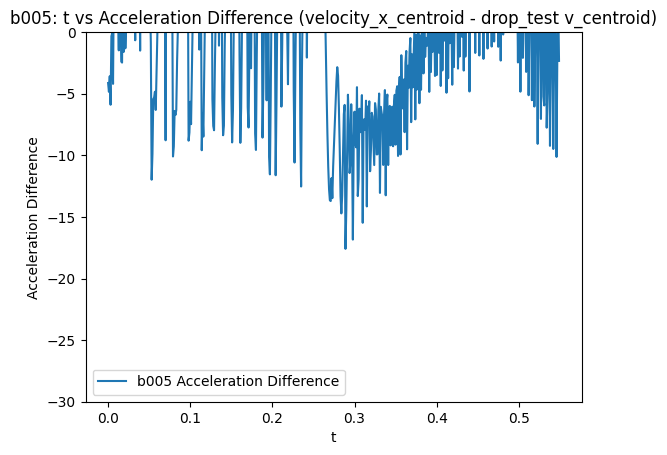

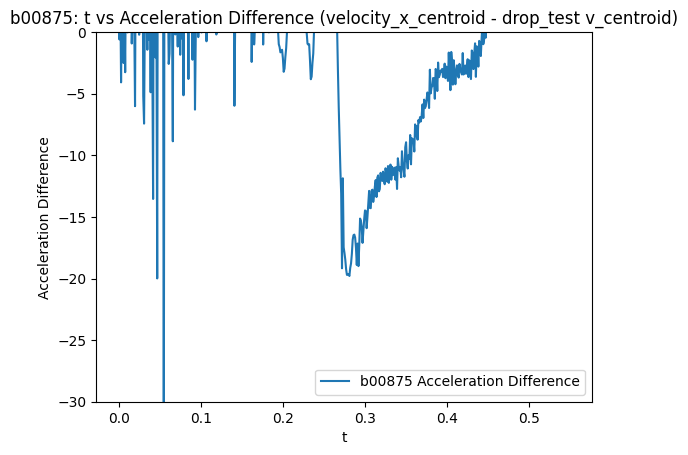

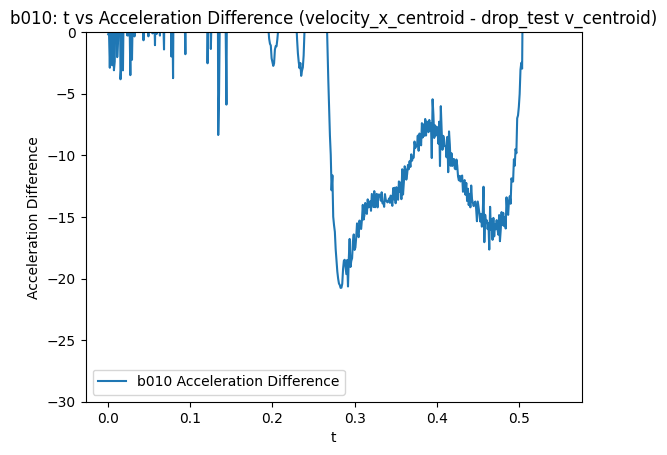

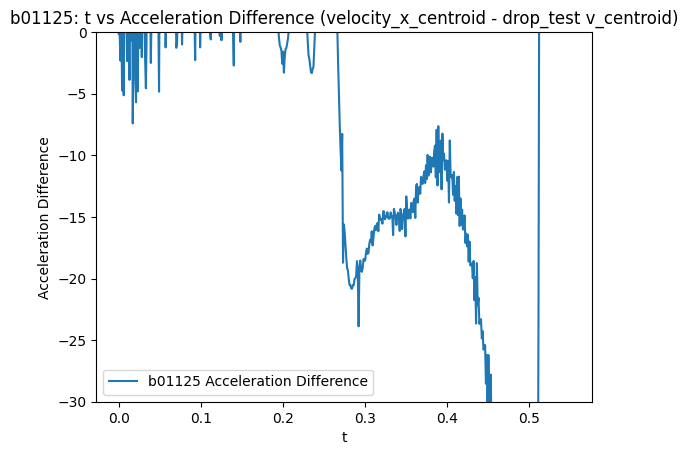

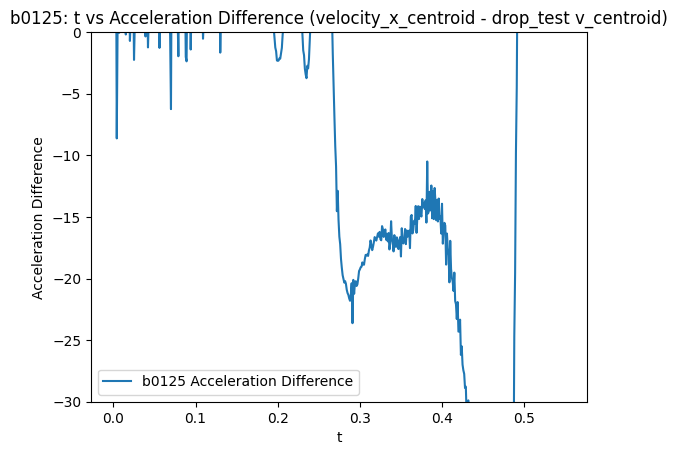

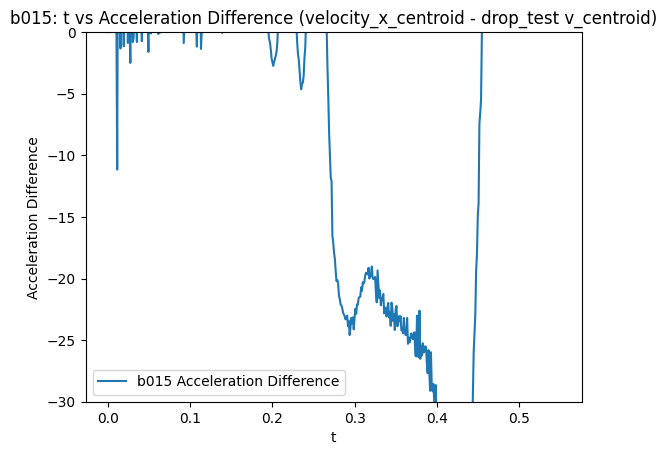

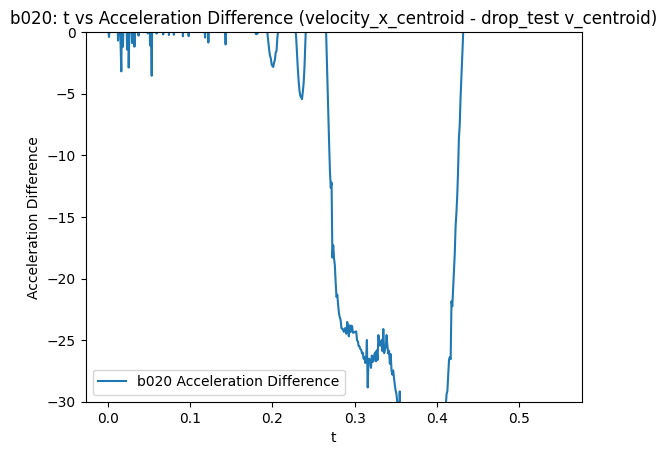

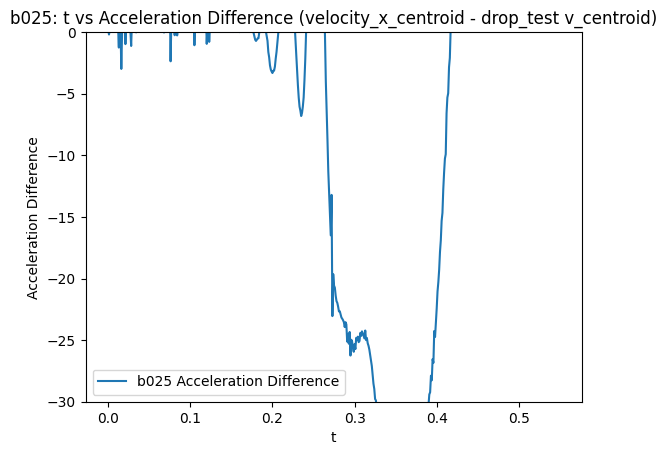

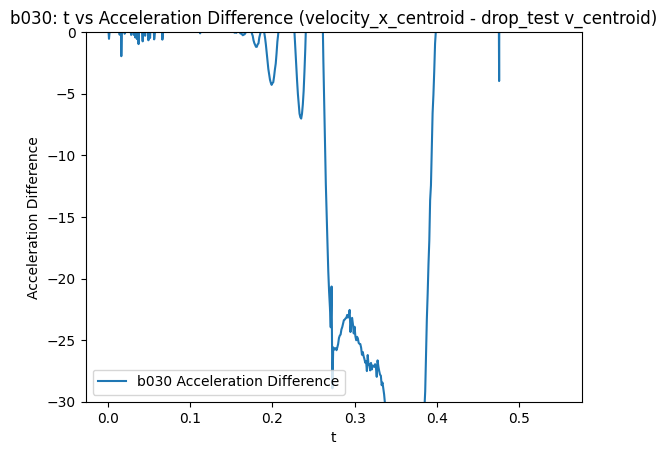

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

# Assuming drop_test is already loaded and available
# If not, you might need to load it here:
# drop_test = load_filtered('/content/drive/MyDrive/13, nobubble/log_cont')

dt = 0.001 # Assuming a constant time step

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    # Ensure both datasets cover a similar time range for meaningful comparison
    # Find the overlapping time range
    min_time = max(data[0, 0], drop_test[0, 0])
    max_time = min(data[-1, 0], drop_test[-1, 0])

    # Filter data within the overlapping time range
    filtered_data = data[(data[:, 0] >= min_time) & (data[:, 0] <= max_time)]
    filtered_drop_test = drop_test[(drop_test[:, 0] >= min_time) & (drop_test[:, 0] <= max_time)]

    # Check if there is enough data to interpolate and calculate derivative
    if filtered_drop_test.shape[0] < 2 or filtered_data.shape[0] < 2:
        print(f"Not enough overlapping data for {name} and drop_test for comparison.")
        continue

    # Interpolate drop_test v_centroid onto the time points of the current dataset
    interp_v_centroid_drop_test = np.interp(filtered_data[:, 0], filtered_drop_test[:, 0], filtered_drop_test[:, 2])

    # Calculate the difference in velocity
    diff_velocity = filtered_data[:, 2] - interp_v_centroid_drop_test

    # Calculate the acceleration of the velocity difference
    # This is the derivative of the velocity difference with respect to time
    acceleration_diff = np.diff(diff_velocity) / dt

    # The time array for acceleration will be one element shorter
    time_acceleration_diff = filtered_data[:-1, 0]


    ax.plot(time_acceleration_diff, acceleration_diff, label=f'{name} Acceleration Difference')

    ax.set_xlabel('t')
    ax.set_ylabel('Acceleration Difference')
    ax.set_title(f'{name}: t vs Acceleration Difference (velocity_x_centroid - drop_test v_centroid)')
    ax.legend()

    # Set appropriate y-limits based on the calculated acceleration difference
    if acceleration_diff.size > 0:
        min_y = np.min(acceleration_diff)
        max_y = np.max(acceleration_diff)
        ax.set_ylim(-30, 0)

    plt.show()

# \delta h = 0.025

In [ ]:
b005 = load_filtered_data('/content/drive/MyDrive/deltah=0.025/deltahlog0.05')
b0075 = load_filtered_data('/content/drive/MyDrive/deltah=0.025/deltahlog0.075')
b00875 = load_filtered_data('/content/drive/MyDrive/deltah=0.025/deltahlog0.0875')
b010 = load_filtered_data('/content/drive/MyDrive/deltah=0.025/deltahlog0.10')
b0125 = load_filtered_data('/content/drive/MyDrive/deltah=0.025/deltahlog0.125')
b015 = load_filtered_data('/content/drive/MyDrive/deltah=0.025/deltahlog0.150')
b0175 = load_filtered_data('/content/drive/MyDrive/deltah=0.025/deltahlog0.175')
b020 = load_filtered_data('/content/drive/MyDrive/deltah=0.025/deltahlog0.20')
b0225 = load_filtered_data('/content/drive/MyDrive/deltah=0.025/deltahlog0.225')
b025 = load_filtered_data('/content/drive/MyDrive/deltah=0.025/deltahlog0.25')
b0275 = load_filtered_data('/content/drive/MyDrive/deltah=0.025/deltahlog0.275')
b030 = load_filtered_data('/content/drive/MyDrive/deltah=0.025/deltahlog0.30')

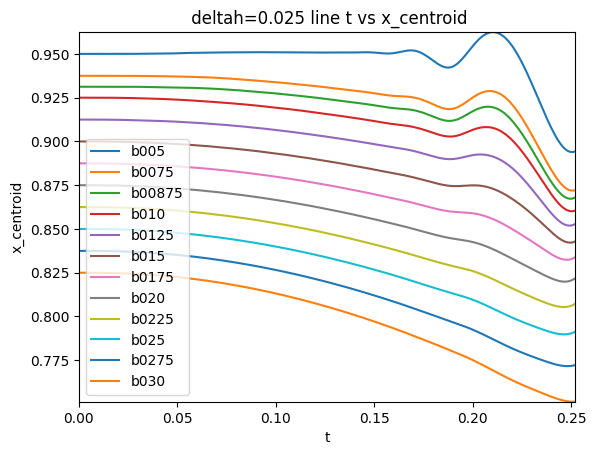

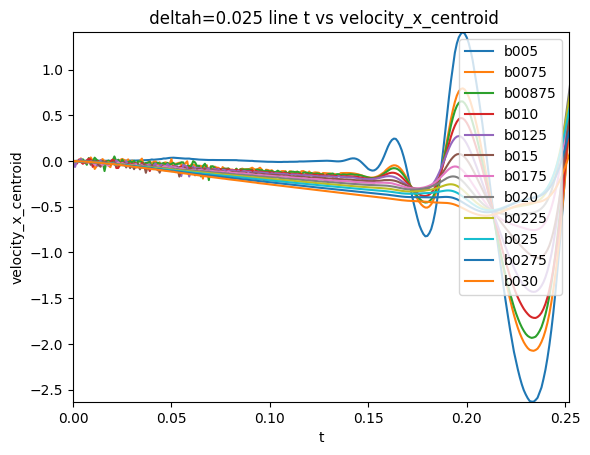

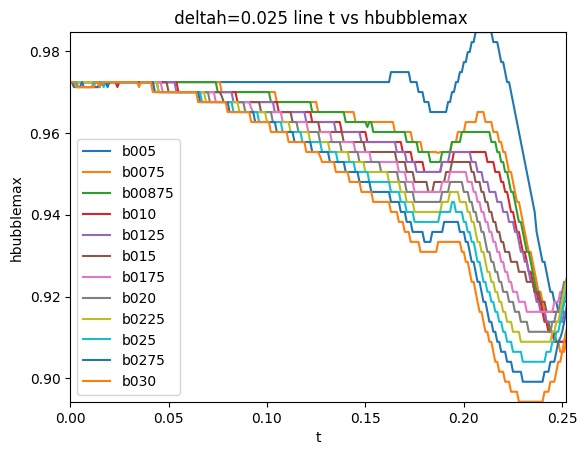

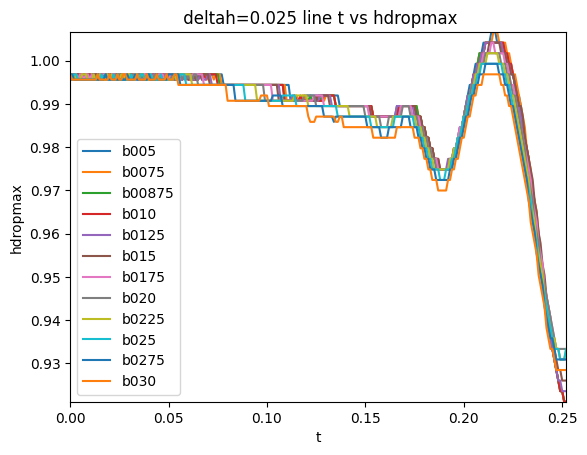

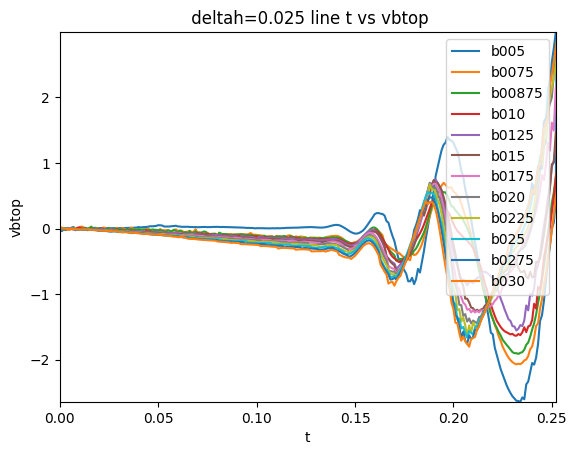

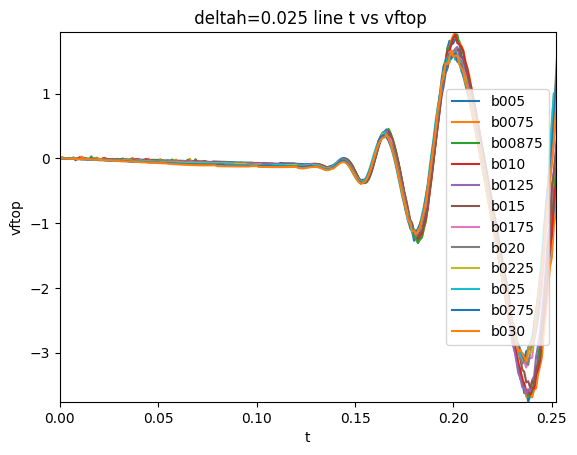

In [ ]:
column_names = ['x_centroid', 'velocity_x_centroid', 'hbubblemax', 'hdropmax', 'vbtop', 'vftop']

datasets = {
    'b005': b005,
    'b0075': b0075,
    'b00875': b00875,
    'b010': b010,
    'b0125': b0125,
    'b015': b015,
    'b0175': b0175,
    'b020': b020,
    'b0225': b0225,
    'b025': b025,
    'b0275': b0275,
    'b030': b030
}

for i in range(1, b005.shape[1]):
    fig, ax = plt.figure(), plt.axes()

    for name, data in datasets.items():
      # Subtract 7.0 from relevant columns before plotting
      if column_names[i-1] in ['x_centroid', 'hbubblemax', 'hdropmax']:
          ax.plot(data[:, 0], data[:, i] - 7.0, label=name)
      else:
          ax.plot(data[:, 0], data[:, i], label=name)

    xlim = 0.252

    ax.set_xlabel('t')
    ax.set_ylabel(column_names[i-1])
    ax.set_title(f' deltah=0.025 line t vs {column_names[i-1]}')
    ax.legend()
    ax.set_xlim(0, xlim)

    # Filter data within the x-axis range (0 to 0.56) for each dataset
    filtered_datasets = {}
    for name, data in datasets.items():
      filtered_datasets[name] = data[(data[:, 0] >= 0) & (data[:, 0] <= xlim)]

    # Collect data for y-limit calculation
    y_values = []
    for name, data in filtered_datasets.items():
      if column_names[i-1] in ['x_centroid', 'hbubblemax', 'hdropmax']:
          y_values.append(data[:, i] - 7.0)
      else:
          y_values.append(data[:, i])

    # Set y-limits based on the filtered and potentially modified data
    min_y = min(np.min(y) for y in y_values)
    max_y = max(np.max(y) for y in y_values)
    ax.set_ylim(min_y, max_y)

    plt.show()

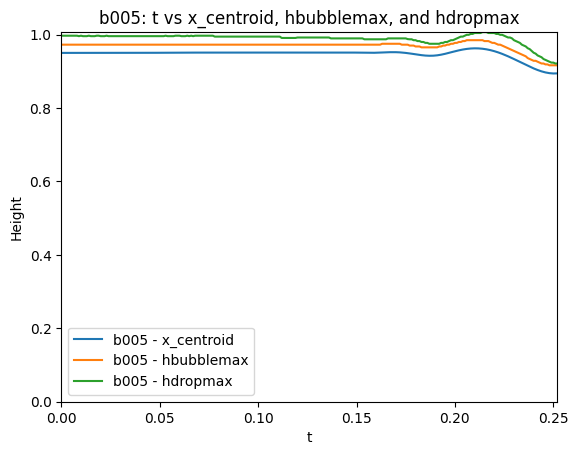

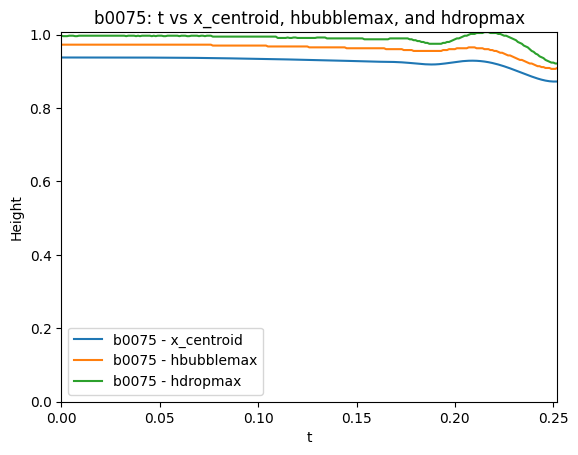

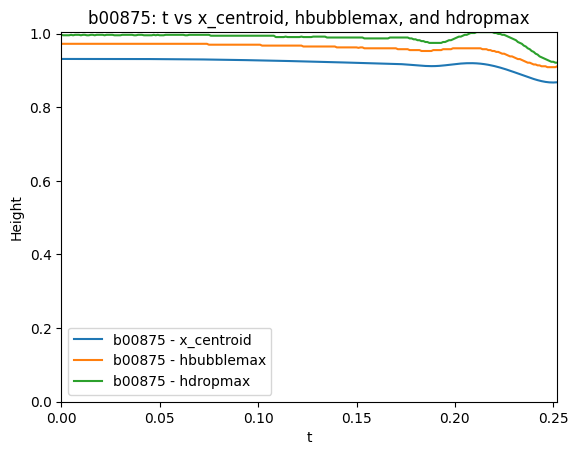

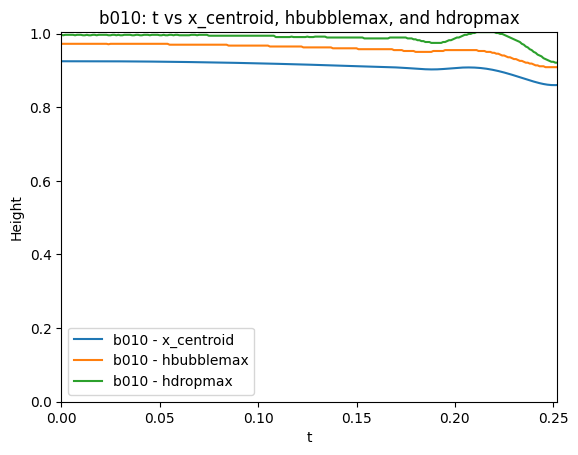

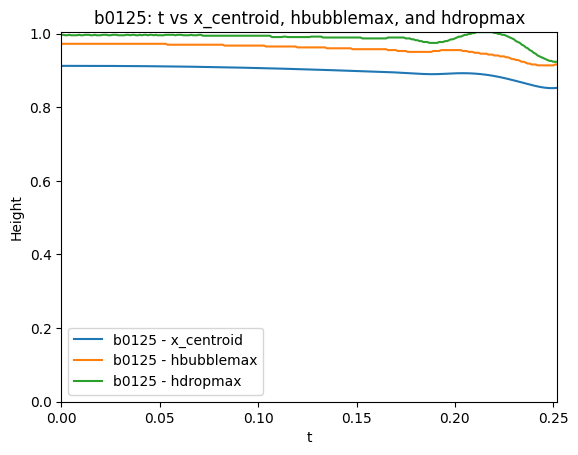

...

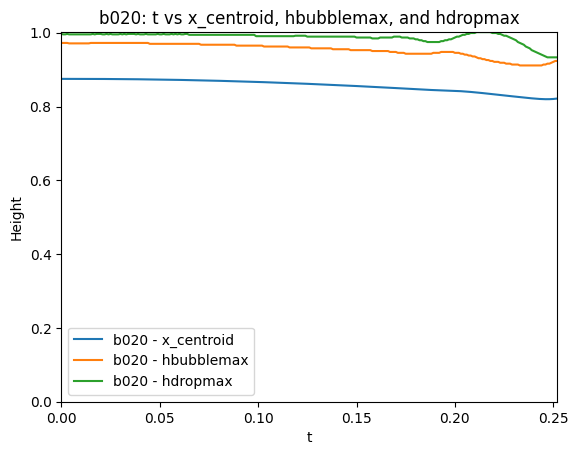

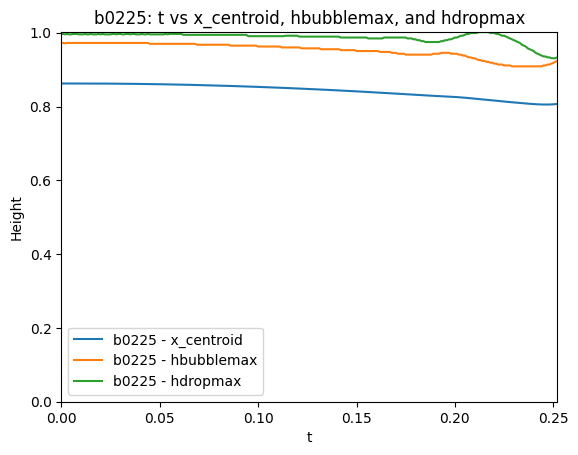

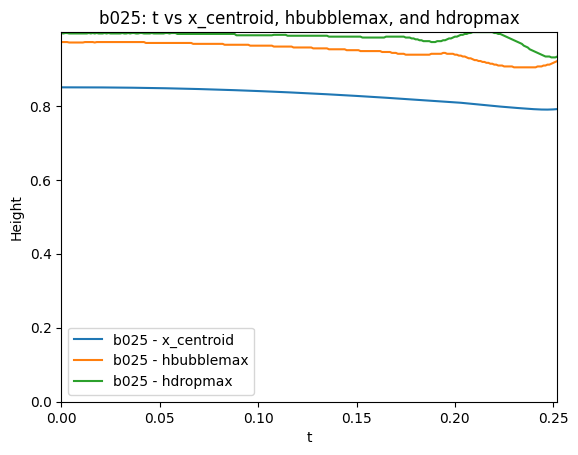

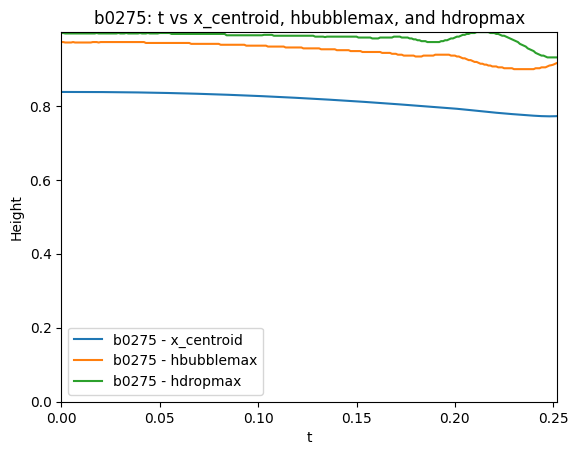

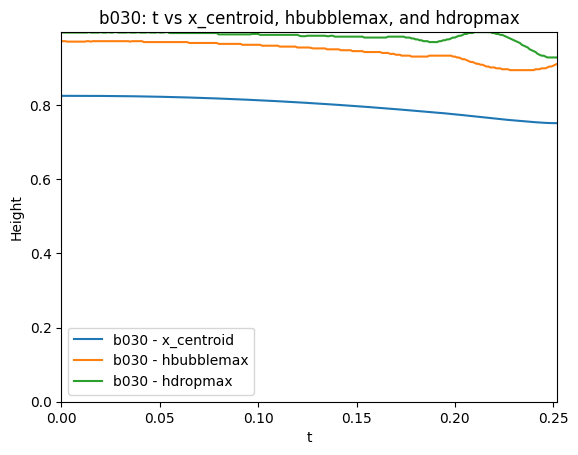

In [ ]:

datasets = {
    'b005': b005,
    'b0075': b0075,
    'b00875': b00875,
    'b010': b010,
    'b0125': b0125,
    'b015': b015,
    'b0175': b0175,
    'b020': b020,
    'b0225': b0225,
    'b025': b025,
    'b0275': b0275,
    'b030': b030
}

column_indices_to_plot = [1, 3, 4] # Columns 1 (x_centroid), 3 (hbubblemax), and 4 (hdropmax)
column_names_to_plot = ['x_centroid', 'hbubblemax', 'hdropmax']

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    xlim_min, xlim_max = 0, 0.252

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]

    for i, col_index in enumerate(column_indices_to_plot):
        ax.plot(filtered_data[:, 0], filtered_data[:, col_index]-7.0, label=f'{name} - {column_names_to_plot[i]}')

    ax.set_xlabel('t')
    ax.set_ylabel('Height')
    ax.set_title(f'{name}: t vs x_centroid, hbubblemax, and hdropmax')
    ax.legend()
    ax.set_xlim(xlim_min, xlim_max)

    # Set appropriate y-limits based on the filtered data in the selected columns
    min_y = np.min(filtered_data[:, column_indices_to_plot])
    max_y = np.max(filtered_data[:, column_indices_to_plot]-7.0)
    ax.set_ylim(0.0, max_y)

    plt.show()

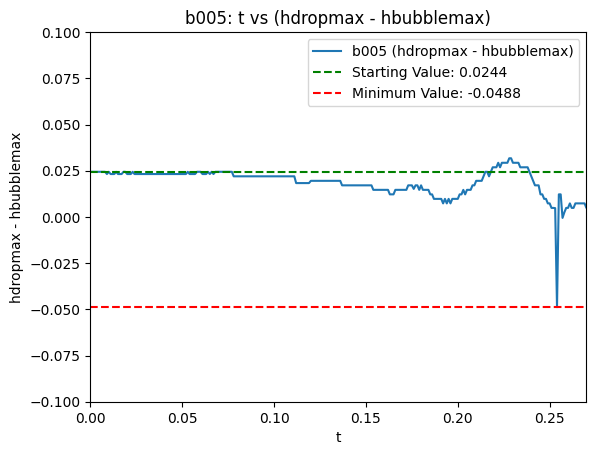

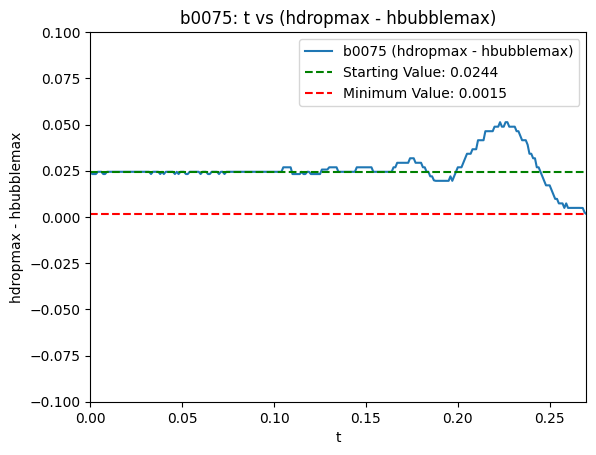

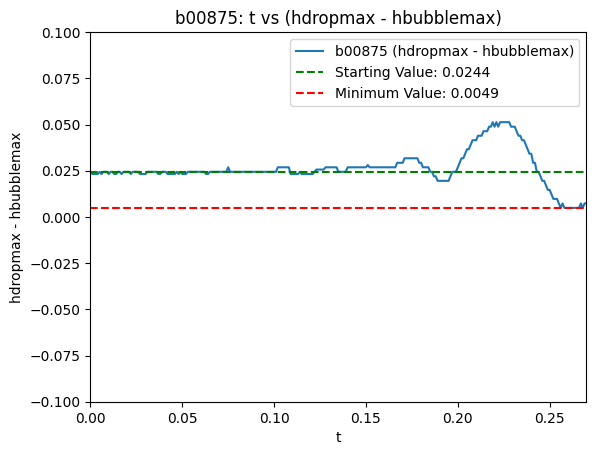

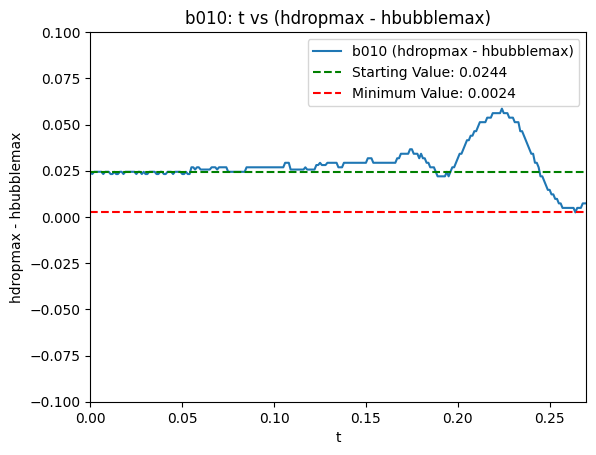

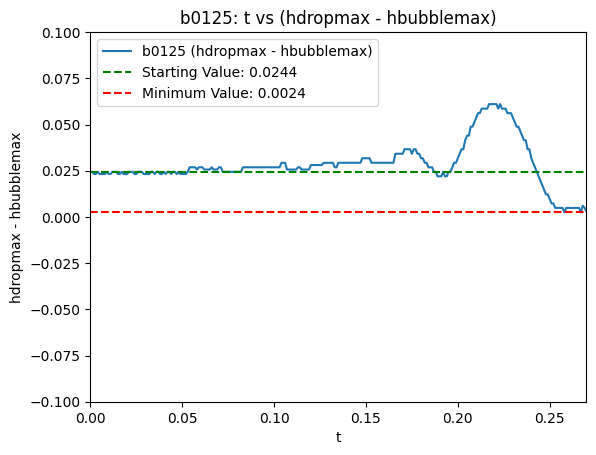

...

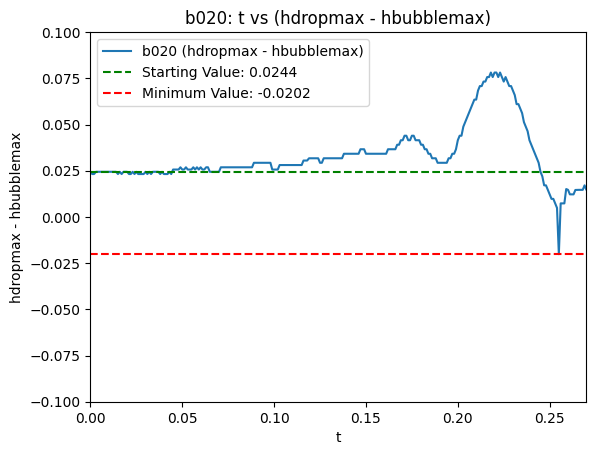

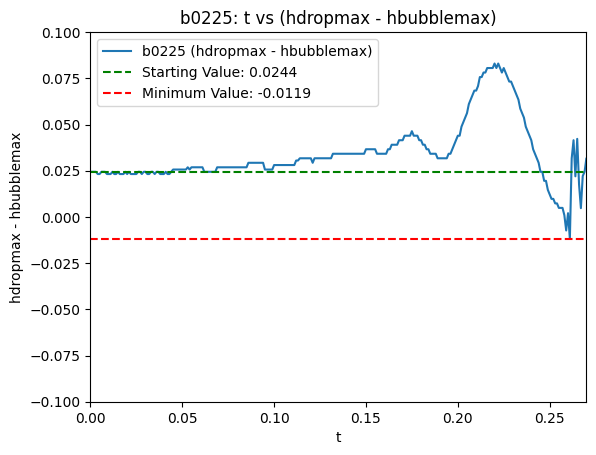

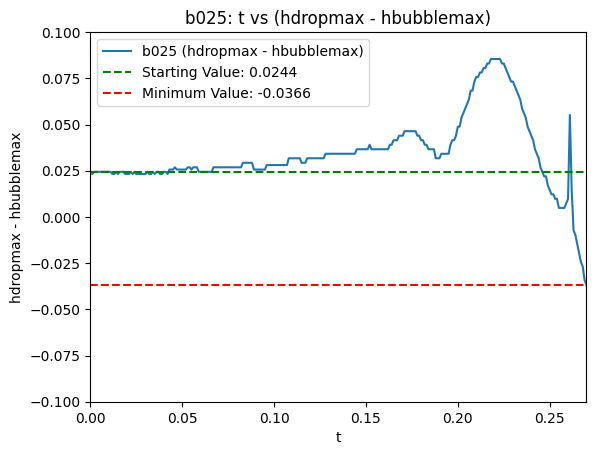

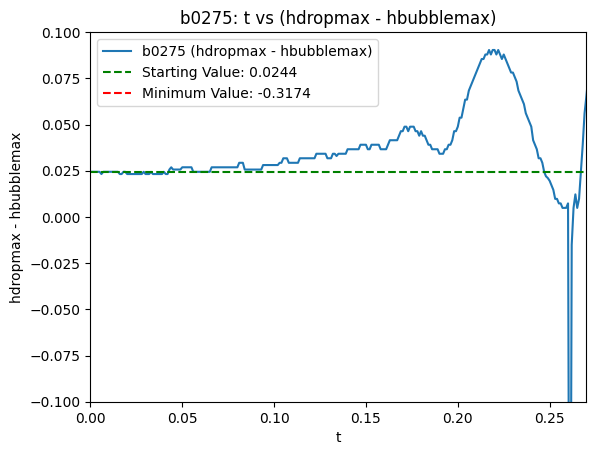

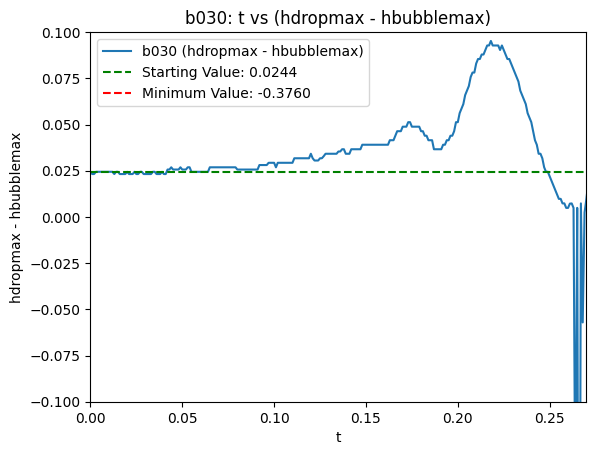

In [ ]:
datasets = {
    'b005': b005,
    'b0075': b0075,
    'b00875': b00875,
    'b010': b010,
    'b0125': b0125,
    'b015': b015,
    'b0175': b0175,
    'b020': b020,
    'b0225': b0225,
    'b025': b025,
    'b0275': b0275,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()
    # Calculate the difference between column 4 (hdropmax) and column 3 (hbubblemax)
    diff_h = data[:, 4] - data[:, 3]
    ax.plot(data[:, 0], diff_h, label=f'{name} (hdropmax - hbubblemax)')

    ax.set_xlabel('t')
    ax.set_ylabel('hdropmax - hbubblemax')
    ax.set_title(f'{name}: t vs (hdropmax - hbubblemax)')
    ax.legend()

    xlim_min, xlim_max = 0, 0.27

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    filtered_diff_h = filtered_data[:, 4] - filtered_data[:, 3]

    # Find the starting value (at the minimum x within the range)
    starting_x_index = np.argmin(abs(filtered_data[:, 0] - xlim_min))
    starting_value = filtered_diff_h[starting_x_index]


    # Find the minimum value within the x-axis range
    min_value = np.min(filtered_diff_h)

    # Add horizontal lines for starting and minimum values
    ax.axhline(y=starting_value, color='g', linestyle='--', label=f'Starting Value: {starting_value:.4f}')
    ax.axhline(y=min_value, color='r', linestyle='--', label=f'Minimum Value: {min_value:.4f}')
    ax.legend()

    ax.set_ylim(-0.1, 0.1)

    plt.show()

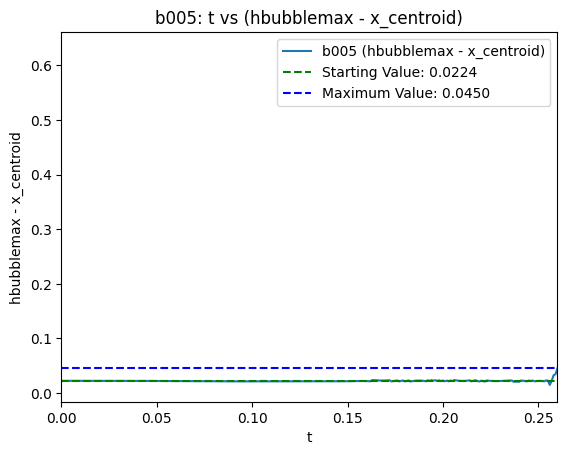

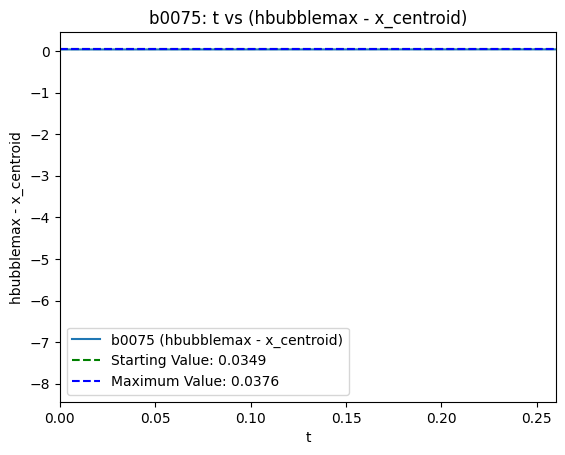

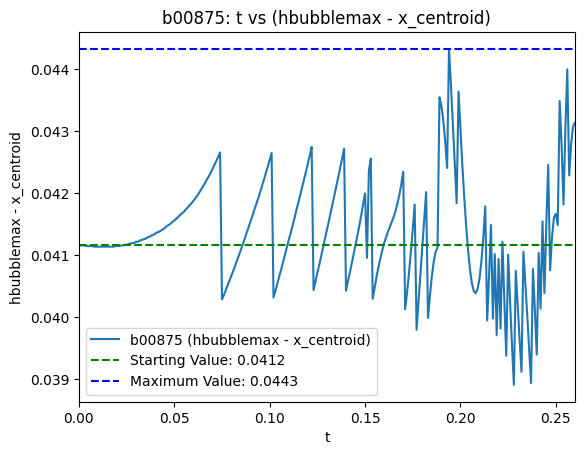

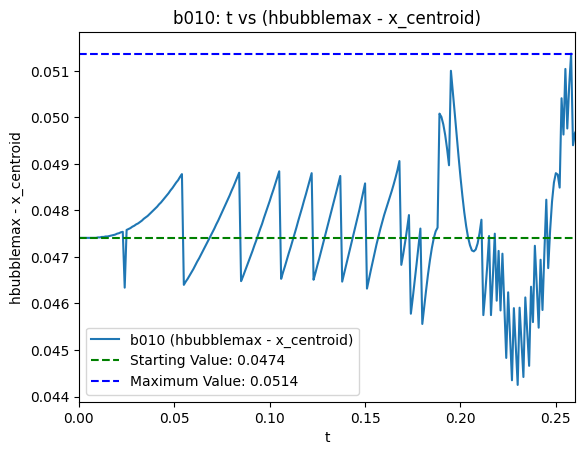

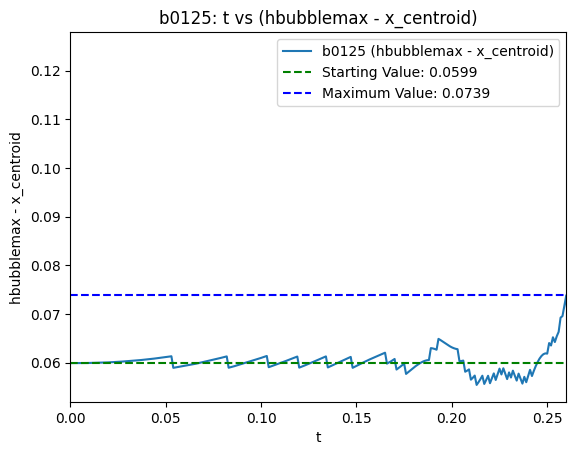

...

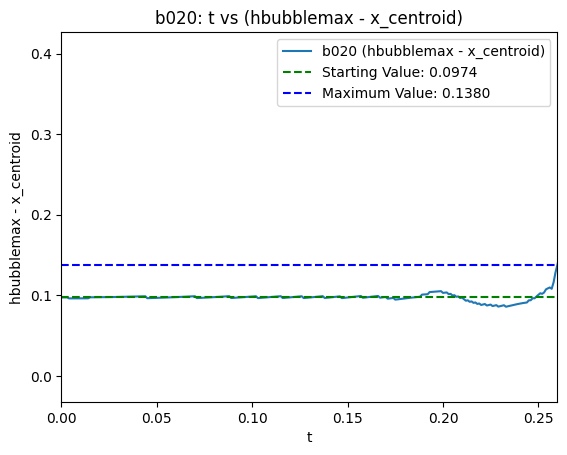

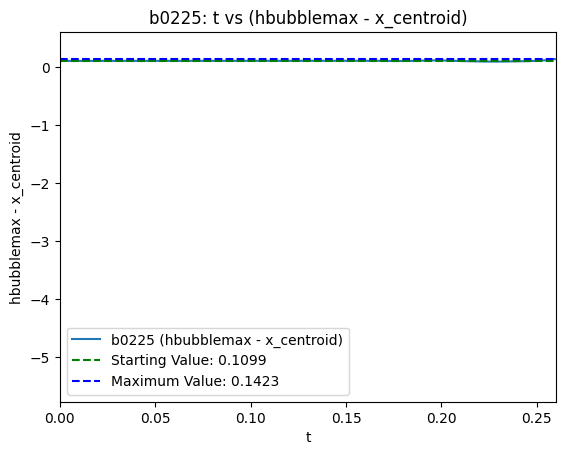

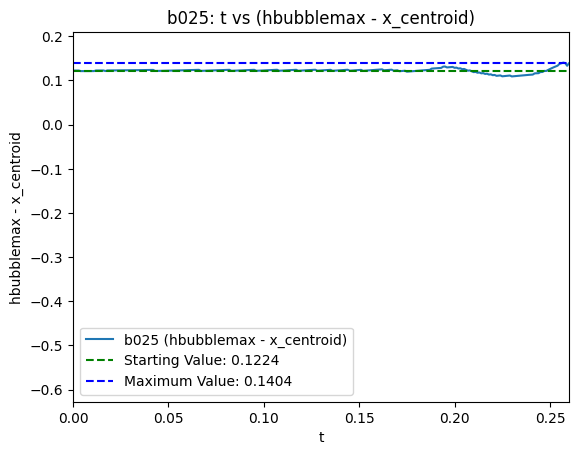

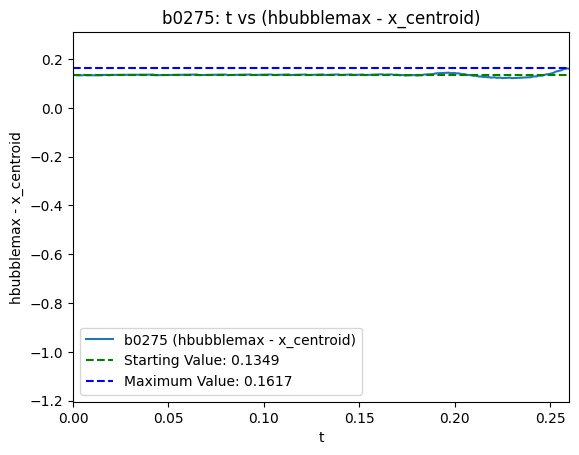

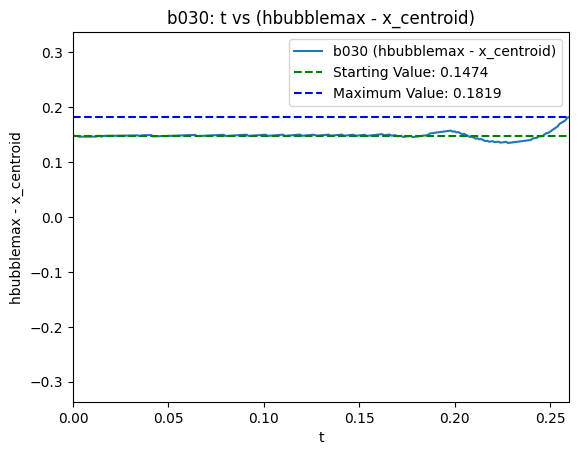

In [ ]:
datasets = {
    'b005': b005,
    'b0075': b0075,
    'b00875': b00875,
    'b010': b010,
    'b0125': b0125,
    'b015': b015,
    'b0175': b0175,
    'b020': b020,
    'b0225': b0225,
    'b025': b025,
    'b0275': b0275,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()
    # Calculate the difference between column 3 (hbubblemax) and column 1 (x_centroid)
    diff_h_x = data[:, 3] - data[:, 1]
    ax.plot(data[:, 0], diff_h_x, label=f'{name} (hbubblemax - x_centroid)')

    ax.set_xlabel('t')
    ax.set_ylabel('hbubblemax - x_centroid')
    ax.set_title(f'{name}: t vs (hbubblemax - x_centroid)')
    ax.legend()

    xlim_min, xlim_max = 0, 0.26

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    filtered_diff_h_x = filtered_data[:, 3] - filtered_data[:, 1]


    # Find the starting value (at the minimum x within the range)
    starting_x_index = np.argmin(abs(filtered_data[:, 0] - xlim_min))
    starting_value = filtered_diff_h_x[starting_x_index]


    # Find the maximum value within the x-axis range
    max_value = np.max(filtered_diff_h_x)

    # Add horizontal lines for starting and maximum values
    ax.axhline(y=starting_value, color='g', linestyle='--', label=f'Starting Value: {starting_value:.4f}')
    ax.axhline(y=max_value, color='b', linestyle='--', label=f'Maximum Value: {max_value:.4f}')
    ax.legend()

    plt.show()

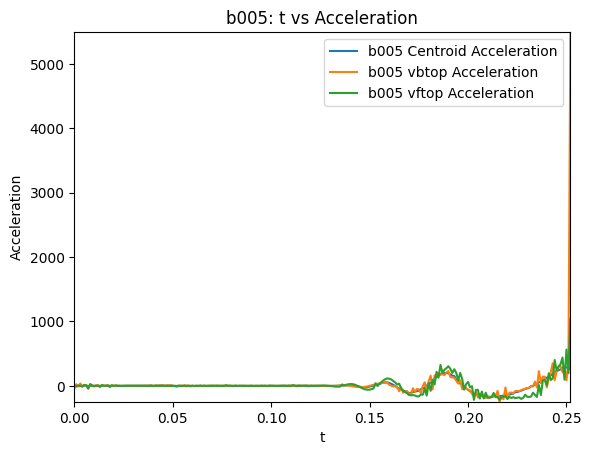

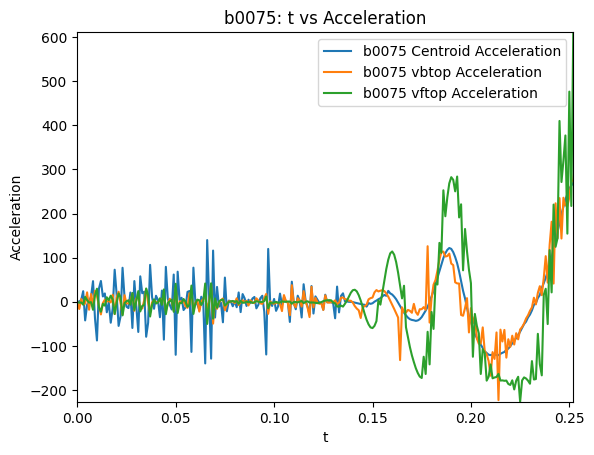

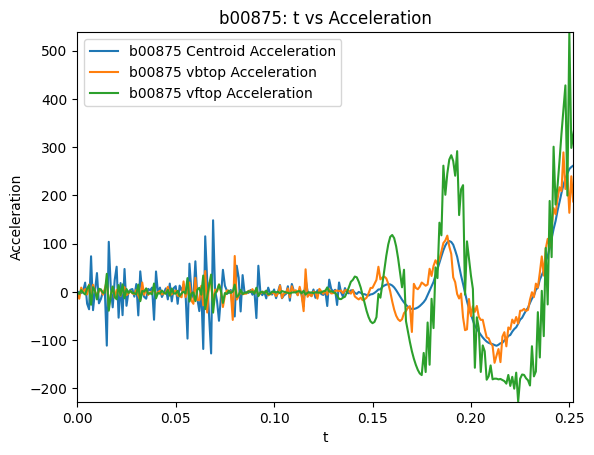

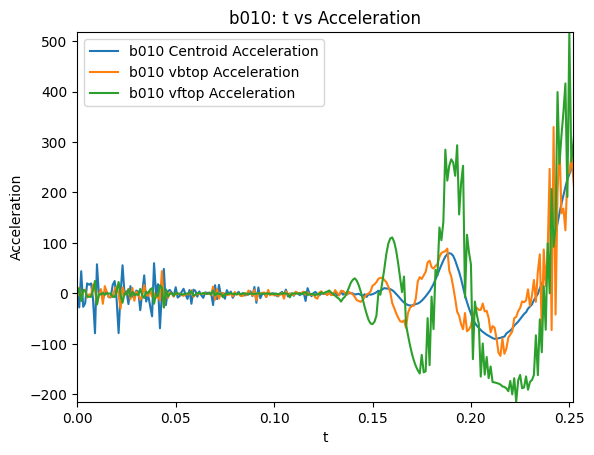

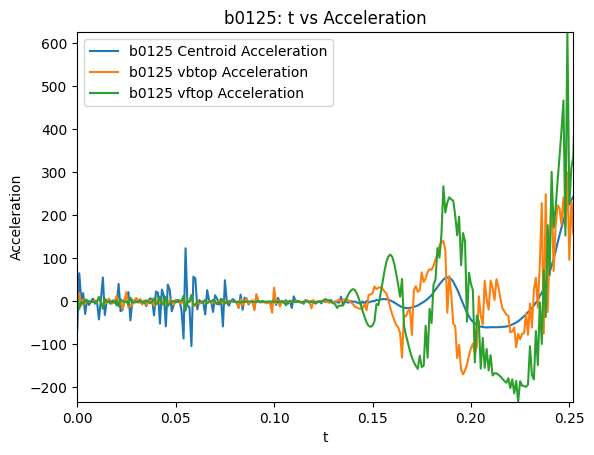

...

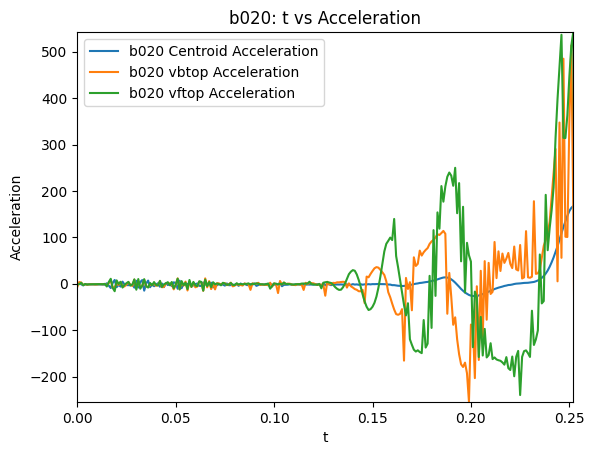

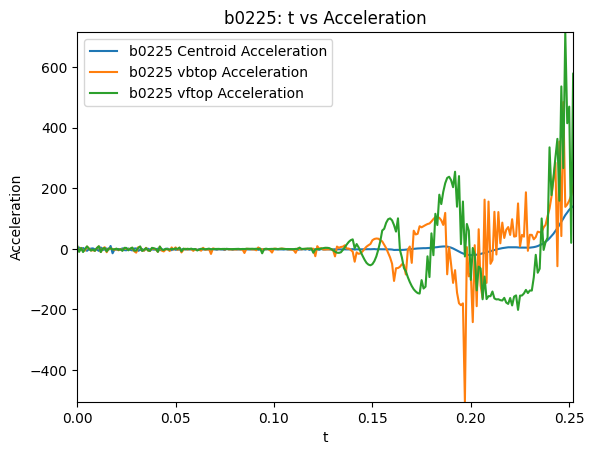

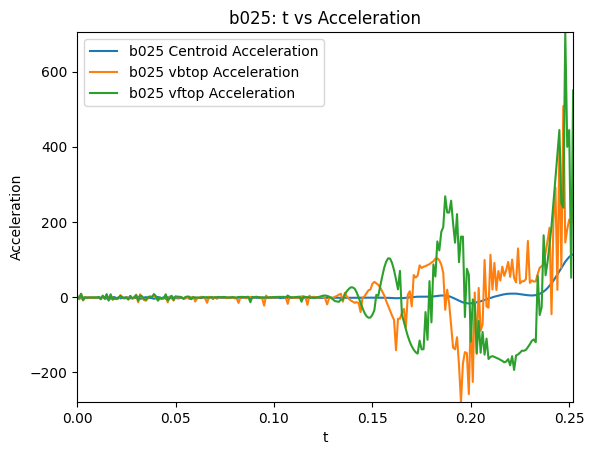

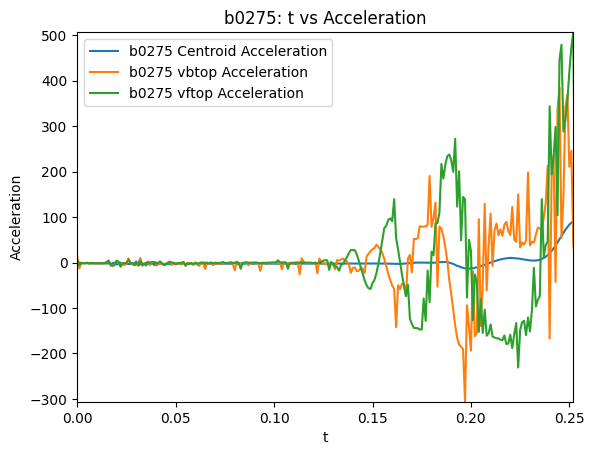

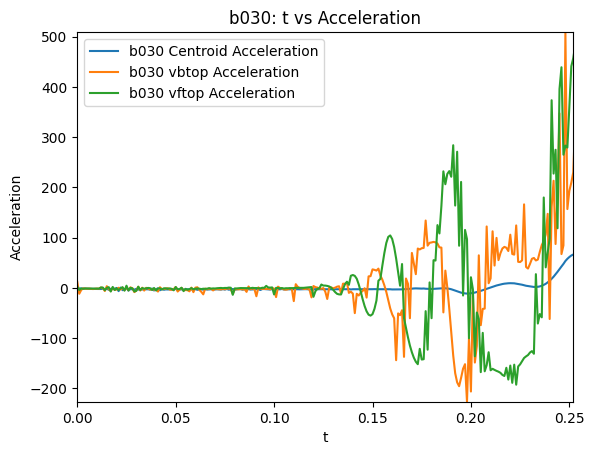

In [ ]:
datasets = {
    'b005': b005,
    'b0075': b0075,
    'b00875': b00875,
    'b010': b010,
    'b0125': b0125,
    'b015': b015,
    'b0175': b0175,
    'b020': b020,
    'b0225': b0225,
    'b025': b025,
    'b0275': b0275,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()
    # Calculate acceleration (difference of column 2 divided by time step 0.001)
    acceleration_centroid = np.diff(data[:, 2]) / 0.001
    # Calculate acceleration for vbtop (column 5)
    acceleration_vbtop = np.diff(data[:, 5]) / 0.001
    # Calculate acceleration for vftop (column 6)
    acceleration_vftop = np.diff(data[:, 6]) / 0.001

    # The time array for acceleration will be one element shorter
    time_accel = data[:-1, 0]

    ax.plot(time_accel, acceleration_centroid, label=f'{name} Centroid Acceleration')
    ax.plot(time_accel, acceleration_vbtop, label=f'{name} vbtop Acceleration')
    ax.plot(time_accel, acceleration_vftop, label=f'{name} vftop Acceleration')


    ax.set_xlabel('t')
    ax.set_ylabel('Acceleration')
    ax.set_title(f'{name}: t vs Acceleration')
    ax.legend()

    xlim_min, xlim_max = 0, 0.252

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_acceleration_centroid = acceleration_centroid[(time_accel >= xlim_min) & (time_accel <= xlim_max)]
    filtered_acceleration_vbtop = acceleration_vbtop[(time_accel >= xlim_min) & (time_accel <= xlim_max)]
    filtered_acceleration_vftop = acceleration_vftop[(time_accel >= xlim_min) & (time_accel <= xlim_max)]


    # Set appropriate y-limits based on the filtered acceleration data
    min_y = min(np.min(filtered_acceleration_centroid), np.min(filtered_acceleration_vbtop), np.min(filtered_acceleration_vftop))
    max_y = max(np.max(filtered_acceleration_centroid), np.max(filtered_acceleration_vbtop), np.max(filtered_acceleration_vftop))
    ax.set_ylim(min_y, max_y)


    plt.show()

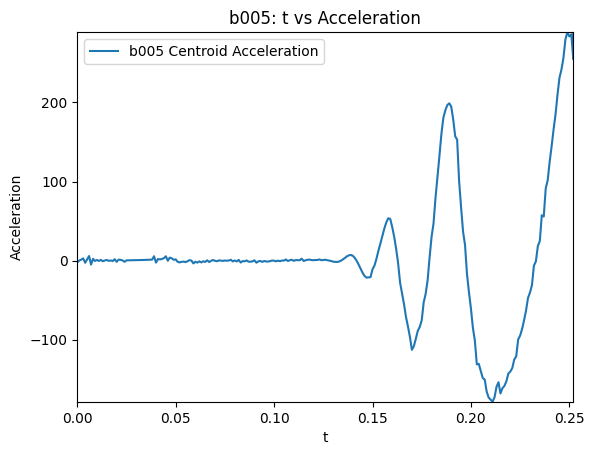

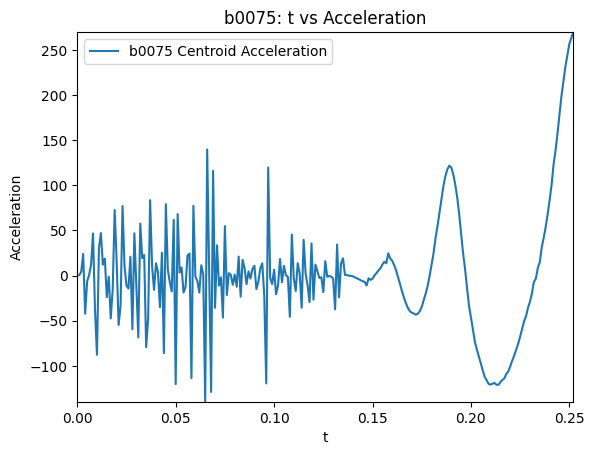

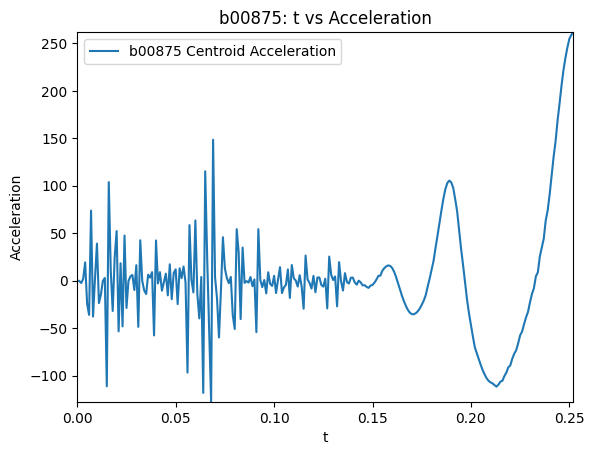

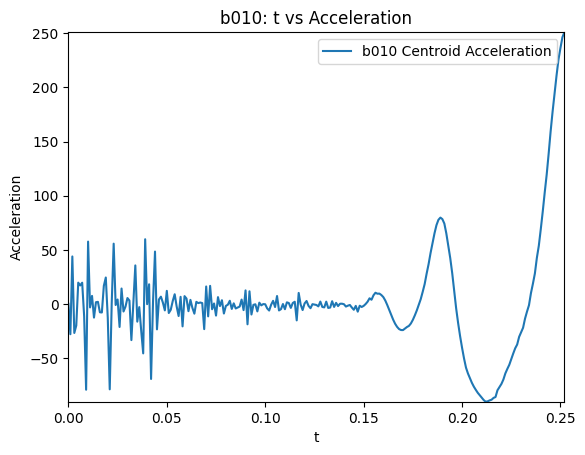

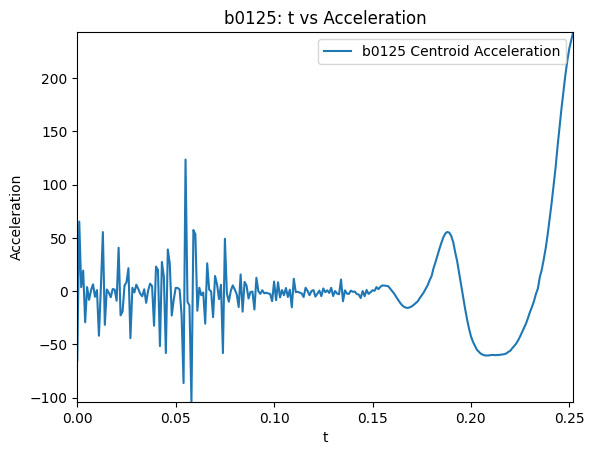

...

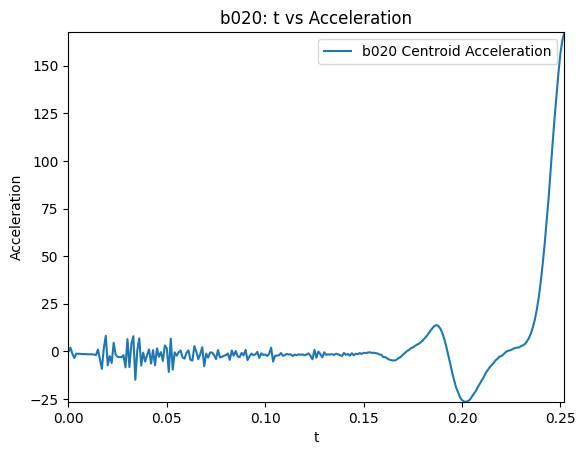

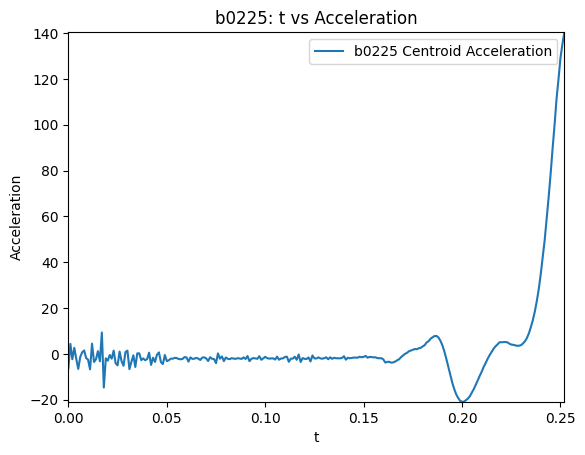

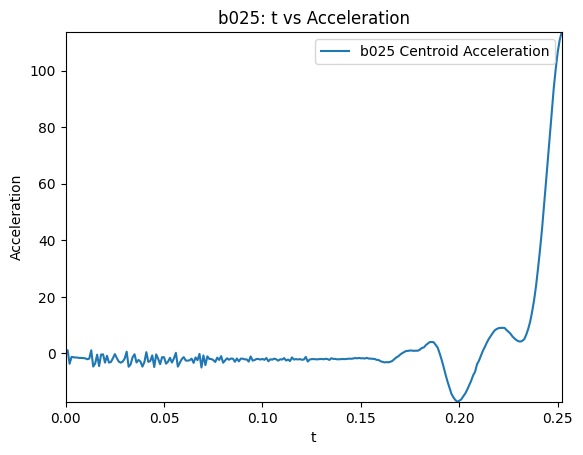

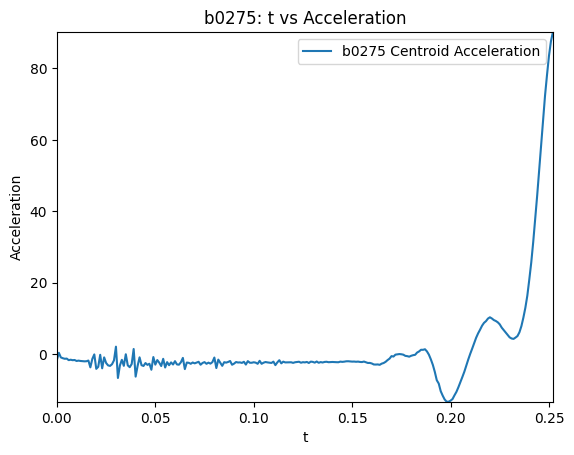

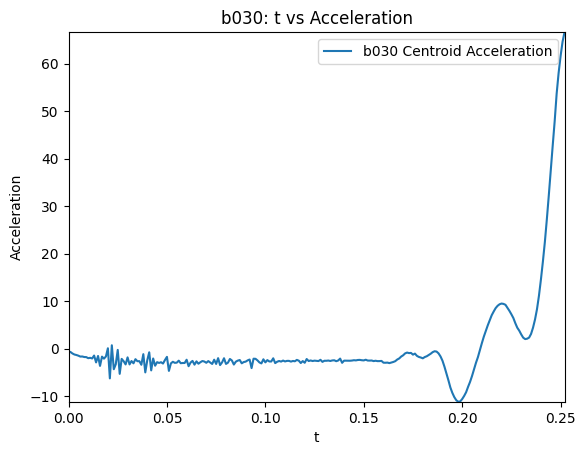

In [ ]:
datasets = {
    'b005': b005,
    'b0075': b0075,
    'b00875': b00875,
    'b010': b010,
    'b0125': b0125,
    'b015': b015,
    'b0175': b0175,
    'b020': b020,
    'b0225': b0225,
    'b025': b025,
    'b0275': b0275,
    'b030': b030
}

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()
    # Calculate acceleration (difference of column 2 divided by time step 0.001)
    acceleration_centroid = np.diff(data[:, 2]) / 0.001
    # Calculate acceleration for vbtop (column 5)
    acceleration_vbtop = np.diff(data[:, 5]) / 0.001
    # Calculate acceleration for vftop (column 6)
    acceleration_vftop = np.diff(data[:, 6]) / 0.001

    # The time array for acceleration will be one element shorter
    time_accel = data[:-1, 0]

    ax.plot(time_accel, acceleration_centroid, label=f'{name} Centroid Acceleration')
    #ax.plot(time_accel, acceleration_vbtop, label=f'{name} vbtop Acceleration')
    #ax.plot(time_accel, acceleration_vftop, label=f'{name} vftop Acceleration')


    ax.set_xlabel('t')
    ax.set_ylabel('Acceleration')
    ax.set_title(f'{name}: t vs Acceleration')
    ax.legend()

    xlim_min, xlim_max = 0, 0.252

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_acceleration_centroid = acceleration_centroid[(time_accel >= xlim_min) & (time_accel <= xlim_max)]
    filtered_acceleration_vbtop = acceleration_vbtop[(time_accel >= xlim_min) & (time_accel <= xlim_max)]
    filtered_acceleration_vftop = acceleration_vftop[(time_accel >= xlim_min) & (time_accel <= xlim_max)]


    # Set appropriate y-limits based on the filtered acceleration data
    min_y = np.min(filtered_acceleration_centroid)
    max_y = np.max(filtered_acceleration_centroid)
    ax.set_ylim(min_y, max_y)


    plt.show()

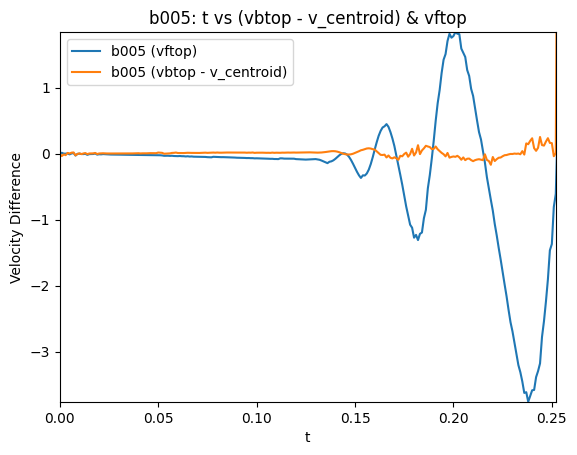

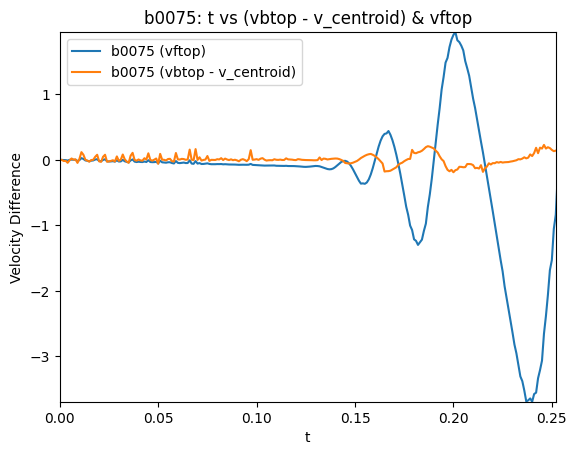

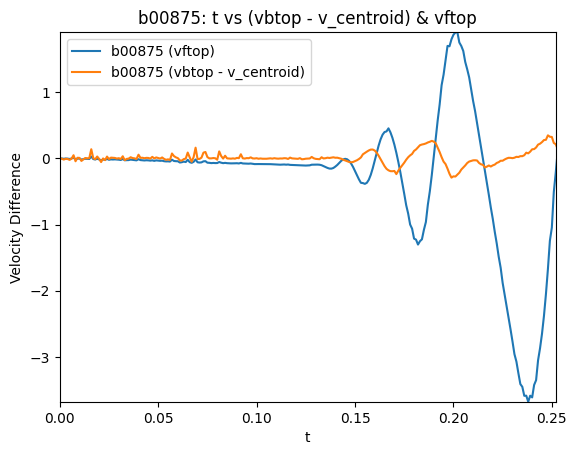

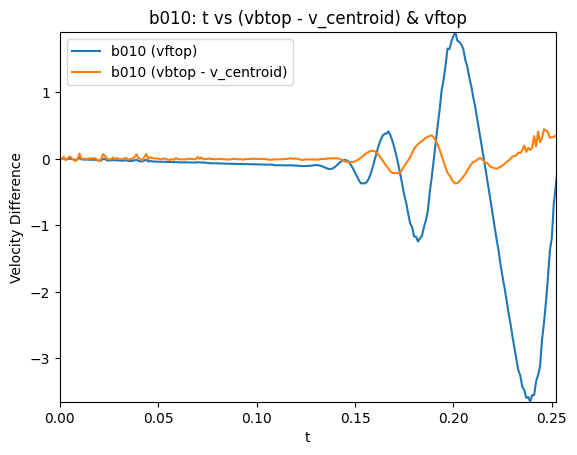

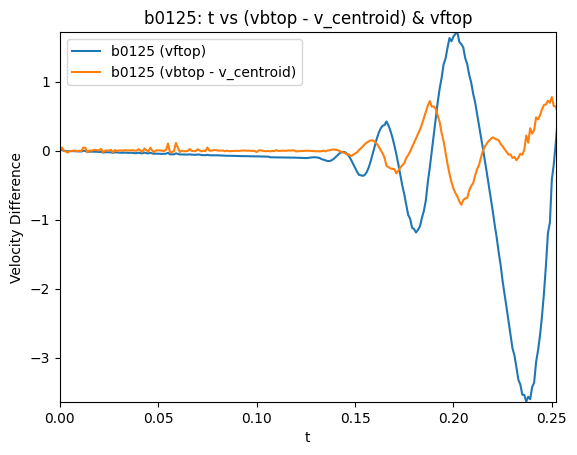

...

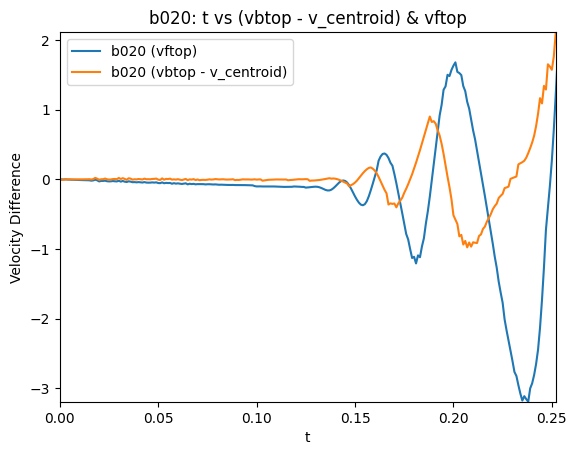

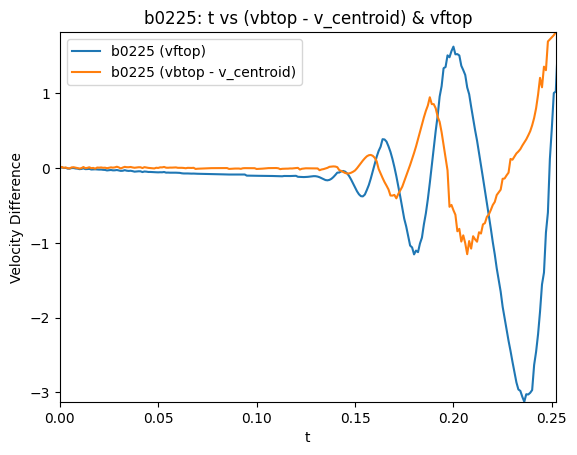

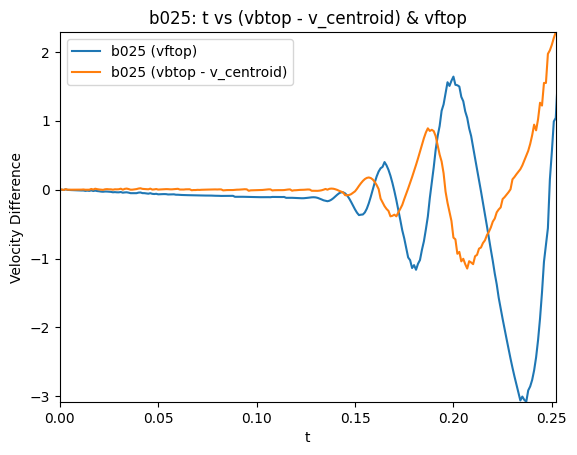

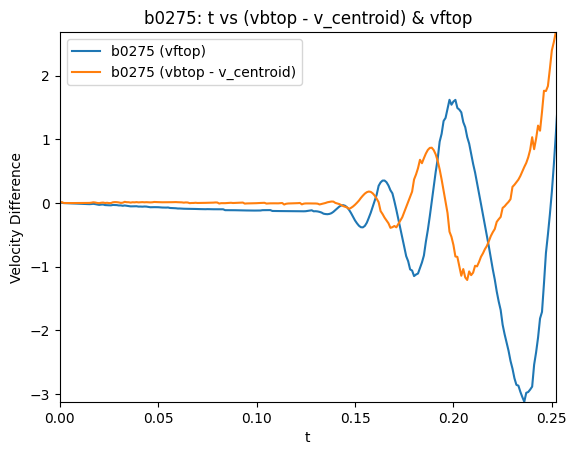

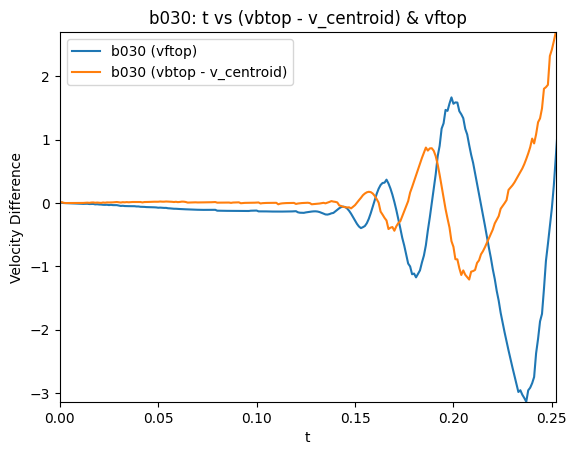

In [ ]:
datasets = {
    'b005': b005,
    'b0075': b0075,
    'b00875': b00875,
    'b010': b010,
    'b0125': b0125,
    'b015': b015,
    'b0175': b0175,
    'b020': b020,
    'b0225': b0225,
    'b025': b025,
    'b0275': b0275,
    'b030': b030
}
for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    # Calculate the difference between column 5 (vbtop) and column 2 (velocity_x_centroid)
    diff_velocity = data[:, 5] - data[:, 2]
    top_velocity = data[:, 6]
    ax.plot(data[:, 0], top_velocity, label=f'{name} (vftop)')
    ax.plot(data[:, 0], diff_velocity, label=f'{name} (vbtop - v_centroid)')

    ax.set_xlabel('t')
    ax.set_ylabel('Velocity Difference')
    ax.set_title(f'{name}: t vs (vbtop - v_centroid) & vftop')
    ax.legend()

    xlim_min, xlim_max = 0, 0.252

    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    filtered_diff_velocity = filtered_data[:, 5] - filtered_data[:, 2]
    filtered_top_velocity = filtered_data[:, 6]

    # Set appropriate y-limits based on the filtered velocity difference data
    min_y = min(np.min(filtered_diff_velocity),np.min(filtered_top_velocity))
    max_y = max(np.max(filtered_diff_velocity),np.max(filtered_top_velocity))
    ax.set_ylim(min_y, max_y)

    plt.show()

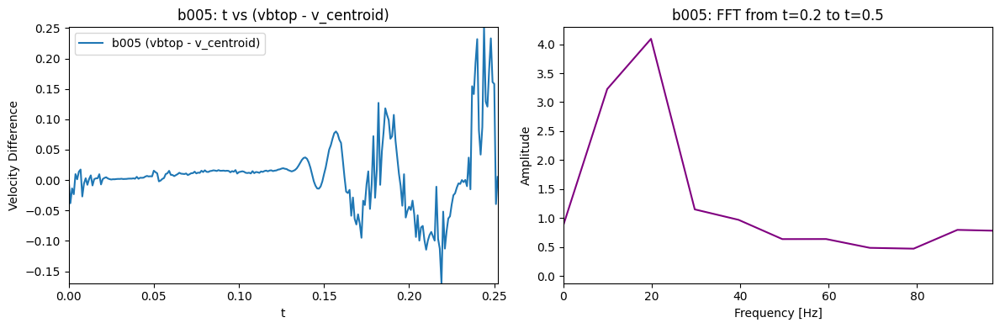

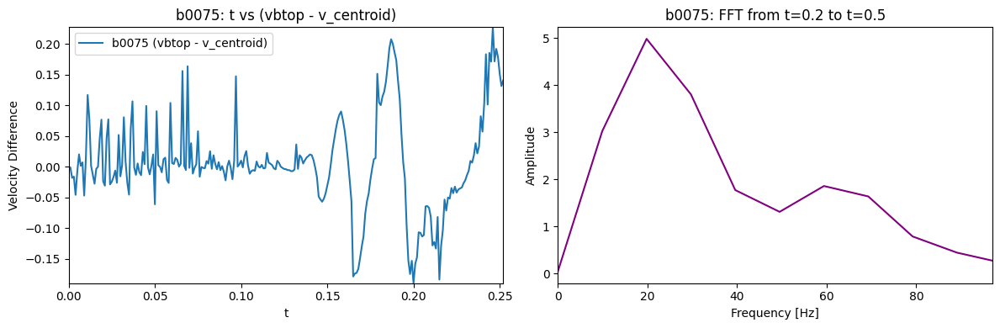

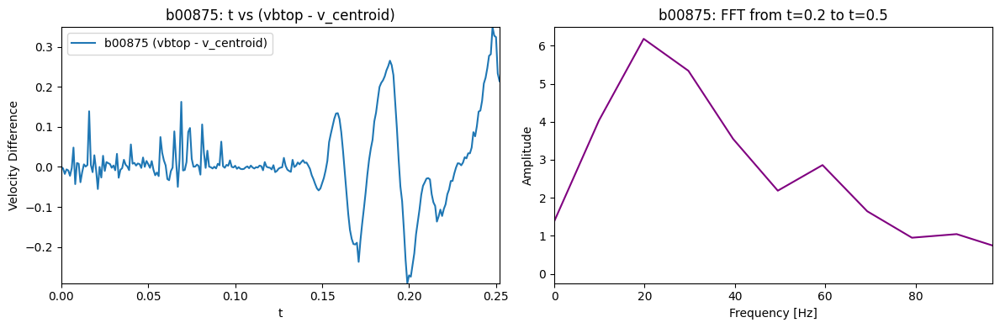

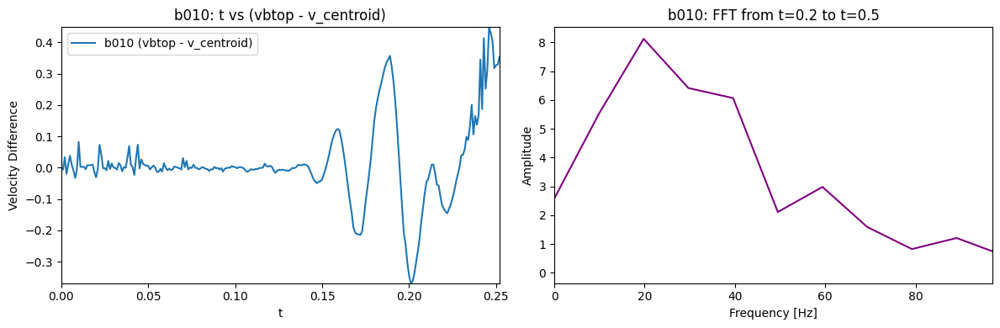

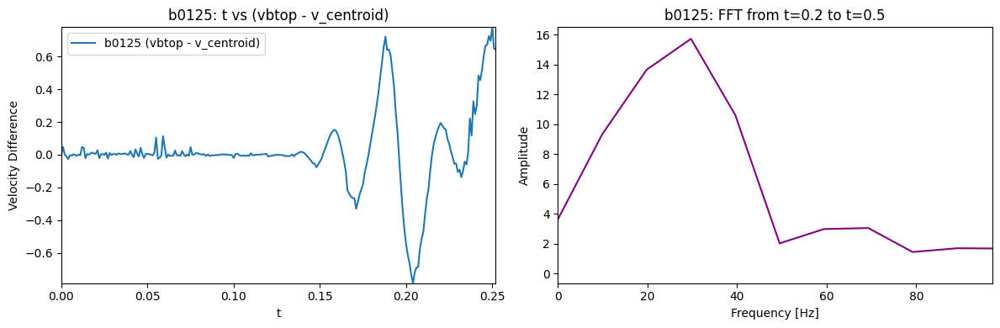

...

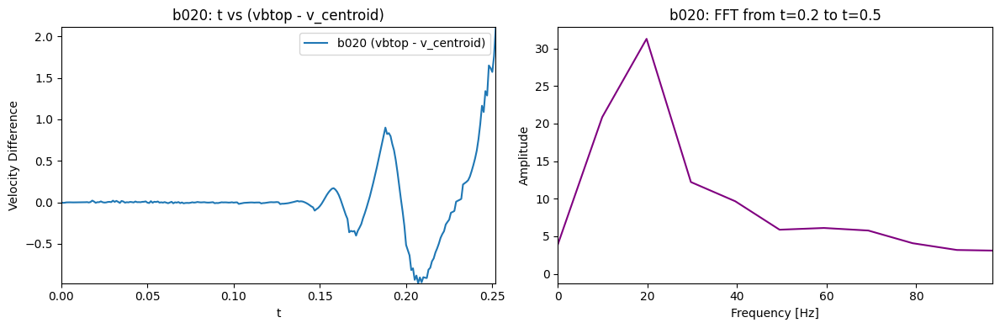

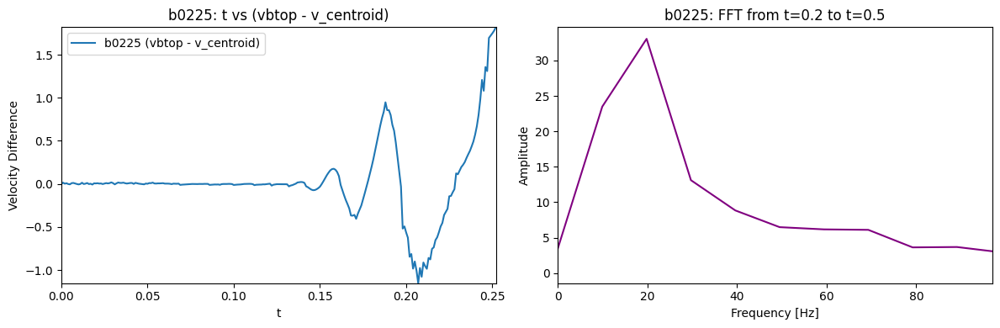

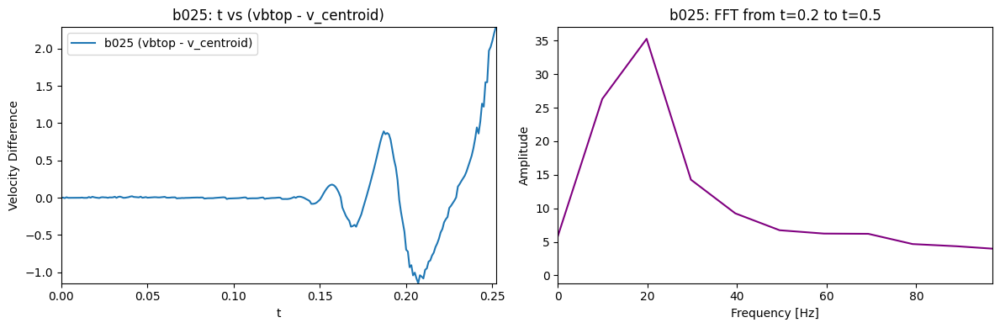

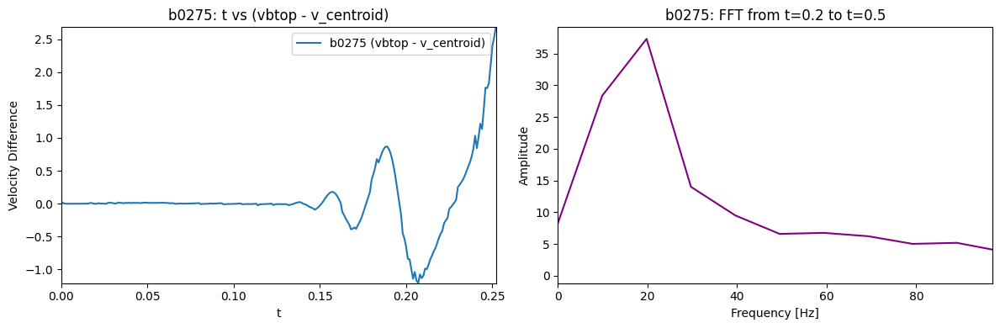

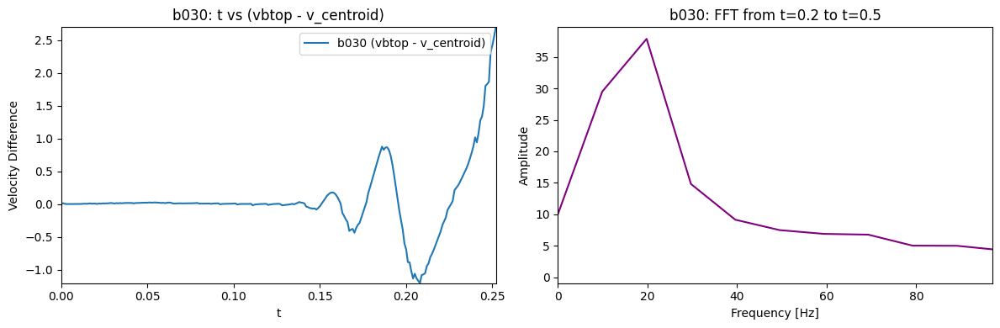

In [ ]:
datasets = {
    'b005': b005,
    'b0075': b0075,
    'b00875': b00875,
    'b010': b010,
    'b0125': b0125,
    'b015': b015,
    'b0175': b0175,
    'b020': b020,
    'b0225': b0225,
    'b025': b025,
    'b0275': b0275,
    'b030': b030
}

for name, data in datasets.items():
    # Time-domain data: Full plot range
    xlim_min, xlim_max = 0, 0.252
    plot_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    t_plot = plot_data[:, 0]
    diff_velocity_plot = plot_data[:, 5] - plot_data[:, 2]

    # FFT range: 0.2 to 0.5 seconds
    fft_range_min, fft_range_max = 0.15, 0.25
    fft_data = data[(data[:, 0] >= fft_range_min) & (data[:, 0] <= fft_range_max)]
    t_fft = fft_data[:, 0]
    diff_velocity_fft = fft_data[:, 5] - fft_data[:, 2]

    # Compute FFT
    N = len(t_fft)
    if N < 2:
        print(f"Not enough data for FFT in {name}")
        continue

    dt = np.mean(np.diff(t_fft))
    fft_vals = np.fft.fft(diff_velocity_fft)
    fft_freqs = np.fft.fftfreq(N, d=dt)

    # Keep only positive frequencies
    pos_freqs = fft_freqs[:N // 2]
    pos_fft_vals = np.abs(fft_vals[:N // 2])

    # --- Plot time-domain and FFT ---
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    # Time-domain plot
    ax1.plot(t_plot, diff_velocity_plot, label=f'{name} (vbtop - v_centroid)')
    ax1.set_xlabel('t')
    ax1.set_ylabel('Velocity Difference')
    ax1.set_title(f'{name}: t vs (vbtop - v_centroid)')
    ax1.set_xlim(xlim_min, xlim_max)

    # Dynamic y-limits
    min_y = np.min(diff_velocity_plot)
    max_y = np.max(diff_velocity_plot)
    ax1.set_ylim(min_y, max_y)
    ax1.legend()

    # FFT plot
    ax2.plot(pos_freqs, pos_fft_vals, color='purple')
    ax2.set_xlabel('Frequency [Hz]')
    ax2.set_ylabel('Amplitude')
    ax2.set_title(f'{name}: FFT from t=0.2 to t=0.5')
    ax2.set_xlim(0, np.max(pos_freqs)/5)  # You can limit this if desired

    plt.tight_layout()
    plt.show()

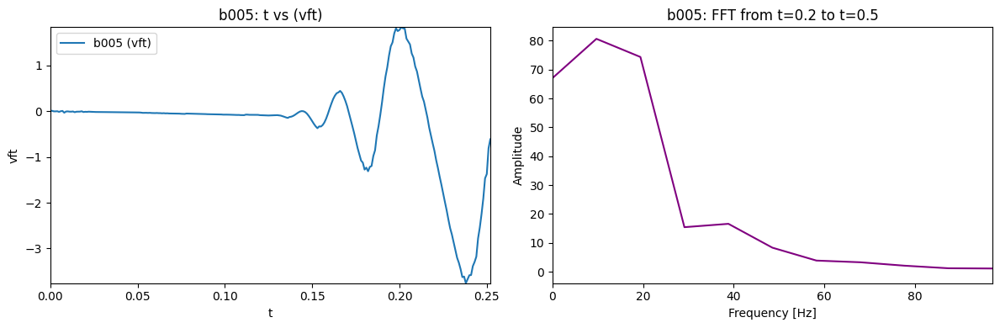

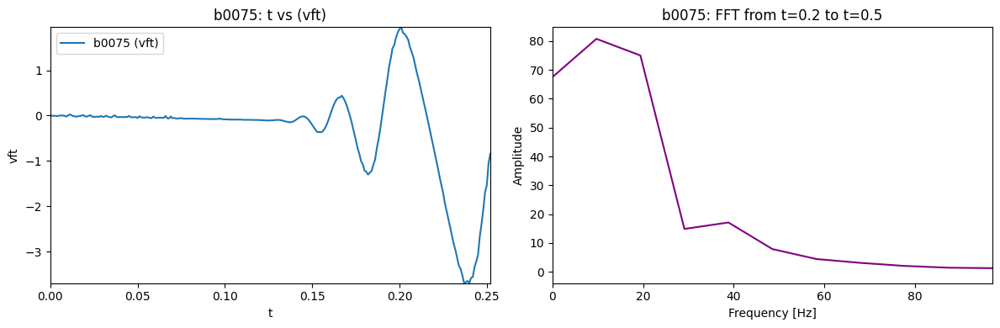

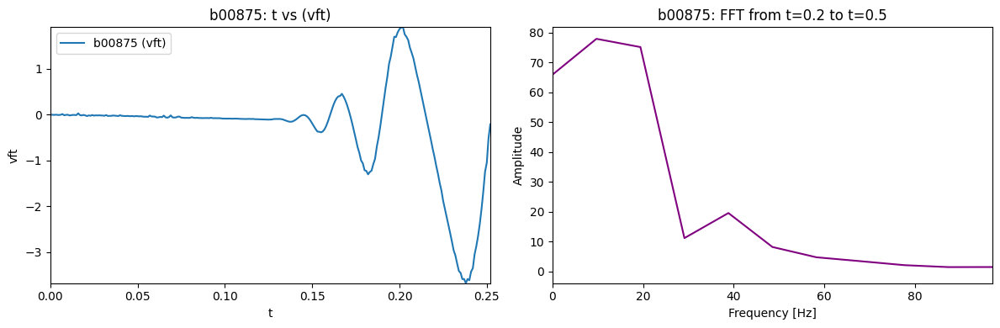

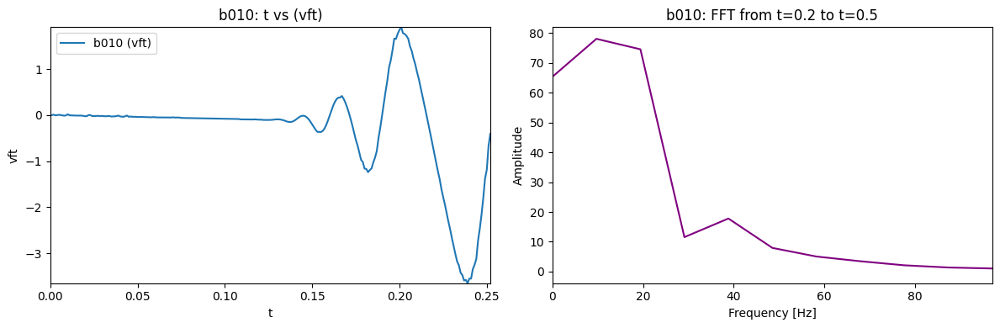

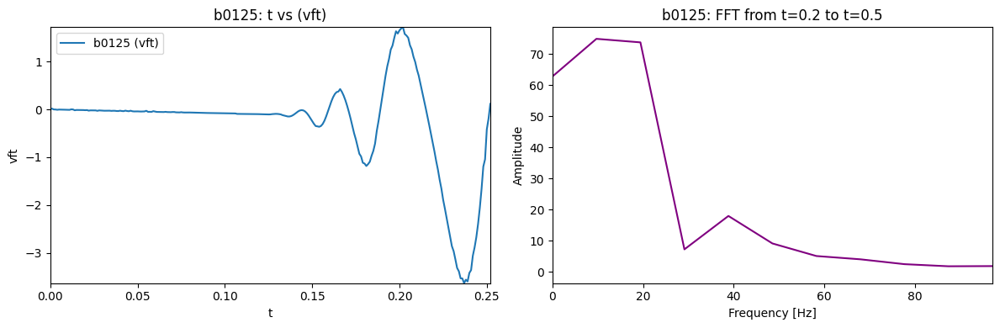

...

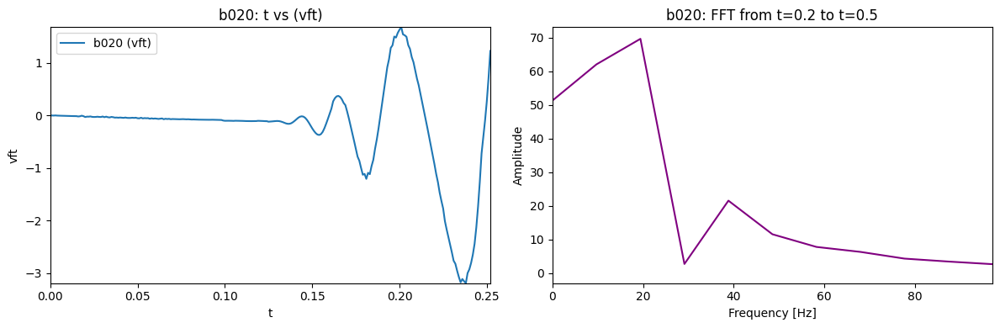

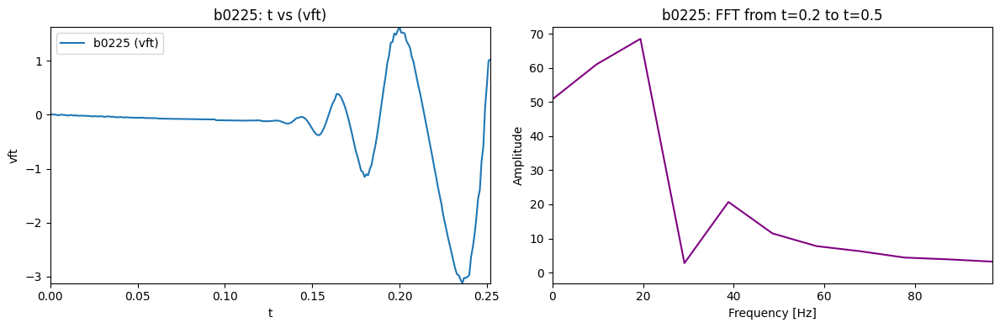

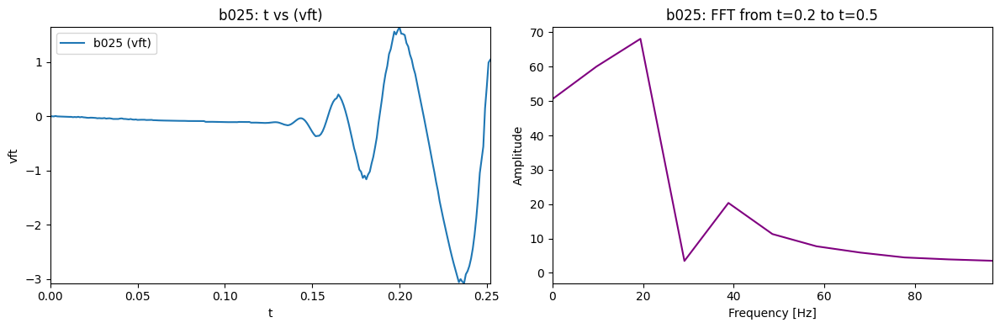

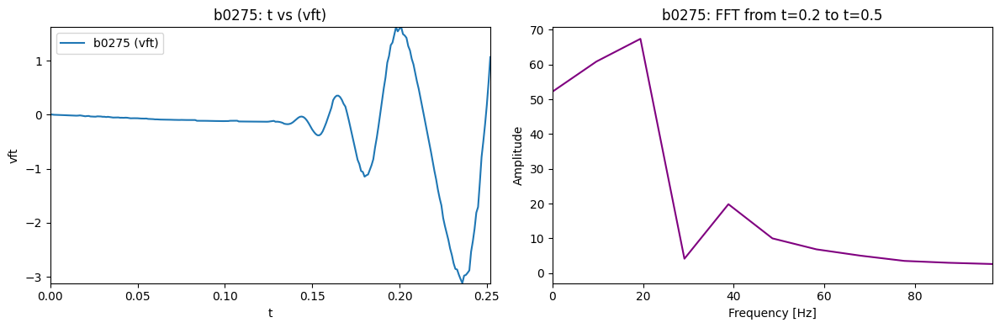

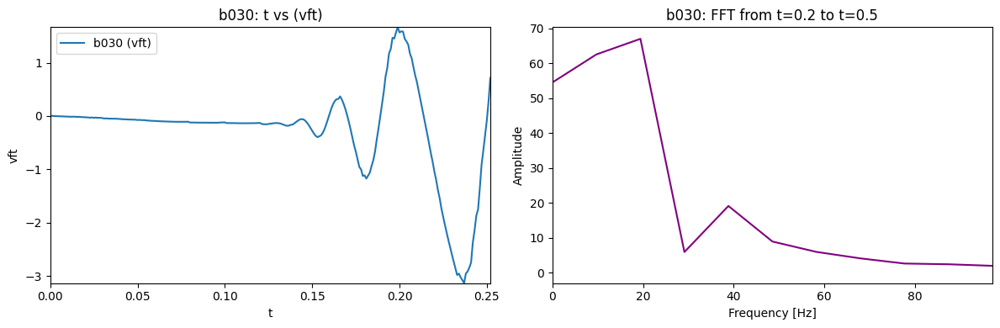

In [ ]:
datasets = {
    'b005': b005,
    'b0075': b0075,
    'b00875': b00875,
    'b010': b010,
    'b0125': b0125,
    'b015': b015,
    'b0175': b0175,
    'b020': b020,
    'b0225': b0225,
    'b025': b025,
    'b0275': b0275,
    'b030': b030
}


for name, data in datasets.items():
    # Time-domain data: Full plot range
    xlim_min, xlim_max = 0, 0.252
    plot_data = data[(data[:, 0] >= xlim_min) & (data[:, 0] <= xlim_max)]
    t_plot = plot_data[:, 0]
    diff_velocity_plot = plot_data[:, 6]

    # FFT range: 0.2 to 0.5 seconds
    fft_range_min, fft_range_max = 0.15, 0.252
    fft_data = data[(data[:, 0] >= fft_range_min) & (data[:, 0] <= fft_range_max)]
    t_fft = fft_data[:, 0]
    diff_velocity_fft = fft_data[:, 6]

    # Compute FFT
    N = len(t_fft)
    if N < 2:
        print(f"Not enough data for FFT in {name}")
        continue

    dt = np.mean(np.diff(t_fft))
    fft_vals = np.fft.fft(diff_velocity_fft)
    fft_freqs = np.fft.fftfreq(N, d=dt)

    # Keep only positive frequencies
    pos_freqs = fft_freqs[:N // 2]
    pos_fft_vals = np.abs(fft_vals[:N // 2])

    # --- Plot time-domain and FFT ---
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))

    # Time-domain plot
    ax1.plot(t_plot, diff_velocity_plot, label=f'{name} (vft)')
    ax1.set_xlabel('t')
    ax1.set_ylabel('vft')
    ax1.set_title(f'{name}: t vs (vft)')
    ax1.set_xlim(xlim_min, xlim_max)

    # Dynamic y-limits
    min_y = np.min(diff_velocity_plot)
    max_y = np.max(diff_velocity_plot)
    ax1.set_ylim(min_y, max_y)
    ax1.legend()

    # FFT plot
    ax2.plot(pos_freqs, pos_fft_vals, color='purple')
    ax2.set_xlabel('Frequency [Hz]')
    ax2.set_ylabel('Amplitude')
    ax2.set_title(f'{name}: FFT from t=0.2 to t=0.5')
    ax2.set_xlim(0, np.max(pos_freqs)/5)  # You can limit this if desired

    plt.tight_layout()
    plt.show()

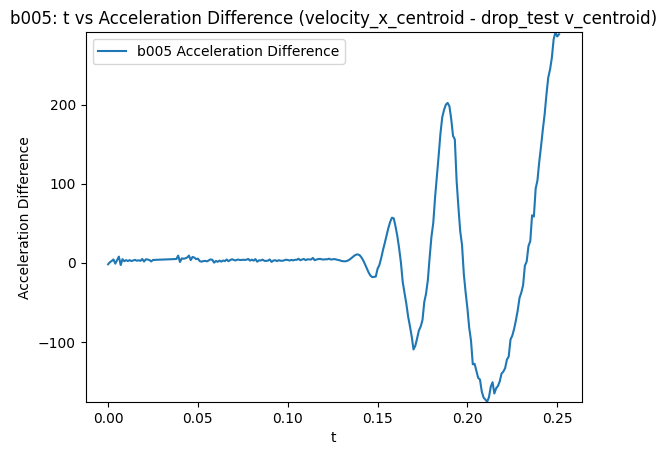

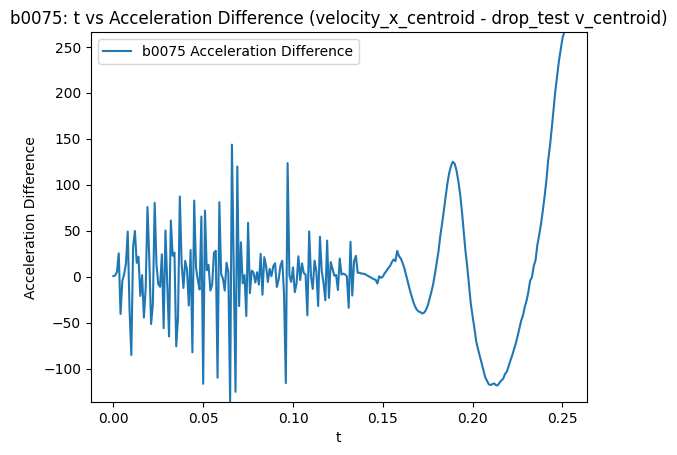

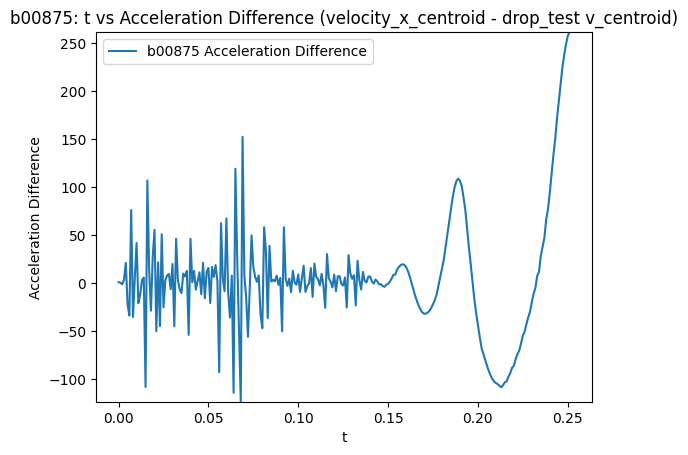

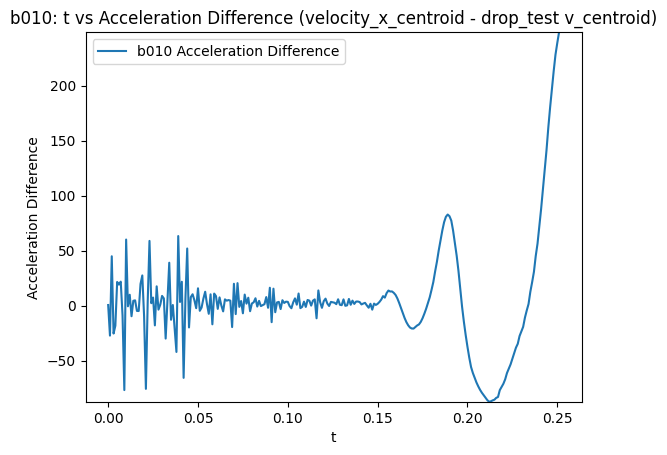

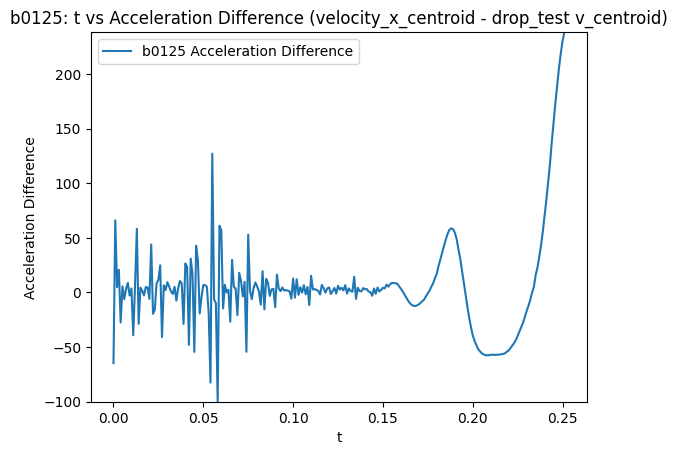

...

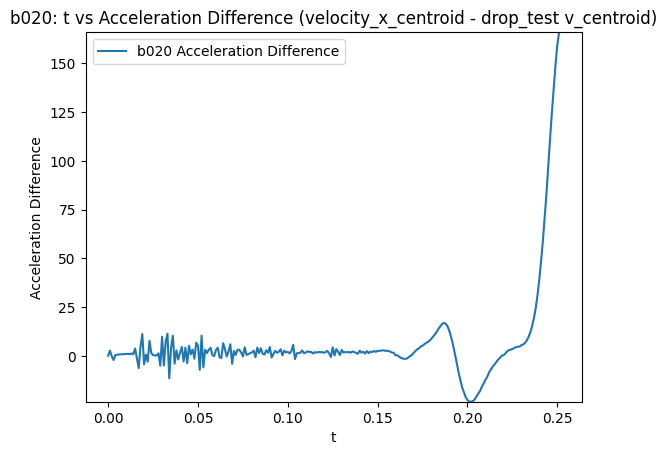

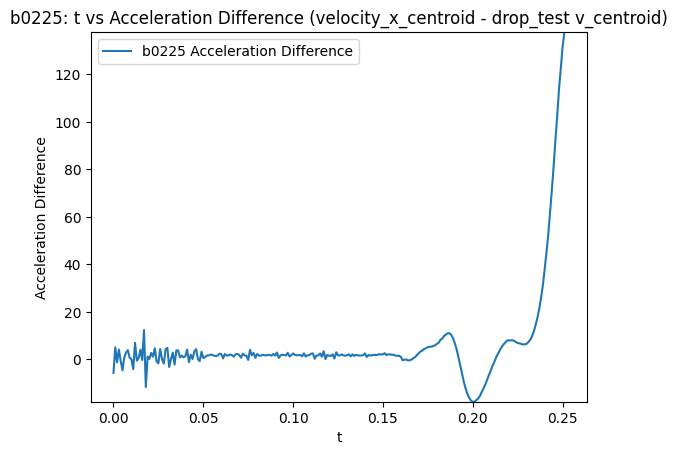

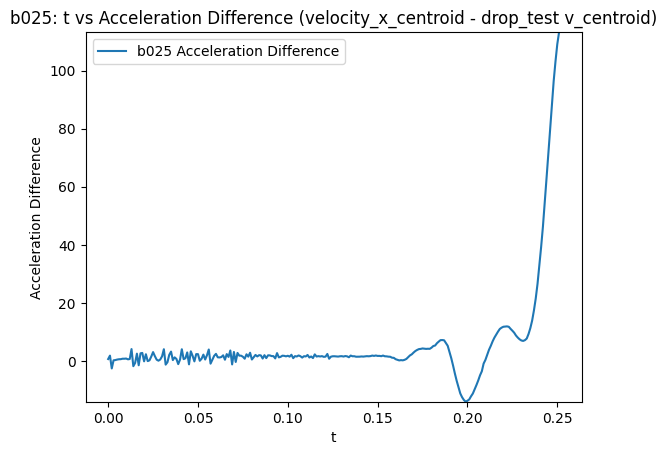

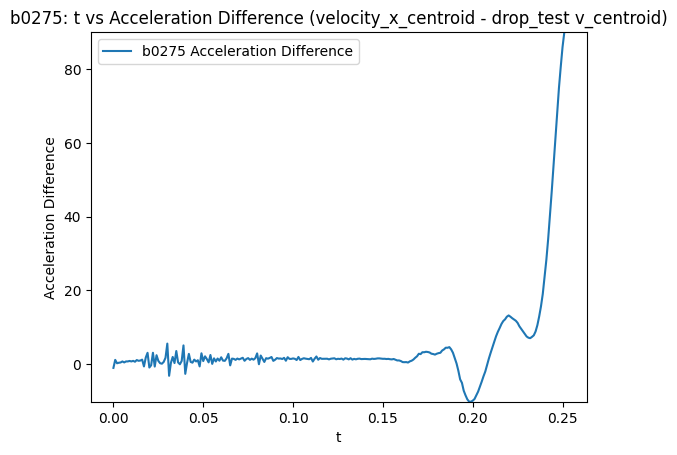

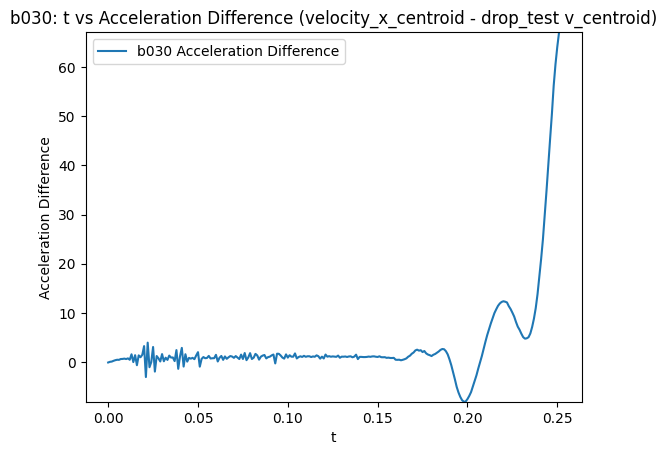

In [ ]:
datasets = {
    'b005': b005,
    'b0075': b0075,
    'b00875': b00875,
    'b010': b010,
    'b0125': b0125,
    'b015': b015,
    'b0175': b0175,
    'b020': b020,
    'b0225': b0225,
    'b025': b025,
    'b0275': b0275,
    'b030': b030
}

# Assuming drop_test is already loaded and available
# If not, you might need to load it here:
# drop_test = load_filtered('/content/drive/MyDrive/13, nobubble/log_cont')

dt = 0.001 # Assuming a constant time step

for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    # Ensure both datasets cover a similar time range for meaningful comparison
    # Find the overlapping time range
    min_time = 0.
    max_time = 0.252

    # Filter data within the overlapping time range
    filtered_data = data[(data[:, 0] >= min_time) & (data[:, 0] <= max_time)]
    filtered_drop_test = drop_test[(drop_test[:, 0] >= min_time) & (drop_test[:, 0] <= max_time)]

    # Check if there is enough data to interpolate and calculate derivative
    if filtered_drop_test.shape[0] < 2 or filtered_data.shape[0] < 2:
        print(f"Not enough overlapping data for {name} and drop_test for comparison.")
        continue

    # Interpolate drop_test v_centroid onto the time points of the current dataset
    interp_v_centroid_drop_test = np.interp(filtered_data[:, 0], filtered_drop_test[:, 0], filtered_drop_test[:, 2])

    # Calculate the difference in velocity
    diff_velocity = filtered_data[:, 2] - interp_v_centroid_drop_test

    # Calculate the acceleration of the velocity difference
    # This is the derivative of the velocity difference with respect to time
    acceleration_diff = np.diff(diff_velocity) / dt

    # The time array for acceleration will be one element shorter
    time_acceleration_diff = filtered_data[:-1, 0]


    ax.plot(time_acceleration_diff, acceleration_diff, label=f'{name} Acceleration Difference')

    ax.set_xlabel('t')
    ax.set_ylabel('Acceleration Difference')
    ax.set_title(f'{name}: t vs Acceleration Difference (velocity_x_centroid - drop_test v_centroid)')
    ax.legend()

    # Set appropriate y-limits based on the calculated acceleration difference
    if acceleration_diff.size > 0:
        min_y = np.min(acceleration_diff)
        max_y = np.max(acceleration_diff)
        ax.set_ylim(min_y, max_y)

    plt.show()

#drop


In [ ]:
def load_filtered_drop(filepath):
    with open(filepath, 'r') as f:
        lines = f.readlines()
    # Include only odd-numbered lines (1st, 3rd, 5th, etc.)
    filtered_lines = [lines[i] for i in range(len(lines)) if i % 2 != 0]
    # Join the filtered lines back into a string and use io.StringIO to simulate a file
    filtered_data = io.StringIO("".join(filtered_lines))
    return np.genfromtxt(filtered_data, delimiter=' ', usecols=(0, 1, 2, 3, 4,5,6))

In [ ]:
drop = load_filtered_drop('/content/drive/MyDrive/13, nobubble/log13fixed')

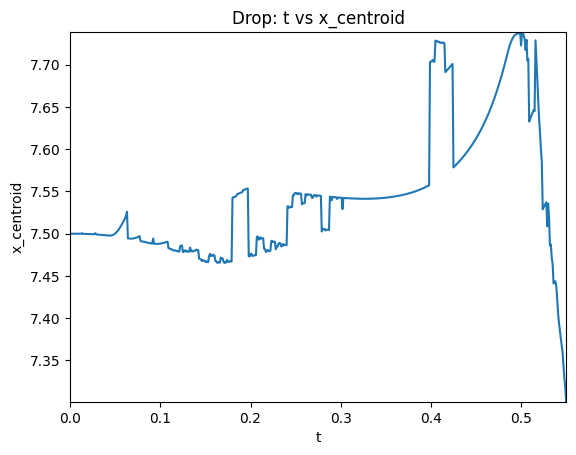

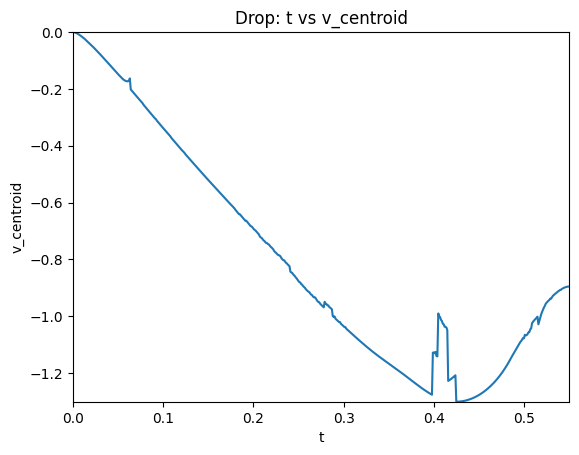

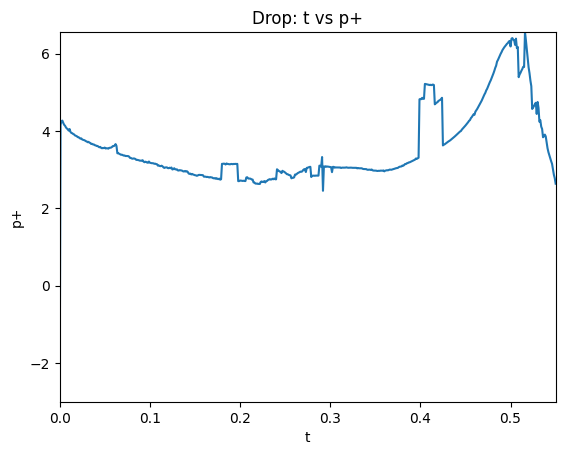

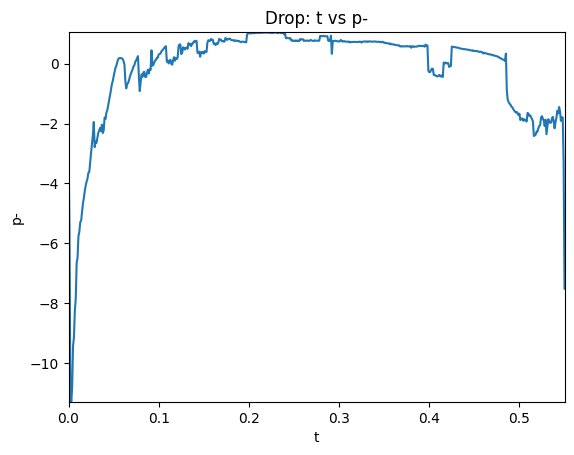

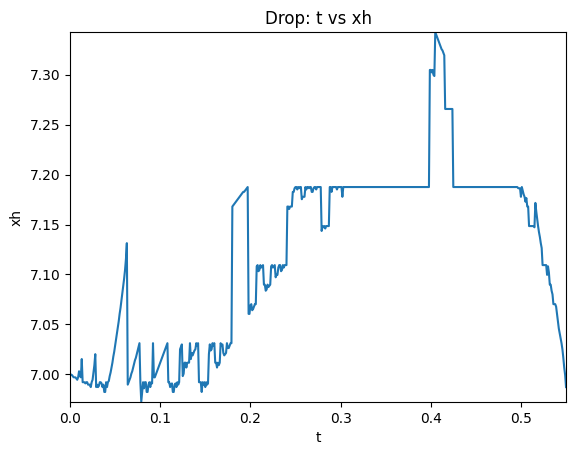

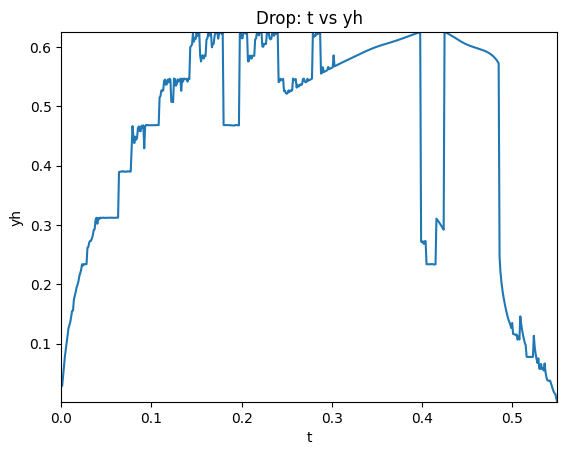

In [ ]:
column_names_drop = ['x_centroid', 'v_centroid', 'p+', 'p-', 'xh',  'yh']

for i in range(1, drop.shape[1]):
    fig, ax = plt.figure(), plt.axes()
    ax.plot(drop[:, 0], drop[:, i])
    ax.set_xlabel('t')
    ax.set_ylabel(column_names_drop[i-1])
    ax.set_title(f'Drop: t vs {column_names_drop[i-1]}')

    xlim_min, xlim_max = 0, 0.550
    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_data = drop[(drop[:, 0] >= xlim_min) & (drop[:, 0] <= xlim_max)]

    # Set appropriate y-limits based on the filtered data
    min_y = np.min(filtered_data[:, i])
    max_y = np.max(filtered_data[:, i])
    ax.set_ylim(min_y, max_y)


    plt.show()

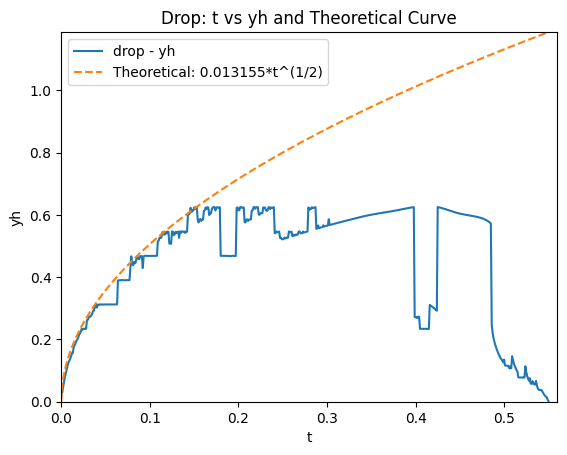

In [ ]:
fig, ax = plt.figure(), plt.axes()

# Plot 'yh' (column 6) vs time (column 0) from the drop data
ax.plot(drop[:, 0], drop[:, 6], label='drop - yh')

# Define the theoretical function
def theoretical_yh(t):
    return 1.6*np.sqrt(t)

# Generate data for the theoretical plot using the time values from the drop data
theoretical_time = drop[:, 0]
theoretical_values = theoretical_yh(theoretical_time)

# Plot the theoretical curve
ax.plot(theoretical_time, theoretical_values, label='Theoretical: 0.013155*t^(1/2)', linestyle='--')

ax.set_xlabel('t')
ax.set_ylabel('yh')
ax.set_title('Drop: t vs yh and Theoretical Curve')
ax.legend()

# Set x-axis limits (adjust as needed)
xlim_min, xlim_max = 0, 0.560

ax.set_xlim(xlim_min, xlim_max)

# Set y-axis limits based on the plotted data
min_y = min(np.min(drop[:, 6]), np.min(theoretical_values))
max_y = max(np.max(drop[:, 6]), np.max(theoretical_values))
ax.set_ylim(min_y, max_y)


plt.show()

In [ ]:
import io

def load_filtered(filepath):
    with open(filepath, 'r') as f:
        lines = f.readlines()
    # Skip the first line
    filtered_lines = lines[1:]
    # Join the filtered lines back into a string and use io.StringIO to simulate a file
    filtered_data = io.StringIO("".join(filtered_lines))
    return np.genfromtxt(filtered_data, delimiter=' ', usecols=(0, 1, 2, 3, 4,5,6,7))

In [ ]:
drop_test = load_filtered('/content/drive/MyDrive/13, nobubble/log_cont_2')

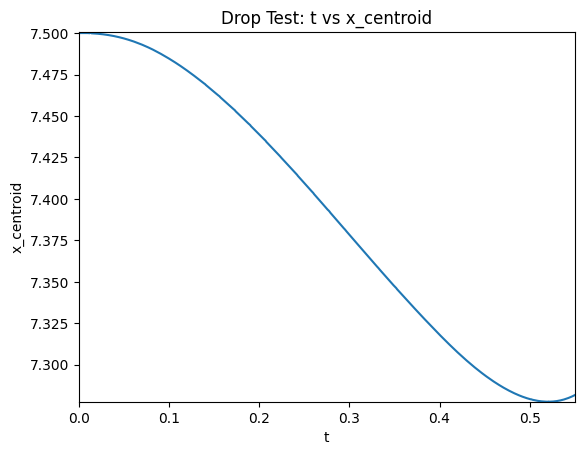

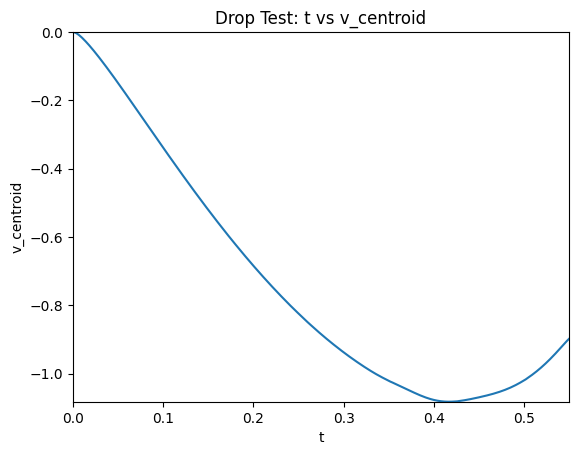

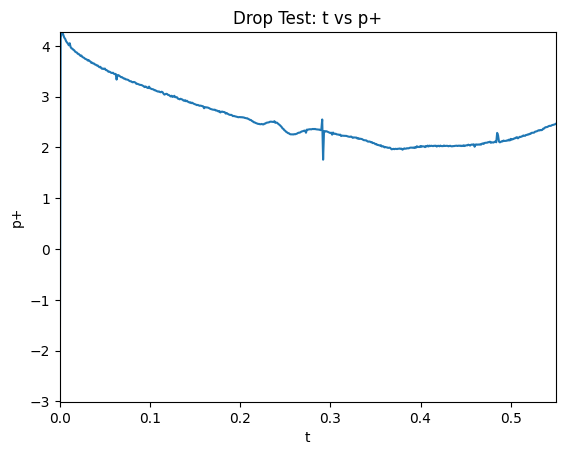

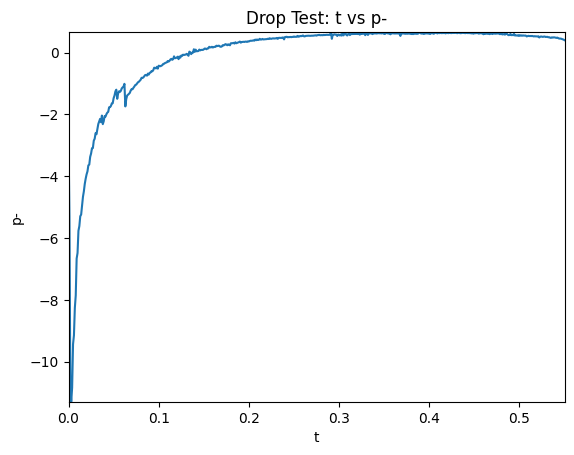

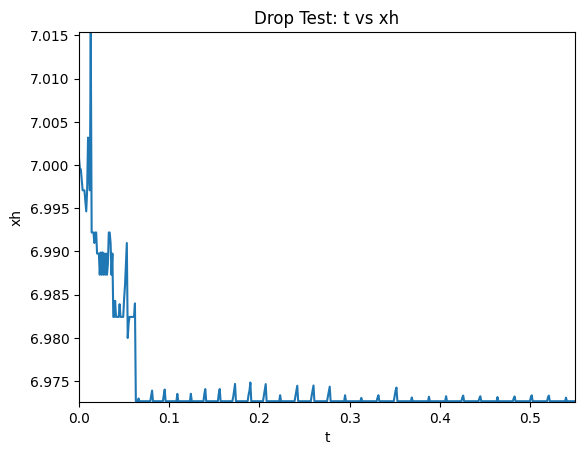

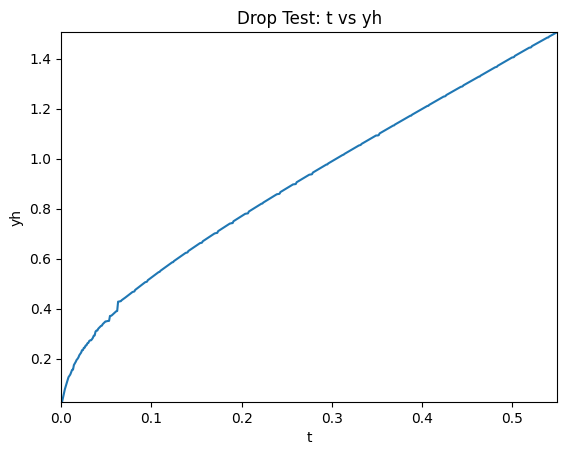

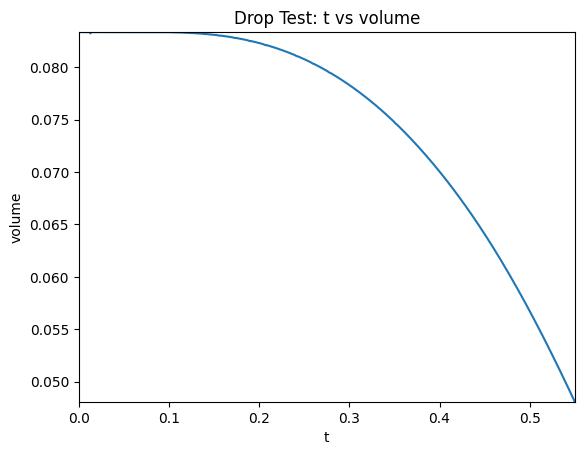

In [ ]:
column_names_drop_test = ['x_centroid', 'v_centroid', 'p+', 'p-', 'xh', 'yh', 'volume']

for i in range(1, drop_test.shape[1]):
    fig, ax = plt.figure(), plt.axes()
    ax.plot(drop_test[:, 0], drop_test[:, i])
    ax.set_xlabel('t')
    ax.set_ylabel(column_names_drop_test[i-1])
    ax.set_title(f'Drop Test: t vs {column_names_drop_test[i-1]}')

    xlim_min, xlim_max = 0, 0.550
    ax.set_xlim(xlim_min, xlim_max)

    # Filter data within the x-axis range
    filtered_data = drop_test[(drop_test[:, 0] >= xlim_min) & (drop_test[:, 0] <= xlim_max)]

    # Set appropriate y-limits based on the filtered data
    min_y = np.min(filtered_data[:, i])
    max_y = np.max(filtered_data[:, i])
    ax.set_ylim(min_y, max_y)


    plt.show()

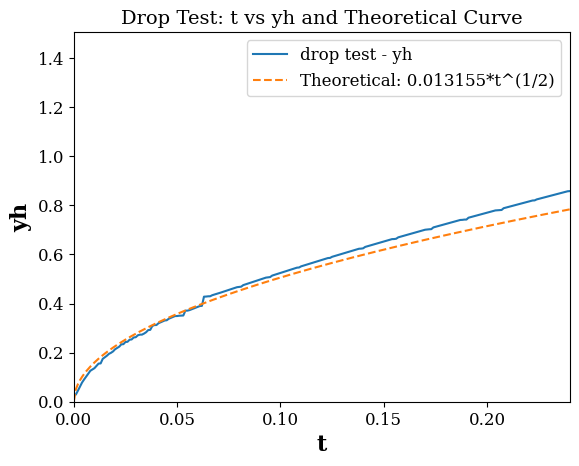

In [ ]:
fig, ax = plt.figure(), plt.axes()

plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['DejaVu Serif', 'Times New Roman', 'Computer Modern Roman'] # Better font
plt.rcParams['mathtext.fontset'] = 'cm' # Use Computer Modern fonts for math
plt.rcParams['font.size'] = 12 # Adjust font size
plt.rcParams['axes.labelsize'] = 16  # Increased label size
plt.rcParams['axes.labelweight'] = 'bold' # Made labels bold
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 12
plt.rcParams['figure.titlesize'] = 18

# Plot 'yh' (column 6) vs time (column 0) from the drop data
ax.plot(drop_test[:, 0], drop_test[:, 6], label='drop test - yh')

# Define the theoretical function
def theoretical_yh(t):
    return 1.6*np.sqrt(t)

# Generate data for the theoretical plot using the time values from the drop data
theoretical_time = drop_test[:, 0]
theoretical_values = theoretical_yh(theoretical_time)

# Plot the theoretical curve
ax.plot(theoretical_time, theoretical_values, label='Theoretical: 0.013155*t^(1/2)', linestyle='--')

ax.set_xlabel('t')
ax.set_ylabel('yh')
ax.set_title('Drop Test: t vs yh and Theoretical Curve')
ax.legend()

# Set x-axis limits (adjust as needed)
xlim_min, xlim_max = 0, 0.240

ax.set_xlim(xlim_min, xlim_max)

# Set y-axis limits based on the plotted data
min_y = min(np.min(drop_test[:, 6]), np.min(theoretical_values))
max_y = max(np.max(drop_test[:, 6]), np.max(theoretical_values))
ax.set_ylim(min_y, max_y)


plt.show()

<>:4: SyntaxWarning: invalid escape sequence '\D'
<>:37: SyntaxWarning: invalid escape sequence '\p'
<>:4: SyntaxWarning: invalid escape sequence '\D'
<>:37: SyntaxWarning: invalid escape sequence '\p'
/tmp/ipython-input-3544926677.py:4: SyntaxWarning: invalid escape sequence '\D'
  ax.loglog(drop_test[:, 0], drop_test[:, 6], label='$y_h,\Delta = 0.0012$')
/tmp/ipython-input-3544926677.py:37: SyntaxWarning: invalid escape sequence '\p'
  ax.loglog(theoretical_time_positive, linear_regression_values, label=f'Linear Regression: ln($ y_h$) $ \propto $ 0.533ln($ t^* $)', linestyle='--')


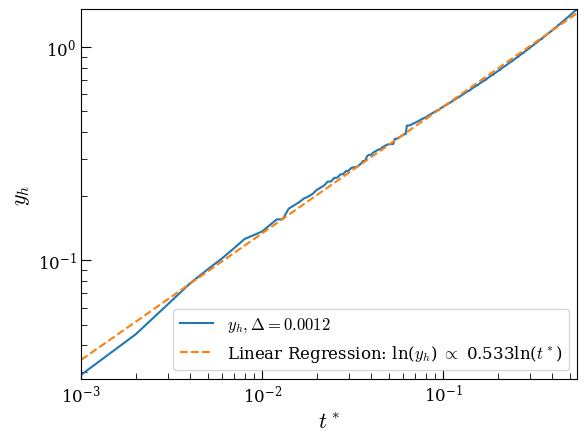

In [ ]:
fig, ax = plt.figure(), plt.axes()

# Plot 'yh' (column 6) vs time (column 0) from the drop_test data on a log-log scale
ax.loglog(drop_test[:, 0], drop_test[:, 6], label='$y_h,\Delta = 0.0012$')
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['DejaVu Serif', 'Times New Roman', 'Computer Modern Roman'] # Better font
plt.rcParams['mathtext.fontset'] = 'cm' # Use Computer Modern fonts for math
plt.rcParams['font.size'] = 12 # Adjust font size
plt.rcParams['axes.labelsize'] = 16  # Increased label size
plt.rcParams['axes.labelweight'] = 'bold' # Made labels bold
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12
plt.rcParams['legend.fontsize'] = 12
plt.rcParams['figure.titlesize'] = 18
ax.tick_params(which='major', length=7, direction='in')
ax.tick_params(which='minor', length=4, direction='in')
# Perform linear regression on the log-log data
# Take the log of the positive time values and corresponding yh values
time_positive = drop_test[:, 0][drop_test[:, 0] > 0]
yh_positive = drop_test[:, 6][drop_test[:, 0] > 0]

if len(time_positive) > 1:
    log_time = np.log(time_positive)
    log_yh = np.log(yh_positive)

    # Perform linear regression: log(yh) = m * log(t) + b
    # This corresponds to yh = exp(b) * t^m
    m, b = np.polyfit(log_time, log_yh, 1)

    # Generate data for the linear regression line
    theoretical_time = drop_test[:, 0]
    theoretical_time_positive = theoretical_time[theoretical_time > 0]
    linear_regression_values = np.exp(b) * (theoretical_time_positive**m)

    # Plot the linear regression line
    ax.loglog(theoretical_time_positive, linear_regression_values, label=f'Linear Regression: ln($ y_h$) $ \propto $ 0.533ln($ t^* $)', linestyle='--')

ax.set_xlabel('$t^*$')
ax.set_ylabel('$y_h$')
ax.legend()

# Set x-axis limits (adjust as needed)
# Using small values for log scale requires careful consideration of data
xlim_min, xlim_max = 1e-3, 0.550
ax.set_xlim(xlim_min, xlim_max)

# Set y-axis limits based on the plotted data
# Ensure y-limits are also appropriate for log scale
min_y = np.min(drop_test[:, 6][drop_test[:, 6] > 0]) # Avoid log of zero or negative
max_y = np.max(drop_test[:, 6])
ax.set_ylim(min_y, max_y)

plt.savefig('yh.pdf', format='pdf', dpi=1200)
plt.show()

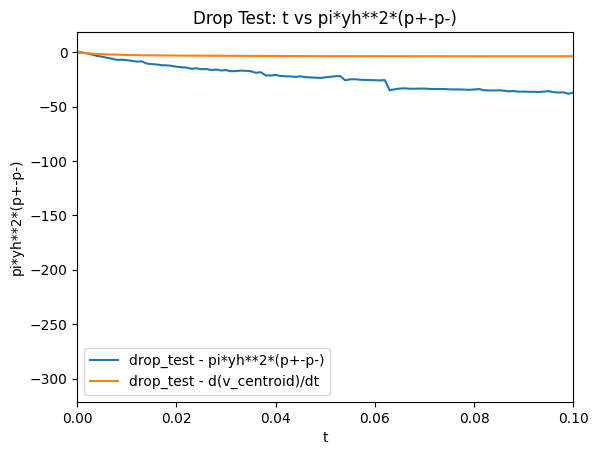

In [ ]:
# Calculate pi*yh**2*(p+-p-) for drop_test
pi_yh_squared_pressure_diff = np.pi * (drop_test[:, 6]**2) * (drop_test[:, 3] - drop_test[:, 4])


# Calculate the derivative of v_centroid for drop_test
v_centroid_drop_test = drop_test[:, 2]
time_drop_test = drop_test[:, 0]
derivative_v_centroid_drop_test = np.diff(v_centroid_drop_test) / 0.001
time_derivative_drop_test = time_drop_test[:-1]


# Create the plot
fig, ax = plt.figure(), plt.axes()
ax.plot(drop_test[:, 0], -pi_yh_squared_pressure_diff/drop_test[:, 7], label='drop_test - pi*yh**2*(p+-p-)')
ax.set_xlabel('t')
ax.set_ylabel('pi*yh**2*(p+-p-)')
ax.set_title('Drop Test: t vs pi*yh**2*(p+-p-)')

ax.plot(time_derivative_drop_test, derivative_v_centroid_drop_test, label='drop_test - d(v_centroid)/dt')

xlim_min, xlim_max = 0, 0.1
ax.set_xlim(xlim_min, xlim_max)

# Filter data within the x-axis range
filtered_data = drop_test[(drop_test[:, 0] >= xlim_min) & (drop_test[:, 0] <= xlim_max)]
filtered_pi_yh_squared_pressure_diff = pi_yh_squared_pressure_diff[(drop_test[:, 0] >= xlim_min) & (drop_test[:, 0] <= xlim_max)]


# Set appropriate y-limits based on the filtered data
min_y = np.min(filtered_pi_yh_squared_pressure_diff)
max_y = np.max(filtered_pi_yh_squared_pressure_diff)
#ax.set_ylim(min_y, max_y)
plt.legend()
plt.show()

In [ ]:
column_names = ['x_centroid', 'velocity_x_centroid', 'hbubblemax', 'hdropmax', 'vbtop', 'vftop']

for i in range(1, b005.shape[1]):
    fig, ax = plt.figure(), plt.axes()

    # Subtract 7.0 from relevant columns before plotting
    if column_names[i-1] in ['x_centroid', 'hbubblemax', 'hdropmax']:
        ax.plot(b005[:, 0], b005[:, i] - 7.0, label='b005')
        ax.plot(b00875[:, 0], b00875[:, i] - 7.0, label='b00875')
        ax.plot(b010[:, 0], b010[:, i] - 7.0, label='b010')
        ax.plot(b01125[:, 0], b01125[:, i] - 7.0, label='b01125')
        ax.plot(b0125[:, 0], b0125[:, i] - 7.0, label='b0125')
        ax.plot(b015[:, 0], b015[:, i] - 7.0, label='b015')
        ax.plot(b020[:, 0], b020[:, i] - 7.0, label='b020')
        ax.plot(b025[:, 0], b025[:, i] - 7.0, label='b025')
        ax.plot(b030[:, 0], b030[:, i] - 7.0, label='b030')
    else:
        ax.plot(b005[:, 0], b005[:, i], label='b005')
        ax.plot(b00875[:, 0], b00875[:, i], label='b00875')
        ax.plot(b010[:, 0], b010[:, i], label='b010')
        ax.plot(b01125[:, 0], b01125[:, i], label='b01125')
        ax.plot(b0125[:, 0], b0125[:, i], label='b0125')
        ax.plot(b015[:, 0], b015[:, i], label='b015')
        ax.plot(b020[:, 0], b020[:, i], label='b020')
        ax.plot(b025[:, 0], b025[:, i], label='b025')
        ax.plot(b030[:, 0], b030[:, i], label='b030')


    ax.set_xlabel('t')
    ax.set_ylabel(column_names[i-1])
    ax.set_title(f' 0.20 line t vs {column_names[i-1]}')
    ax.legend()
    ax.set_xlim(0, 0.56)

    # Filter data within the x-axis range (0 to 0.56) for each dataset
    b005_filtered = b005[(b005[:, 0] >= 0) & (b005[:, 0] <= 0.56)]
    b00875_filtered = b00875[(b00875[:, 0] >= 0) & (b00875[:, 0] <= 0.56)]
    b010_filtered = b010[(b010[:, 0] >= 0) & (b010[:, 0] <= 0.56)]
    b01125_filtered = b01125[(b01125[:, 0] >= 0) & (b01125[:, 0] <= 0.56)]
    b0125_filtered = b0125[(b0125[:, 0] >= 0) & (b0125[:, 0] <= 0.56)]
    b015_filtered = b015[(b015[:, 0] >= 0) & (b015[:, 0] <= 0.56)]
    b020_filtered = b020[(b020[:, 0] >= 0) & (b020[:, 0] <= 0.56)]
    b025_filtered = b025[(b025[:, 0] >= 0) & (b025[:, 0] <= 0.56)]
    b030_filtered = b030[(b030[:, 0] >= 0) & (b030[:, 0] <= 0.56)]

    # List of filtered datasets
    filtered_datasets = [b005_filtered, b00875_filtered, b010_filtered, b01125_filtered, b0125_filtered, b015_filtered, b020_filtered, b025_filtered, b030_filtered]

    # Collect data for y-limit calculation
    y_values = []
    for data in filtered_datasets:
      if column_names[i-1] in ['x_centroid', 'hbubblemax', 'hdropmax']:
          y_values.append(data[:, i] - 7.0)
      else:
          y_values.append(data[:, i])

    # Set y-limits based on the filtered and potentially modified data
    min_y = min(np.min(y) for y in y_values)
    max_y = max(np.max(y) for y in y_values)
    ax.set_ylim(min_y, max_y)

    plt.show()

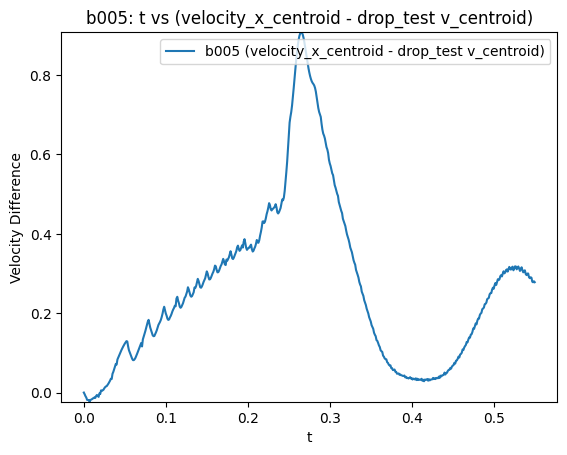

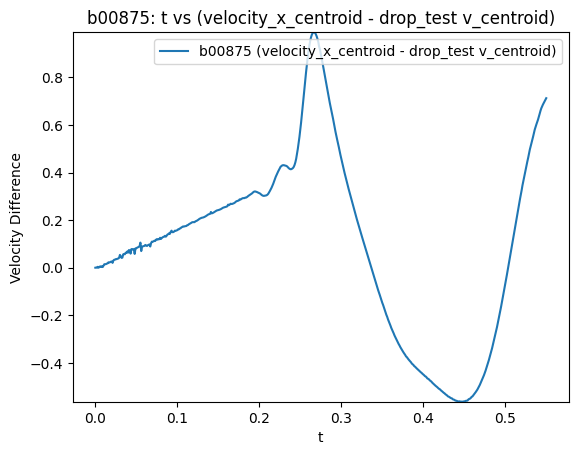

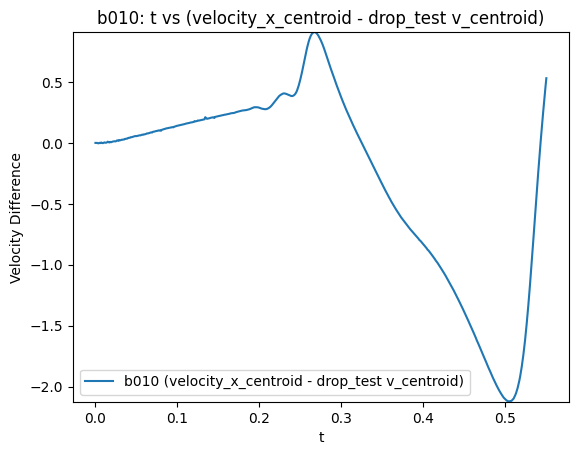

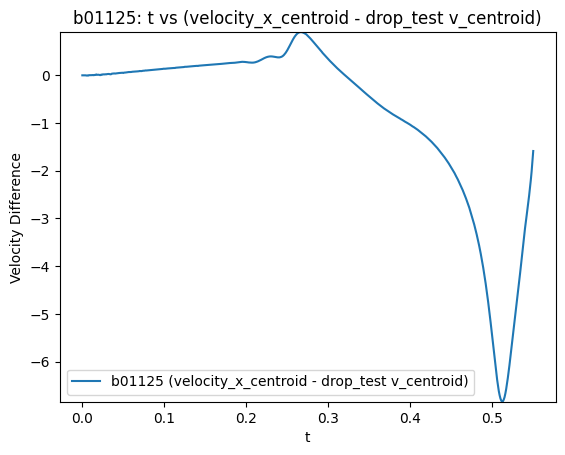

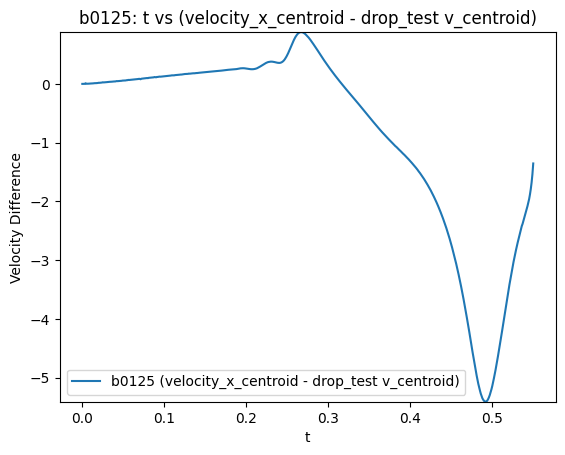

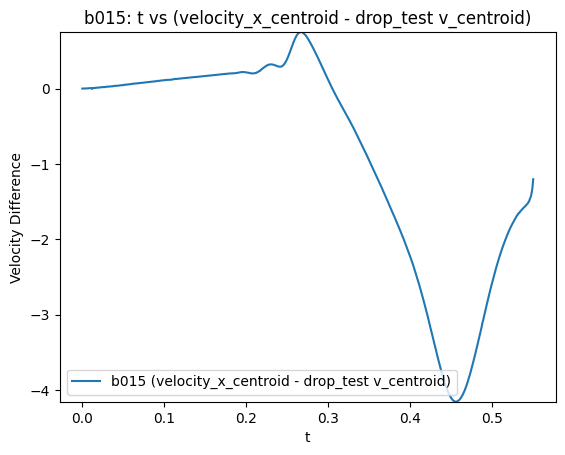

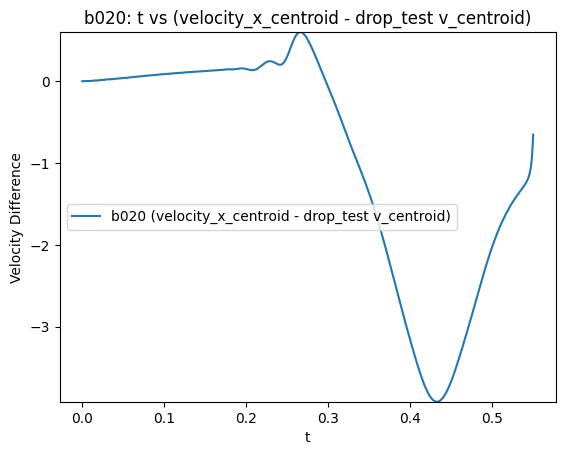

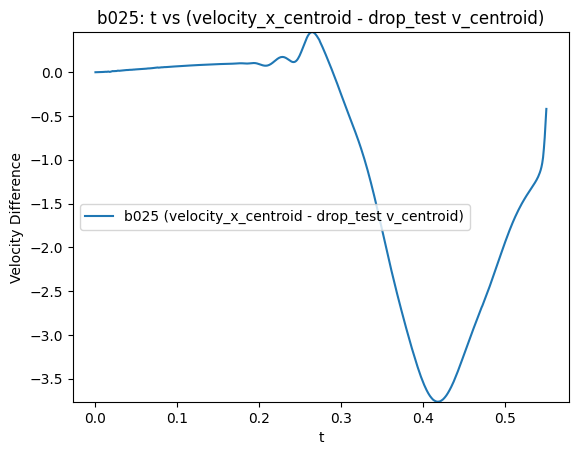

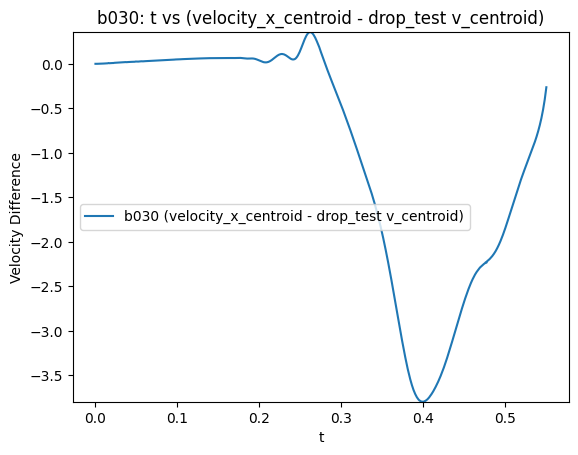

In [ ]:
datasets = {
    'b005': b005,
    'b00875': b00875,
    'b010': b010,
    'b01125': b01125,
    'b0125': b0125,
    'b015': b015,
    'b020': b020,
    'b025': b025,
    'b030': b030
}

# Assuming drop_test is already loaded and available
# If not, you might need to load it here:
# drop_test = load_filtered('/content/drive/MyDrive/13, nobubble/log_cont')


for name, data in datasets.items():
    fig, ax = plt.figure(), plt.axes()

    # Ensure both datasets cover a similar time range for meaningful comparison
    # Find the overlapping time range
    min_time = max(data[0, 0], drop_test[0, 0])
    max_time = min(data[-1, 0], drop_test[-1, 0])

    # Filter data within the overlapping time range
    filtered_data = data[(data[:, 0] >= min_time) & (data[:, 0] <= max_time)]
    filtered_drop_test = drop_test[(drop_test[:, 0] >= min_time) & (drop_test[:, 0] <= max_time)]

    # To calculate the difference, the time points need to be aligned.
    # We can interpolate one dataset onto the time points of the other,
    # or resample to a common time base. For simplicity, let's use the time points of the current dataset
    # and interpolate the drop_test v_centroid onto these time points.

    # Check if there is enough data to interpolate
    if filtered_drop_test.shape[0] < 2 or filtered_data.shape[0] < 1:
        print(f"Not enough overlapping data for {name} and drop_test for comparison.")
        continue

    interp_v_centroid_drop_test = np.interp(filtered_data[:, 0], filtered_drop_test[:, 0], filtered_drop_test[:, 2])

    # Calculate the difference: velocity_x_centroid of the current dataset - v_centroid of drop_test
    # velocity_x_centroid is column 2
    diff_velocity = filtered_data[:, 2] - interp_v_centroid_drop_test


    ax.plot(filtered_data[:, 0], diff_velocity, label=f'{name} (velocity_x_centroid - drop_test v_centroid)')

    ax.set_xlabel('t')
    ax.set_ylabel('Velocity Difference')
    ax.set_title(f'{name}: t vs (velocity_x_centroid - drop_test v_centroid)')
    ax.legend()

    # Set appropriate y-limits based on the calculated difference
    if diff_velocity.size > 0:
        min_y = np.min(diff_velocity)
        max_y = np.max(diff_velocity)
        ax.set_ylim(min_y, max_y)

    plt.show()

# Other Points that could be exploited

0.10,0.20+e / 0.1125,0.1875+e / 0.175, 0.175+e / 0.20, 0.175+e / 0.275, 0.1625+e / 0.0625, 0.0625+e / 0.075, 0.0625+e / 0.0875, 0.0625+e / 0.10, 0.0625 +e / 0.1375, 0.10+e / 0.175, 0.125+e / 0.20, 0.1375 +e / 0.2125, 0.1375+e / 0.2375, 0.15+e, etc